In [36]:
import tomosipo as ts
import numpy as np
import pickle
import mrcfile
import numpy as np
from sklearn.manifold import TSNE
from numpy import reshape
import seaborn as sns
import pandas as pd  
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics.cluster import v_measure_score
import os
import matplotlib.pyplot as plt
import astra
from tomosipo.geometry.parallel_vec import *
from scipy.ndimage import zoom
from models import *
%matplotlib inline


In [37]:
data_name = '70s_2class_0303'
os.makedirs(f'./data/{data_name}', exist_ok = True)

with open(f'./data/{data_name}/images.pkl', 'rb') as f:
    new_projection = pickle.load( f)
          
with open(f'./data/{data_name}/angles.pkl', 'rb') as f:
    angles2 = pickle.load( f)
          
with open(f'./data/{data_name}/orientation_matrix.pkl', 'rb') as f:
    Orientation_Vectors = pickle.load(f)
          
with open(f'./data/{data_name}/indexs.pkl', 'rb') as f:
    indexs = pickle.load(f)
print('indexs',indexs[:10])     
with open(f'./data/{data_name}/mean_subtracted_strcut.pkl', 'rb') as f:
    mean_subtracted_strcut = pickle.load(f)

indexs [1 0 0 1 0 1 1 1 0 0]


In [38]:
print(angles2[:10])

[[2.40942756 1.13249336 2.89793666]
 [5.31844339 1.0869395  2.20724338]
 [3.20953919 2.25659501 0.53914008]
 [0.56004307 0.74672586 6.0874194 ]
 [0.87917772 1.27133902 0.91340428]
 [0.59394877 0.14236928 6.23363297]
 [3.54547493 1.39268731 0.35889984]
 [3.3839112  0.93995388 1.54736336]
 [0.20487516 0.17167568 4.80926139]
 [2.76723454 1.31594475 2.98388959]]


In [39]:
print(new_projection.shape)
ProjSize = 34
Proj_geom = astra.create_proj_geom('parallel3d_vec', ProjSize, ProjSize, Orientation_Vectors)
pg = ts.from_astra(Proj_geom)
Proj_geom = astra.create_proj_geom('parallel3d_vec', ProjSize, ProjSize, Orientation_Vectors)
Vol_geom = astra.create_vol_geom(34, 34, 34)
vg = ts.from_astra(Vol_geom)
pg = ts.from_astra(Proj_geom)
A = ts.operator(vg, pg)

print(pg.ray_dir[:20])
"""
print(pg.det_v[:5])
print(pg.det_u[:5])
print(Orientation_Vectors[:5])
print(pg[:5])
"""


(10000, 34, 34)
[[ 0.42440346  0.60529203 -0.67342651]
 [ 0.46519672 -0.72755361  0.50423978]
 [-0.63329132 -0.05254429 -0.77212771]
 [ 0.73391673  0.36082741  0.57547356]
 [ 0.29500171  0.73593763  0.60940118]
 [ 0.9898826   0.07940636  0.11758855]
 [ 0.17716882 -0.38677428 -0.90499551]
 [ 0.58982527 -0.19377033 -0.78393827]
 [ 0.98529989  0.03475524  0.16726089]
 [ 0.25210179  0.35386413 -0.90068022]
 [ 0.88128768 -0.02700698 -0.47180785]
 [ 0.20717225 -0.80685147  0.55323626]
 [ 0.51039191 -0.74530063  0.42898377]
 [ 0.51002096 -0.11863498 -0.85194152]
 [ 0.99463322  0.09812827 -0.03279647]
 [ 0.3454954  -0.8366411   0.42504657]
 [ 0.53109402 -0.08900614 -0.8426251 ]
 [ 0.85735067  0.43128908  0.28096185]
 [ 0.26118639 -0.85677347  0.44465817]
 [ 0.37975084 -0.86460541  0.32900879]]


'\nprint(pg.det_v[:5])\nprint(pg.det_u[:5])\nprint(Orientation_Vectors[:5])\nprint(pg[:5])\n'

(10000, 34, 34)


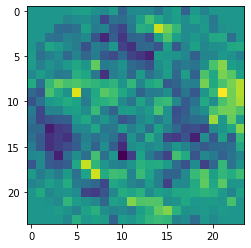

In [40]:
def create_circular_mask(h, w, center=None, radius=None):

    if center is None: # use the middle of the image
        center = (int(w/2), int(h/2))
    if radius is None: # use the smallest distance between the center and image walls
        radius = min(center[0], center[1], w-center[0], h-center[1])

    Y, X = np.ogrid[:h, :w]
    dist_from_center = np.sqrt((X - center[0])**2 + (Y-center[1])**2)

    mask = dist_from_center <= radius
    return mask
mask = create_circular_mask(34, 34, radius = 14)
#plt.imshow(mask)
#plt.show()
snr = 10
data_name = f'70s_2class_0304+{snr}'
with open(f'./data/{data_name}/images.pkl', 'rb') as f:
    new_projection = pickle.load( f)
    mask = create_circular_mask(34, 34, radius = 14)

new_projection = new_projection * mask
print(new_projection.shape)
new_projection = new_projection[:,5:29,5:29]
plt.imshow(new_projection[0])
plt.show()

indexs [1 0 0 1 0 1 1 1 0 0]
(10000, 34, 34)


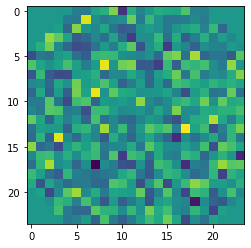

[[2.23728172 0.91190518 4.43448579]
 [3.8126173  1.276941   2.71110231]
 [2.65694823 0.42060159 3.80062374]
 ...
 [5.19412272 1.2868885  3.66523646]
 [3.59343169 0.40194287 3.04875091]
 [5.13958554 1.27173172 3.28592248]]
(10000, 24, 24)
output_collection 0-th batch


/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


output_collection 1-th batch
output_collection 2-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1500 samples in 0.004s...
[t-SNE] Computed neighbors for 1500 samples in 0.222s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1500
[t-SNE] Computed conditional probabilities for sample 1500 / 1500
[t-SNE] Mean sigma: 20.889578
[t-SNE] KL divergence after 250 iterations with early exaggeration: 93.388290
[t-SNE] KL divergence after 1000 iterations: 2.845316
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


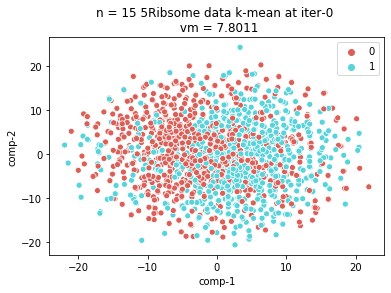

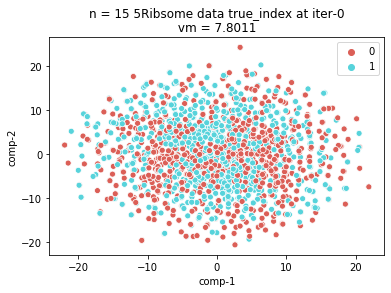

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


703.8365426063538 sec
0 batch 1 iteration
generated


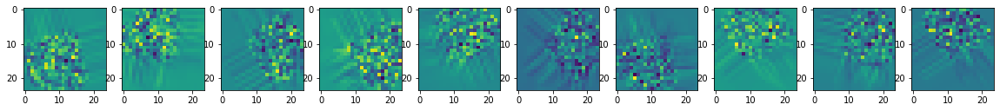

real


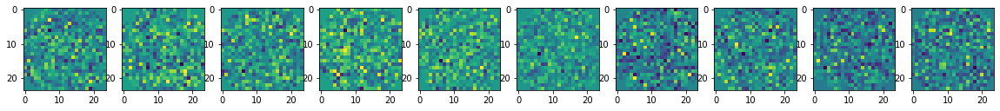

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 500 samples in 0.001s...
[t-SNE] Computed neighbors for 500 samples in 0.029s...
[t-SNE] Computed conditional probabilities for sample 500 / 500
[t-SNE] Mean sigma: 0.142414
[t-SNE] KL divergence after 250 iterations with early exaggeration: 86.457680
[t-SNE] KL divergence after 1000 iterations: 1.493302
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


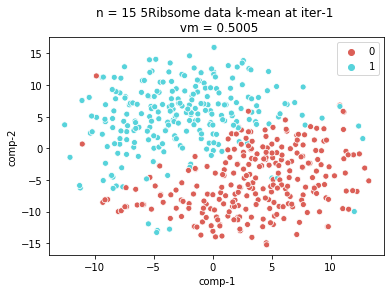

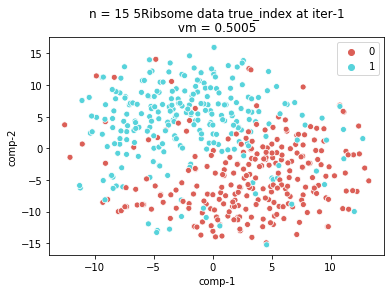

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


688.332427740097 sec
0 batch 2 iteration
generated


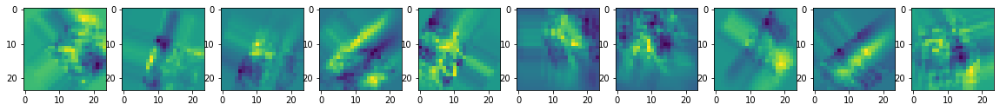

real


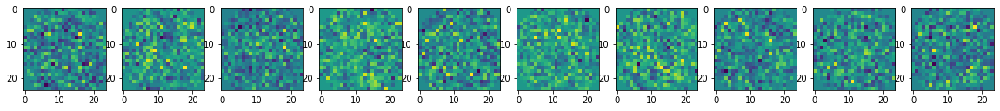

668.416543006897 sec
0 batch 3 iteration
generated


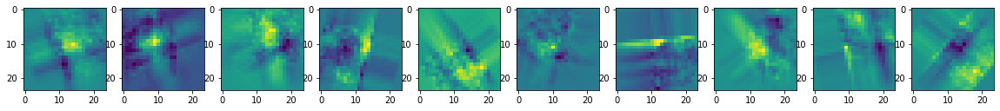

real


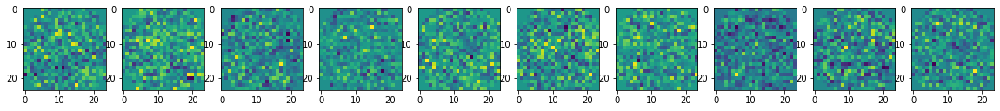

701.0798735618591 sec
0 batch 4 iteration
generated


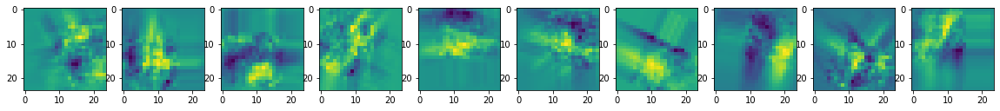

real


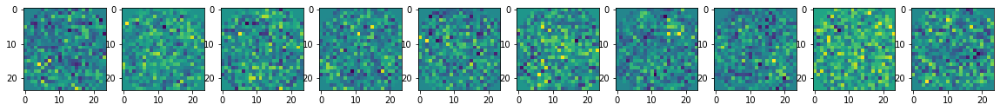

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 500 samples in 0.002s...
[t-SNE] Computed neighbors for 500 samples in 0.050s...
[t-SNE] Computed conditional probabilities for sample 500 / 500
[t-SNE] Mean sigma: 0.028943
[t-SNE] KL divergence after 250 iterations with early exaggeration: 83.860451
[t-SNE] KL divergence after 1000 iterations: 1.511259
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


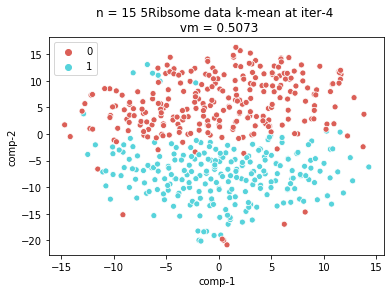

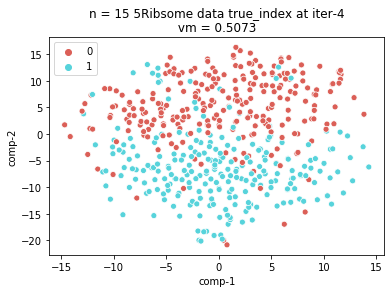

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


672.5397388935089 sec
0 batch 5 iteration
generated


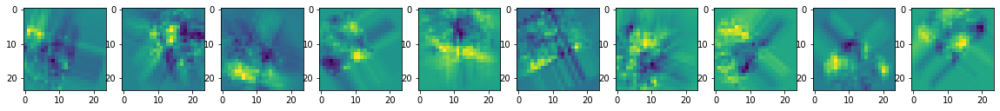

real


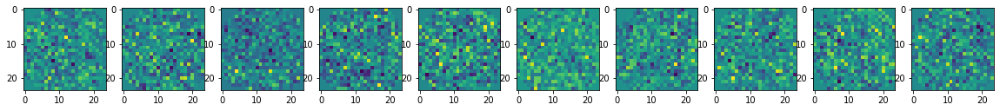

685.9080905914307 sec
0 batch 6 iteration
generated


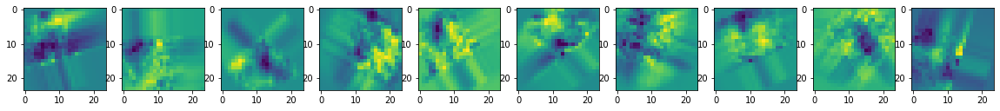

real


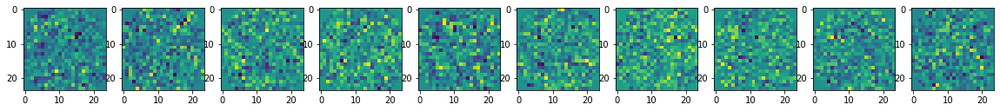

710.813896894455 sec
0 batch 7 iteration
generated


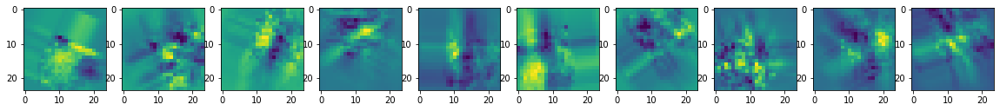

real


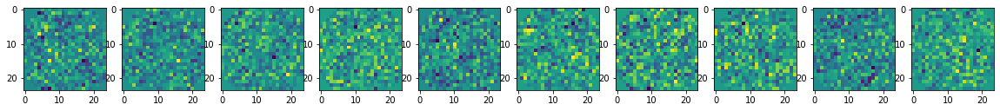

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 500 samples in 0.003s...
[t-SNE] Computed neighbors for 500 samples in 0.046s...
[t-SNE] Computed conditional probabilities for sample 500 / 500
[t-SNE] Mean sigma: 0.028626
[t-SNE] KL divergence after 250 iterations with early exaggeration: 81.703278
[t-SNE] KL divergence after 1000 iterations: 1.501484
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


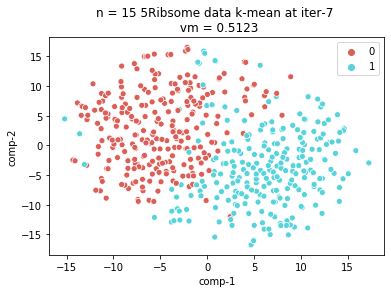

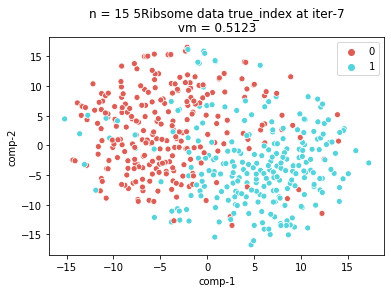

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


672.8869626522064 sec
0 batch 8 iteration
generated


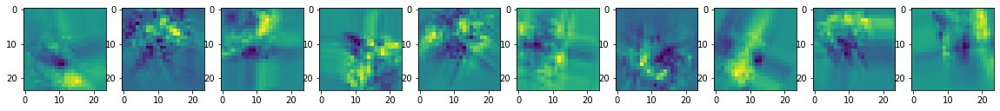

real


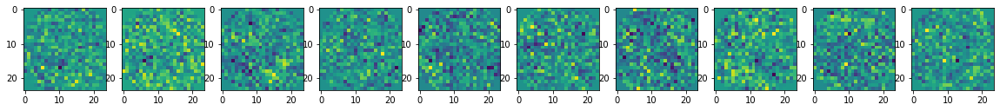

642.1556720733643 sec
0 batch 9 iteration
generated


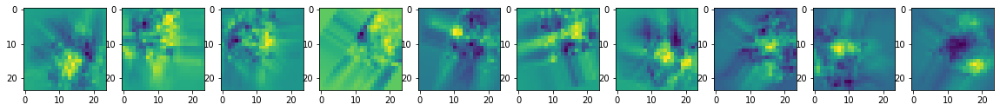

real


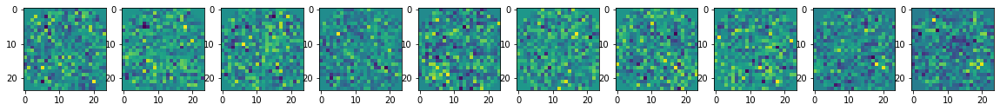

689.949481010437 sec
0 batch 10 iteration
generated


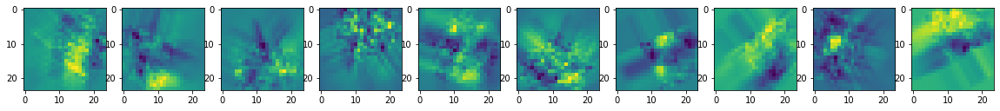

real


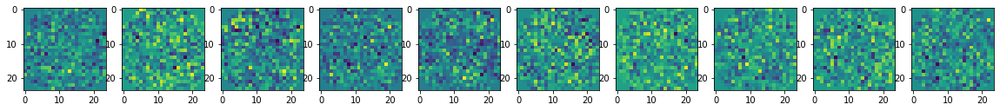

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 500 samples in 0.001s...
[t-SNE] Computed neighbors for 500 samples in 0.052s...
[t-SNE] Computed conditional probabilities for sample 500 / 500
[t-SNE] Mean sigma: 0.028419
[t-SNE] KL divergence after 250 iterations with early exaggeration: 84.292595
[t-SNE] KL divergence after 1000 iterations: 1.481824
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


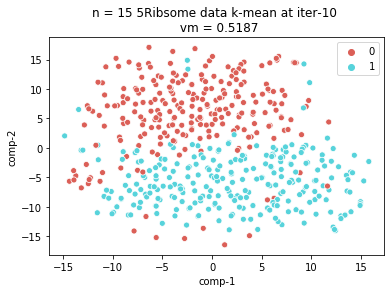

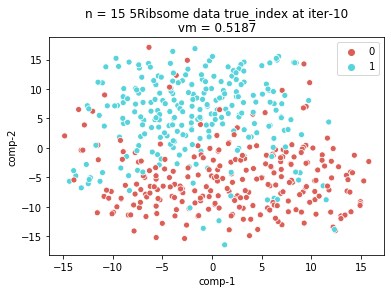

the 0 th iter, ratio = 0.01
output_collection 0-th batch


/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 500 samples in 0.002s...
[t-SNE] Computed neighbors for 500 samples in 0.047s...
[t-SNE] Computed conditional probabilities for sample 500 / 500
[t-SNE] Mean sigma: 0.028419
[t-SNE] KL divergence after 250 iterations with early exaggeration: 83.213165
[t-SNE] KL divergence after 1000 iterations: 1.482481
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


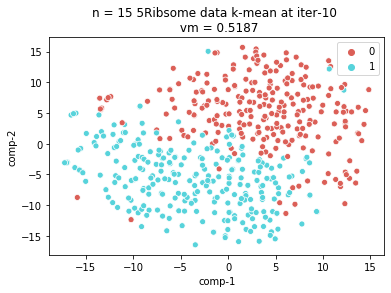

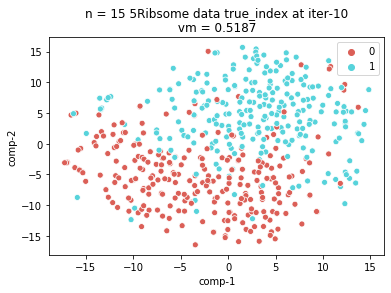

output_collection 0-th batch


/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


output_collection 1-th batch
output_collection 2-th batch
output_collection 3-th batch
output_collection 4-th batch
output_collection 5-th batch
output_collection 6-th batch
output_collection 7-th batch
output_collection 8-th batch
output_collection 9-th batch
output_collection 10-th batch
output_collection 11-th batch
output_collection 12-th batch
output_collection 13-th batch
output_collection 14-th batch
output_collection 15-th batch
output_collection 16-th batch
output_collection 17-th batch
output_collection 18-th batch
output_collection 19-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 10000 samples in 0.023s...
[t-SNE] Computed neighbors for 10000 samples in 6.005s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10000
[t-SNE] Computed conditional probabilities for sample 2000 / 10000
[t-SNE] Computed conditional probabilities for sample 3000 / 10000
[t-SNE] Computed conditional probabilities for sample 4000 / 10000
[t-SNE] Computed conditional

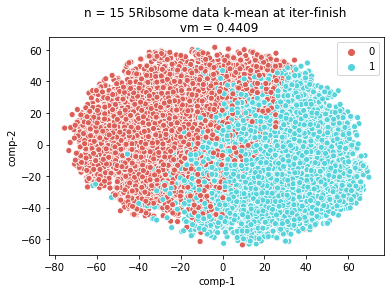

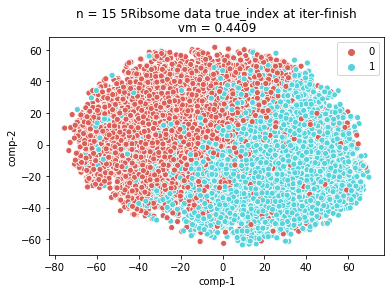

In [56]:
#snr_list = [10, 5, 1, 0.8, 0.6, 0.4, 0.2, 0.1]
snr = 0.1
data_name = f'70s_2class_0304+{snr}'
with open(f'./data/{data_name}/images.pkl', 'rb') as f:
    new_projection = pickle.load( f)

with open(f'./data/{data_name}/angles.pkl', 'rb') as f:
    angles2 = pickle.load( f)

with open(f'./data/{data_name}/orientation_matrix.pkl', 'rb') as f:
    Orientation_Vectors = pickle.load(f)

with open(f'./data/{data_name}/indexs.pkl', 'rb') as f:
    indexs = pickle.load(f)
print('indexs',indexs[:10])     
with open(f'./data/{data_name}/mean_subtracted_strcut.pkl', 'rb') as f:
    mean_subtracted_strcut = pickle.load(f)
    
new_projection = new_projection * mask
print(new_projection.shape)
new_projection = new_projection[:,5:29,5:29]
plt.imshow(new_projection[0])
plt.show()
print(angles2)
n = 15
b = 500
niter = 10
pca_n = 2
Images = new_projection#[:5000]
print(Images.shape)
exp_name = f'20220320_{data_name}_EM_2SDR_n_{n}'
ProjSize, num_image, n_component , num_iter = 24, Images.shape[0], n, niter
batch_size = b
Vol_geom = astra.create_vol_geom(ProjSize, ProjSize, ProjSize)
#Images = torch.ones(num_image, 48, 48) # fake images for computing purpose

vg = ts.from_astra(Vol_geom)
pg = ts.from_astra(Proj_geom)
op = ts.operator(vg, pg)
MP3 = EM_2SDR(ProjSize, num_image, n_component, op , Images,Orientation_Vectors, exp_name,mean_subtracted_strcut, indexs, batch_size, niter, PCA_n= pca_n)
#MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)
#MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)
MP3.Draw_Kmean_tsne('0',num_batch = 3, pca_n = 2)
MP3.fit(0.01, True)
MP3.Draw_Kmean_tsne('finish',num_batch = 20, pca_n = 2)

indexs [1 0 0 1 0 1 1 1 0 0]
(10000, 34, 34)


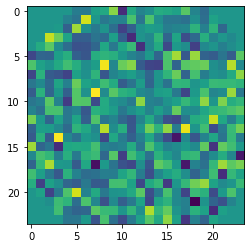

[[3.69580346 0.59551758 4.60979504]
 [3.66267117 0.71039416 3.8941898 ]
 [4.94994662 1.16466973 0.22942753]
 ...
 [3.40407028 1.12754047 1.53671127]
 [3.36284647 0.88774637 4.90507316]
 [1.10436604 1.68281854 2.78723985]]
(10000, 24, 24)
output_collection 0-th batch


/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


output_collection 1-th batch
output_collection 2-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1500 samples in 0.002s...
[t-SNE] Computed neighbors for 1500 samples in 0.164s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1500
[t-SNE] Computed conditional probabilities for sample 1500 / 1500
[t-SNE] Mean sigma: 16.501418
[t-SNE] KL divergence after 250 iterations with early exaggeration: 91.736649
[t-SNE] KL divergence after 1000 iterations: 2.758204
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


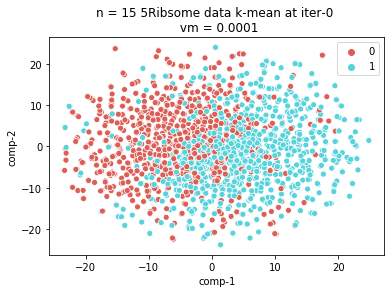

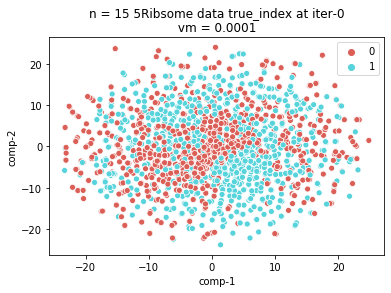

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


676.9687049388885 sec
0 batch 1 iteration
generated


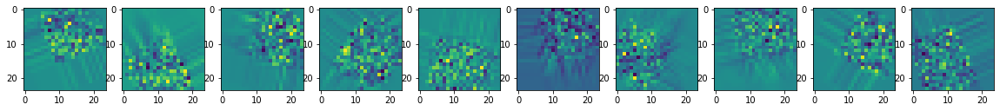

real


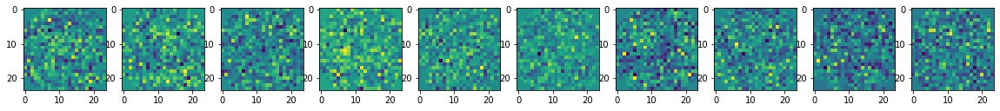

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 500 samples in 0.002s...
[t-SNE] Computed neighbors for 500 samples in 0.037s...
[t-SNE] Computed conditional probabilities for sample 500 / 500
[t-SNE] Mean sigma: 0.299506
[t-SNE] KL divergence after 250 iterations with early exaggeration: 78.226501
[t-SNE] KL divergence after 1000 iterations: 1.274632
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


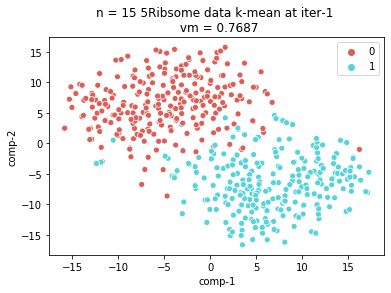

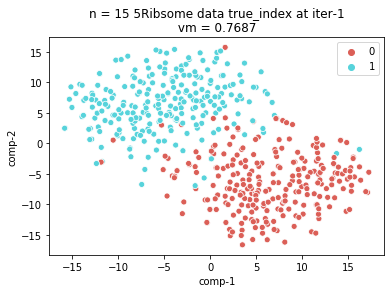

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


716.966207742691 sec
0 batch 2 iteration
generated


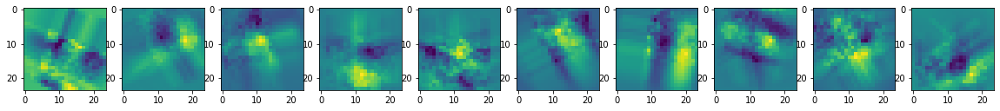

real


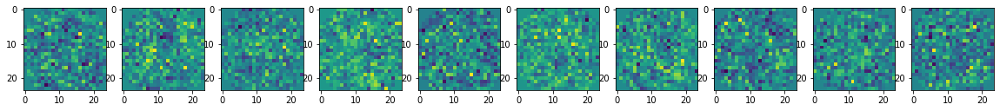

696.1743190288544 sec
0 batch 3 iteration
generated


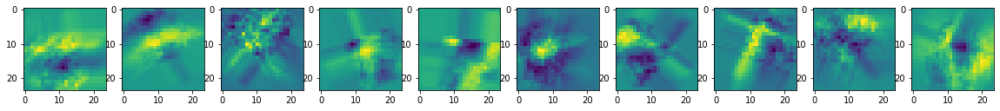

real


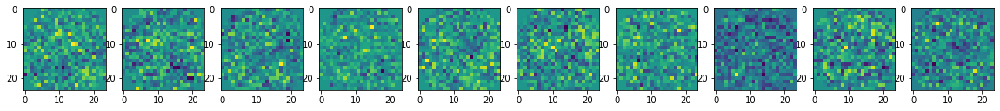

659.6387693881989 sec
0 batch 4 iteration
generated


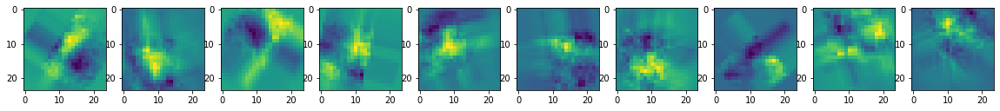

real


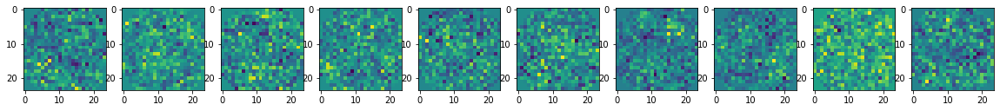

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 500 samples in 0.002s...
[t-SNE] Computed neighbors for 500 samples in 0.045s...
[t-SNE] Computed conditional probabilities for sample 500 / 500
[t-SNE] Mean sigma: 0.056576
[t-SNE] KL divergence after 250 iterations with early exaggeration: 79.222031
[t-SNE] KL divergence after 1000 iterations: 1.294984
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


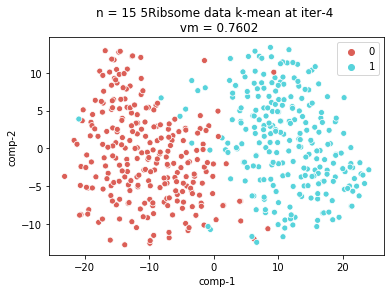

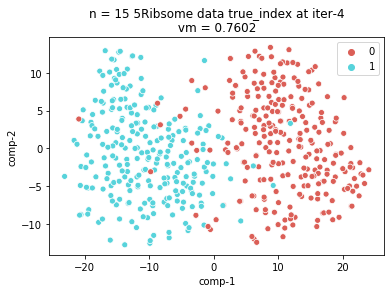

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


670.7545173168182 sec
0 batch 5 iteration
generated


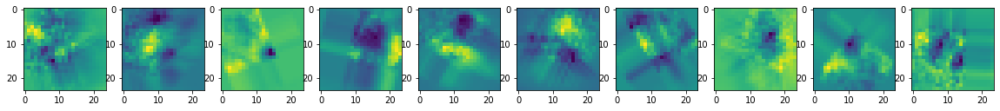

real


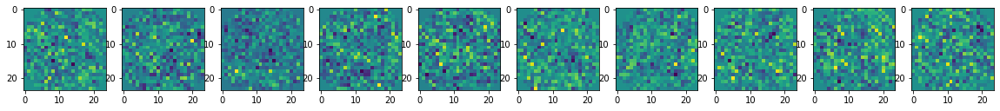

698.7179584503174 sec
0 batch 6 iteration
generated


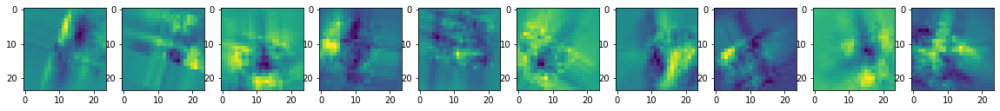

real


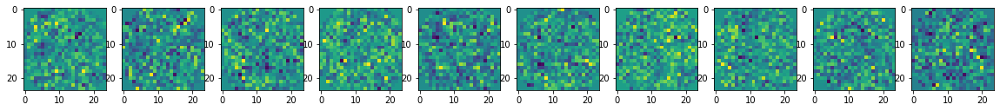

688.6415505409241 sec
0 batch 7 iteration
generated


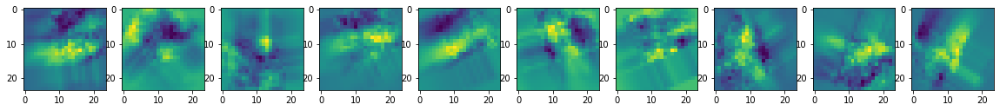

real


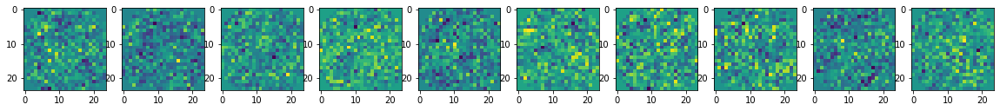

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 500 samples in 0.006s...
[t-SNE] Computed neighbors for 500 samples in 0.040s...
[t-SNE] Computed conditional probabilities for sample 500 / 500
[t-SNE] Mean sigma: 0.056047
[t-SNE] KL divergence after 250 iterations with early exaggeration: 78.795319
[t-SNE] KL divergence after 1000 iterations: 1.289087
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


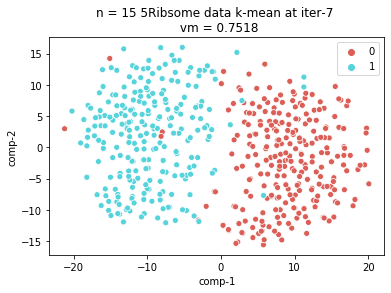

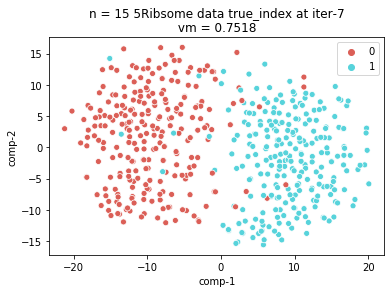

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


657.1376957893372 sec
0 batch 8 iteration
generated


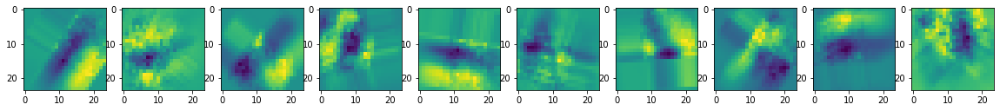

real


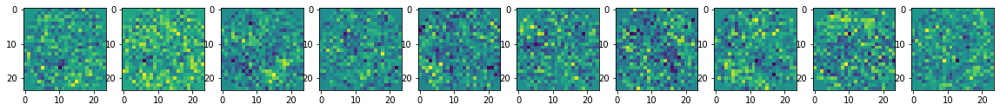

723.9838471412659 sec
0 batch 9 iteration
generated


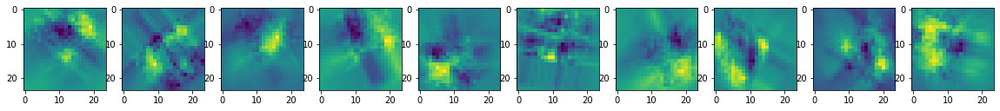

real


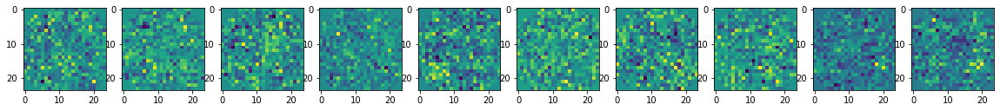

709.8815233707428 sec
0 batch 10 iteration
generated


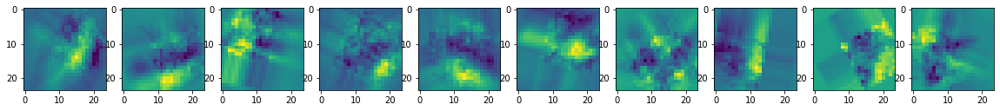

real


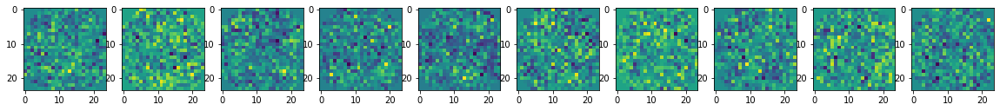

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 500 samples in 0.001s...
[t-SNE] Computed neighbors for 500 samples in 0.032s...
[t-SNE] Computed conditional probabilities for sample 500 / 500
[t-SNE] Mean sigma: 0.055460
[t-SNE] KL divergence after 250 iterations with early exaggeration: 77.555298
[t-SNE] KL divergence after 1000 iterations: 1.302057
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


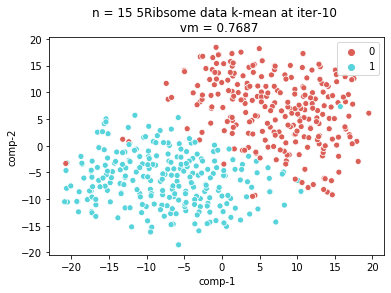

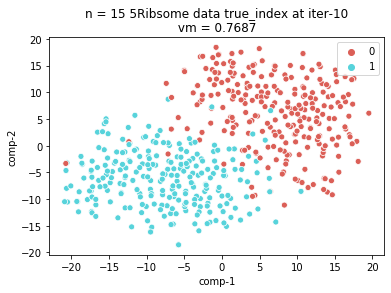

the 0 th iter, ratio = 0.01
output_collection 0-th batch


/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 500 samples in 0.001s...
[t-SNE] Computed neighbors for 500 samples in 0.028s...
[t-SNE] Computed conditional probabilities for sample 500 / 500
[t-SNE] Mean sigma: 0.055460
[t-SNE] KL divergence after 250 iterations with early exaggeration: 79.262619
[t-SNE] KL divergence after 1000 iterations: 1.379356
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


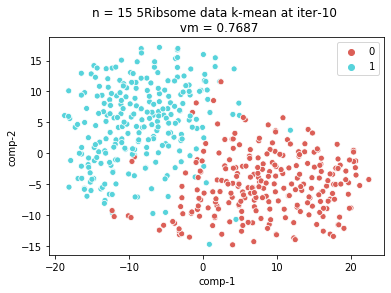

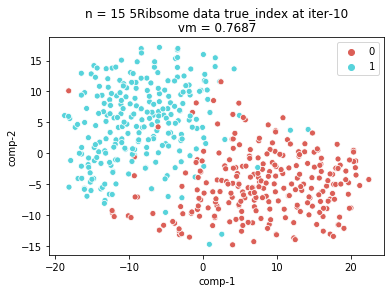

output_collection 0-th batch


/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


output_collection 1-th batch
output_collection 2-th batch
output_collection 3-th batch
output_collection 4-th batch
output_collection 5-th batch
output_collection 6-th batch
output_collection 7-th batch
output_collection 8-th batch
output_collection 9-th batch
output_collection 10-th batch
output_collection 11-th batch
output_collection 12-th batch
output_collection 13-th batch
output_collection 14-th batch
output_collection 15-th batch
output_collection 16-th batch
output_collection 17-th batch
output_collection 18-th batch
output_collection 19-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 10000 samples in 0.020s...
[t-SNE] Computed neighbors for 10000 samples in 5.555s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10000
[t-SNE] Computed conditional probabilities for sample 2000 / 10000
[t-SNE] Computed conditional probabilities for sample 3000 / 10000
[t-SNE] Computed conditional probabilities for sample 4000 / 10000
[t-SNE] Computed conditional

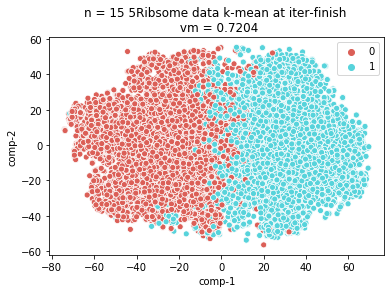

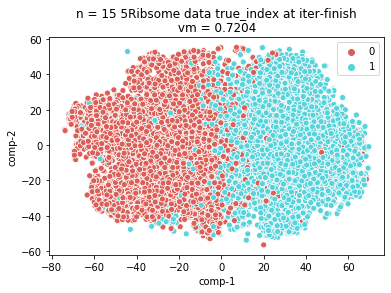

In [55]:
#snr_list = [10, 5, 1, 0.8, 0.6, 0.4, 0.2, 0.1]
snr = 0.2
data_name = f'70s_2class_0304+{snr}'
with open(f'./data/{data_name}/images.pkl', 'rb') as f:
    new_projection = pickle.load( f)

with open(f'./data/{data_name}/angles.pkl', 'rb') as f:
    angles2 = pickle.load( f)

with open(f'./data/{data_name}/orientation_matrix.pkl', 'rb') as f:
    Orientation_Vectors = pickle.load(f)

with open(f'./data/{data_name}/indexs.pkl', 'rb') as f:
    indexs = pickle.load(f)
print('indexs',indexs[:10])     
with open(f'./data/{data_name}/mean_subtracted_strcut.pkl', 'rb') as f:
    mean_subtracted_strcut = pickle.load(f)
    
new_projection = new_projection * mask
print(new_projection.shape)
new_projection = new_projection[:,5:29,5:29]
plt.imshow(new_projection[0])
plt.show()
print(angles2)
n = 15
b = 500
niter = 10
pca_n = 2
Images = new_projection#[:5000]
print(Images.shape)
exp_name = f'20220320_{data_name}_EM_2SDR_n_{n}'
ProjSize, num_image, n_component , num_iter = 24, Images.shape[0], n, niter
batch_size = b
Vol_geom = astra.create_vol_geom(ProjSize, ProjSize, ProjSize)
#Images = torch.ones(num_image, 48, 48) # fake images for computing purpose

vg = ts.from_astra(Vol_geom)
pg = ts.from_astra(Proj_geom)
op = ts.operator(vg, pg)
MP3 = EM_2SDR(ProjSize, num_image, n_component, op , Images,Orientation_Vectors, exp_name,mean_subtracted_strcut, indexs, batch_size, niter, PCA_n= pca_n)
#MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)
#MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)
MP3.Draw_Kmean_tsne('0',num_batch = 3, pca_n = 2)
MP3.fit(0.01, True)
MP3.Draw_Kmean_tsne('finish',num_batch = 20, pca_n = 2)

indexs [1 0 0 1 0 1 1 1 0 0]
(10000, 34, 34)


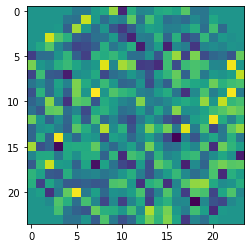

[[5.69900476 2.36181794 1.33668065]
 [3.8449202  1.01322514 3.92741301]
 [2.08653379 1.05372683 0.2092787 ]
 ...
 [5.1035143  1.16980571 3.79910531]
 [3.61021338 0.36882059 4.54483458]
 [2.28557952 0.87806272 3.01661591]]
(10000, 24, 24)
output_collection 0-th batch


/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


output_collection 1-th batch
output_collection 2-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1500 samples in 0.003s...
[t-SNE] Computed neighbors for 1500 samples in 0.229s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1500
[t-SNE] Computed conditional probabilities for sample 1500 / 1500
[t-SNE] Mean sigma: 13.119819
[t-SNE] KL divergence after 250 iterations with early exaggeration: 89.750298
[t-SNE] KL divergence after 1000 iterations: 2.643072
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


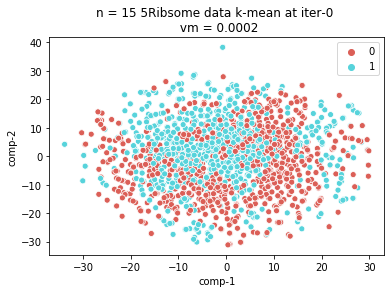

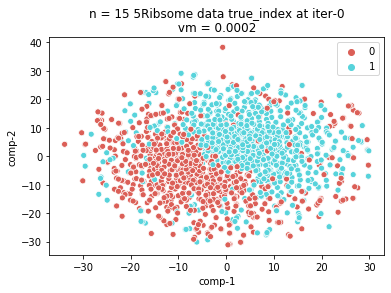

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


679.1566545963287 sec
0 batch 1 iteration
generated


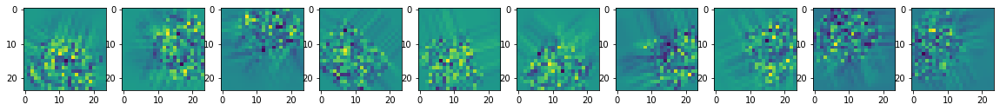

real


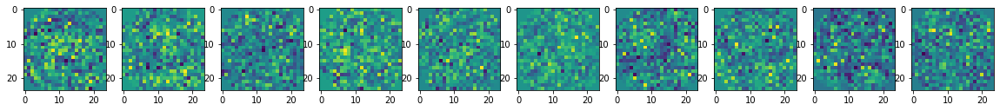

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 500 samples in 0.001s...
[t-SNE] Computed neighbors for 500 samples in 0.032s...
[t-SNE] Computed conditional probabilities for sample 500 / 500
[t-SNE] Mean sigma: 0.678239
[t-SNE] KL divergence after 250 iterations with early exaggeration: 72.047508
[t-SNE] KL divergence after 1000 iterations: 1.080202
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


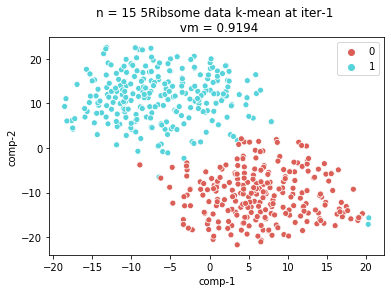

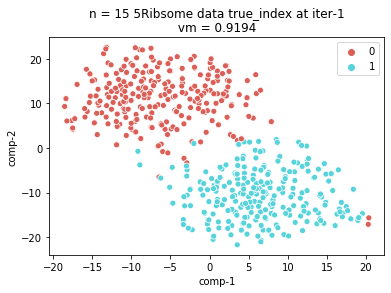

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


731.3934903144836 sec
0 batch 2 iteration
generated


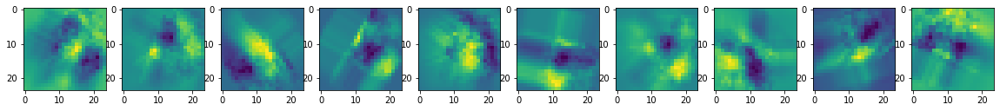

real


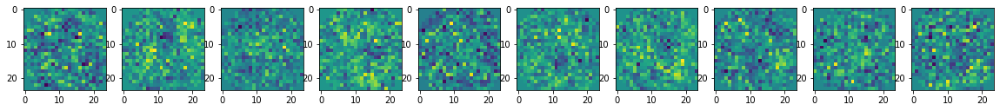

699.3572494983673 sec
0 batch 3 iteration
generated


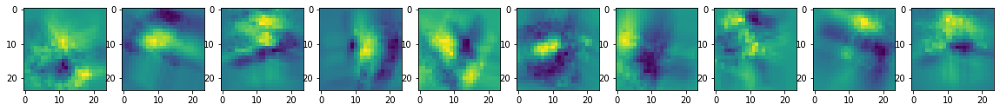

real


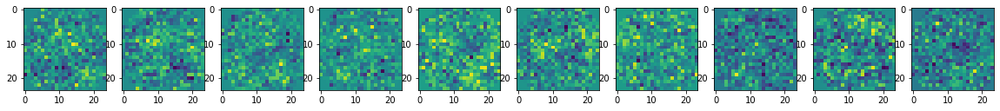

713.6555061340332 sec
0 batch 4 iteration
generated


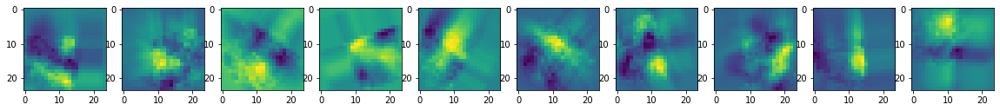

real


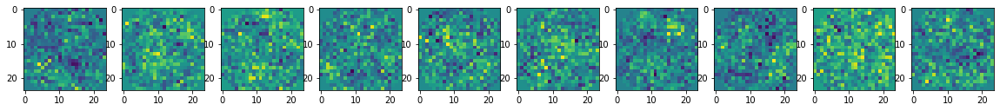

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 500 samples in 0.001s...
[t-SNE] Computed neighbors for 500 samples in 0.022s...
[t-SNE] Computed conditional probabilities for sample 500 / 500
[t-SNE] Mean sigma: 0.116466
[t-SNE] KL divergence after 250 iterations with early exaggeration: 72.482574
[t-SNE] KL divergence after 1000 iterations: 1.101762
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


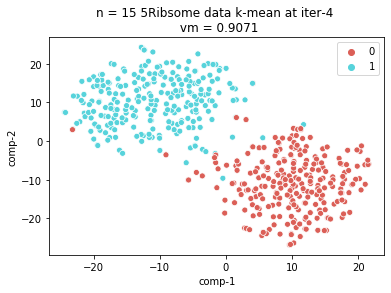

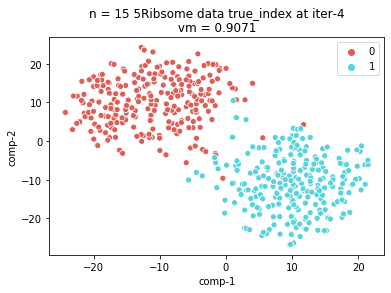

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


694.2777841091156 sec
0 batch 5 iteration
generated


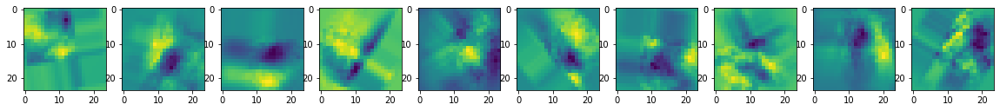

real


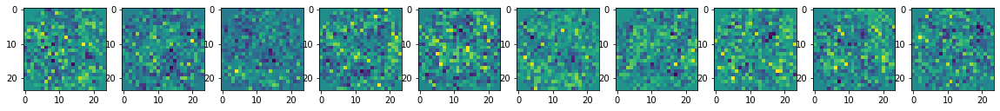

723.0586574077606 sec
0 batch 6 iteration
generated


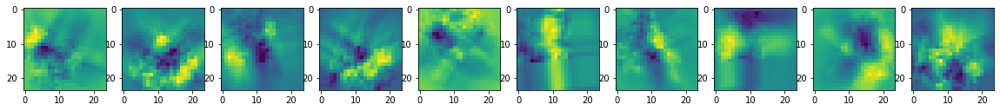

real


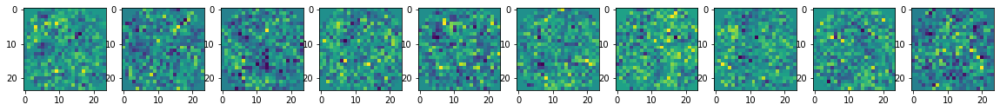

690.1844427585602 sec
0 batch 7 iteration
generated


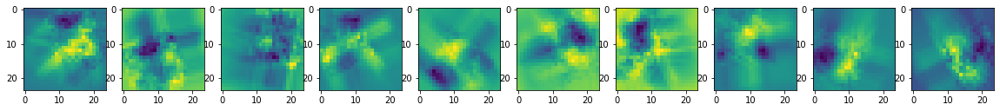

real


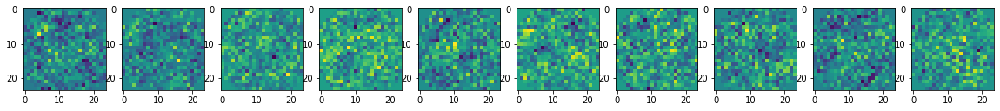

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 500 samples in 0.001s...
[t-SNE] Computed neighbors for 500 samples in 0.023s...
[t-SNE] Computed conditional probabilities for sample 500 / 500
[t-SNE] Mean sigma: 0.115266
[t-SNE] KL divergence after 250 iterations with early exaggeration: 74.005402
[t-SNE] KL divergence after 1000 iterations: 1.138272
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


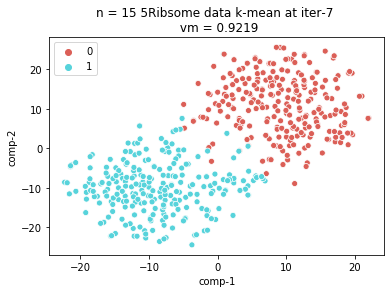

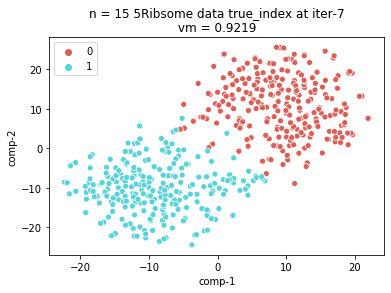

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


706.5809834003448 sec
0 batch 8 iteration
generated


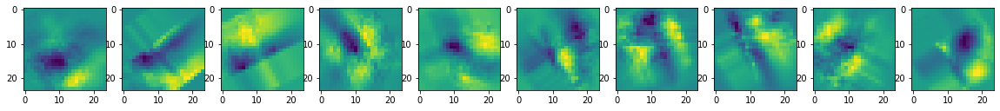

real


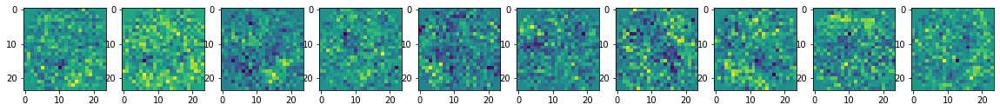

696.3655788898468 sec
0 batch 9 iteration
generated


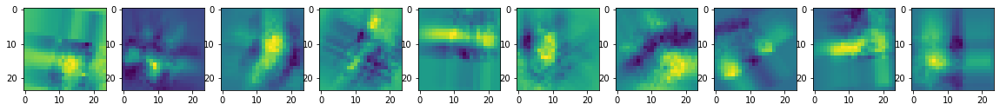

real


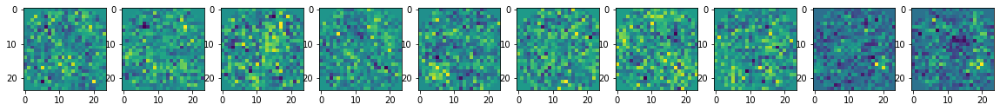

715.8090093135834 sec
0 batch 10 iteration
generated


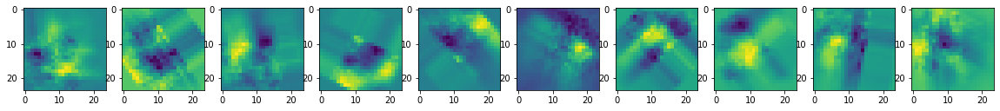

real


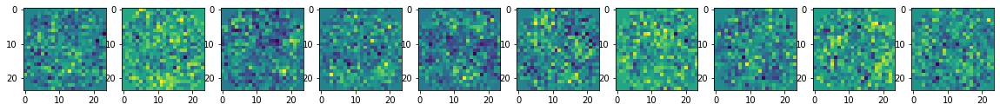

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 500 samples in 0.001s...
[t-SNE] Computed neighbors for 500 samples in 0.023s...
[t-SNE] Computed conditional probabilities for sample 500 / 500
[t-SNE] Mean sigma: 0.112665
[t-SNE] KL divergence after 250 iterations with early exaggeration: 73.030533
[t-SNE] KL divergence after 1000 iterations: 1.133874
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


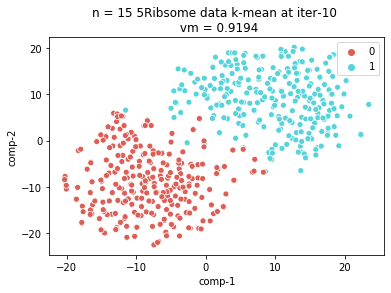

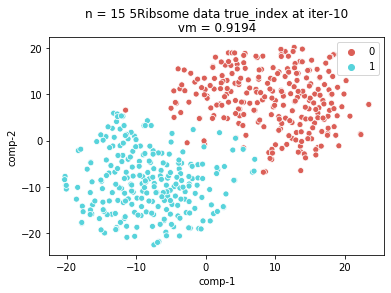

the 0 th iter, ratio = 0.01
output_collection 0-th batch


/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 500 samples in 0.002s...
[t-SNE] Computed neighbors for 500 samples in 0.046s...
[t-SNE] Computed conditional probabilities for sample 500 / 500
[t-SNE] Mean sigma: 0.112665
[t-SNE] KL divergence after 250 iterations with early exaggeration: 72.978973
[t-SNE] KL divergence after 1000 iterations: 1.134792
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


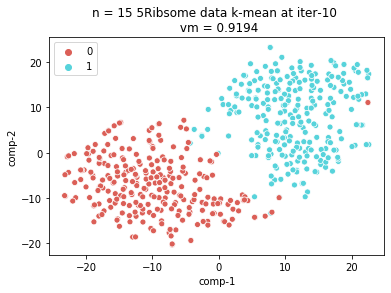

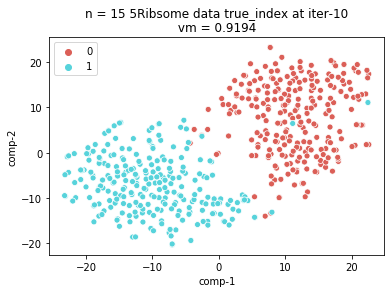

output_collection 0-th batch


/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


output_collection 1-th batch
output_collection 2-th batch
output_collection 3-th batch
output_collection 4-th batch
output_collection 5-th batch
output_collection 6-th batch
output_collection 7-th batch
output_collection 8-th batch
output_collection 9-th batch
output_collection 10-th batch
output_collection 11-th batch
output_collection 12-th batch
output_collection 13-th batch
output_collection 14-th batch
output_collection 15-th batch
output_collection 16-th batch
output_collection 17-th batch
output_collection 18-th batch
output_collection 19-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 10000 samples in 0.010s...
[t-SNE] Computed neighbors for 10000 samples in 5.786s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10000
[t-SNE] Computed conditional probabilities for sample 2000 / 10000
[t-SNE] Computed conditional probabilities for sample 3000 / 10000
[t-SNE] Computed conditional probabilities for sample 4000 / 10000
[t-SNE] Computed conditional

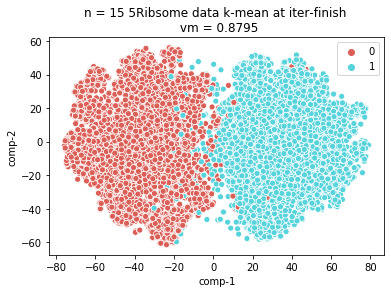

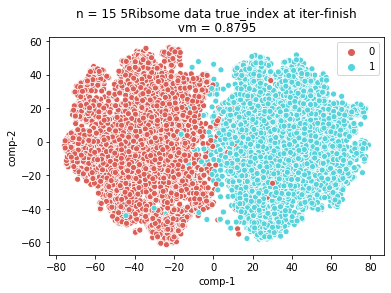

In [54]:
#snr_list = [10, 5, 1, 0.8, 0.6, 0.4, 0.2, 0.1]
snr = 0.4
data_name = f'70s_2class_0304+{snr}'
with open(f'./data/{data_name}/images.pkl', 'rb') as f:
    new_projection = pickle.load( f)

with open(f'./data/{data_name}/angles.pkl', 'rb') as f:
    angles2 = pickle.load( f)

with open(f'./data/{data_name}/orientation_matrix.pkl', 'rb') as f:
    Orientation_Vectors = pickle.load(f)

with open(f'./data/{data_name}/indexs.pkl', 'rb') as f:
    indexs = pickle.load(f)
print('indexs',indexs[:10])     
with open(f'./data/{data_name}/mean_subtracted_strcut.pkl', 'rb') as f:
    mean_subtracted_strcut = pickle.load(f)
    
new_projection = new_projection * mask
print(new_projection.shape)
new_projection = new_projection[:,5:29,5:29]
plt.imshow(new_projection[0])
plt.show()
print(angles2)
n = 15
b = 500
niter = 10
pca_n = 2
Images = new_projection#[:5000]
print(Images.shape)
exp_name = f'20220320_{data_name}_EM_2SDR_n_{n}'
ProjSize, num_image, n_component , num_iter = 24, Images.shape[0], n, niter
batch_size = b
Vol_geom = astra.create_vol_geom(ProjSize, ProjSize, ProjSize)
#Images = torch.ones(num_image, 48, 48) # fake images for computing purpose

vg = ts.from_astra(Vol_geom)
pg = ts.from_astra(Proj_geom)
op = ts.operator(vg, pg)
MP3 = EM_2SDR(ProjSize, num_image, n_component, op , Images,Orientation_Vectors, exp_name,mean_subtracted_strcut, indexs, batch_size, niter, PCA_n= pca_n)
#MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)
#MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)
MP3.Draw_Kmean_tsne('0',num_batch = 3, pca_n = 2)
MP3.fit(0.01, True)
MP3.Draw_Kmean_tsne('finish',num_batch = 20, pca_n = 2)

indexs [1 0 0 1 0 1 1 1 0 0]
(10000, 34, 34)


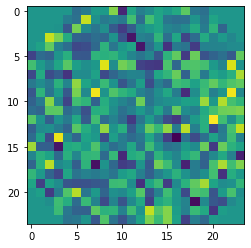

[[1.22033205 0.44589455 0.92191307]
 [3.51748456 1.11410091 2.72257628]
 [0.85711749 1.93464267 3.5095414 ]
 ...
 [3.7557522  0.21954994 5.43311432]
 [6.28011231 2.31567737 0.72182259]
 [3.68202338 0.82216492 5.82720617]]
(10000, 24, 24)
output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 500 samples in 0.001s...
[t-SNE] Computed neighbors for 500 samples in 0.044s...
[t-SNE] Computed conditional probabilities for sample 500 / 500
[t-SNE] Mean sigma: 15.324049
[t-SNE] KL divergence after 250 iterations with early exaggeration: 104.451057
[t-SNE] KL divergence after 1000 iterations: 1.810139
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


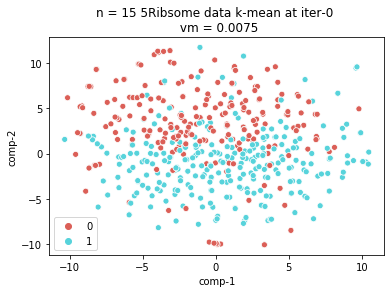

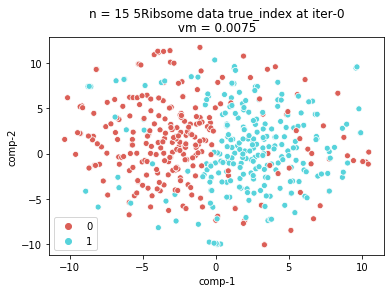

In [53]:
#snr_list = [10, 5, 1, 0.8, 0.6, 0.4, 0.2, 0.1]
snr = 0.6
data_name = f'70s_2class_0304+{snr}'
with open(f'./data/{data_name}/images.pkl', 'rb') as f:
    new_projection = pickle.load( f)

with open(f'./data/{data_name}/angles.pkl', 'rb') as f:
    angles2 = pickle.load( f)

with open(f'./data/{data_name}/orientation_matrix.pkl', 'rb') as f:
    Orientation_Vectors = pickle.load(f)

with open(f'./data/{data_name}/indexs.pkl', 'rb') as f:
    indexs = pickle.load(f)
print('indexs',indexs[:10])     
with open(f'./data/{data_name}/mean_subtracted_strcut.pkl', 'rb') as f:
    mean_subtracted_strcut = pickle.load(f)
    
new_projection = new_projection * mask
print(new_projection.shape)
new_projection = new_projection[:,5:29,5:29]
plt.imshow(new_projection[0])
plt.show()
print(angles2)
n = 15
b = 500
niter = 40
pca_n = 2
Images = new_projection#[:5000]
print(Images.shape)
exp_name = f'20220320_{data_name}_EM_2SDR_n_{n}'
ProjSize, num_image, n_component , num_iter = 24, Images.shape[0], n, niter
batch_size = b
Vol_geom = astra.create_vol_geom(ProjSize, ProjSize, ProjSize)
#Images = torch.ones(num_image, 48, 48) # fake images for computing purpose

vg = ts.from_astra(Vol_geom)
pg = ts.from_astra(Proj_geom)
op = ts.operator(vg, pg)
MP3 = EM_2SDR(ProjSize, num_image, n_component, op , Images,Orientation_Vectors, exp_name,mean_subtracted_strcut, indexs, batch_size, niter, PCA_n= pca_n)
#MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)
#MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)
MP3.Draw_Kmean_tsne('0',num_batch = 1, pca_n = 2)
#MP3.fit(0.01, True)
#MP3.Draw_Kmean_tsne('finish',num_batch = 20, pca_n = 2)

indexs [1 0 0 1 0 1 1 1 0 0]
(10000, 34, 34)


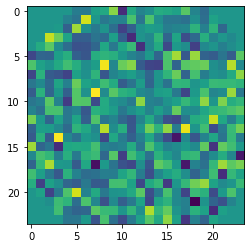

[[3.69580346 0.59551758 4.60979504]
 [3.66267117 0.71039416 3.8941898 ]
 [4.94994662 1.16466973 0.22942753]
 ...
 [3.40407028 1.12754047 1.53671127]
 [3.36284647 0.88774637 4.90507316]
 [1.10436604 1.68281854 2.78723985]]
(10000, 24, 24)


/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


646.3125445842743 sec
0 batch 1 iteration
generated


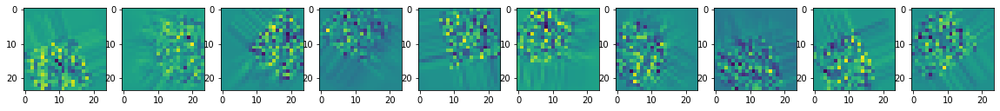

real


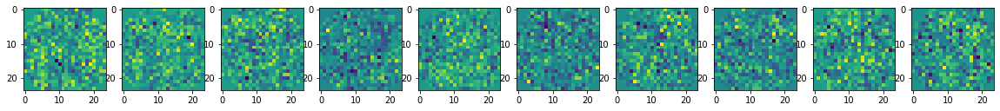

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 500 samples in 0.001s...
[t-SNE] Computed neighbors for 500 samples in 0.042s...
[t-SNE] Computed conditional probabilities for sample 500 / 500
[t-SNE] Mean sigma: 0.299380
[t-SNE] KL divergence after 250 iterations with early exaggeration: 80.741707
[t-SNE] KL divergence after 1000 iterations: 1.330144
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


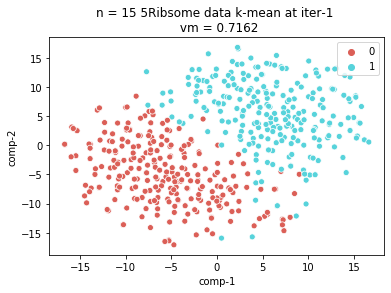

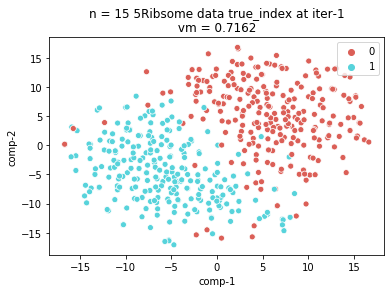

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


697.8499271869659 sec
0 batch 2 iteration
generated


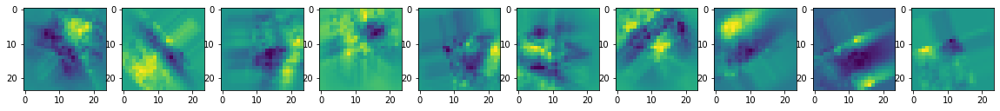

real


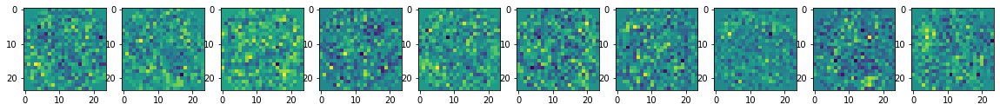

660.137544631958 sec
0 batch 3 iteration
generated


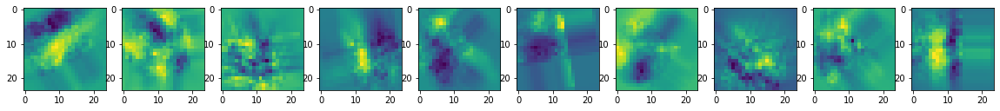

real


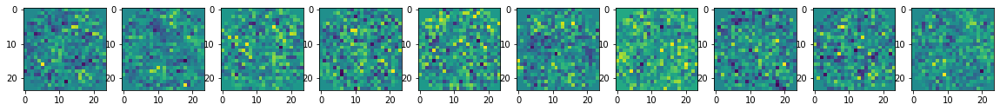

642.2602202892303 sec
0 batch 4 iteration
generated


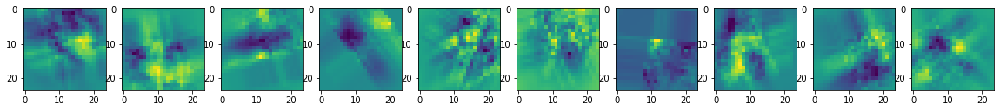

real


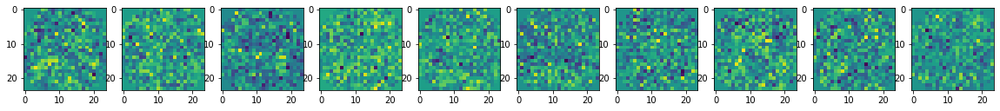

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 500 samples in 0.001s...
[t-SNE] Computed neighbors for 500 samples in 0.044s...
[t-SNE] Computed conditional probabilities for sample 500 / 500
[t-SNE] Mean sigma: 0.056324
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.723564
[t-SNE] KL divergence after 1000 iterations: 1.297950
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


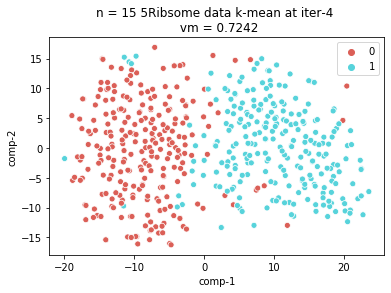

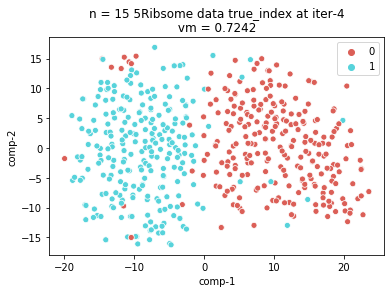

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


672.0771899223328 sec
0 batch 5 iteration
generated


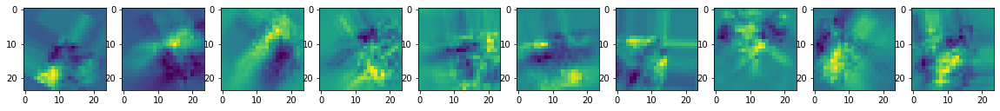

real


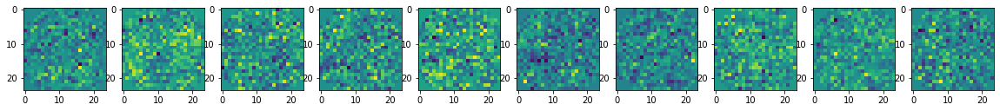

676.1229319572449 sec
0 batch 6 iteration
generated


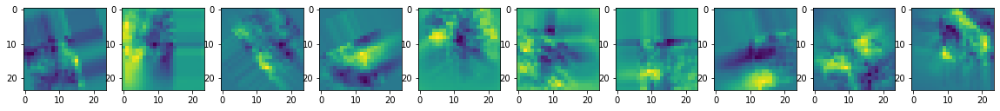

real


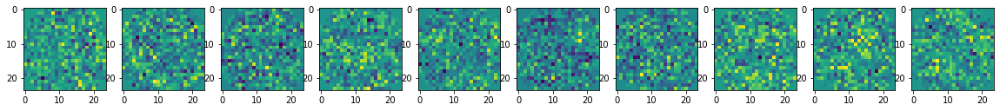

653.5079801082611 sec
0 batch 7 iteration
generated


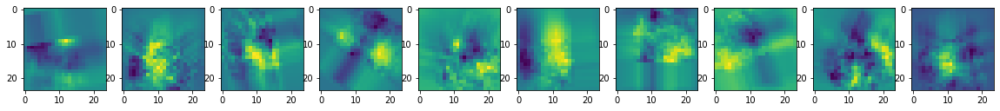

real


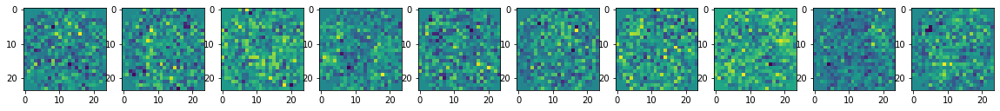

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 500 samples in 0.001s...
[t-SNE] Computed neighbors for 500 samples in 0.041s...
[t-SNE] Computed conditional probabilities for sample 500 / 500
[t-SNE] Mean sigma: 0.055933
[t-SNE] KL divergence after 250 iterations with early exaggeration: 79.465408
[t-SNE] KL divergence after 1000 iterations: 1.318309
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


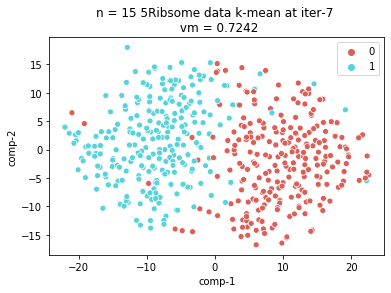

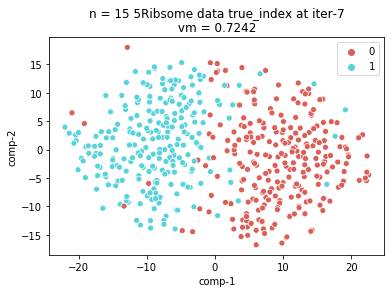

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


KeyboardInterrupt: 

In [49]:
#snr_list = [10, 5, 1, 0.8, 0.6, 0.4, 0.2, 0.1]
snr = 0.2
data_name = f'70s_2class_0304+{snr}'
with open(f'./data/{data_name}/images.pkl', 'rb') as f:
    new_projection = pickle.load( f)

with open(f'./data/{data_name}/angles.pkl', 'rb') as f:
    angles2 = pickle.load( f)

with open(f'./data/{data_name}/orientation_matrix.pkl', 'rb') as f:
    Orientation_Vectors = pickle.load(f)

with open(f'./data/{data_name}/indexs.pkl', 'rb') as f:
    indexs = pickle.load(f)
print('indexs',indexs[:10])     
with open(f'./data/{data_name}/mean_subtracted_strcut.pkl', 'rb') as f:
    mean_subtracted_strcut = pickle.load(f)
    
new_projection = new_projection * mask
print(new_projection.shape)
new_projection = new_projection[:,5:29,5:29]
plt.imshow(new_projection[0])
plt.show()
print(angles2)
n = 15
b = 500
niter = 20
pca_n = 2
Images = new_projection#[:5000]
print(Images.shape)
exp_name = f'20220320_{data_name}_EM_2SDR_n_{n}'
ProjSize, num_image, n_component , num_iter = 24, Images.shape[0], n, niter
batch_size = b
Vol_geom = astra.create_vol_geom(ProjSize, ProjSize, ProjSize)
#Images = torch.ones(num_image, 48, 48) # fake images for computing purpose

vg = ts.from_astra(Vol_geom)p
pg = ts.from_astra(Proj_geom)
op = ts.operator(vg, pg)
MP3 = EM_2SDR(ProjSize, num_image, n_component, op , Images,Orientation_Vectors, exp_name,mean_subtracted_strcut, indexs, batch_size, niter, PCA_n= pca_n)
#MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)
#MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)
MP3.fit(0.01, True)


output_collection 0-th batch
output_collection 1-th batch
output_collection 2-th batch
output_collection 3-th batch
output_collection 4-th batch
output_collection 5-th batch
output_collection 6-th batch
output_collection 7-th batch
output_collection 8-th batch
output_collection 9-th batch
output_collection 10-th batch
output_collection 11-th batch
output_collection 12-th batch
output_collection 13-th batch
output_collection 14-th batch
output_collection 15-th batch
output_collection 16-th batch
output_collection 17-th batch
output_collection 18-th batch
output_collection 19-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 10000 samples in 0.011s...
[t-SNE] Computed neighbors for 10000 samples in 5.178s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10000
[t-SNE] Computed conditional probabilities for sample 2000 / 10000
[t-SNE] Computed conditional probabilities for sample 3000 / 10000
[t-SNE] Computed conditional probabilities for sample 4000 / 10000

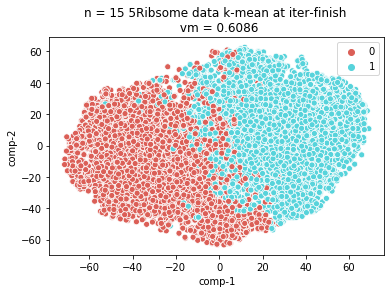

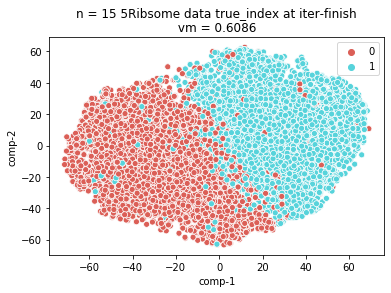

In [50]:
MP3.Draw_Kmean_tsne('finish',num_batch = 20, pca_n = 2)

indexs [1 0 0 1 0 1 1 1 0 0]
(10000, 34, 34)


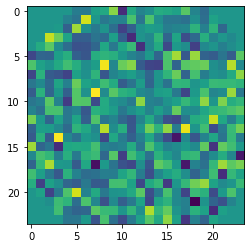

[[3.69580346 0.59551758 4.60979504]
 [3.66267117 0.71039416 3.8941898 ]
 [4.94994662 1.16466973 0.22942753]
 ...
 [3.40407028 1.12754047 1.53671127]
 [3.36284647 0.88774637 4.90507316]
 [1.10436604 1.68281854 2.78723985]]
(10000, 24, 24)


/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


KeyboardInterrupt: 

In [52]:
#snr_list = [10, 5, 1, 0.8, 0.6, 0.4, 0.2, 0.1]
snr = 0.2
data_name = f'70s_2class_0304+{snr}'
with open(f'./data/{data_name}/images.pkl', 'rb') as f:
    new_projection = pickle.load( f)

with open(f'./data/{data_name}/angles.pkl', 'rb') as f:
    angles2 = pickle.load( f)

with open(f'./data/{data_name}/orientation_matrix.pkl', 'rb') as f:
    Orientation_Vectors = pickle.load(f)

with open(f'./data/{data_name}/indexs.pkl', 'rb') as f:
    indexs = pickle.load(f)
print('indexs',indexs[:10])     
with open(f'./data/{data_name}/mean_subtracted_strcut.pkl', 'rb') as f:
    mean_subtracted_strcut = pickle.load(f)
    
new_projection = new_projection * mask
print(new_projection.shape)
new_projection = new_projection[:,5:29,5:29]
plt.imshow(new_projection[0])
plt.show()
print(angles2)
n = 15
b = 500
niter = 20
pca_n = 2
Images = new_projection#[:5000]
print(Images.shape)
exp_name = f'20220320_{data_name}_EM_2SDR_n_{n}'
ProjSize, num_image, n_component , num_iter = 24, Images.shape[0], n, niter
batch_size = b
Vol_geom = astra.create_vol_geom(ProjSize, ProjSize, ProjSize)
#Images = torch.ones(num_image, 48, 48) # fake images for computing purpose

vg = ts.from_astra(Vol_geom)
pg = ts.from_astra(Proj_geom)
op = ts.operator(vg, pg)
MP3 = EM_2SDR(ProjSize, num_image, n_component, op , Images,Orientation_Vectors, exp_name,mean_subtracted_strcut, indexs, batch_size, niter, PCA_n= pca_n)
#MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)
#MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)
MP3.fit(0.01, True)
MP3.Draw_Kmean_tsne('finish',num_batch = 20, pca_n = 2)

indexs [1 0 0 1 0 1 1 1 0 0]
(10000, 34, 34)


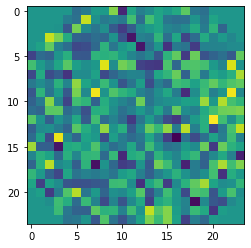

[[1.22033205 0.44589455 0.92191307]
 [3.51748456 1.11410091 2.72257628]
 [0.85711749 1.93464267 3.5095414 ]
 ...
 [3.7557522  0.21954994 5.43311432]
 [6.28011231 2.31567737 0.72182259]
 [3.68202338 0.82216492 5.82720617]]
(10000, 24, 24)


/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


650.450037240982 sec
0 batch 1 iteration
generated


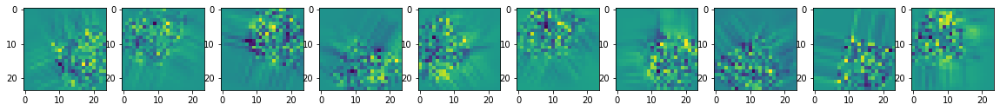

real


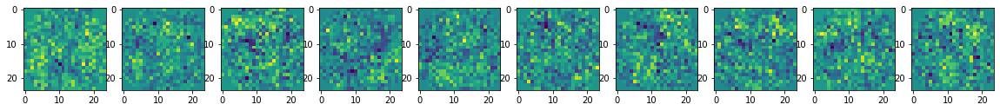

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 500 samples in 0.002s...
[t-SNE] Computed neighbors for 500 samples in 0.046s...
[t-SNE] Computed conditional probabilities for sample 500 / 500
[t-SNE] Mean sigma: 1.111054
[t-SNE] KL divergence after 250 iterations with early exaggeration: 70.734337
[t-SNE] KL divergence after 1000 iterations: 1.019330
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


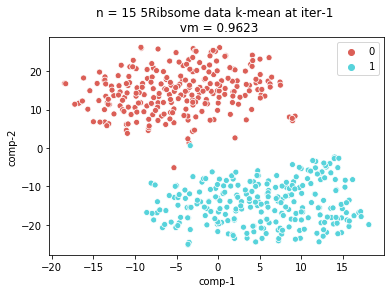

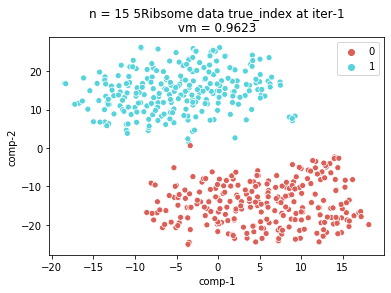

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


662.1166350841522 sec
0 batch 2 iteration
generated


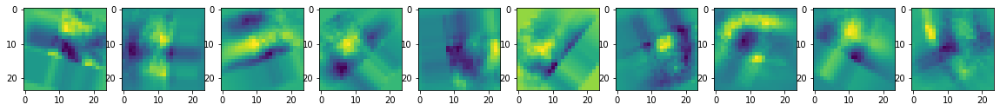

real


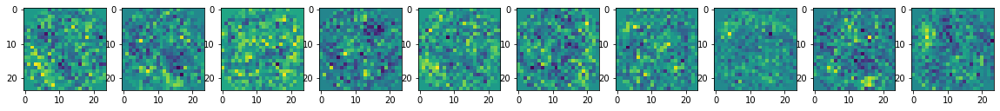

685.6445620059967 sec
0 batch 3 iteration
generated


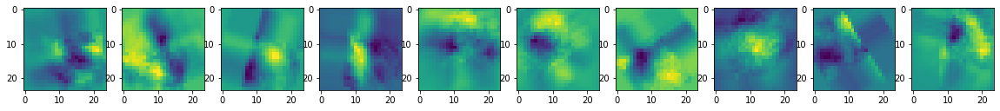

real


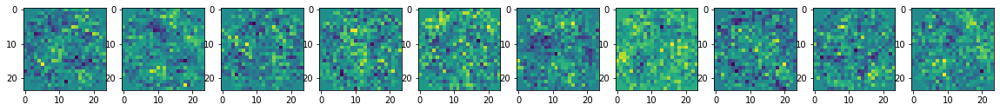

672.0707850456238 sec
0 batch 4 iteration
generated


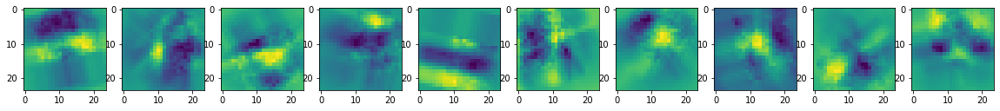

real


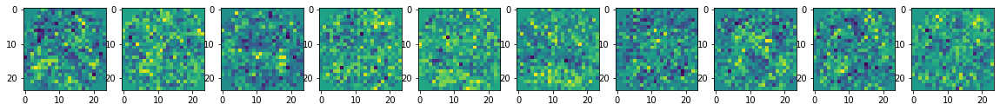

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 500 samples in 0.002s...
[t-SNE] Computed neighbors for 500 samples in 0.046s...
[t-SNE] Computed conditional probabilities for sample 500 / 500
[t-SNE] Mean sigma: 0.182794
[t-SNE] KL divergence after 250 iterations with early exaggeration: 73.801666
[t-SNE] KL divergence after 1000 iterations: 1.050528
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


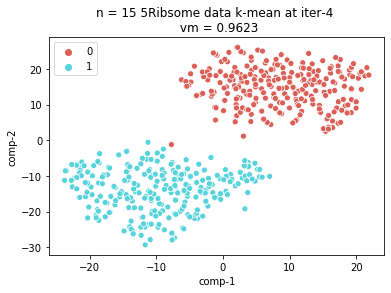

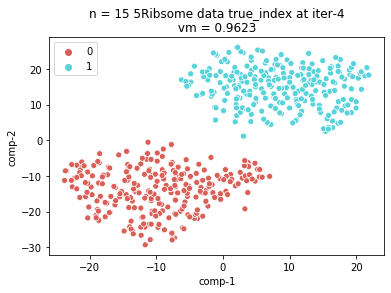

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


654.527843952179 sec
0 batch 5 iteration
generated


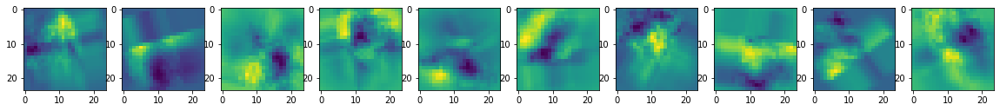

real


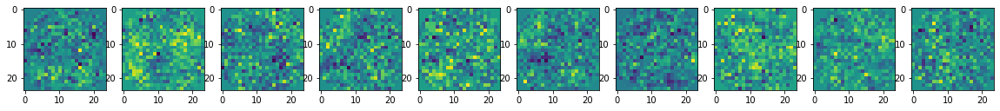

686.8105766773224 sec
0 batch 6 iteration
generated


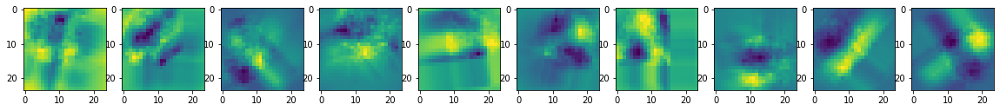

real


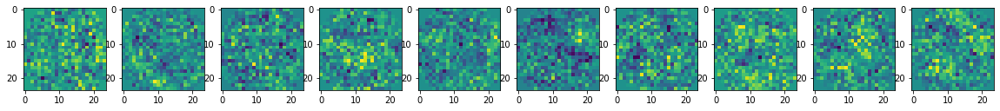

638.9224281311035 sec
0 batch 7 iteration
generated


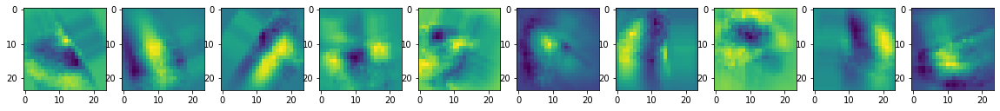

real


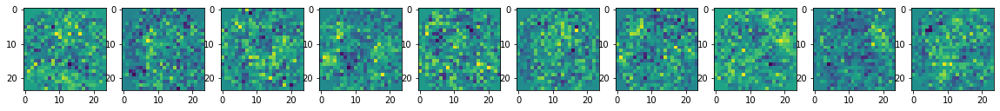

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 500 samples in 0.002s...
[t-SNE] Computed neighbors for 500 samples in 0.043s...
[t-SNE] Computed conditional probabilities for sample 500 / 500
[t-SNE] Mean sigma: 0.179835
[t-SNE] KL divergence after 250 iterations with early exaggeration: 69.084373
[t-SNE] KL divergence after 1000 iterations: 1.066889
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


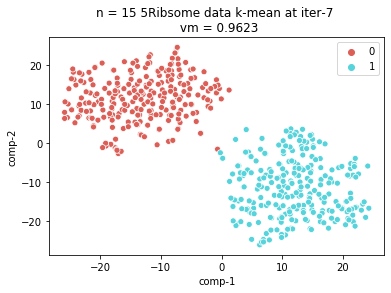

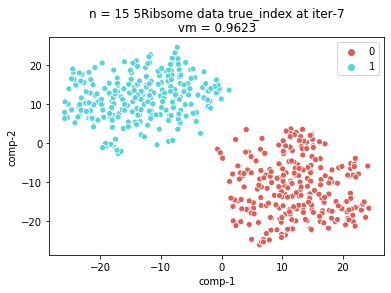

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


KeyboardInterrupt: 

In [31]:
#snr_list = [10, 5, 1, 0.8, 0.6, 0.4, 0.2, 0.1]
snr = 0.6
data_name = f'70s_2class_0304+{snr}'
with open(f'./data/{data_name}/images.pkl', 'rb') as f:
    new_projection = pickle.load( f)

with open(f'./data/{data_name}/angles.pkl', 'rb') as f:
    angles2 = pickle.load( f)

with open(f'./data/{data_name}/orientation_matrix.pkl', 'rb') as f:
    Orientation_Vectors = pickle.load(f)

with open(f'./data/{data_name}/indexs.pkl', 'rb') as f:
    indexs = pickle.load(f)
print('indexs',indexs[:10])     
with open(f'./data/{data_name}/mean_subtracted_strcut.pkl', 'rb') as f:
    mean_subtracted_strcut = pickle.load(f)
    
new_projection = new_projection * mask
print(new_projection.shape)
new_projection = new_projection[:,5:29,5:29]
plt.imshow(new_projection[0])
plt.show()
print(angles2)
n = 15
b = 500
niter = 40
pca_n = 2
Images = new_projection#[:5000]
print(Images.shape)
exp_name = f'20220320_{data_name}_EM_2SDR_n_{n}'
ProjSize, num_image, n_component , num_iter = 24, Images.shape[0], n, niter
batch_size = b
Vol_geom = astra.create_vol_geom(ProjSize, ProjSize, ProjSize)
#Images = torch.ones(num_image, 48, 48) # fake images for computing purpose

vg = ts.from_astra(Vol_geom)
pg = ts.from_astra(Proj_geom)
op = ts.operator(vg, pg)
MP3 = EM_2SDR(ProjSize, num_image, n_component, op , Images,Orientation_Vectors, exp_name,mean_subtracted_strcut, indexs, batch_size, niter, PCA_n= pca_n)
#MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)
#MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)

MP3.fit(0.01, True)
MP3.Draw_Kmean_tsne('finish',num_batch = 20, pca_n = 2)

In [32]:
MP3.Draw_Kmean_tsne('finish',num_batch = 20, pca_n = 2)

output_collection 0-th batch
output_collection 1-th batch
output_collection 2-th batch
output_collection 3-th batch
output_collection 4-th batch
output_collection 5-th batch
output_collection 6-th batch
output_collection 7-th batch
output_collection 8-th batch
output_collection 9-th batch
output_collection 10-th batch
output_collection 11-th batch
output_collection 12-th batch
output_collection 13-th batch
output_collection 14-th batch
output_collection 15-th batch
output_collection 16-th batch
output_collection 17-th batch
output_collection 18-th batch
output_collection 19-th batch
output_collection 20-th batch


Exception: Unable to initialize Projector3D.

In [43]:
indexs #= true_index[:num_batch * self.batch_size]
np.random.seed(0)
with open('./snap_shot/20220320_70s_2class_0304+0.6_EM_2SDR_n_15_all_mu_finish_19_batch.pkl', 'rb') as f:
    All_mu = pickle.load(f)
Coef = np.array(All_mu)
print(Coef.shape)
pca_n = 2
tsne = TSNE(n_components=2, verbose=1, random_state=123)
Coef = Coef.reshape(Coef.shape[0], -1)
pca = PCA(n_components=30)
pca.fit(Coef)
P_Coef = pca.transform(Coef)
P_Coef = P_Coef
PCs = pca.components_
#Save components

z = tsne.fit_transform(P_Coef) 



(10000, 3375, 1)
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 10000 samples in 0.016s...
[t-SNE] Computed neighbors for 10000 samples in 4.562s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10000
[t-SNE] Computed conditional probabilities for sample 2000 / 10000
[t-SNE] Computed conditional probabilities for sample 3000 / 10000
[t-SNE] Computed conditional probabilities for sample 4000 / 10000
[t-SNE] Computed conditional probabilities for sample 5000 / 10000
[t-SNE] Computed conditional probabilities for sample 6000 / 10000
[t-SNE] Computed conditional probabilities for sample 7000 / 10000
[t-SNE] Computed conditional probabilities for sample 8000 / 10000
[t-SNE] Computed conditional probabilities for sample 9000 / 10000
[t-SNE] Computed conditional probabilities for sample 10000 / 10000
[t-SNE] Mean sigma: 0.118041
[t-SNE] KL divergence after 250 iterations with early exaggeration: 89.148239
[t-SNE] KL divergence after 1000 iterations: 2.445990


NameError: name 'self' is not defined

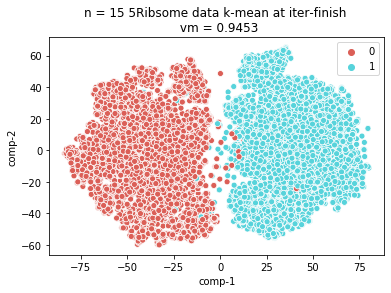

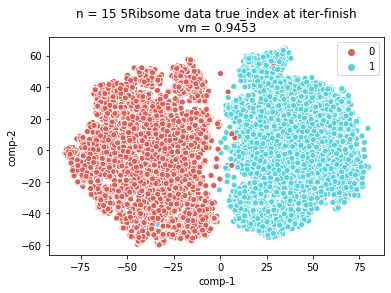

In [48]:
z_size = 15
iter_ ='finish'
kmeans = KMeans(n_clusters=pca_n, random_state=0).fit(P_Coef) #k-mean perform on PCA coef
kmeans.labels_
vs = v_measure_score(indexs, kmeans.labels_)
df = pd.DataFrame()
df["y"] = kmeans.labels_
df["comp-1"] = z[:,0]
df["comp-2"] = z[:,1]

sns.scatterplot(x="comp-1", y="comp-2", hue=df.y.tolist(),
                palette=sns.color_palette("hls", pca_n),
                data=df).set(title=f"n = {z_size} 5Ribsome data k-mean at iter-{iter_} \n vm = {str(vs)[:6]}") 
plt.show()

plt.close()
# print(indexs[:10])
df = pd.DataFrame()
df["y"] = indexs
df["comp-1"] = z[:,0]
df["comp-2"] = z[:,1]

sns.scatterplot(x="comp-1", y="comp-2", hue=df.y.tolist(),
                palette=sns.color_palette("hls", pca_n),
                data=df).set(title=f"n = {z_size} 5Ribsome data true_index at iter-{iter_}\n vm = {str(vs)[:6]} ") 
plt.show()
plt.close()

indexs [1 0 0 1 0 1 1 1 0 0]
(10000, 34, 34)


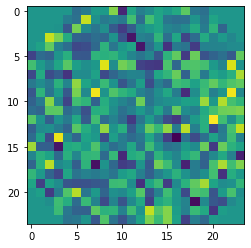

[[1.22033205 0.44589455 0.92191307]
 [3.51748456 1.11410091 2.72257628]
 [0.85711749 1.93464267 3.5095414 ]
 ...
 [3.7557522  0.21954994 5.43311432]
 [6.28011231 2.31567737 0.72182259]
 [3.68202338 0.82216492 5.82720617]]
(10000, 24, 24)


/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


324.5684633255005 sec
0 batch 1 iteration
generated


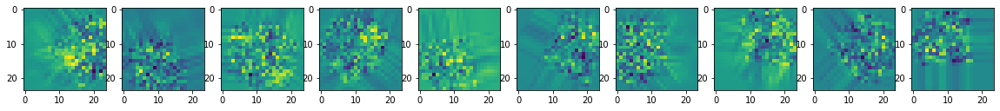

real


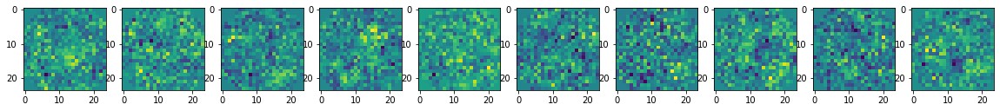

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 1.691553
[t-SNE] KL divergence after 250 iterations with early exaggeration: 63.099918
[t-SNE] KL divergence after 800 iterations: 0.628082
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


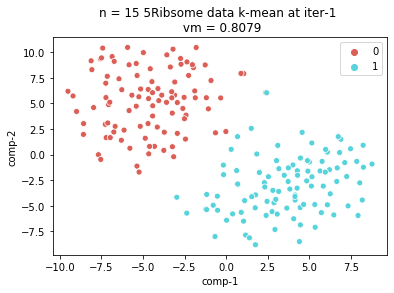

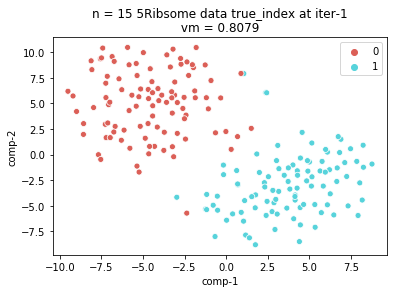

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


312.36332154273987 sec
0 batch 2 iteration
generated


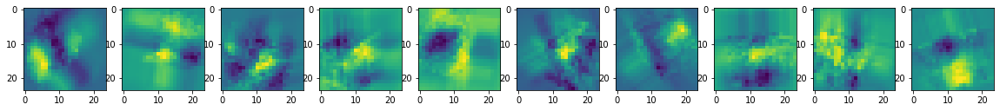

real


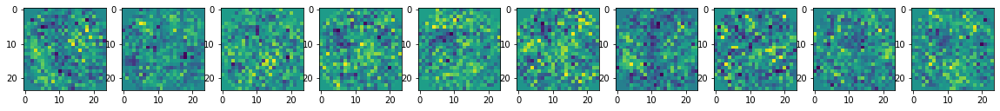

342.1779284477234 sec
0 batch 3 iteration
generated


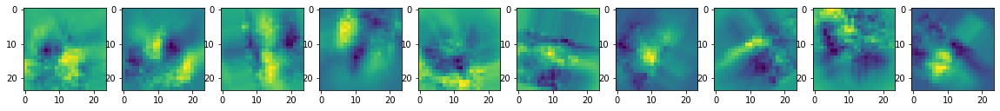

real


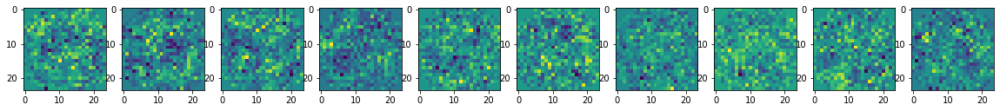

346.4206168651581 sec
0 batch 4 iteration
generated


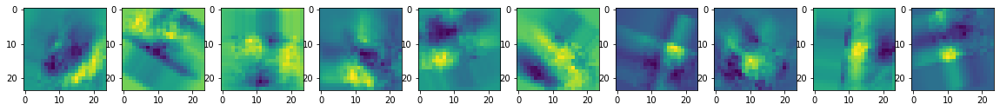

real


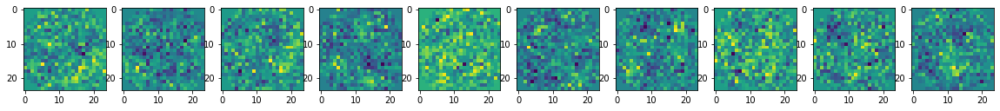

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.259114
[t-SNE] KL divergence after 250 iterations with early exaggeration: 63.542084
[t-SNE] KL divergence after 1000 iterations: 0.630388
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


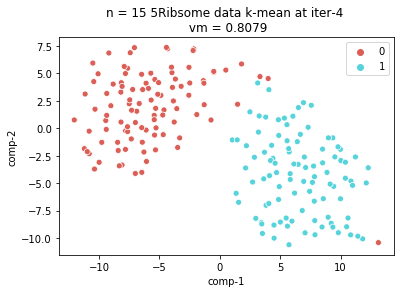

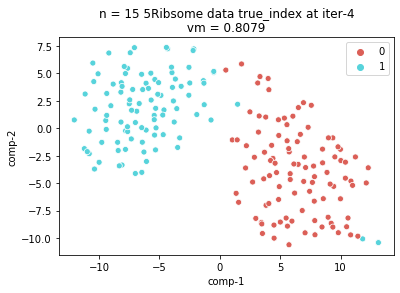

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


316.6103377342224 sec
0 batch 5 iteration
generated


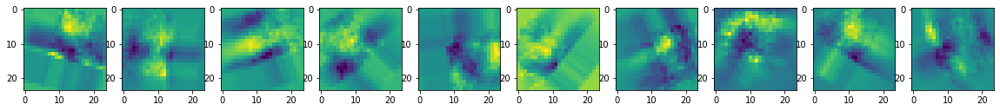

real


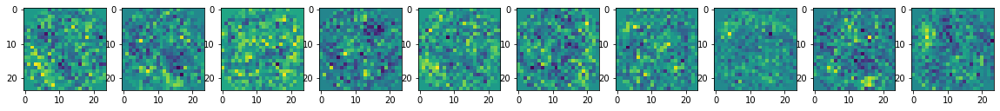

330.65205335617065 sec
0 batch 6 iteration
generated


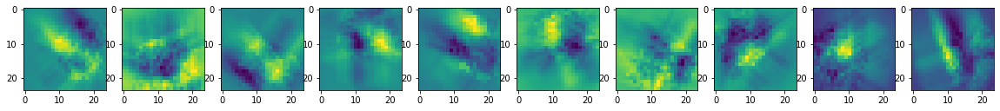

real


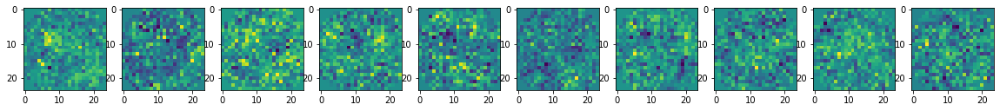

314.0275568962097 sec
0 batch 7 iteration
generated


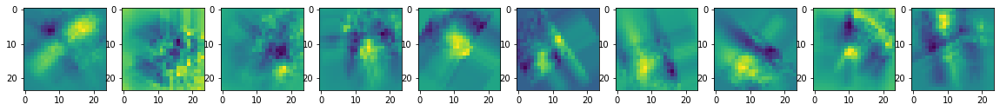

real


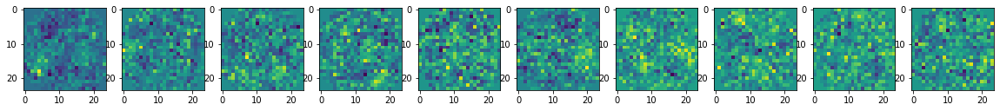

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.007s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.251629
[t-SNE] KL divergence after 250 iterations with early exaggeration: 66.058037
[t-SNE] KL divergence after 1000 iterations: 0.668781
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


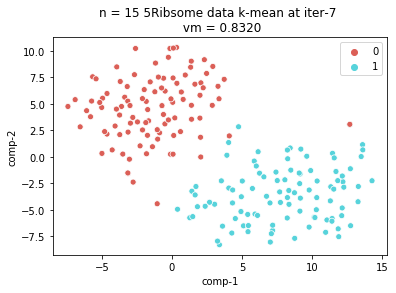

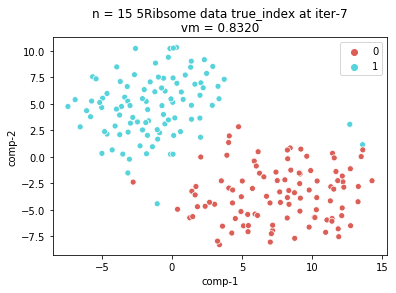

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


332.3450286388397 sec
0 batch 8 iteration
generated


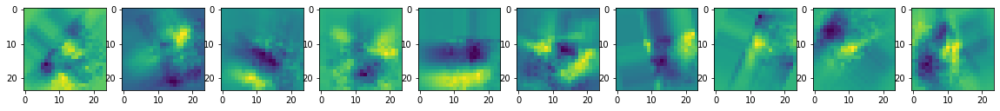

real


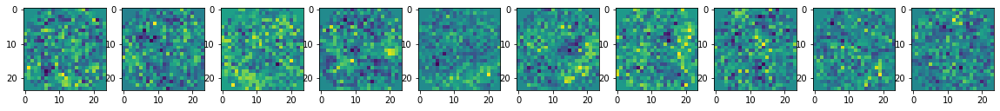

314.94419622421265 sec
0 batch 9 iteration
generated


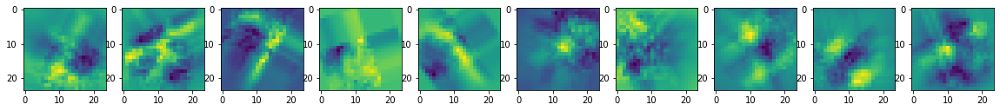

real


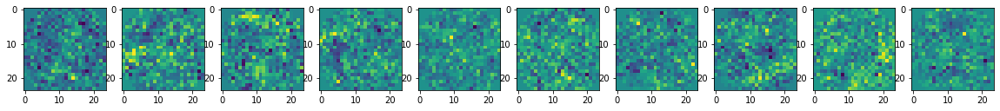

344.82627534866333 sec
0 batch 10 iteration
generated


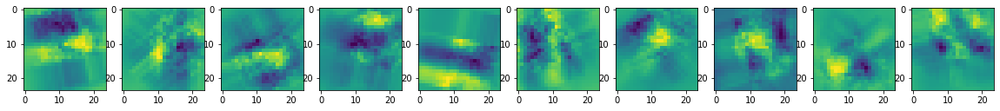

real


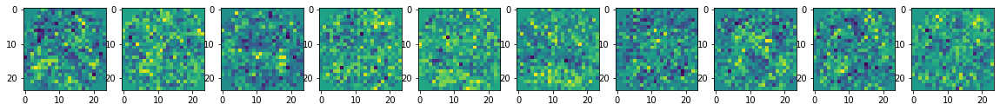

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.002s...
[t-SNE] Computed neighbors for 200 samples in 0.012s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.244338
[t-SNE] KL divergence after 250 iterations with early exaggeration: 66.246849
[t-SNE] KL divergence after 950 iterations: 0.678856
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


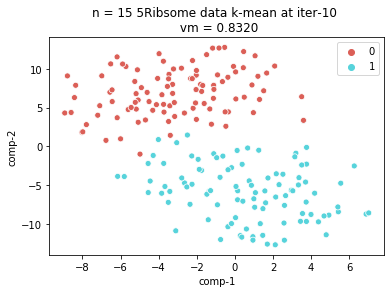

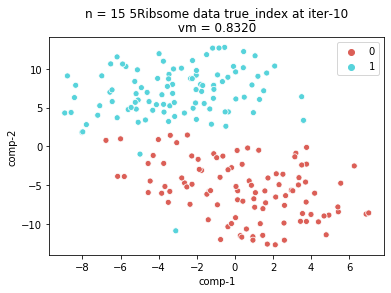

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


355.45901799201965 sec
0 batch 11 iteration
generated


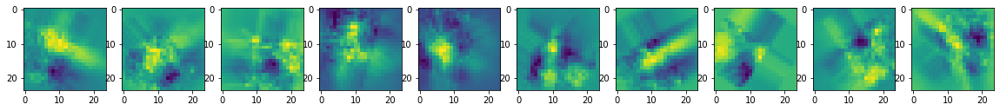

real


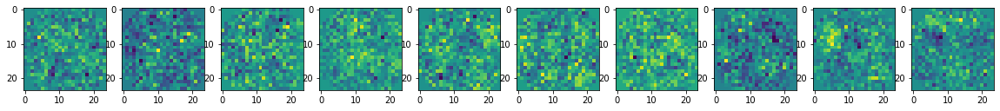

347.7531416416168 sec
0 batch 12 iteration
generated


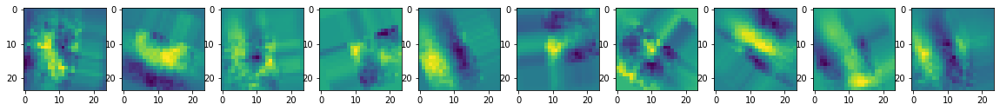

real


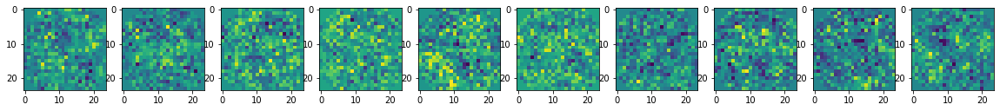

341.9941461086273 sec
0 batch 13 iteration
generated


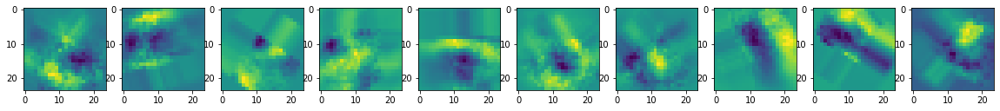

real


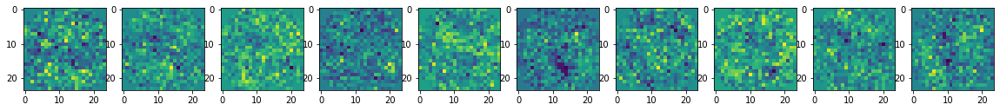

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.007s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.238662
[t-SNE] KL divergence after 250 iterations with early exaggeration: 65.990082
[t-SNE] KL divergence after 1000 iterations: 0.718042
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


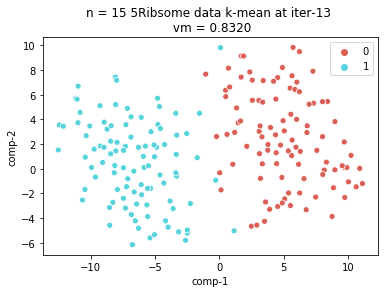

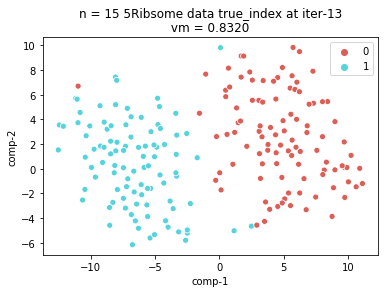

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


340.7852318286896 sec
0 batch 14 iteration
generated


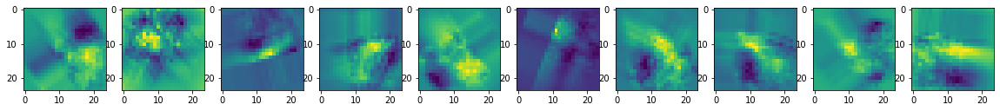

real


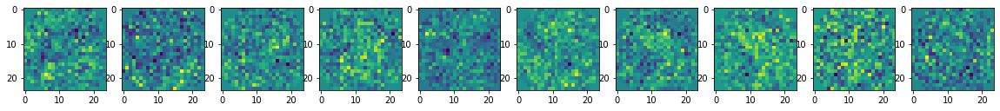

338.8223958015442 sec
0 batch 15 iteration
generated


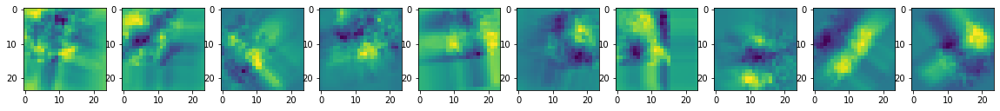

real


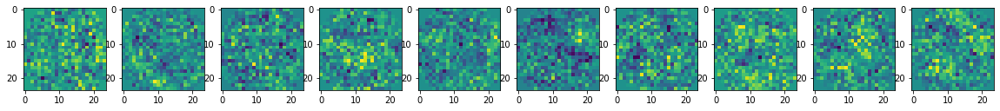

359.4533724784851 sec
0 batch 16 iteration
generated


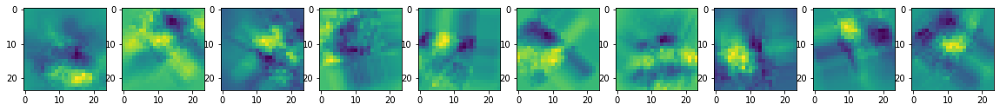

real


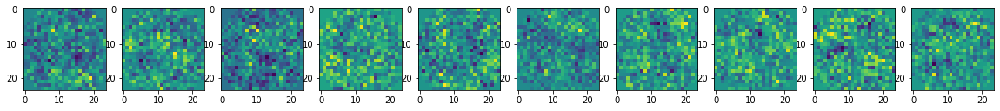

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.012s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.224000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 63.722557
[t-SNE] KL divergence after 900 iterations: 0.737381
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


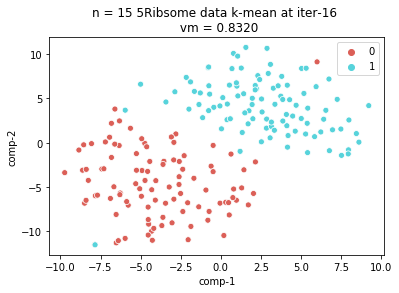

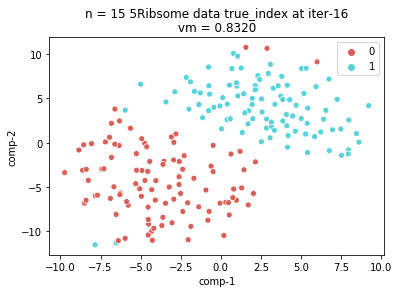

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


339.6924641132355 sec
0 batch 17 iteration
generated


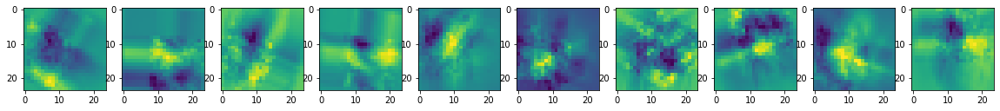

real


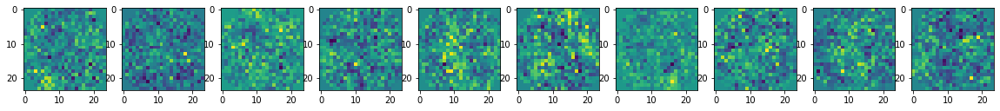

321.1547939777374 sec
0 batch 18 iteration
generated


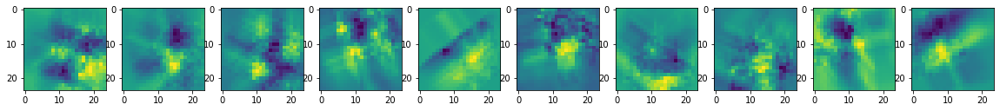

real


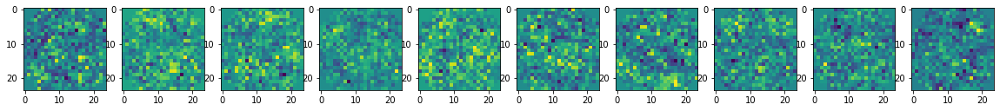

324.3372206687927 sec
0 batch 19 iteration
generated


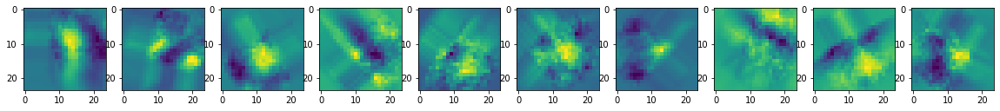

real


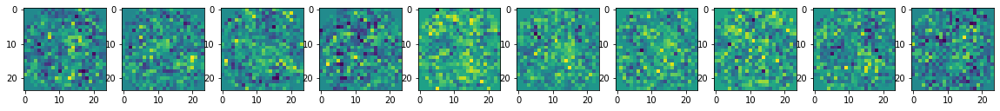

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.007s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.226066
[t-SNE] KL divergence after 250 iterations with early exaggeration: 65.810616
[t-SNE] KL divergence after 1000 iterations: 0.746723
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


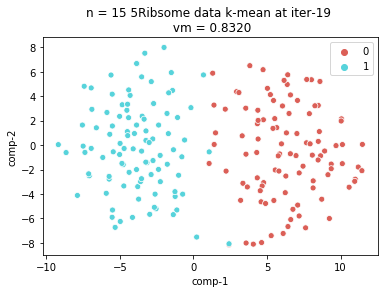

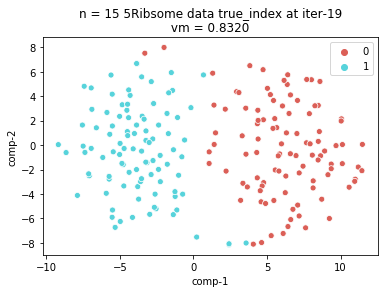

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


319.96345257759094 sec
0 batch 20 iteration
generated


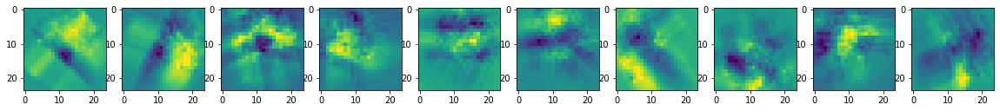

real


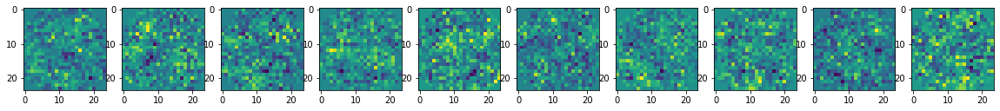

318.62198853492737 sec
0 batch 21 iteration
generated


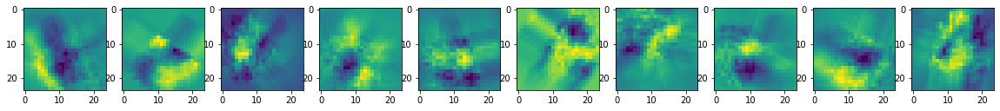

real


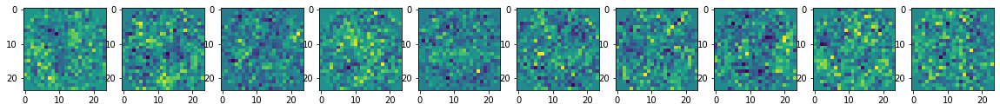

316.3569145202637 sec
0 batch 22 iteration
generated


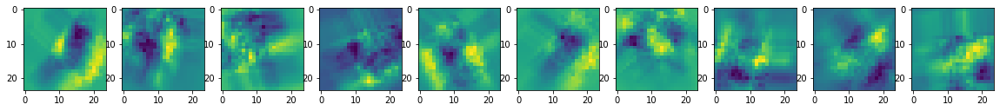

real


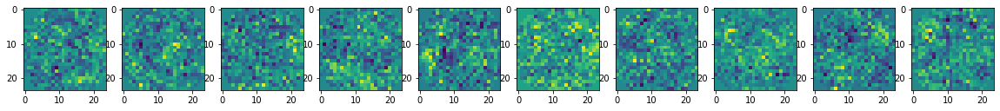

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.006s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.216098
[t-SNE] KL divergence after 250 iterations with early exaggeration: 67.476219
[t-SNE] KL divergence after 1000 iterations: 0.726926
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


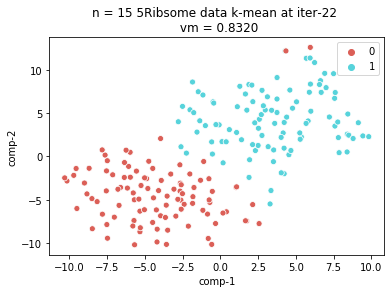

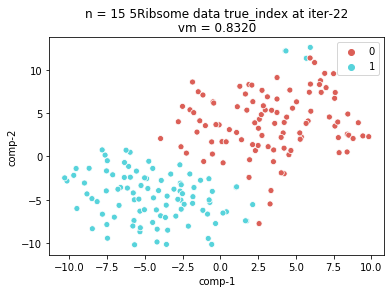

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


323.86576080322266 sec
0 batch 23 iteration
generated


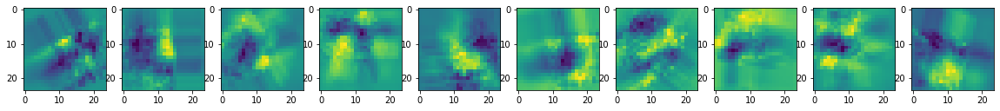

real


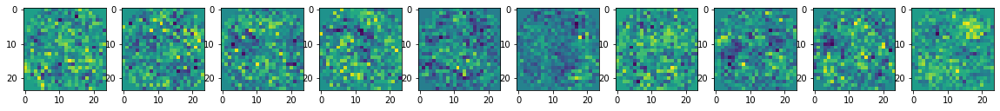

341.2324905395508 sec
0 batch 24 iteration
generated


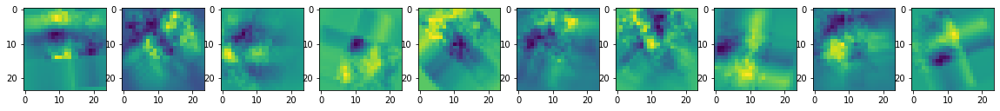

real


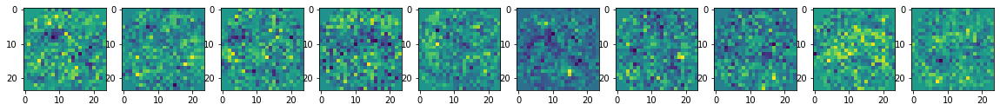

330.2059214115143 sec
0 batch 25 iteration
generated


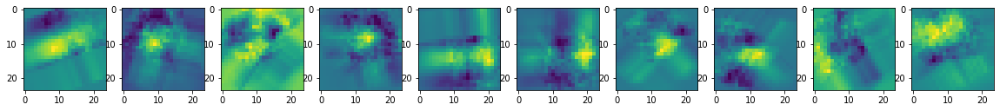

real


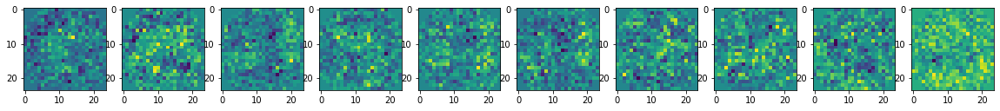

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.210629
[t-SNE] KL divergence after 250 iterations with early exaggeration: 63.587975
[t-SNE] KL divergence after 1000 iterations: 0.719398
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


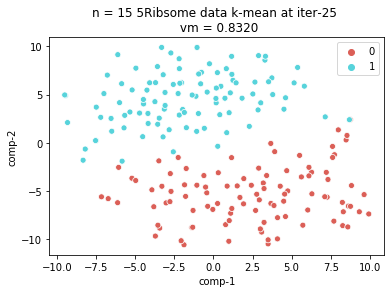

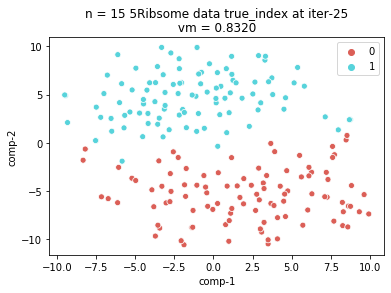

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


316.83356857299805 sec
0 batch 26 iteration
generated


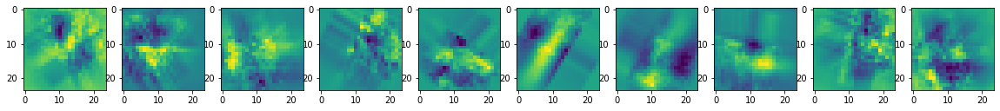

real


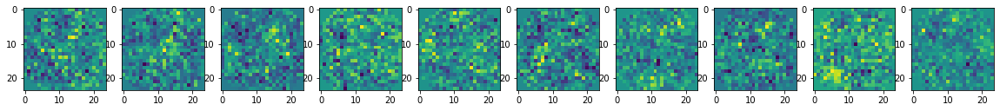

314.0167500972748 sec
0 batch 27 iteration
generated


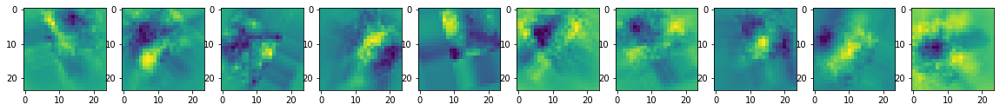

real


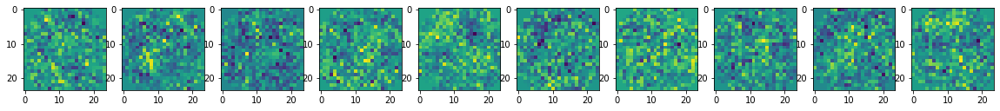

304.0290012359619 sec
0 batch 28 iteration
generated


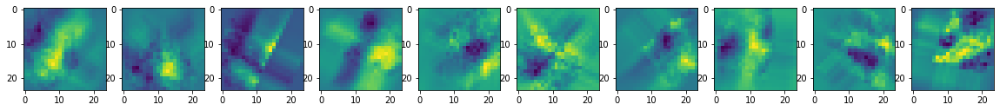

real


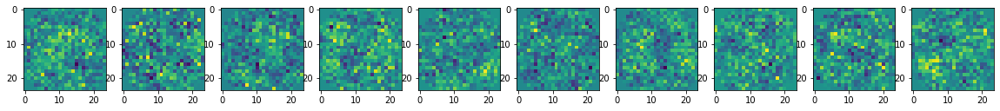

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.205438
[t-SNE] KL divergence after 250 iterations with early exaggeration: 68.103737
[t-SNE] KL divergence after 1000 iterations: 0.726708
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


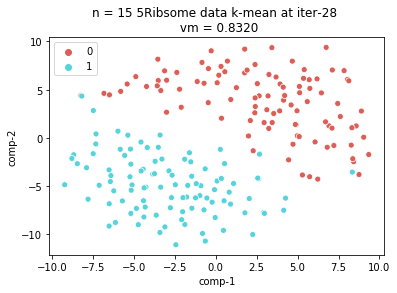

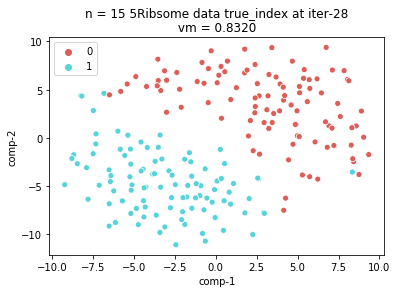

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


328.5448634624481 sec
0 batch 29 iteration
generated


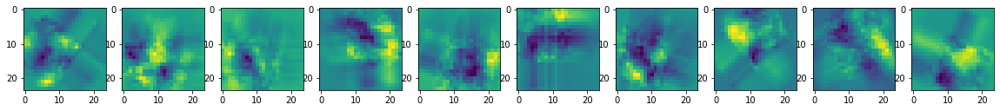

real


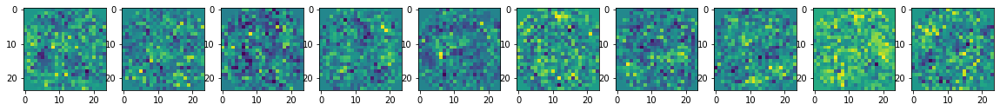

308.9628851413727 sec
0 batch 30 iteration
generated


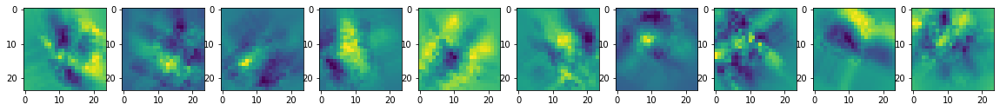

real


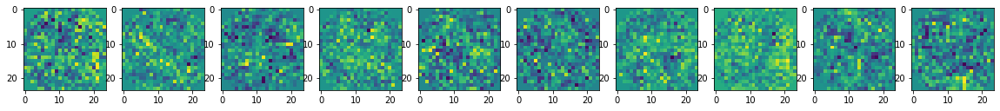

317.29097032546997 sec
0 batch 31 iteration
generated


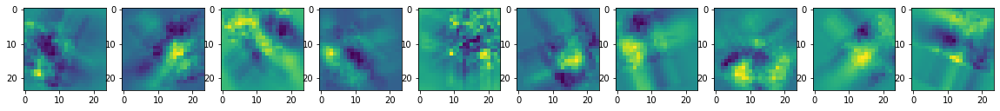

real


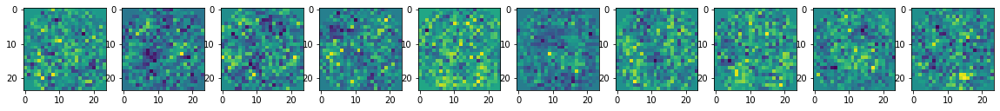

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.199284
[t-SNE] KL divergence after 250 iterations with early exaggeration: 68.806519
[t-SNE] KL divergence after 1000 iterations: 0.767886
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


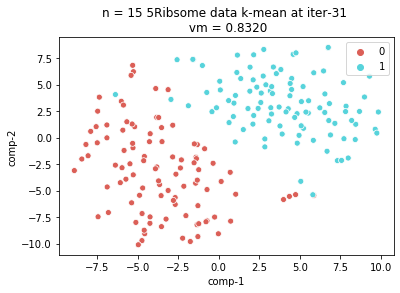

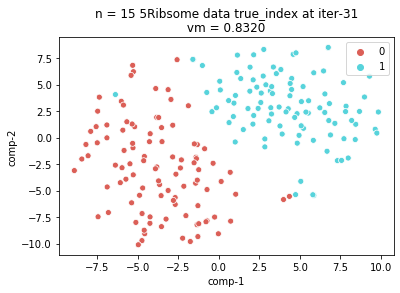

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


350.62554812431335 sec
0 batch 32 iteration
generated


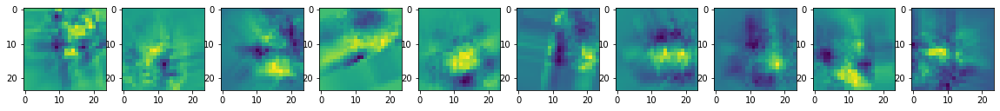

real


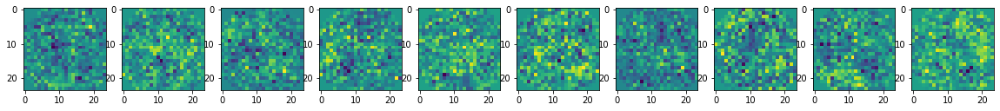

327.4422221183777 sec
0 batch 33 iteration
generated


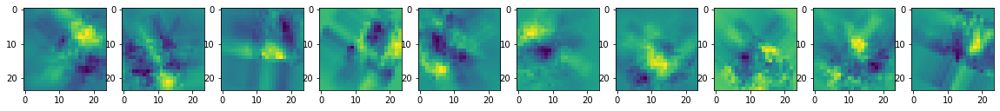

real


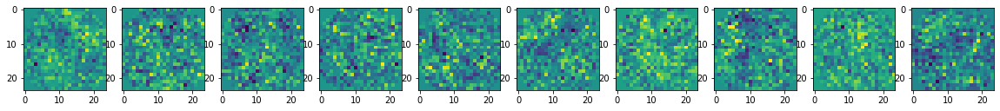

320.9997980594635 sec
0 batch 34 iteration
generated


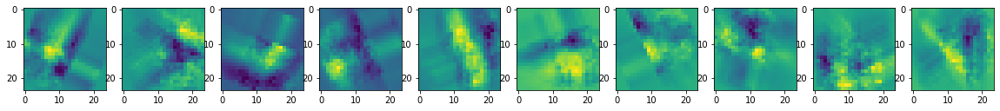

real


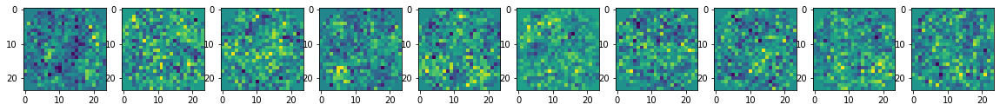

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.011s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.195250
[t-SNE] KL divergence after 250 iterations with early exaggeration: 69.642609
[t-SNE] KL divergence after 950 iterations: 0.816281
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


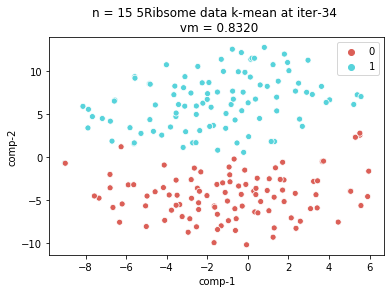

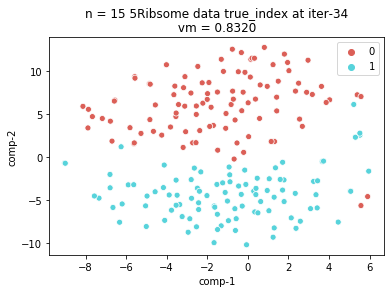

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


339.7321379184723 sec
0 batch 35 iteration
generated


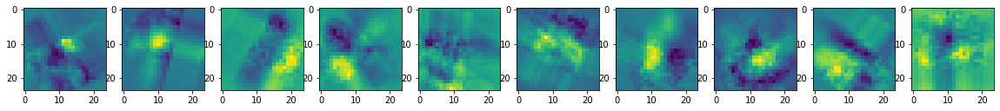

real


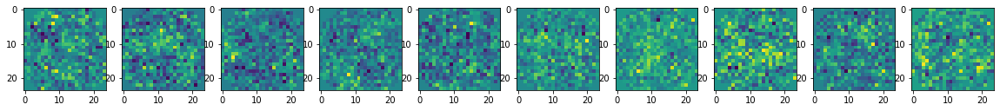

KeyboardInterrupt: 

In [29]:
#snr_list = [10, 5, 1, 0.8, 0.6, 0.4, 0.2, 0.1]
snr = 0.6
data_name = f'70s_2class_0304+{snr}'
with open(f'./data/{data_name}/images.pkl', 'rb') as f:
    new_projection = pickle.load( f)

with open(f'./data/{data_name}/angles.pkl', 'rb') as f:
    angles2 = pickle.load( f)

with open(f'./data/{data_name}/orientation_matrix.pkl', 'rb') as f:
    Orientation_Vectors = pickle.load(f)

with open(f'./data/{data_name}/indexs.pkl', 'rb') as f:
    indexs = pickle.load(f)
print('indexs',indexs[:10])     
with open(f'./data/{data_name}/mean_subtracted_strcut.pkl', 'rb') as f:
    mean_subtracted_strcut = pickle.load(f)
    
new_projection = new_projection * mask
print(new_projection.shape)
new_projection = new_projection[:,5:29,5:29]
plt.imshow(new_projection[0])
plt.show()
print(angles2)
n = 15
b = 200
niter = 40
pca_n = 2
Images = new_projection#[:5000]
print(Images.shape)
exp_name = f'20220320_{data_name}_EM_2SDR_n_{n}'
ProjSize, num_image, n_component , num_iter = 24, Images.shape[0], n, niter
batch_size = b
Vol_geom = astra.create_vol_geom(ProjSize, ProjSize, ProjSize)
#Images = torch.ones(num_image, 48, 48) # fake images for computing purpose

vg = ts.from_astra(Vol_geom)
pg = ts.from_astra(Proj_geom)
op = ts.operator(vg, pg)
MP3 = EM_2SDR(ProjSize, num_image, n_component, op , Images,Orientation_Vectors, exp_name,mean_subtracted_strcut, indexs, batch_size, niter, PCA_n= pca_n)
#MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)
#MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)
MP3.fit(0.01, True)
MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)

output_collection 0-th batch
output_collection 1-th batch
output_collection 2-th batch
output_collection 3-th batch
output_collection 4-th batch
output_collection 5-th batch
output_collection 6-th batch
output_collection 7-th batch
output_collection 8-th batch
output_collection 9-th batch
output_collection 10-th batch
output_collection 11-th batch
output_collection 12-th batch
output_collection 13-th batch
output_collection 14-th batch
output_collection 15-th batch
output_collection 16-th batch
output_collection 17-th batch
output_collection 18-th batch
output_collection 19-th batch
output_collection 20-th batch
output_collection 21-th batch
output_collection 22-th batch
output_collection 23-th batch
output_collection 24-th batch
output_collection 25-th batch
output_collection 26-th batch
output_collection 27-th batch
output_collection 28-th batch
output_collection 29-th batch
output_collection 30-th batch
output_collection 31-th batch
output_collection 32-th batch
output_collection 33

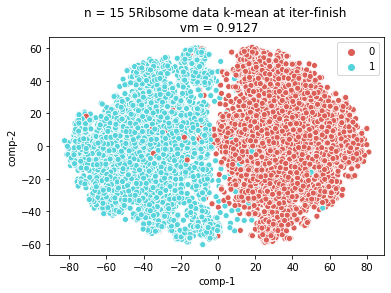

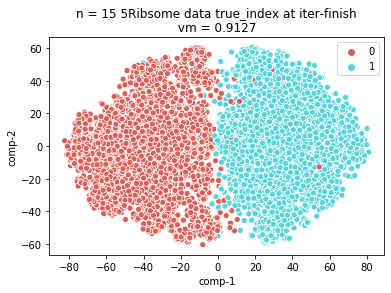

In [30]:
MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)

In [ ]:
#snr_list = [10, 5, 1, 0.8, 0.6, 0.4, 0.2, 0.1]
snr = 0.6
data_name = f'70s_2class_0304+{snr}'
with open(f'./data/{data_name}/images.pkl', 'rb') as f:
    new_projection = pickle.load( f)

with open(f'./data/{data_name}/angles.pkl', 'rb') as f:
    angles2 = pickle.load( f)

with open(f'./data/{data_name}/orientation_matrix.pkl', 'rb') as f:
    Orientation_Vectors = pickle.load(f)

with open(f'./data/{data_name}/indexs.pkl', 'rb') as f:
    indexs = pickle.load(f)
print('indexs',indexs[:10])     
with open(f'./data/{data_name}/mean_subtracted_strcut.pkl', 'rb') as f:
    mean_subtracted_strcut = pickle.load(f)
    
new_projection = new_projection * mask
print(new_projection.shape)
new_projection = new_projection[:,5:29,5:29]
plt.imshow(new_projection[0])
plt.show()
print(angles2)
n = 15
b = 200
niter = 40
pca_n = 2
Images = new_projection#[:5000]
print(Images.shape)
exp_name = f'20220320_{data_name}_EM_2SDR_n_{n}'
ProjSize, num_image, n_component , num_iter = 24, Images.shape[0], n, niter
batch_size = b
Vol_geom = astra.create_vol_geom(ProjSize, ProjSize, ProjSize)
#Images = torch.ones(num_image, 48, 48) # fake images for computing purpose

vg = ts.from_astra(Vol_geom)
pg = ts.from_astra(Proj_geom)
op = ts.operator(vg, pg)
MP3 = EM_2SDR(ProjSize, num_image, n_component, op , Images,Orientation_Vectors, exp_name,mean_subtracted_strcut, indexs, batch_size, niter, PCA_n= pca_n)
#MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)
#MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)
MP3.fit(0.01, True)
MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)

indexs [1 0 0 1 0 1 1 1 0 0]
(10000, 34, 34)


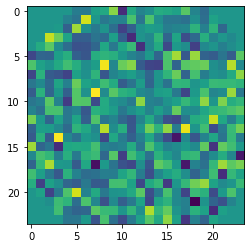

[[3.69580346 0.59551758 4.60979504]
 [3.66267117 0.71039416 3.8941898 ]
 [4.94994662 1.16466973 0.22942753]
 ...
 [3.40407028 1.12754047 1.53671127]
 [3.36284647 0.88774637 4.90507316]
 [1.10436604 1.68281854 2.78723985]]
(10000, 24, 24)


/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


325.33284521102905 sec
0 batch 1 iteration
generated


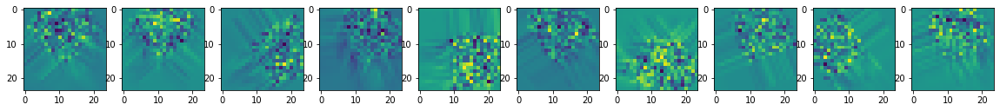

real


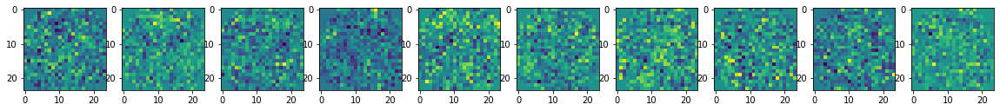

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.007s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.470405
[t-SNE] KL divergence after 250 iterations with early exaggeration: 70.029610
[t-SNE] KL divergence after 1000 iterations: 0.745985
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


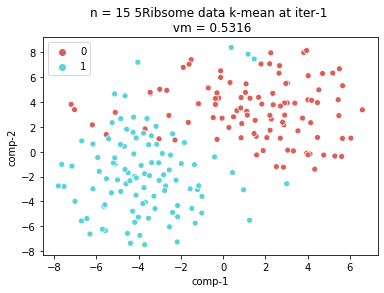

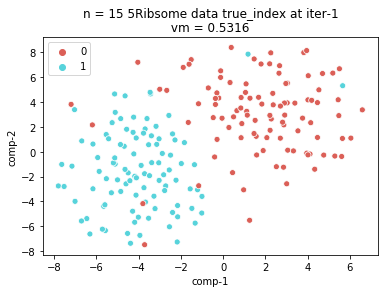

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


329.0449435710907 sec
0 batch 2 iteration
generated


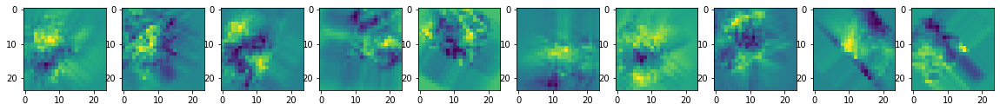

real


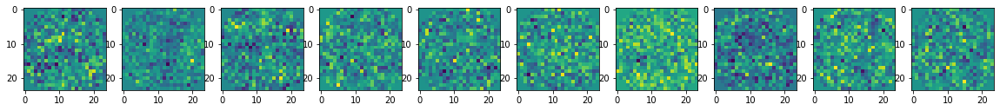

328.83256673812866 sec
0 batch 3 iteration
generated


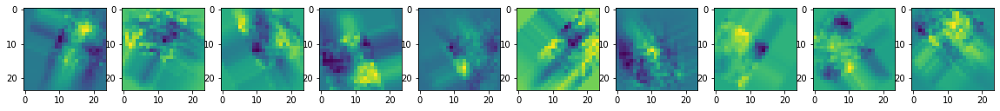

real


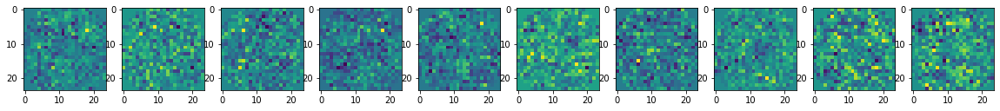

313.4701671600342 sec
0 batch 4 iteration
generated


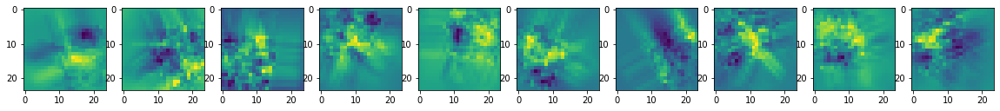

real


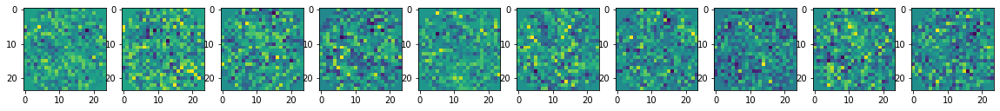

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.012s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.086041
[t-SNE] KL divergence after 250 iterations with early exaggeration: 68.086319
[t-SNE] KL divergence after 1000 iterations: 0.749052
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


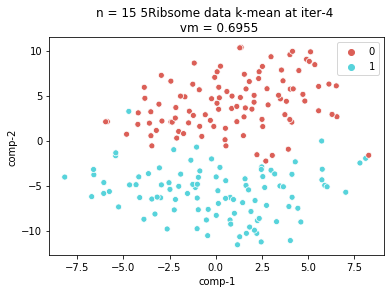

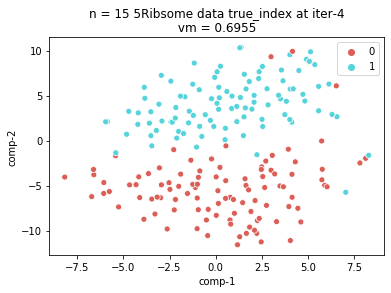

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


344.4662826061249 sec
0 batch 5 iteration
generated


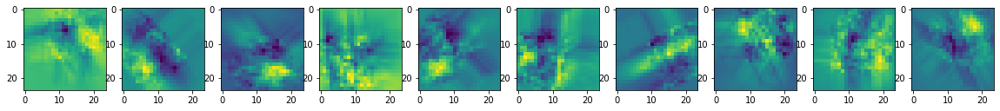

real


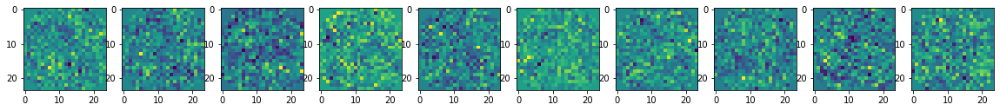

332.98156332969666 sec
0 batch 6 iteration
generated


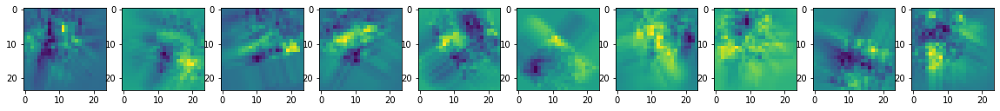

real


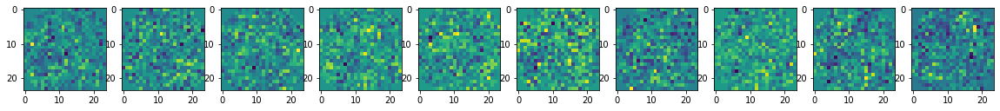

322.72981119155884 sec
0 batch 7 iteration
generated


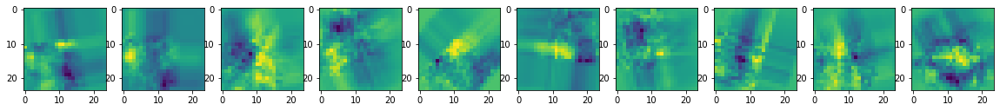

real


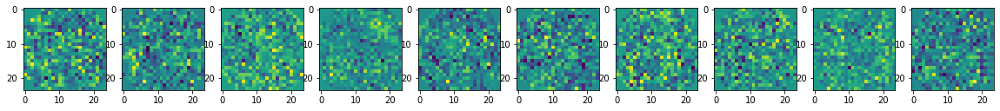

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.012s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.085803
[t-SNE] KL divergence after 250 iterations with early exaggeration: 68.808922
[t-SNE] KL divergence after 950 iterations: 0.746341
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


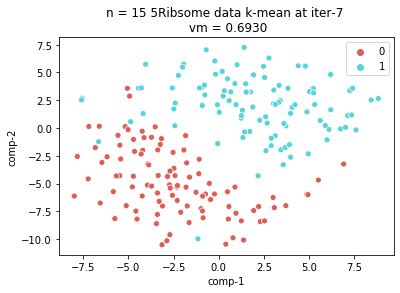

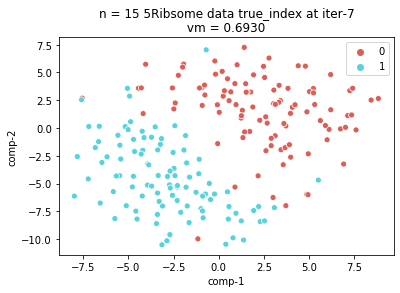

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


336.12887239456177 sec
0 batch 8 iteration
generated


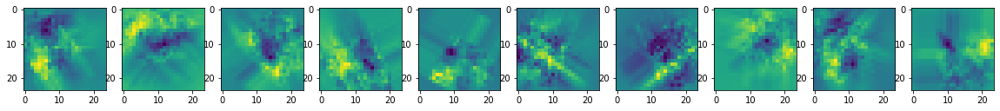

real


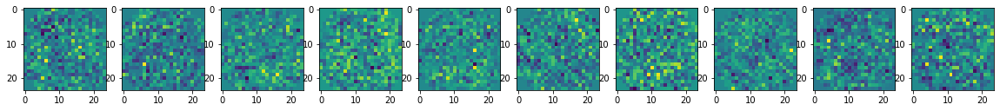

328.1749963760376 sec
0 batch 9 iteration
generated


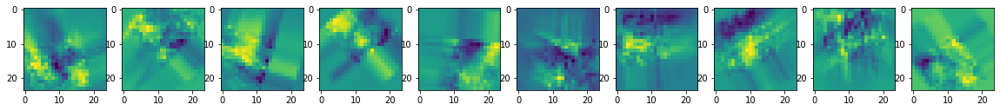

real


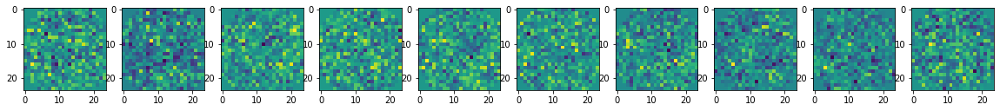

317.829874753952 sec
0 batch 10 iteration
generated


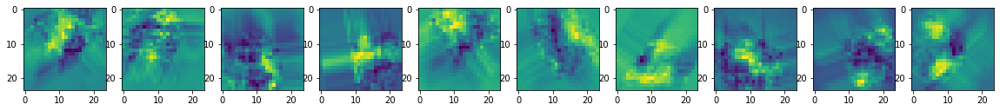

real


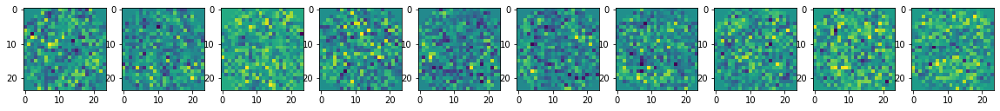

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.006s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.085430
[t-SNE] KL divergence after 250 iterations with early exaggeration: 69.513084
[t-SNE] KL divergence after 1000 iterations: 0.777273
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


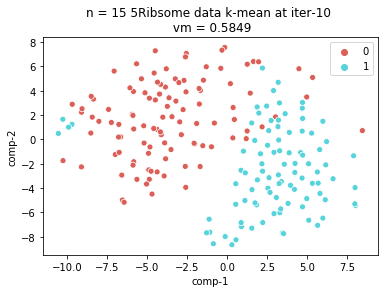

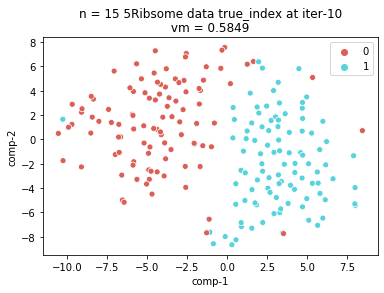

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


342.9586269855499 sec
0 batch 11 iteration
generated


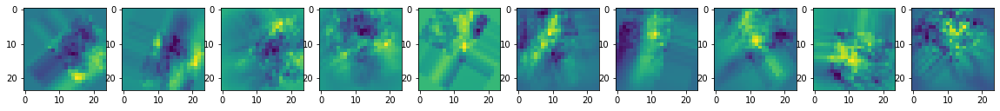

real


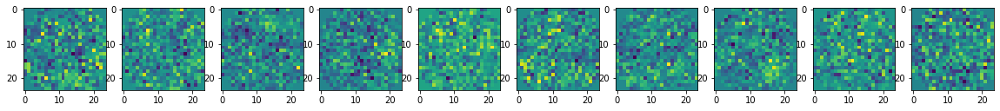

337.9526083469391 sec
0 batch 12 iteration
generated


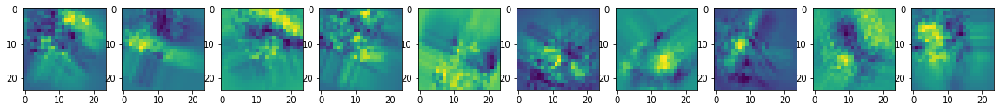

real


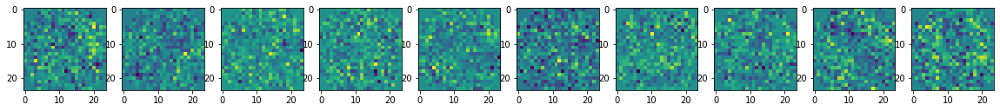

340.03148674964905 sec
0 batch 13 iteration
generated


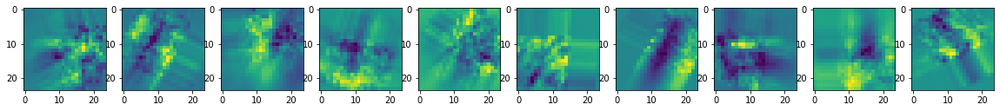

real


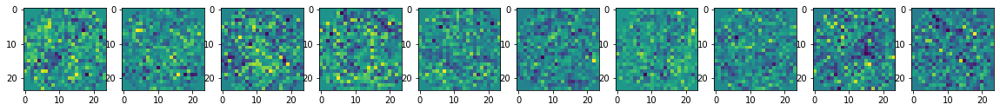

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.008s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.084568
[t-SNE] KL divergence after 250 iterations with early exaggeration: 70.138046
[t-SNE] KL divergence after 1000 iterations: 0.749492
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


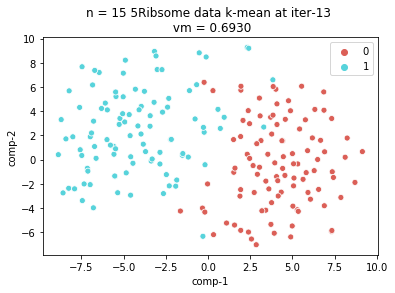

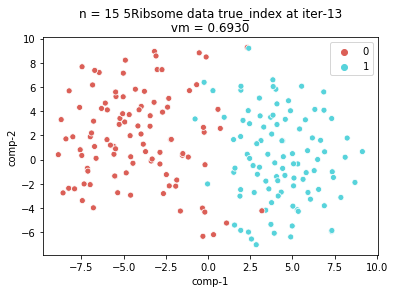

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


338.9507324695587 sec
0 batch 14 iteration
generated


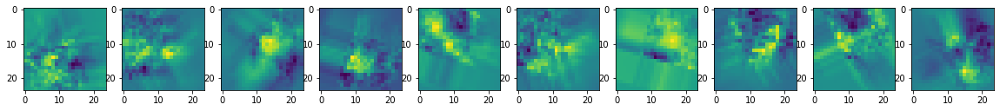

real


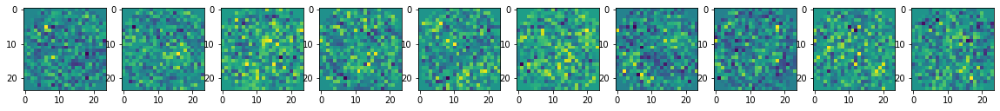

324.43741250038147 sec
0 batch 15 iteration
generated


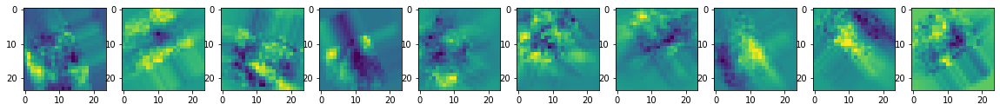

real


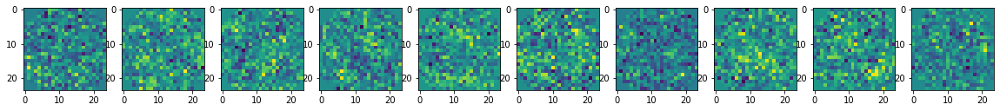

345.71772170066833 sec
0 batch 16 iteration
generated


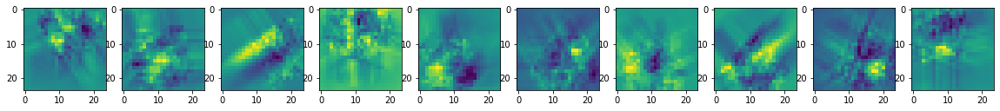

real


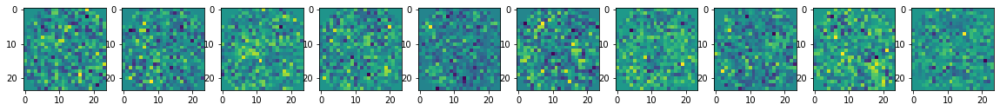

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.012s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.082772
[t-SNE] KL divergence after 250 iterations with early exaggeration: 67.863586
[t-SNE] KL divergence after 1000 iterations: 0.792351
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


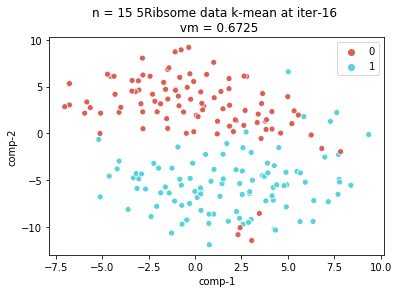

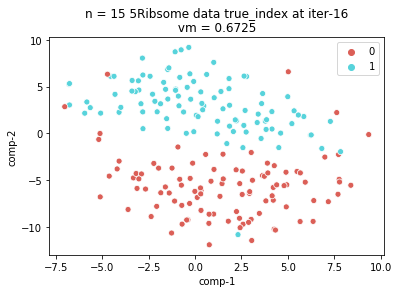

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


341.3374924659729 sec
0 batch 17 iteration
generated


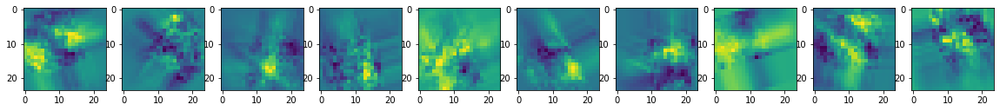

real


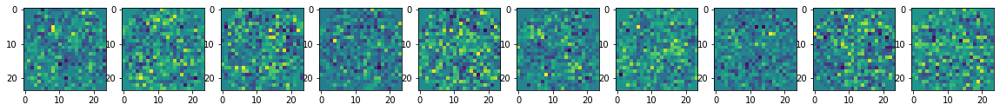

329.1790671348572 sec
0 batch 18 iteration
generated


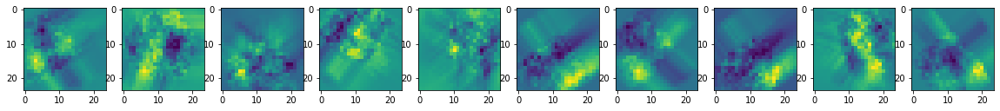

real


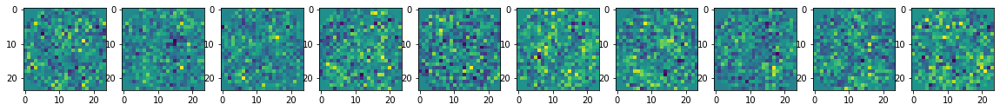

311.5613238811493 sec
0 batch 19 iteration
generated


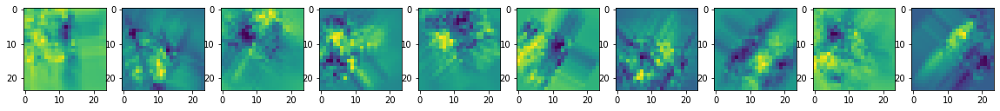

real


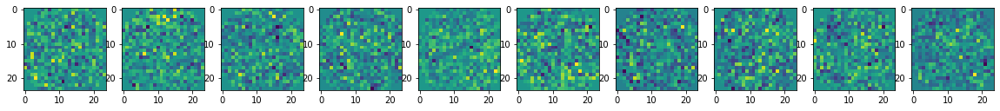

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.083309
[t-SNE] KL divergence after 250 iterations with early exaggeration: 67.954025
[t-SNE] KL divergence after 1000 iterations: 0.796457
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


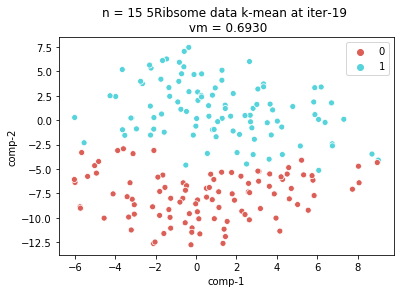

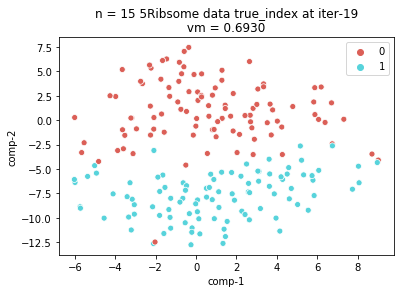

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


342.65967750549316 sec
0 batch 20 iteration
generated


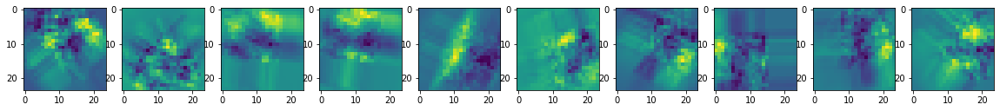

real


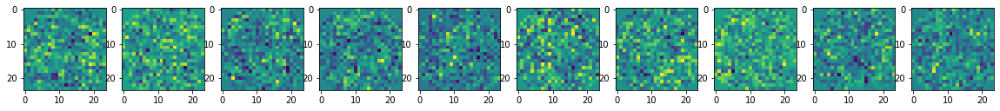

336.84342527389526 sec
0 batch 21 iteration
generated


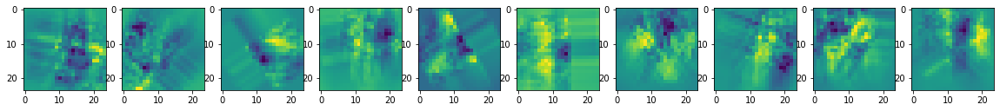

real


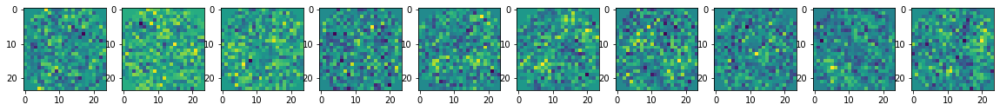

321.69763827323914 sec
0 batch 22 iteration
generated


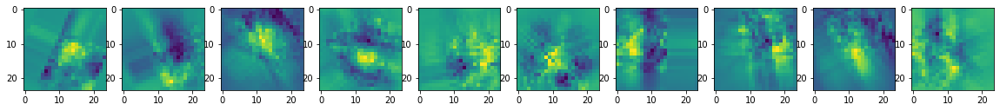

real


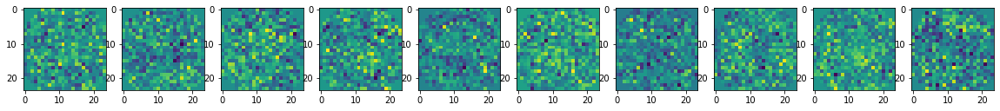

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.010s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.081599
[t-SNE] KL divergence after 250 iterations with early exaggeration: 68.319778
[t-SNE] KL divergence after 1000 iterations: 0.809533
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


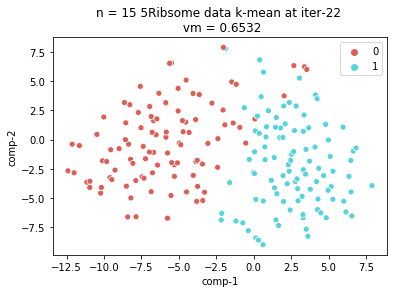

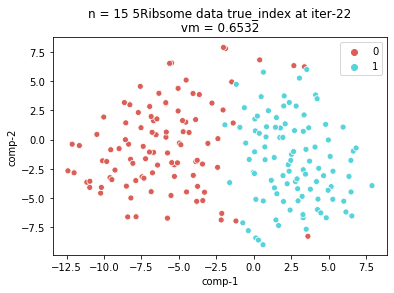

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


317.91782307624817 sec
0 batch 23 iteration
generated


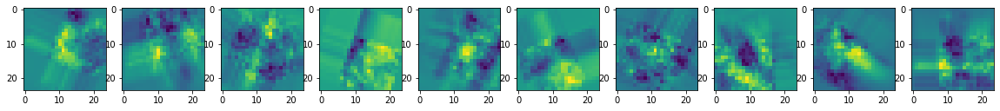

real


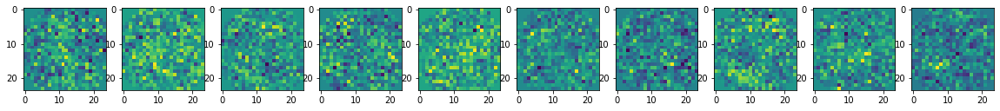

368.01194310188293 sec
0 batch 24 iteration
generated


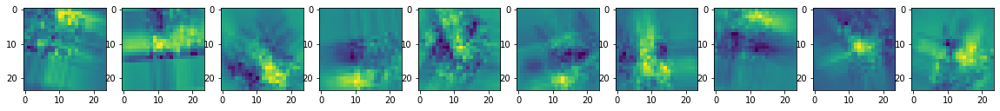

real


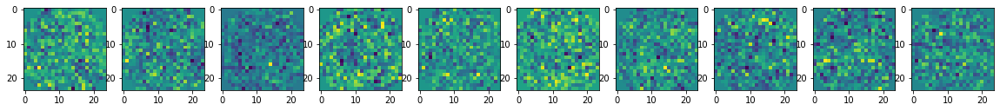

331.17381596565247 sec
0 batch 25 iteration
generated


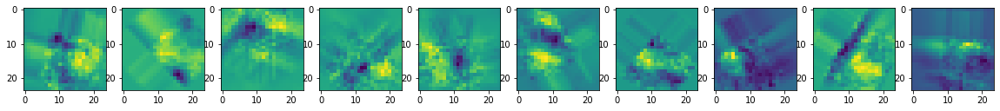

real


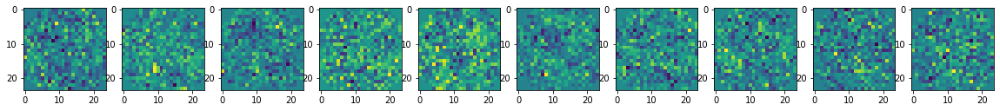

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.080782
[t-SNE] KL divergence after 250 iterations with early exaggeration: 69.691460
[t-SNE] KL divergence after 1000 iterations: 0.809839
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


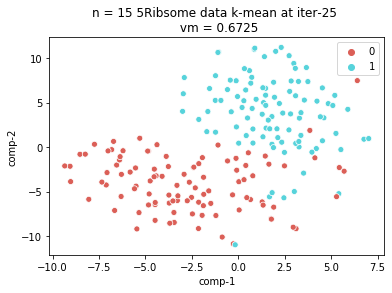

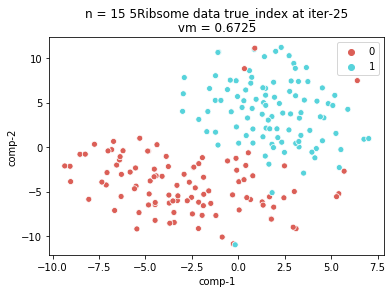

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


KeyboardInterrupt: 

In [27]:
#snr_list = [10, 5, 1, 0.8, 0.6, 0.4, 0.2, 0.1]
snr = 0.2
data_name = f'70s_2class_0304+{snr}'
with open(f'./data/{data_name}/images.pkl', 'rb') as f:
    new_projection = pickle.load( f)

with open(f'./data/{data_name}/angles.pkl', 'rb') as f:
    angles2 = pickle.load( f)

with open(f'./data/{data_name}/orientation_matrix.pkl', 'rb') as f:
    Orientation_Vectors = pickle.load(f)

with open(f'./data/{data_name}/indexs.pkl', 'rb') as f:
    indexs = pickle.load(f)
print('indexs',indexs[:10])     
with open(f'./data/{data_name}/mean_subtracted_strcut.pkl', 'rb') as f:
    mean_subtracted_strcut = pickle.load(f)
    
new_projection = new_projection * mask
print(new_projection.shape)
new_projection = new_projection[:,5:29,5:29]
plt.imshow(new_projection[0])
plt.show()
print(angles2)
n = 15
b = 200
niter = 40
pca_n = 2
Images = new_projection#[:5000]
print(Images.shape)
exp_name = f'20220320_{data_name}_EM_2SDR_n_{n}'
ProjSize, num_image, n_component , num_iter = 24, Images.shape[0], n, niter
batch_size = b
Vol_geom = astra.create_vol_geom(ProjSize, ProjSize, ProjSize)
#Images = torch.ones(num_image, 48, 48) # fake images for computing purpose

vg = ts.from_astra(Vol_geom)
pg = ts.from_astra(Proj_geom)
op = ts.operator(vg, pg)
MP3 = EM_2SDR(ProjSize, num_image, n_component, op , Images,Orientation_Vectors, exp_name,mean_subtracted_strcut, indexs, batch_size, niter, PCA_n= pca_n)
#MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)
#MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)
MP3.fit(0.01, True)
MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)

output_collection 0-th batch
output_collection 1-th batch
output_collection 2-th batch
output_collection 3-th batch
output_collection 4-th batch
output_collection 5-th batch
output_collection 6-th batch
output_collection 7-th batch
output_collection 8-th batch
output_collection 9-th batch
output_collection 10-th batch
output_collection 11-th batch
output_collection 12-th batch
output_collection 13-th batch
output_collection 14-th batch
output_collection 15-th batch
output_collection 16-th batch
output_collection 17-th batch
output_collection 18-th batch
output_collection 19-th batch
output_collection 20-th batch
output_collection 21-th batch
output_collection 22-th batch
output_collection 23-th batch
output_collection 24-th batch
output_collection 25-th batch
output_collection 26-th batch
output_collection 27-th batch
output_collection 28-th batch
output_collection 29-th batch
output_collection 30-th batch
output_collection 31-th batch
output_collection 32-th batch
output_collection 33

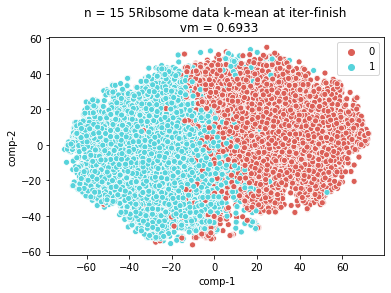

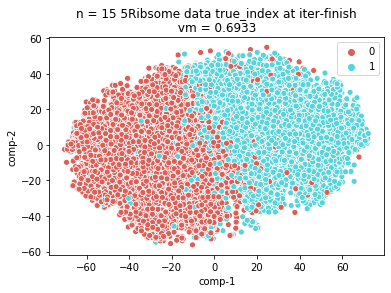

In [28]:
MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)

indexs [1 0 0 1 0 1 1 1 0 0]
(10000, 34, 34)


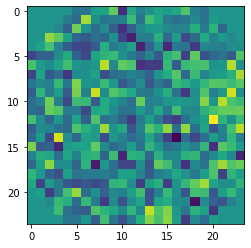

[[5.14449428 1.27176208 4.89739318]
 [0.5159872  0.73028398 1.59682606]
 [1.01101147 1.83496098 3.08531661]
 ...
 [1.66602271 0.48888756 5.53002303]
 [0.78062598 1.15543222 4.43331694]
 [5.25564627 1.11403912 4.99492253]]
(10000, 24, 24)
output_collection 0-th batch


/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


output_collection 1-th batch
output_collection 2-th batch
output_collection 3-th batch
output_collection 4-th batch
output_collection 5-th batch
output_collection 6-th batch
output_collection 7-th batch
output_collection 8-th batch
output_collection 9-th batch
output_collection 10-th batch
output_collection 11-th batch
output_collection 12-th batch
output_collection 13-th batch
output_collection 14-th batch
output_collection 15-th batch
output_collection 16-th batch
output_collection 17-th batch
output_collection 18-th batch
output_collection 19-th batch
output_collection 20-th batch
output_collection 21-th batch
output_collection 22-th batch
output_collection 23-th batch
output_collection 24-th batch
output_collection 25-th batch
output_collection 26-th batch
output_collection 27-th batch
output_collection 28-th batch
output_collection 29-th batch
output_collection 30-th batch
output_collection 31-th batch
output_collection 32-th batch
output_collection 33-th batch
output_collection 3

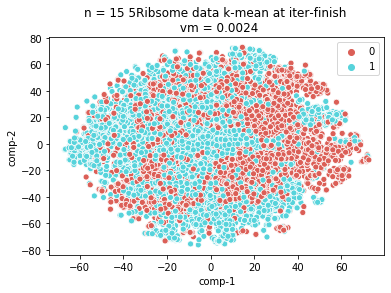

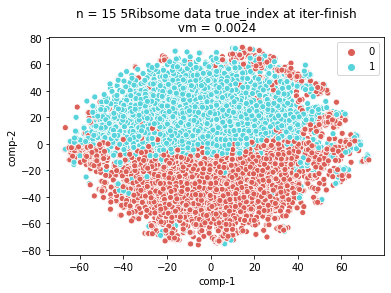

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


333.05628085136414 sec
0 batch 1 iteration
generated


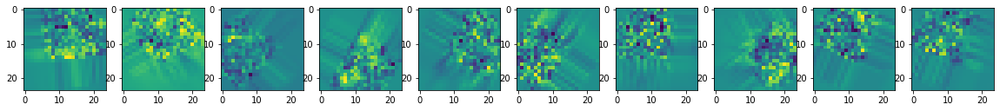

real


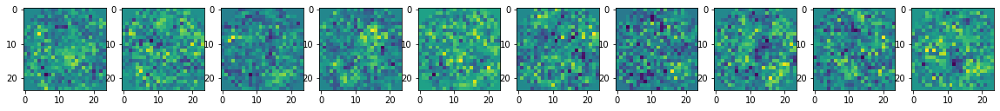

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.004s...
[t-SNE] Computed neighbors for 200 samples in 0.007s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 2.289011
[t-SNE] KL divergence after 250 iterations with early exaggeration: 61.831898
[t-SNE] KL divergence after 1000 iterations: 0.653946
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


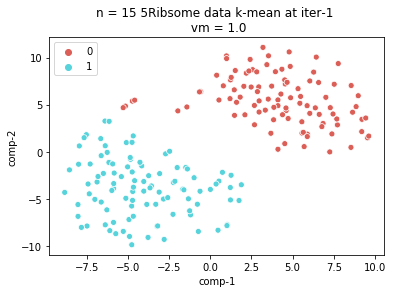

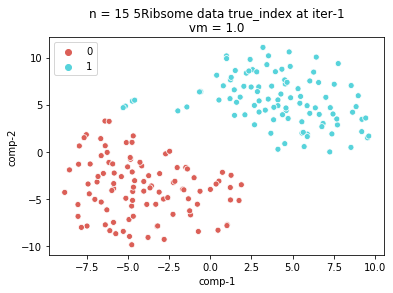

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


328.7929825782776 sec
0 batch 2 iteration
generated


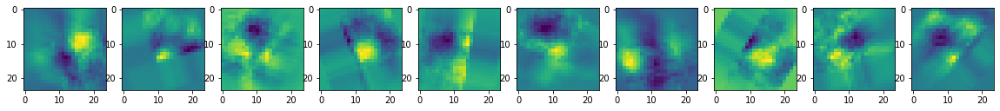

real


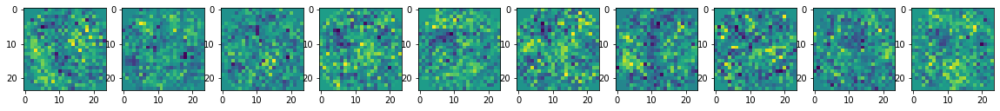

309.28378438949585 sec
0 batch 3 iteration
generated


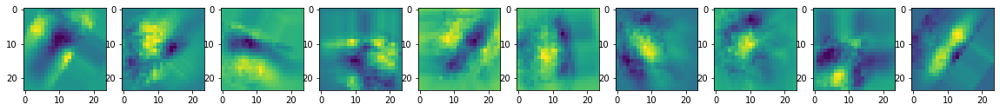

real


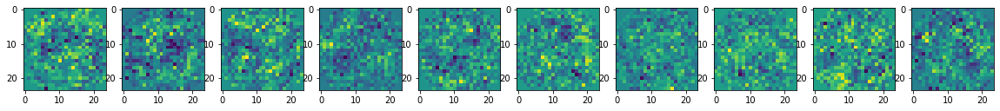

312.4075138568878 sec
0 batch 4 iteration
generated


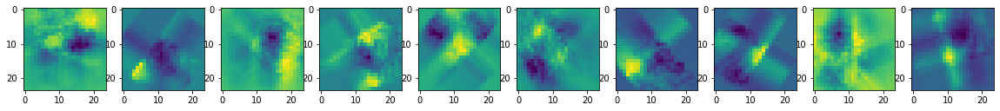

real


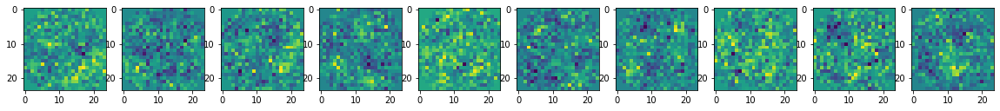

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.006s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.342074
[t-SNE] KL divergence after 250 iterations with early exaggeration: 65.606659
[t-SNE] KL divergence after 1000 iterations: 0.630301
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


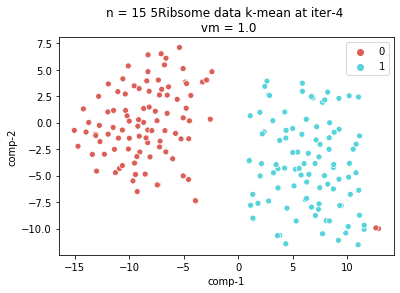

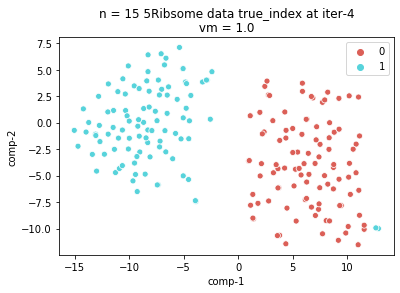

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


314.31976294517517 sec
0 batch 5 iteration
generated


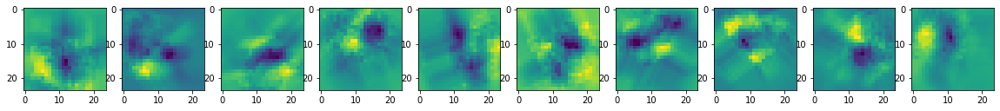

real


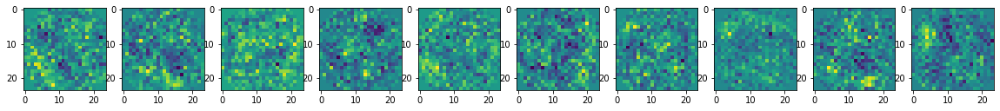

307.9864239692688 sec
0 batch 6 iteration
generated


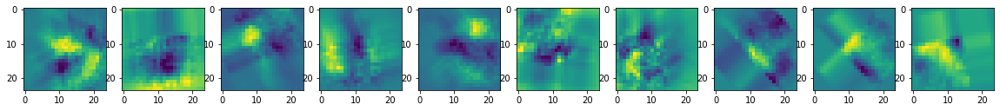

real


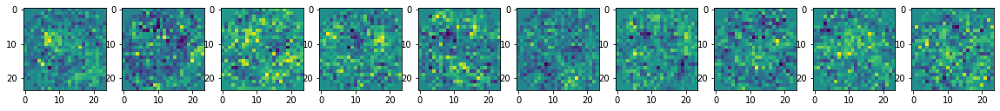

319.46457839012146 sec
0 batch 7 iteration
generated


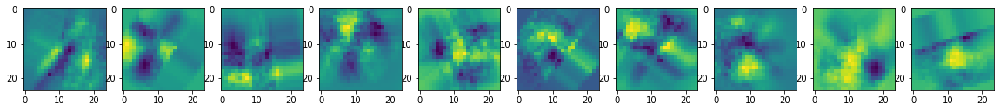

real


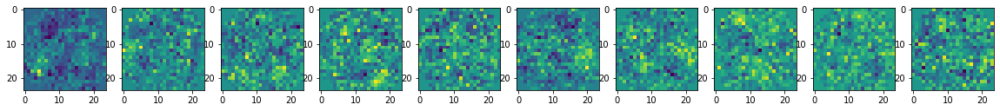

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.006s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.332047
[t-SNE] KL divergence after 250 iterations with early exaggeration: 66.484673
[t-SNE] KL divergence after 1000 iterations: 0.639700
self.All_U_kron_shape torch.Size([13824, 3375])
self.PCs.shape torch.Size([3375, 30])


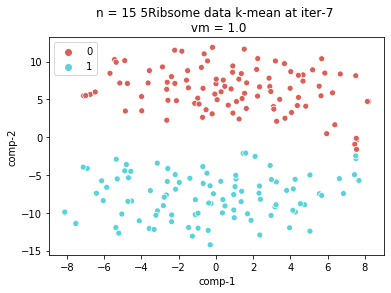

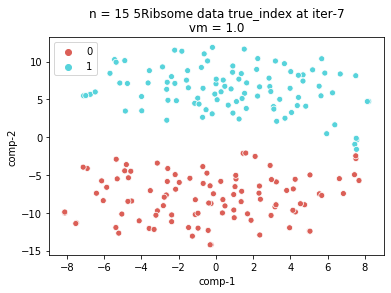

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


KeyboardInterrupt: 

In [20]:
#snr_list = [10, 5, 1, 0.8, 0.6, 0.4, 0.2, 0.1]
snr = 0.8
data_name = f'70s_2class_0304+{snr}'
with open(f'./data/{data_name}/images.pkl', 'rb') as f:
    new_projection = pickle.load( f)

with open(f'./data/{data_name}/angles.pkl', 'rb') as f:
    angles2 = pickle.load( f)

with open(f'./data/{data_name}/orientation_matrix.pkl', 'rb') as f:
    Orientation_Vectors = pickle.load(f)

with open(f'./data/{data_name}/indexs.pkl', 'rb') as f:
    indexs = pickle.load(f)
print('indexs',indexs[:10])     
with open(f'./data/{data_name}/mean_subtracted_strcut.pkl', 'rb') as f:
    mean_subtracted_strcut = pickle.load(f)
    
new_projection = new_projection * mask
print(new_projection.shape)
new_projection = new_projection[:,5:29,5:29]
plt.imshow(new_projection[0])
plt.show()
print(angles2)
n = 15
b = 200
niter = 40
pca_n = 2
Images = new_projection#[:5000]
print(Images.shape)
exp_name = f'20220320_{data_name}_EM_2SDR_n_{n}'
ProjSize, num_image, n_component , num_iter = 24, Images.shape[0], n, niter
batch_size = b
Vol_geom = astra.create_vol_geom(ProjSize, ProjSize, ProjSize)
#Images = torch.ones(num_image, 48, 48) # fake images for computing purpose

vg = ts.from_astra(Vol_geom)
pg = ts.from_astra(Proj_geom)
op = ts.operator(vg, pg)
MP3 = EM_2SDR(ProjSize, num_image, n_component, op , Images,Orientation_Vectors, exp_name,mean_subtracted_strcut, indexs, batch_size, niter, PCA_n= pca_n)
#MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)
MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)
MP3.fit(0.01, True)
MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)

output_collection 0-th batch
output_collection 1-th batch
output_collection 2-th batch
output_collection 3-th batch
output_collection 4-th batch
output_collection 5-th batch
output_collection 6-th batch
output_collection 7-th batch
output_collection 8-th batch
output_collection 9-th batch
output_collection 10-th batch
output_collection 11-th batch
output_collection 12-th batch
output_collection 13-th batch
output_collection 14-th batch
output_collection 15-th batch
output_collection 16-th batch
output_collection 17-th batch
output_collection 18-th batch
output_collection 19-th batch
output_collection 20-th batch
output_collection 21-th batch
output_collection 22-th batch
output_collection 23-th batch
output_collection 24-th batch
output_collection 25-th batch
output_collection 26-th batch
output_collection 27-th batch
output_collection 28-th batch
output_collection 29-th batch
output_collection 30-th batch
output_collection 31-th batch
output_collection 32-th batch
output_collection 33

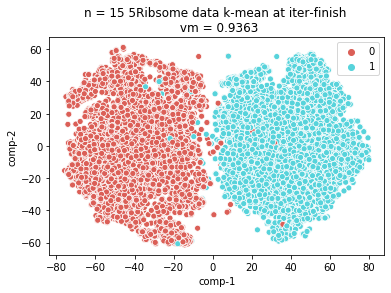

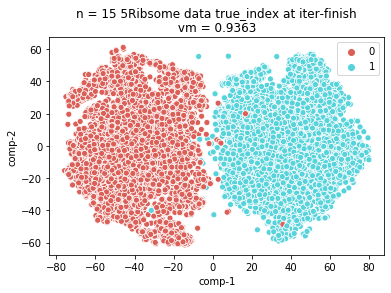

In [24]:
MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)

output_collection 0-th batch
output_collection 1-th batch
output_collection 2-th batch
output_collection 3-th batch
output_collection 4-th batch
output_collection 5-th batch
output_collection 6-th batch
output_collection 7-th batch
output_collection 8-th batch
output_collection 9-th batch
output_collection 10-th batch
output_collection 11-th batch
output_collection 12-th batch
output_collection 13-th batch
output_collection 14-th batch
output_collection 15-th batch
output_collection 16-th batch
output_collection 17-th batch
output_collection 18-th batch
output_collection 19-th batch
output_collection 20-th batch
output_collection 21-th batch
output_collection 22-th batch
output_collection 23-th batch
output_collection 24-th batch
output_collection 25-th batch
output_collection 26-th batch
output_collection 27-th batch
output_collection 28-th batch
output_collection 29-th batch
output_collection 30-th batch
output_collection 31-th batch
output_collection 32-th batch
output_collection 33

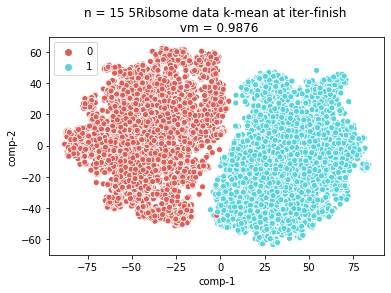

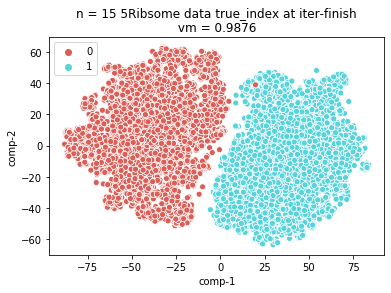

In [21]:
MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)

indexs [1 0 0 1 0 1 1 1 0 0]
(10000, 34, 34)


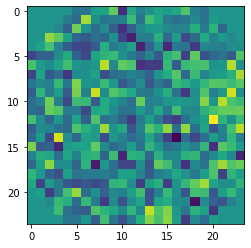

[[5.14449428 1.27176208 4.89739318]
 [0.5159872  0.73028398 1.59682606]
 [1.01101147 1.83496098 3.08531661]
 ...
 [1.66602271 0.48888756 5.53002303]
 [0.78062598 1.15543222 4.43331694]
 [5.25564627 1.11403912 4.99492253]]
(10000, 24, 24)
output_collection 0-th batch
output_collection 1-th batch
output_collection 2-th batch
output_collection 3-th batch
output_collection 4-th batch
output_collection 5-th batch
output_collection 6-th batch
output_collection 7-th batch
output_collection 8-th batch
output_collection 9-th batch
output_collection 10-th batch
output_collection 11-th batch
output_collection 12-th batch
output_collection 13-th batch
output_collection 14-th batch
output_collection 15-th batch
output_collection 16-th batch
output_collection 17-th batch
output_collection 18-th batch
output_collection 19-th batch
output_collection 20-th batch
output_collection 21-th batch
output_collection 22-th batch
output_collection 23-th batch
output_collection 24-th batch
output_collection 25-t

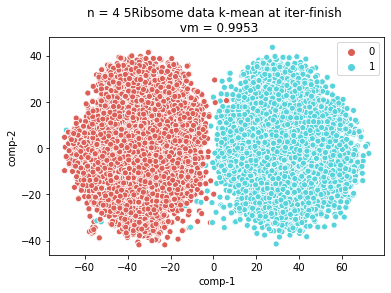

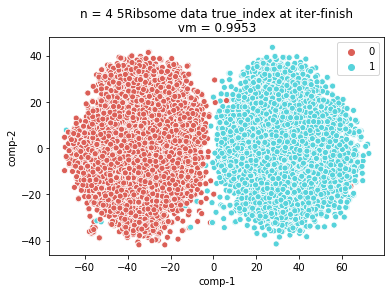

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.715343475341797 sec
0 batch 1 iteration
generated


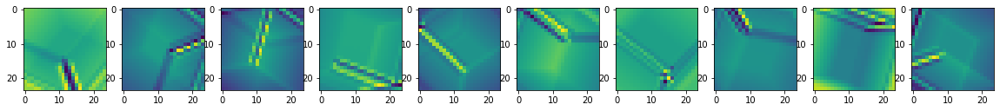

real


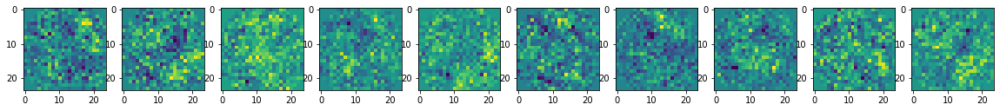

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.073535
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.884361
[t-SNE] KL divergence after 1000 iterations: 0.170751
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


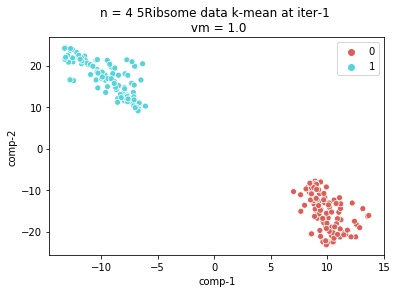

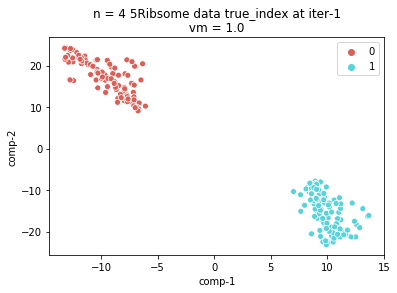

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.696192264556885 sec
0 batch 2 iteration
generated


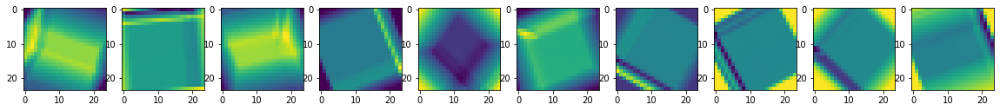

real


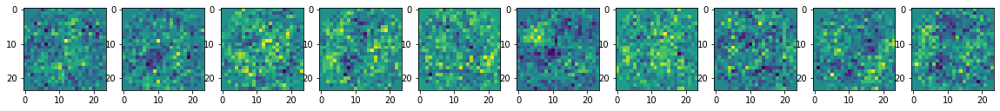

6.093461275100708 sec
0 batch 3 iteration
generated


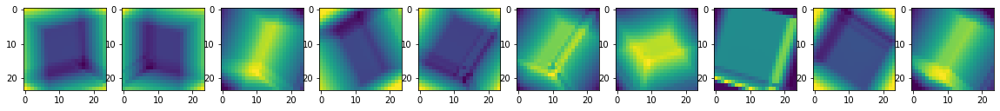

real


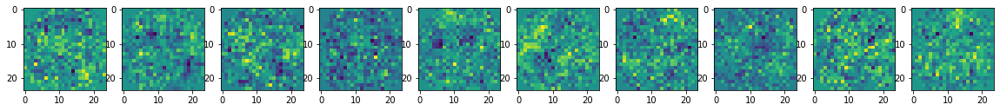

5.536869049072266 sec
0 batch 4 iteration
generated


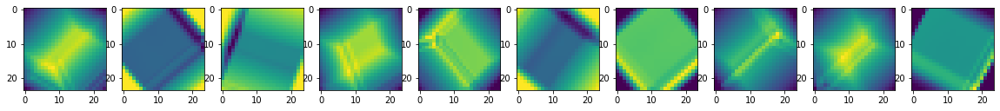

real


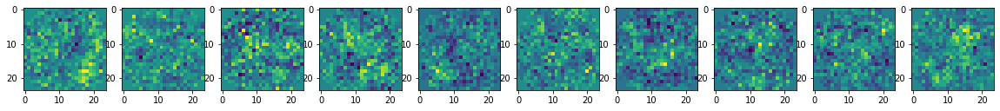

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.004s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.060270
[t-SNE] KL divergence after 250 iterations with early exaggeration: 54.204155
[t-SNE] KL divergence after 1000 iterations: 0.182197
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


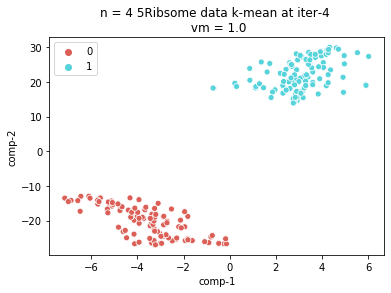

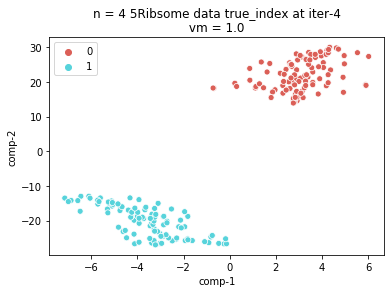

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.640681505203247 sec
0 batch 5 iteration
generated


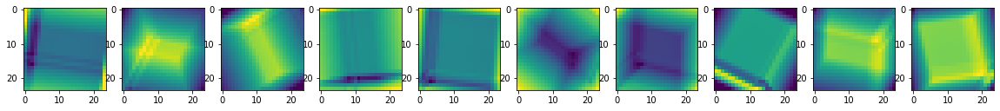

real


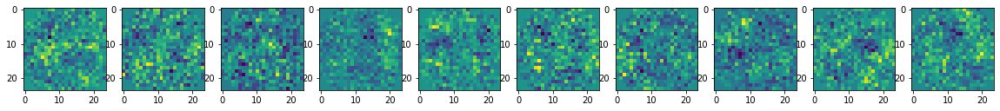

5.695030927658081 sec
0 batch 6 iteration
generated


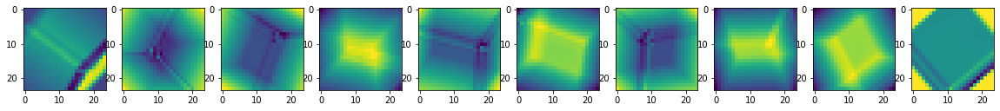

real


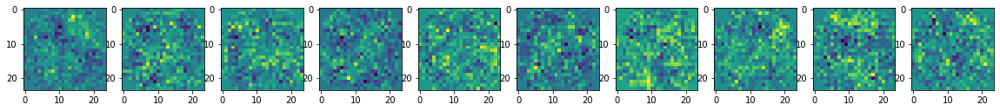

5.820300340652466 sec
0 batch 7 iteration
generated


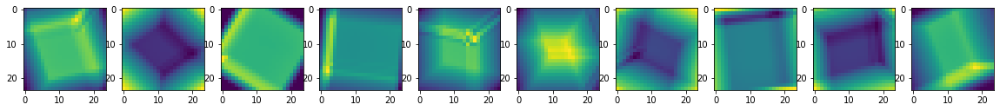

real


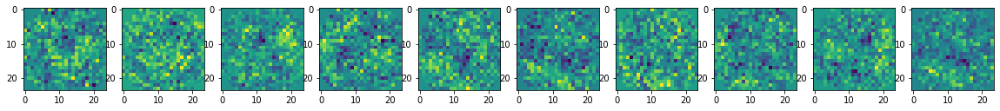

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.004s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.059856
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.541553
[t-SNE] KL divergence after 1000 iterations: 0.186326
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


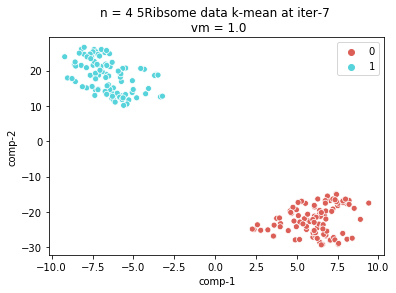

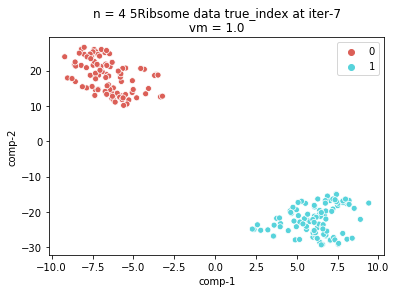

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.889570951461792 sec
0 batch 8 iteration
generated


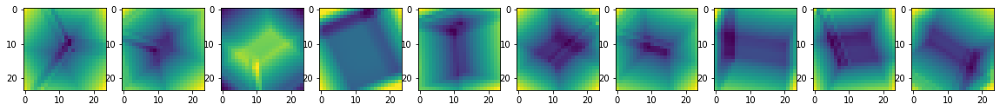

real


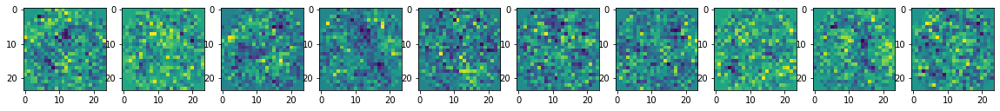

5.914873838424683 sec
0 batch 9 iteration
generated


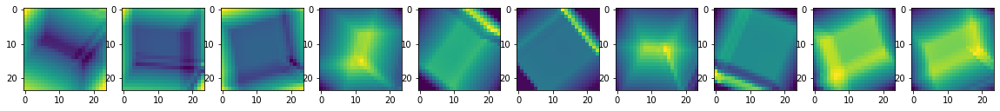

real


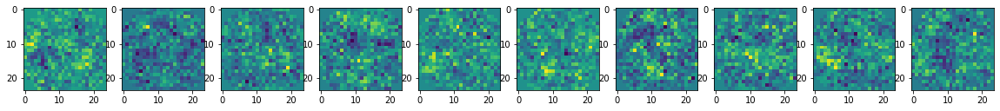

5.470221996307373 sec
0 batch 10 iteration
generated


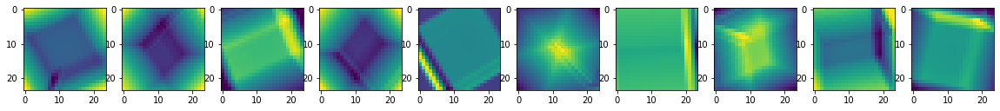

real


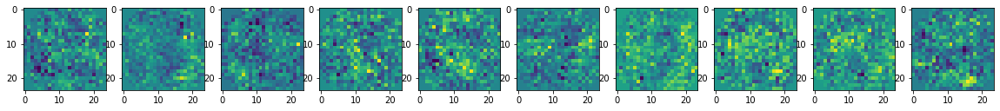

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.004s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.056003
[t-SNE] KL divergence after 250 iterations with early exaggeration: 53.913731
[t-SNE] KL divergence after 1000 iterations: 0.196730
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


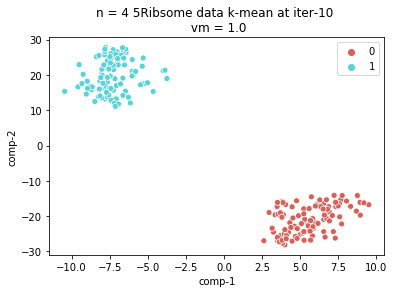

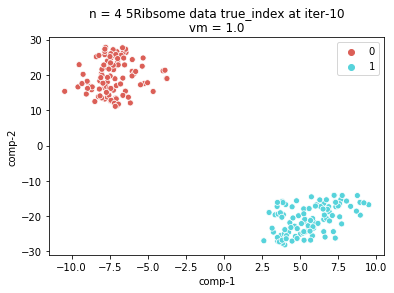

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.929704427719116 sec
0 batch 11 iteration
generated


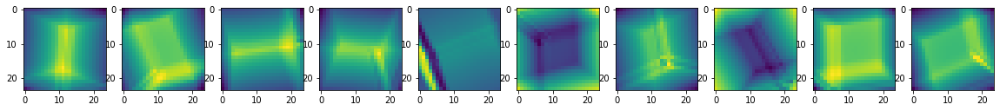

real


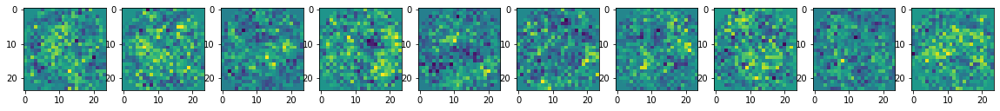

5.666486024856567 sec
0 batch 12 iteration
generated


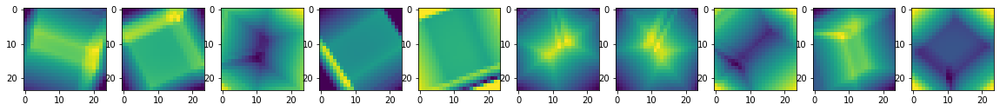

real


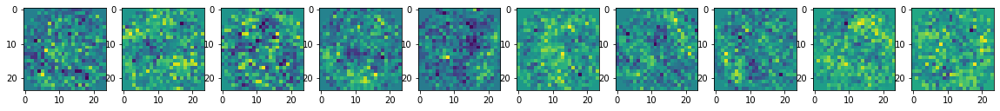

5.954984426498413 sec
0 batch 13 iteration
generated


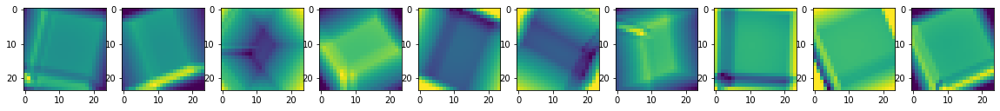

real


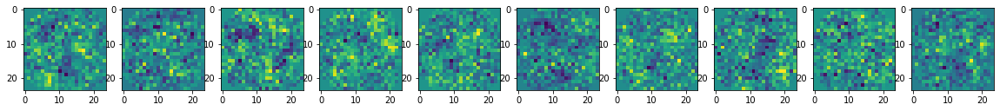

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.006s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.050710
[t-SNE] KL divergence after 250 iterations with early exaggeration: 54.145336
[t-SNE] KL divergence after 1000 iterations: 0.202672
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


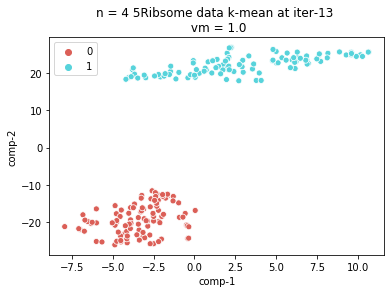

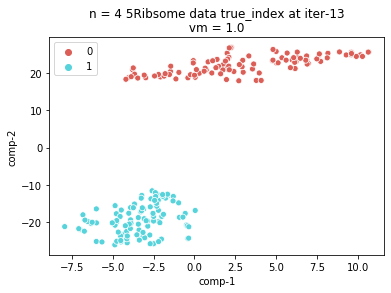

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.77425479888916 sec
0 batch 14 iteration
generated


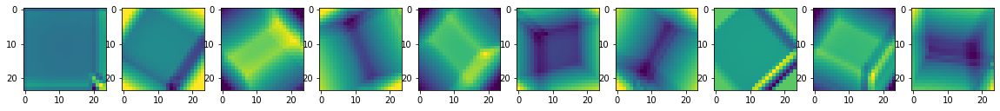

real


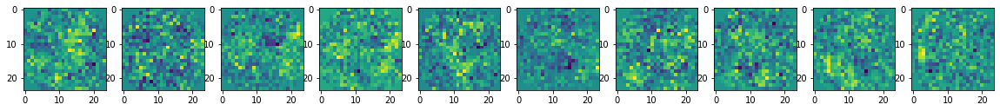

6.035062789916992 sec
0 batch 15 iteration
generated


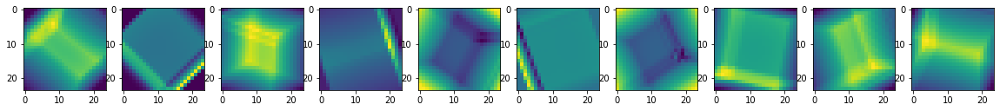

real


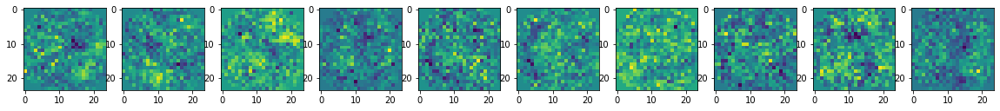

6.417352199554443 sec
0 batch 16 iteration
generated


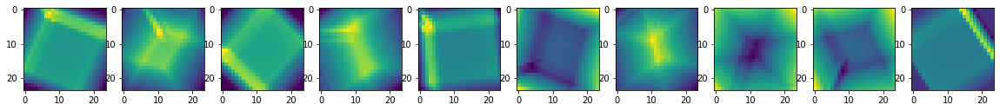

real


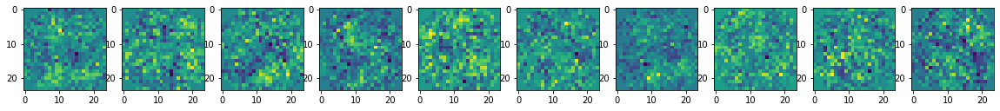

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.003s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.048740
[t-SNE] KL divergence after 250 iterations with early exaggeration: 53.431606
[t-SNE] KL divergence after 1000 iterations: 0.244358
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


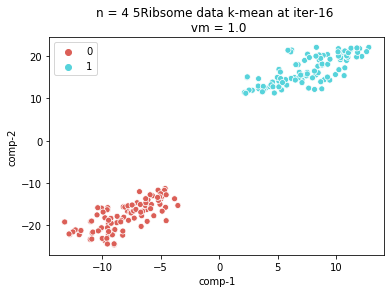

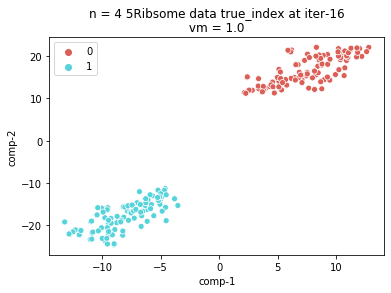

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.573791742324829 sec
0 batch 17 iteration
generated


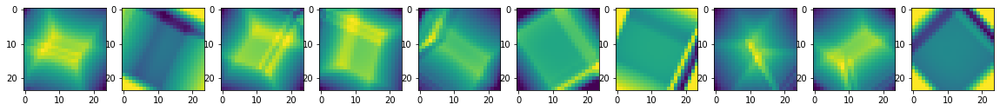

real


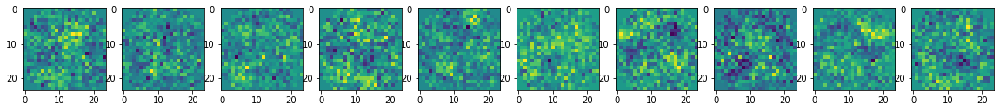

5.510414123535156 sec
0 batch 18 iteration
generated


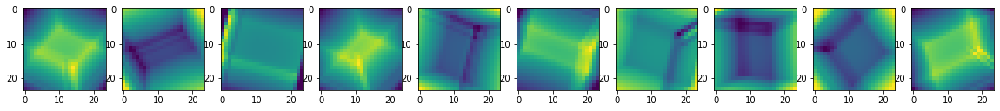

real


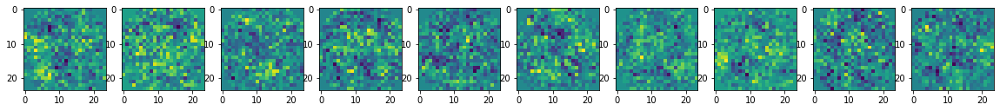

5.493200778961182 sec
0 batch 19 iteration
generated


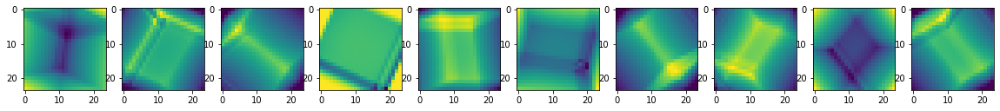

real


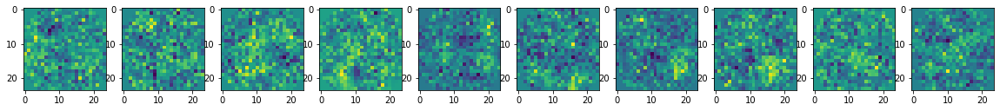

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.003s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.047140
[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.241199
[t-SNE] KL divergence after 1000 iterations: 0.219218
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


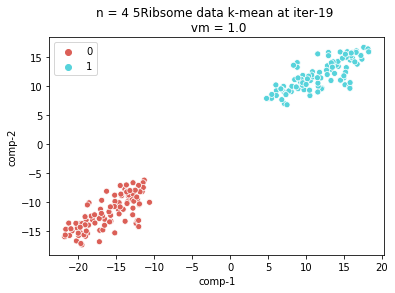

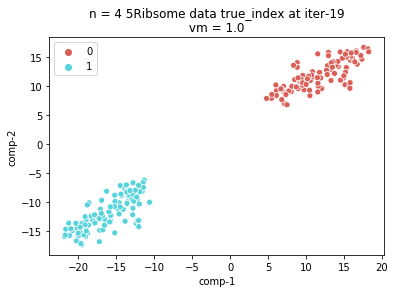

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.708020925521851 sec
0 batch 20 iteration
generated


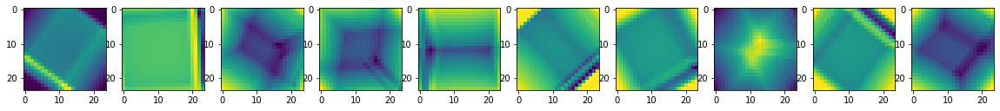

real


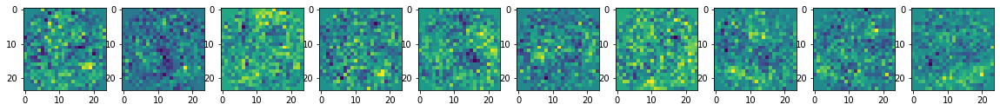

5.474576950073242 sec
0 batch 21 iteration
generated


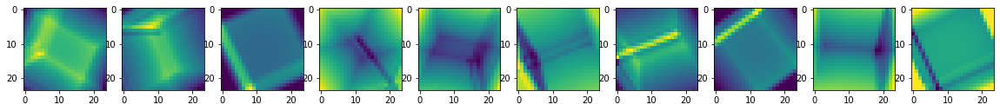

real


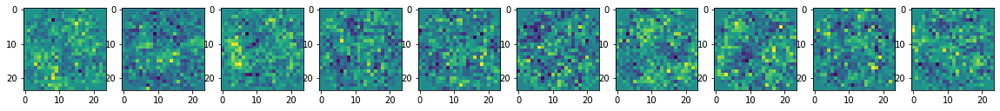

6.397639036178589 sec
0 batch 22 iteration
generated


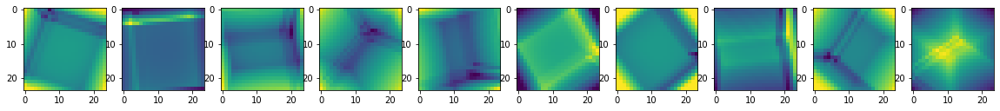

real


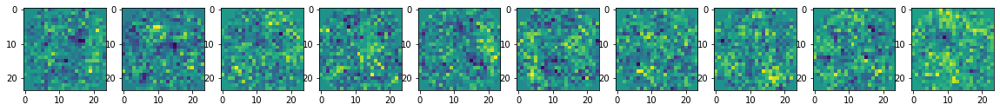

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.004s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.046284
[t-SNE] KL divergence after 250 iterations with early exaggeration: 53.196766
[t-SNE] KL divergence after 1000 iterations: 0.269542
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


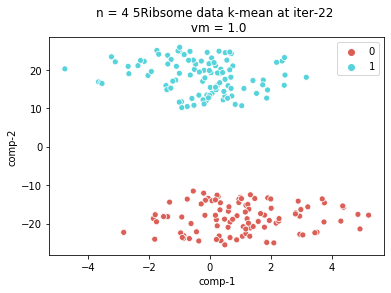

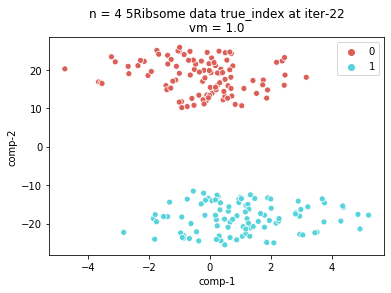

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


6.127123117446899 sec
0 batch 23 iteration
generated


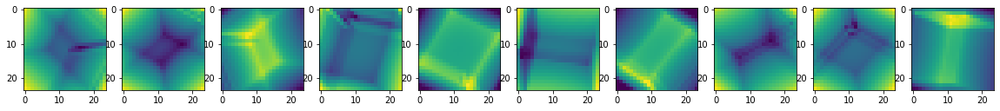

real


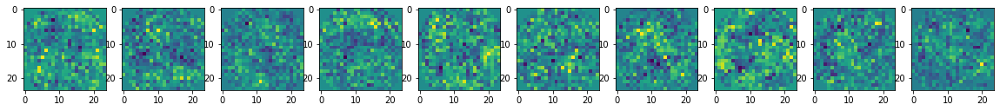

5.800961256027222 sec
0 batch 24 iteration
generated


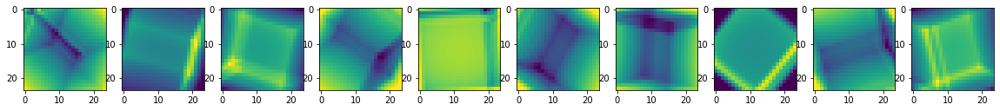

real


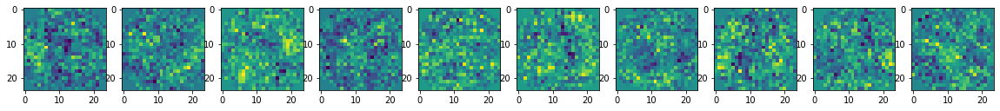

5.74067497253418 sec
0 batch 25 iteration
generated


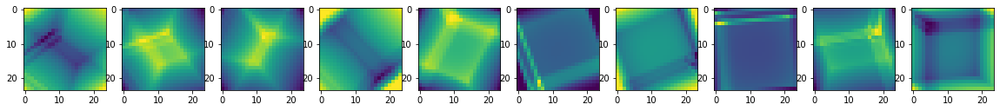

real


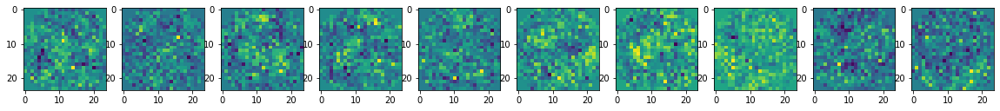

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.004s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.043820
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.880600
[t-SNE] KL divergence after 1000 iterations: 0.246338
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


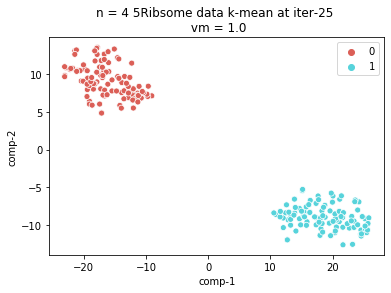

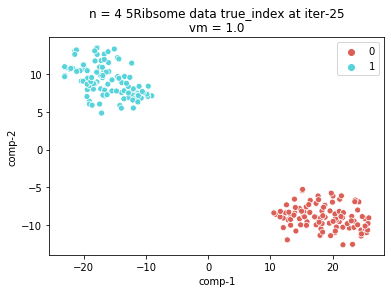

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


6.122894525527954 sec
0 batch 26 iteration
generated


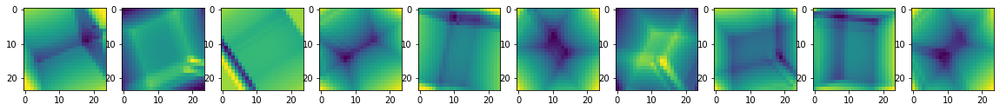

real


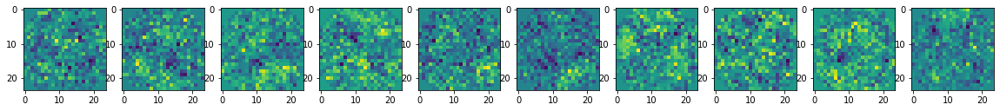

5.990562915802002 sec
0 batch 27 iteration
generated


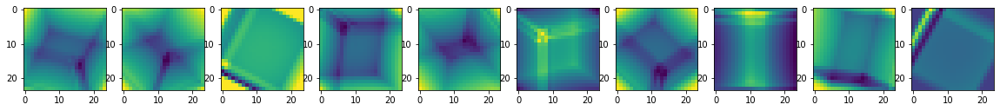

real


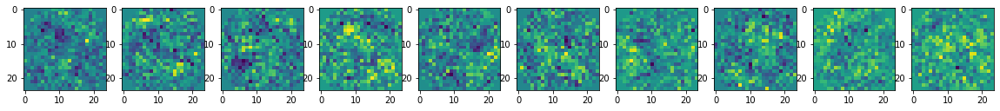

6.23298454284668 sec
0 batch 28 iteration
generated


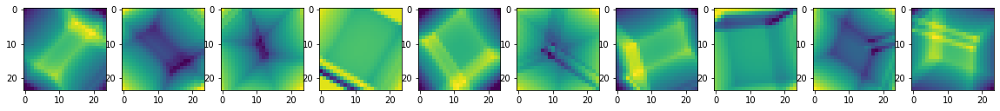

real


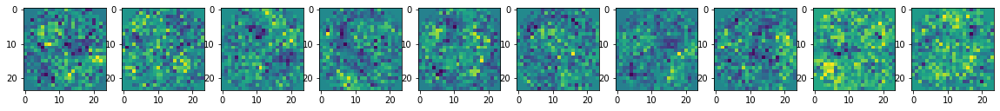

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.003s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.040758
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.753937
[t-SNE] KL divergence after 1000 iterations: 0.282199
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


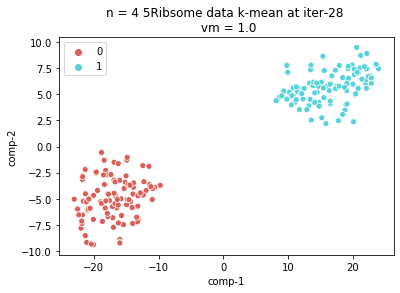

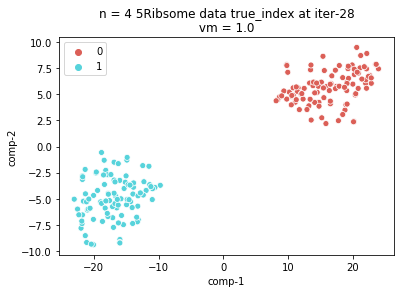

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.946574449539185 sec
0 batch 29 iteration
generated


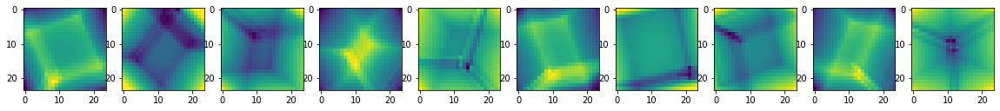

real


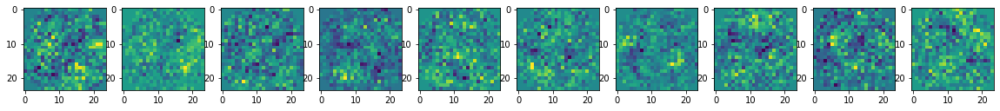

5.97980260848999 sec
0 batch 30 iteration
generated


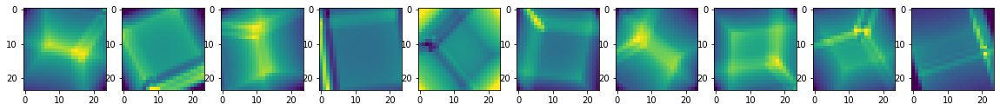

real


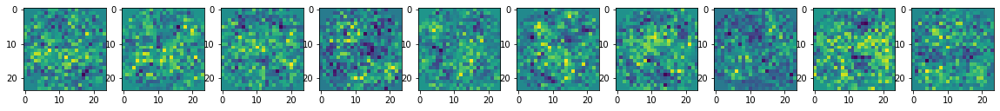

5.765439748764038 sec
0 batch 31 iteration
generated


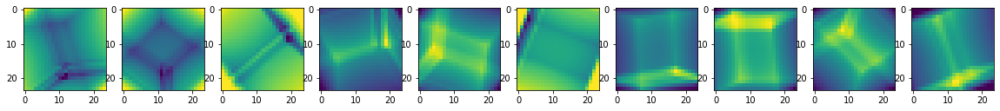

real


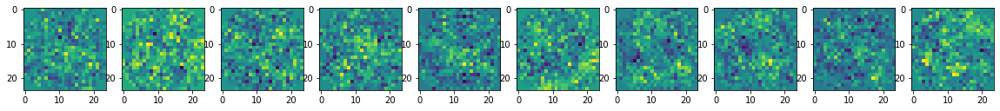

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.006s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.041817
[t-SNE] KL divergence after 250 iterations with early exaggeration: 53.143105
[t-SNE] KL divergence after 1000 iterations: 0.265874
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


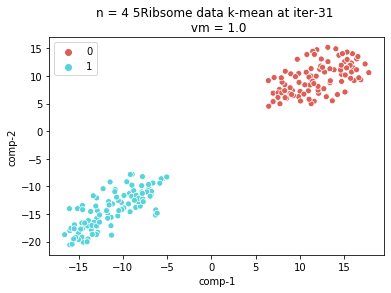

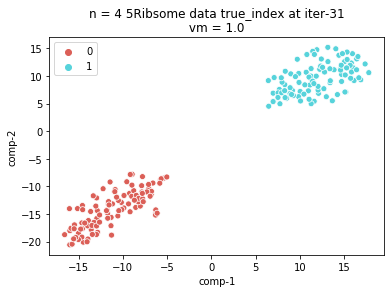

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


6.009035348892212 sec
0 batch 32 iteration
generated


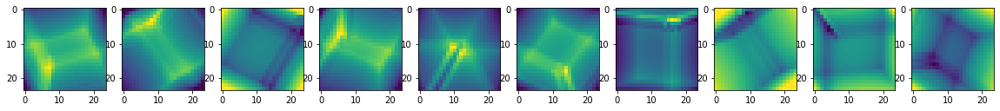

real


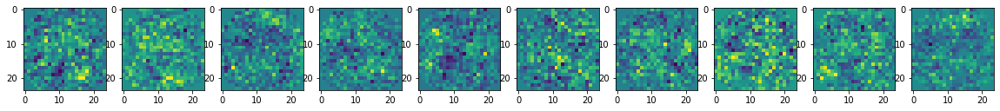

5.794617652893066 sec
0 batch 33 iteration
generated


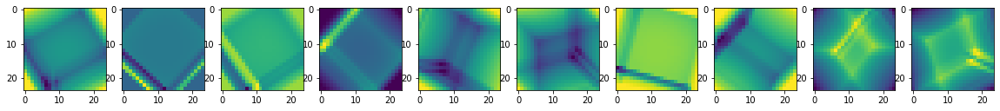

real


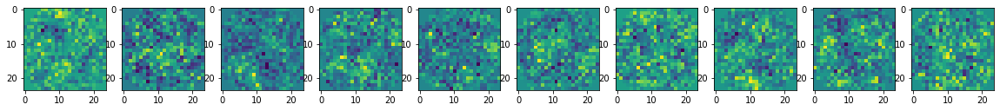

6.217121124267578 sec
0 batch 34 iteration
generated


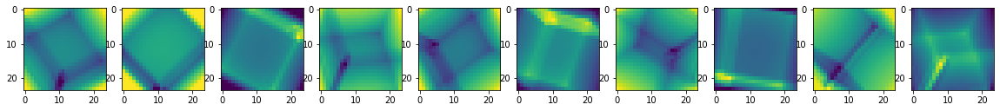

real


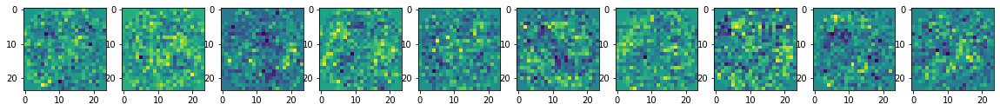

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.037045
[t-SNE] KL divergence after 250 iterations with early exaggeration: 55.146484
[t-SNE] KL divergence after 1000 iterations: 0.294184
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


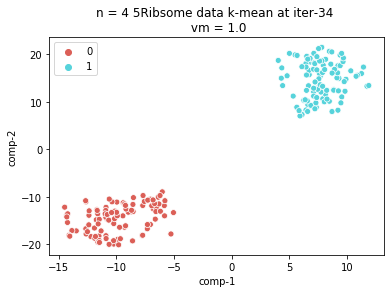

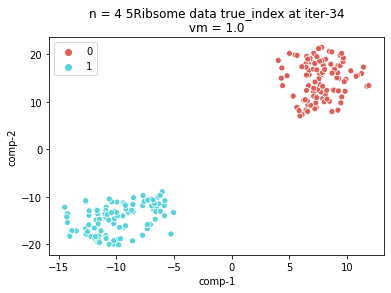

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.745436668395996 sec
0 batch 35 iteration
generated


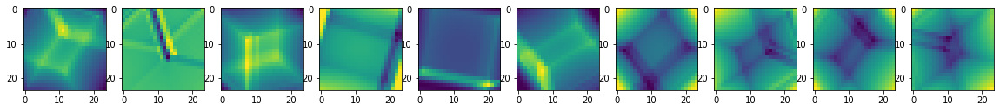

real


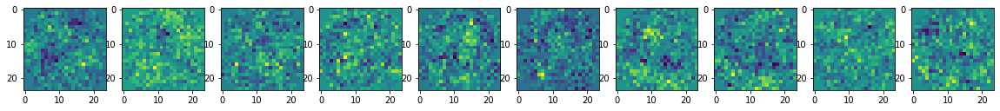

5.2640650272369385 sec
0 batch 36 iteration
generated


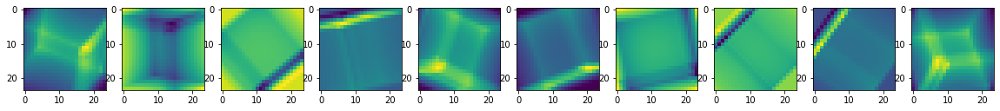

real


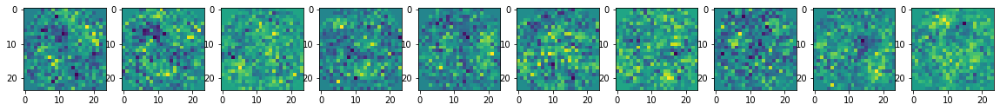

5.668881177902222 sec
0 batch 37 iteration
generated


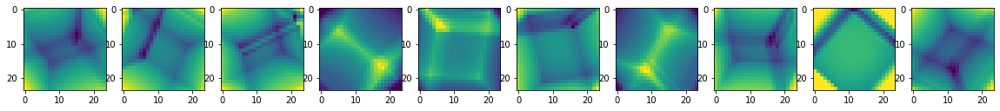

real


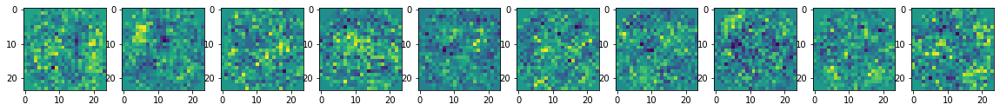

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.009s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.035153
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.686848
[t-SNE] KL divergence after 1000 iterations: 0.324712
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


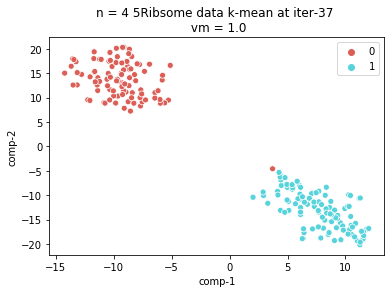

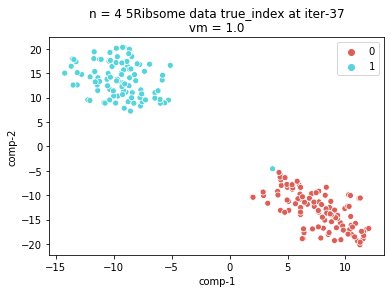

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.815681219100952 sec
0 batch 38 iteration
generated


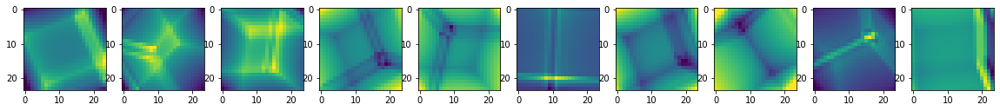

real


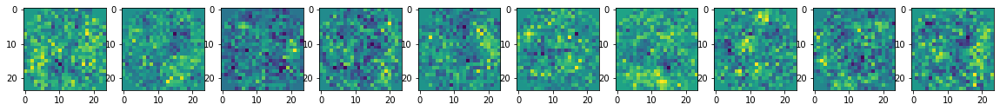

6.050928592681885 sec
0 batch 39 iteration
generated


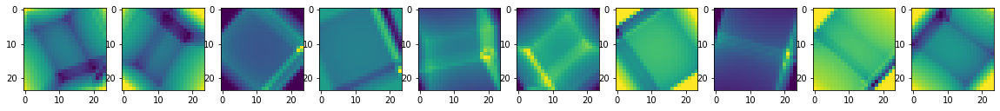

real


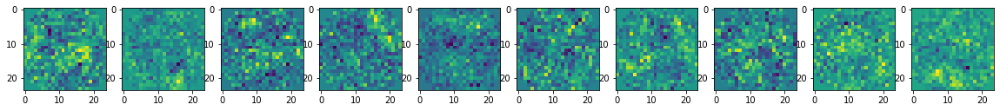

5.104278802871704 sec
0 batch 40 iteration
generated


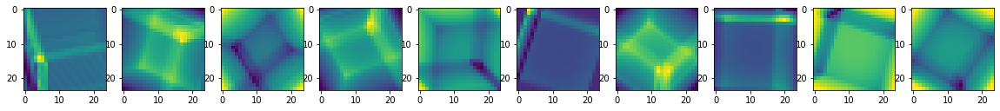

real


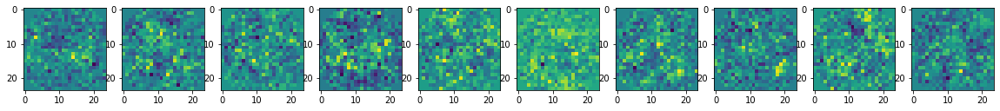

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.009s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.035763
[t-SNE] KL divergence after 250 iterations with early exaggeration: 53.354282
[t-SNE] KL divergence after 1000 iterations: 0.285169
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


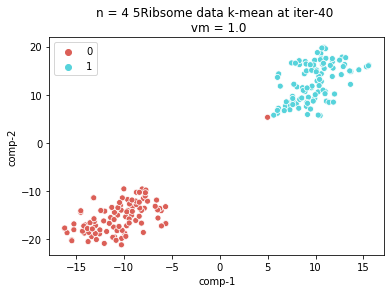

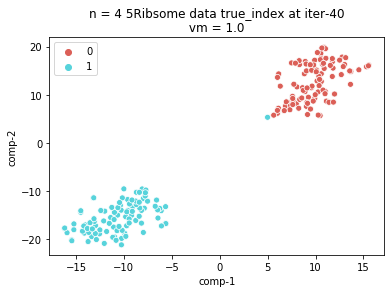

the 0 th iter, ratio = 0.01
output_collection 0-th batch


/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.035763
[t-SNE] KL divergence after 250 iterations with early exaggeration: 53.354282
[t-SNE] KL divergence after 1000 iterations: 0.285169
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


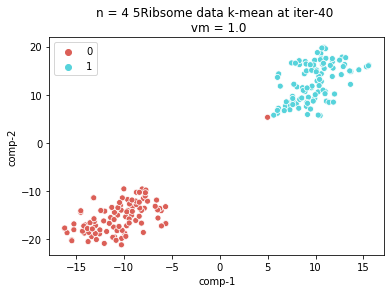

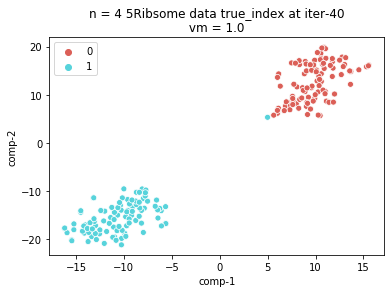

output_collection 0-th batch


/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


output_collection 1-th batch
output_collection 2-th batch
output_collection 3-th batch
output_collection 4-th batch
output_collection 5-th batch
output_collection 6-th batch
output_collection 7-th batch
output_collection 8-th batch
output_collection 9-th batch
output_collection 10-th batch
output_collection 11-th batch
output_collection 12-th batch
output_collection 13-th batch
output_collection 14-th batch
output_collection 15-th batch
output_collection 16-th batch
output_collection 17-th batch
output_collection 18-th batch
output_collection 19-th batch
output_collection 20-th batch
output_collection 21-th batch
output_collection 22-th batch
output_collection 23-th batch
output_collection 24-th batch
output_collection 25-th batch
output_collection 26-th batch
output_collection 27-th batch
output_collection 28-th batch
output_collection 29-th batch
output_collection 30-th batch
output_collection 31-th batch
output_collection 32-th batch
output_collection 33-th batch
output_collection 3

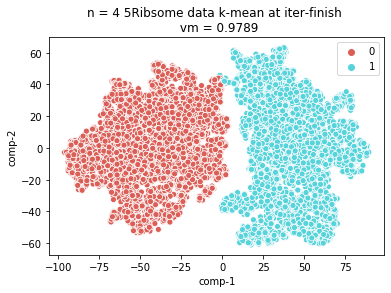

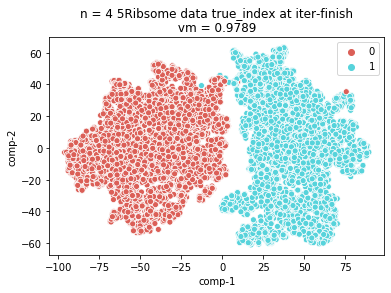

In [19]:
#snr_list = [10, 5, 1, 0.8, 0.6, 0.4, 0.2, 0.1]
snr = 0.8
data_name = f'70s_2class_0304+{snr}'
with open(f'./data/{data_name}/images.pkl', 'rb') as f:
    new_projection = pickle.load( f)

with open(f'./data/{data_name}/angles.pkl', 'rb') as f:
    angles2 = pickle.load( f)

with open(f'./data/{data_name}/orientation_matrix.pkl', 'rb') as f:
    Orientation_Vectors = pickle.load(f)

with open(f'./data/{data_name}/indexs.pkl', 'rb') as f:
    indexs = pickle.load(f)
print('indexs',indexs[:10])     
with open(f'./data/{data_name}/mean_subtracted_strcut.pkl', 'rb') as f:
    mean_subtracted_strcut = pickle.load(f)
    
new_projection = new_projection * mask
print(new_projection.shape)
new_projection = new_projection[:,5:29,5:29]
plt.imshow(new_projection[0])
plt.show()
print(angles2)
n = 4
b = 200
niter = 40
pca_n = 2
Images = new_projection#[:5000]
print(Images.shape)
exp_name = f'20220320_{data_name}_EM_2SDR_n_{n}'
ProjSize, num_image, n_component , num_iter = 24, Images.shape[0], n, niter
batch_size = b
Vol_geom = astra.create_vol_geom(ProjSize, ProjSize, ProjSize)
#Images = torch.ones(num_image, 48, 48) # fake images for computing purpose

vg = ts.from_astra(Vol_geom)
pg = ts.from_astra(Proj_geom)
op = ts.operator(vg, pg)
MP3 = EM_2SDR(ProjSize, num_image, n_component, op , Images,Orientation_Vectors, exp_name,mean_subtracted_strcut, indexs, batch_size, niter, PCA_n= pca_n)
#MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)
MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)
MP3.fit(0.01, True)
MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


6.173433065414429 sec
0 batch 1 iteration
generated


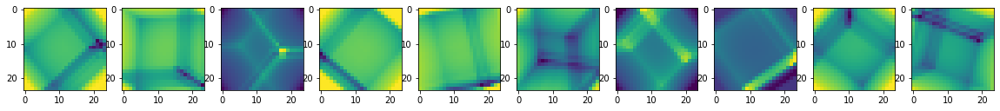

real


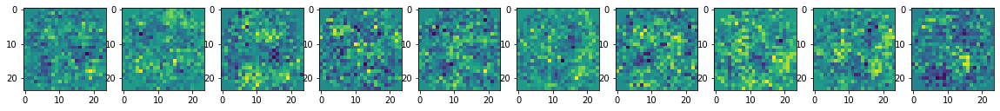

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.008s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.032042
[t-SNE] KL divergence after 250 iterations with early exaggeration: 54.091896
[t-SNE] KL divergence after 1000 iterations: 0.303518
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


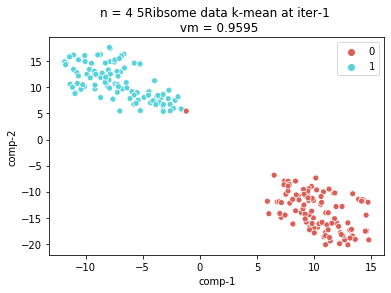

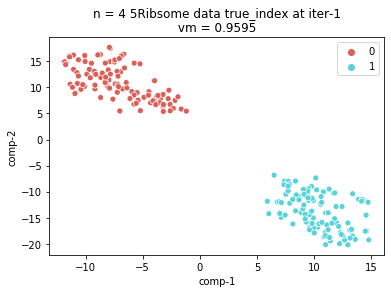

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


6.103163719177246 sec
0 batch 2 iteration
generated


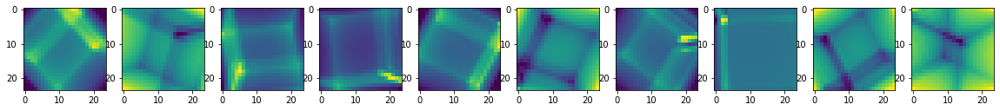

real


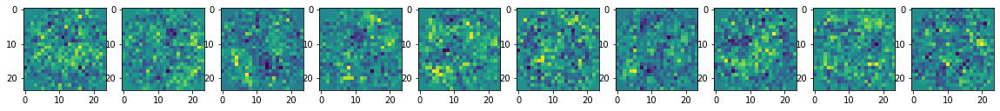

6.020262956619263 sec
0 batch 3 iteration
generated


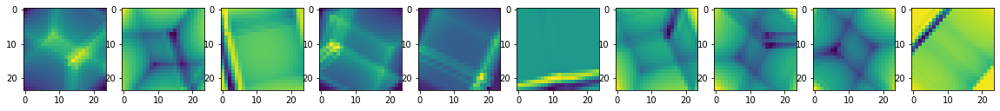

real


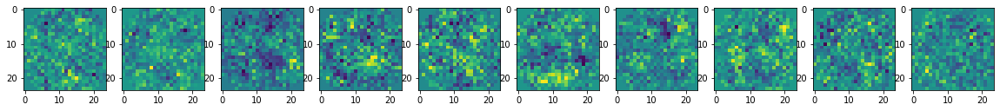

5.957139730453491 sec
0 batch 4 iteration
generated


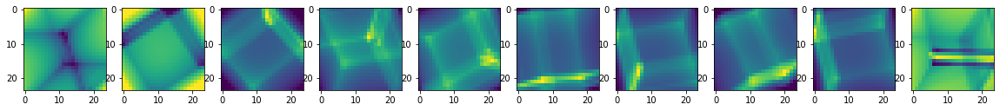

real


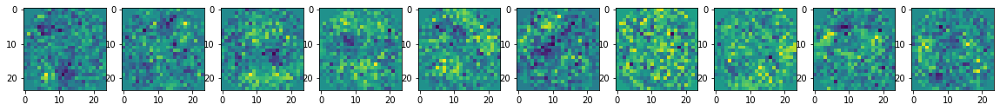

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.029767
[t-SNE] KL divergence after 250 iterations with early exaggeration: 53.388058
[t-SNE] KL divergence after 900 iterations: 0.308976
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


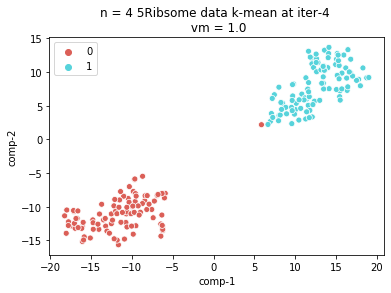

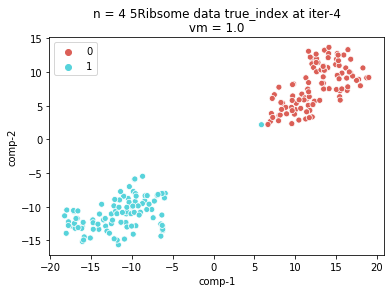

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.914593458175659 sec
0 batch 5 iteration
generated


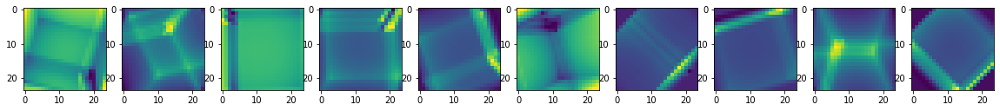

real


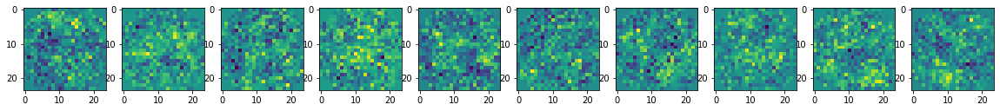

5.675504446029663 sec
0 batch 6 iteration
generated


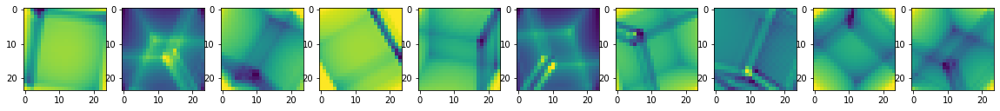

real


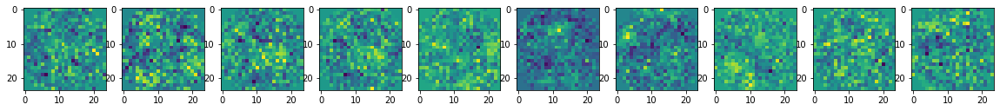

5.745728254318237 sec
0 batch 7 iteration
generated


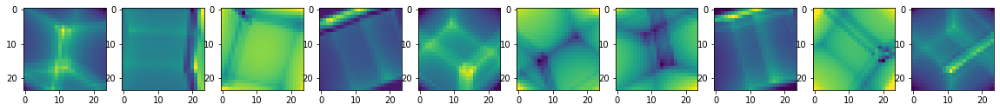

real


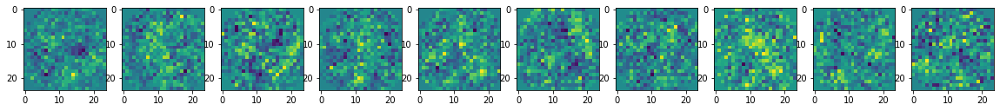

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.029125
[t-SNE] KL divergence after 250 iterations with early exaggeration: 53.467789
[t-SNE] KL divergence after 1000 iterations: 0.354393
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


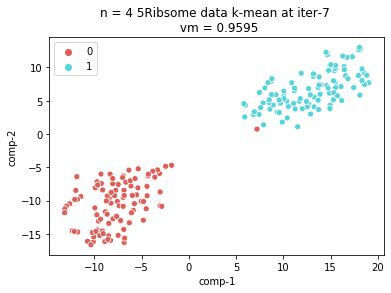

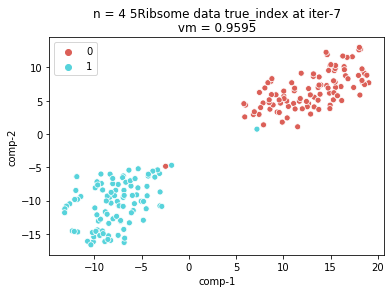

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.9382524490356445 sec
0 batch 8 iteration
generated


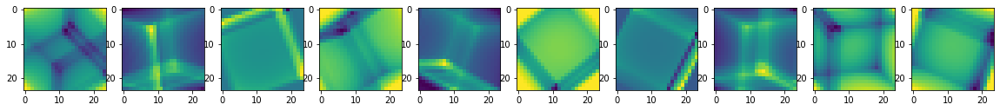

real


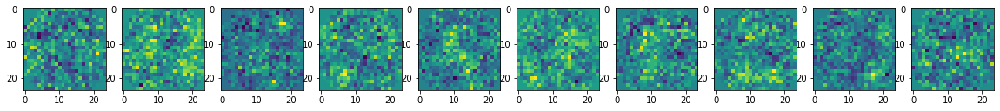

5.83897590637207 sec
0 batch 9 iteration
generated


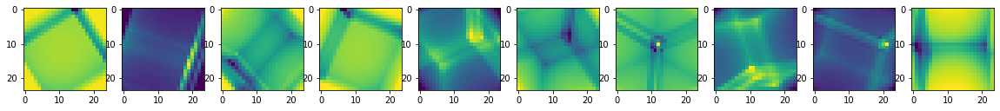

real


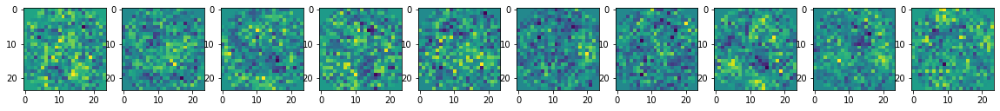

5.996148109436035 sec
0 batch 10 iteration
generated


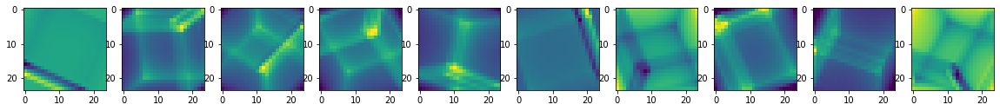

real


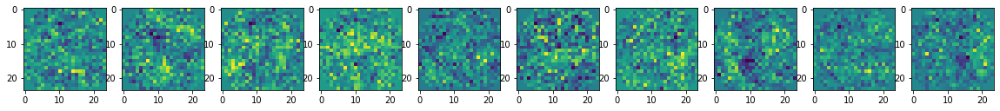

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.004s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.028893
[t-SNE] KL divergence after 250 iterations with early exaggeration: 54.044365
[t-SNE] KL divergence after 1000 iterations: 0.330679
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


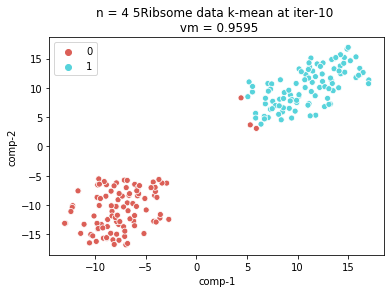

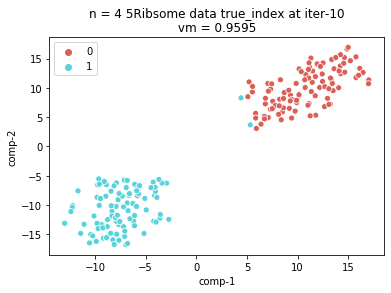

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.8915932178497314 sec
0 batch 11 iteration
generated


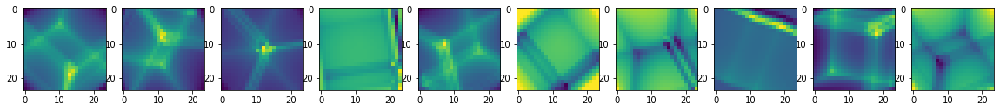

real


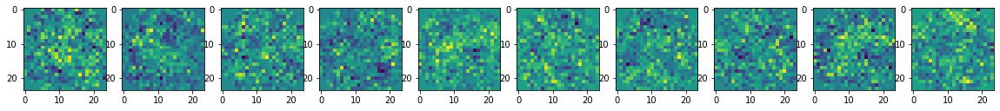

5.8105552196502686 sec
0 batch 12 iteration
generated


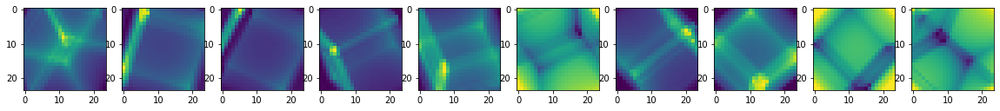

real


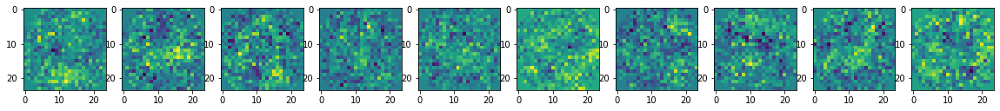

5.864009380340576 sec
0 batch 13 iteration
generated


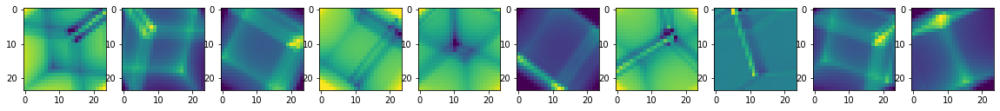

real


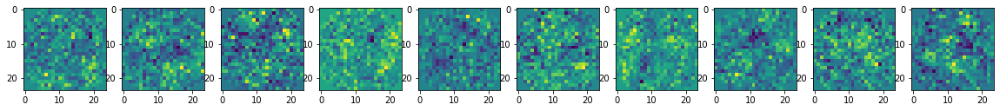

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.027012
[t-SNE] KL divergence after 250 iterations with early exaggeration: 53.436192
[t-SNE] KL divergence after 1000 iterations: 0.310125
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


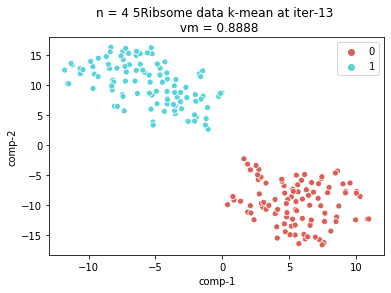

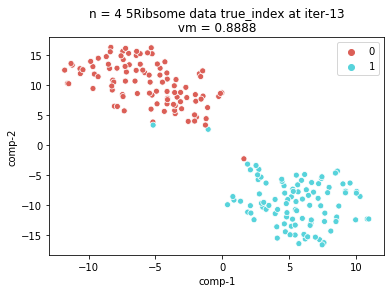

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.710539102554321 sec
0 batch 14 iteration
generated


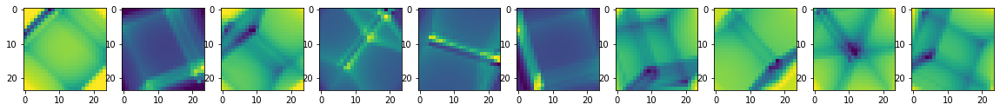

real


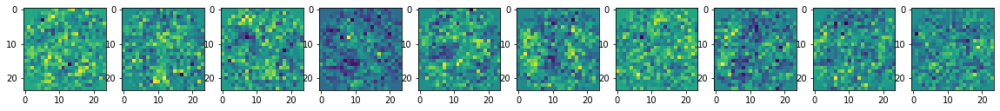

5.569549083709717 sec
0 batch 15 iteration
generated


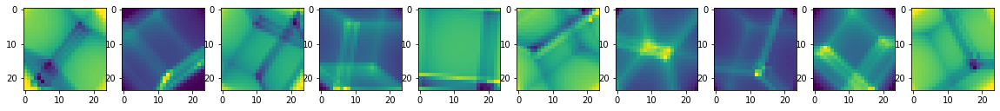

real


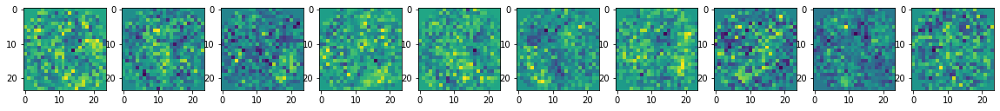

5.814268112182617 sec
0 batch 16 iteration
generated


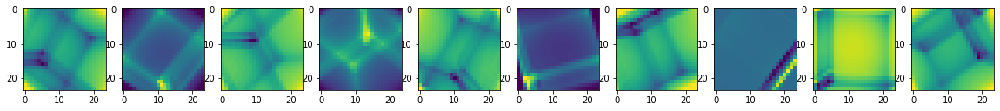

real


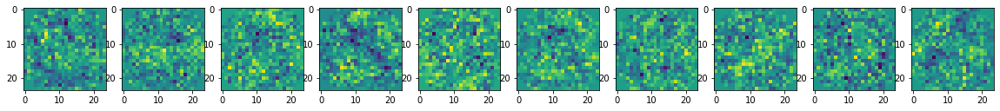

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.008s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.026217
[t-SNE] KL divergence after 250 iterations with early exaggeration: 54.291691
[t-SNE] KL divergence after 900 iterations: 0.334750
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


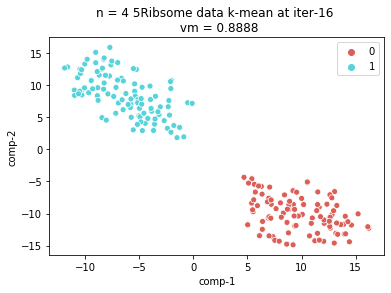

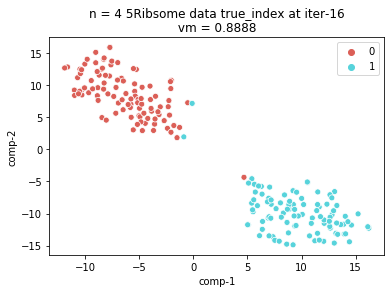

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


6.018617630004883 sec
0 batch 17 iteration
generated


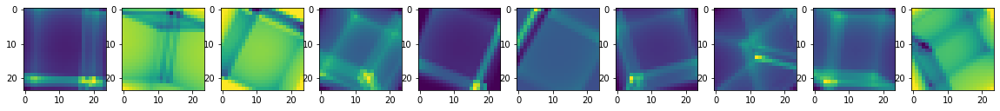

real


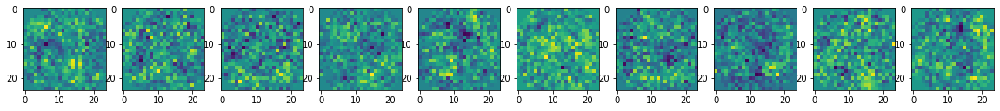

5.765090703964233 sec
0 batch 18 iteration
generated


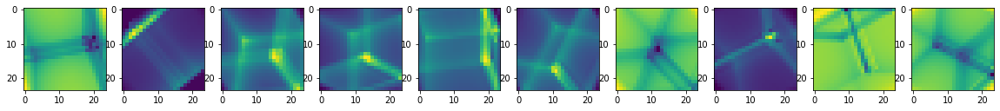

real


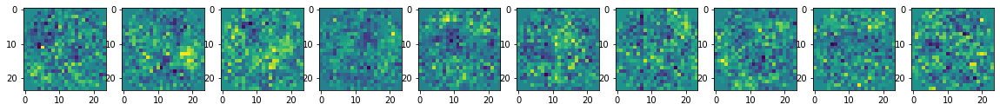

5.975003719329834 sec
0 batch 19 iteration
generated


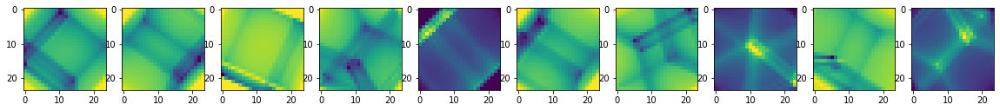

real


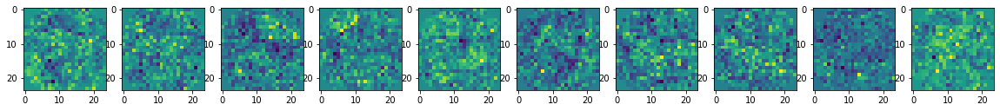

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.007s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.025420
[t-SNE] KL divergence after 250 iterations with early exaggeration: 54.170799
[t-SNE] KL divergence after 950 iterations: 0.329076
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


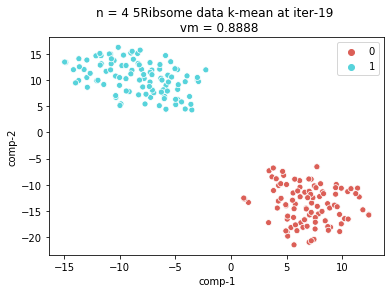

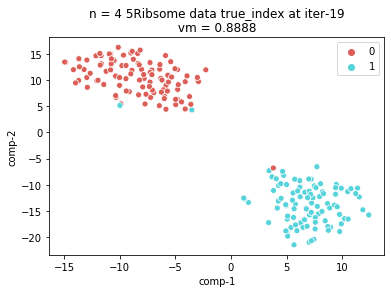

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.7200233936309814 sec
0 batch 20 iteration
generated


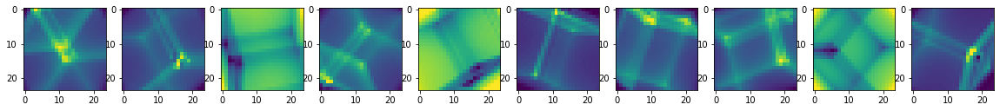

real


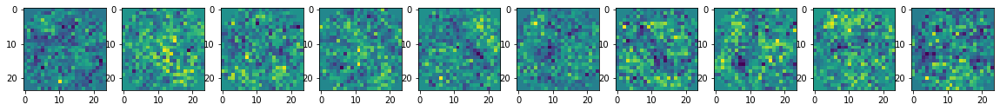

5.6685450077056885 sec
0 batch 21 iteration
generated


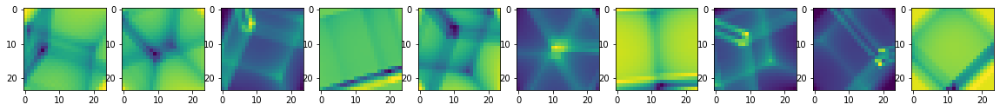

real


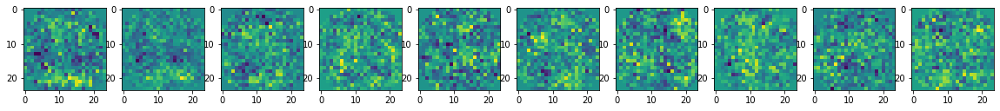

6.020388841629028 sec
0 batch 22 iteration
generated


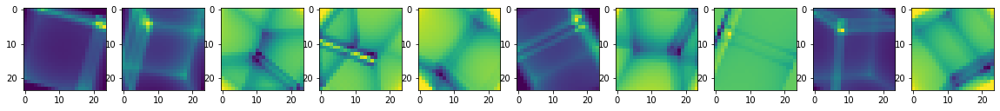

real


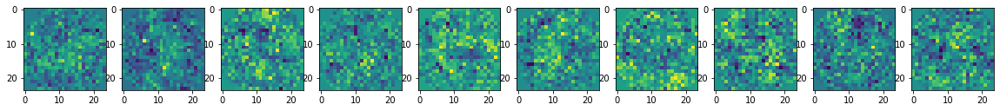

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.025807
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.997028
[t-SNE] KL divergence after 1000 iterations: 0.332585
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


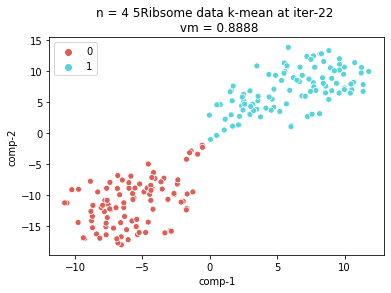

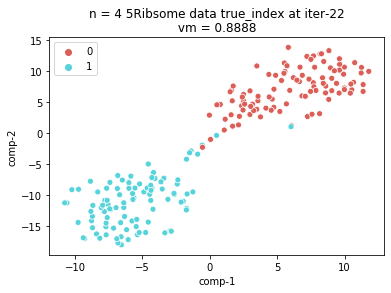

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.802750825881958 sec
0 batch 23 iteration
generated


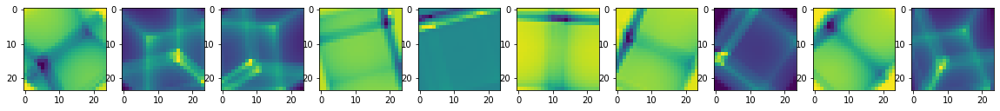

real


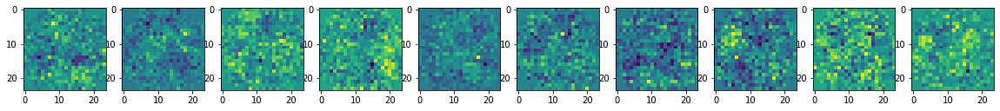

5.621107339859009 sec
0 batch 24 iteration
generated


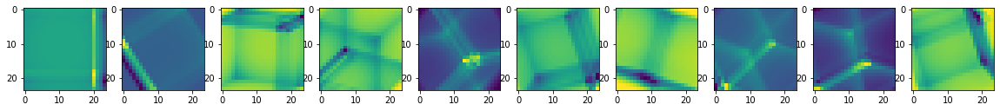

real


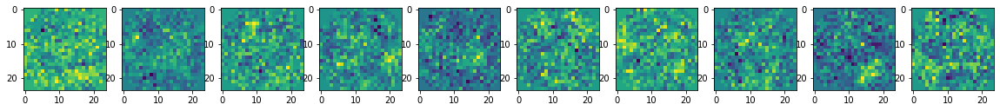

5.759501695632935 sec
0 batch 25 iteration
generated


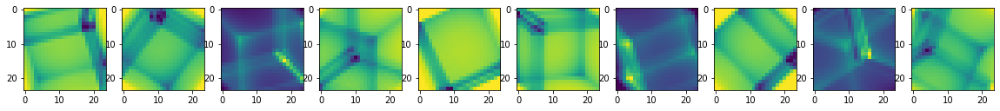

real


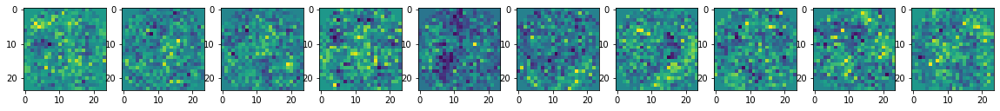

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.024904
[t-SNE] KL divergence after 250 iterations with early exaggeration: 55.367687
[t-SNE] KL divergence after 800 iterations: 0.376277
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


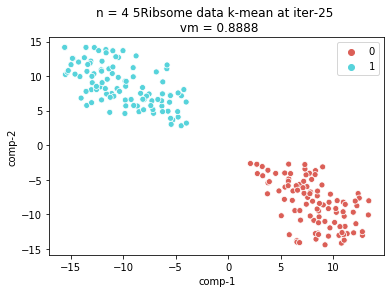

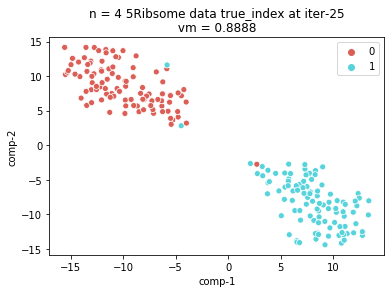

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.8307976722717285 sec
0 batch 26 iteration
generated


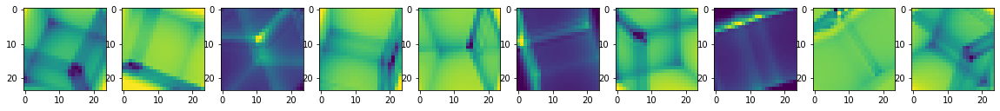

real


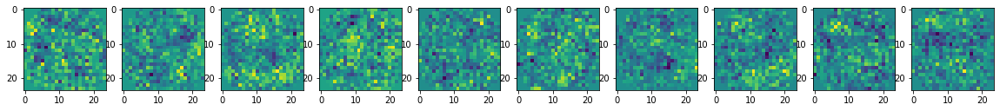

5.428166151046753 sec
0 batch 27 iteration
generated


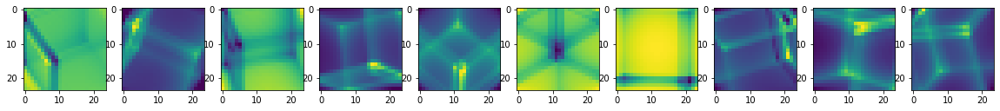

real


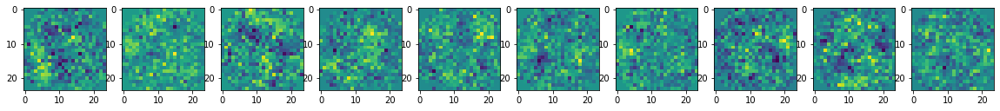

5.922863483428955 sec
0 batch 28 iteration
generated


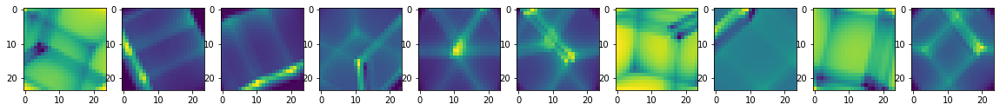

real


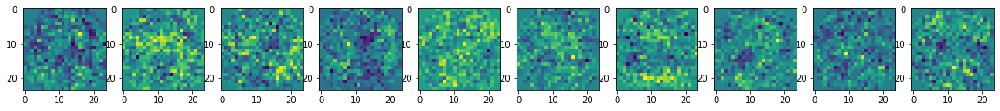

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.006s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.023099
[t-SNE] KL divergence after 250 iterations with early exaggeration: 55.501266
[t-SNE] KL divergence after 950 iterations: 0.342940
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


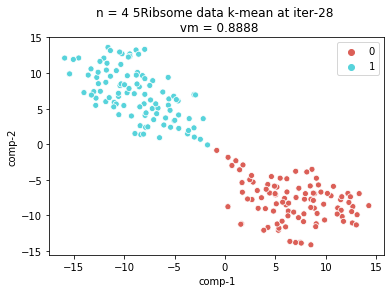

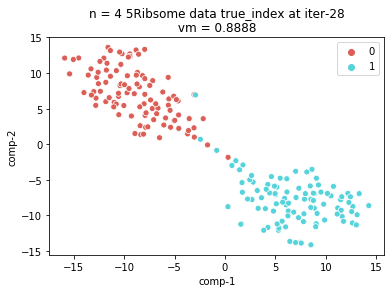

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.885934352874756 sec
0 batch 29 iteration
generated


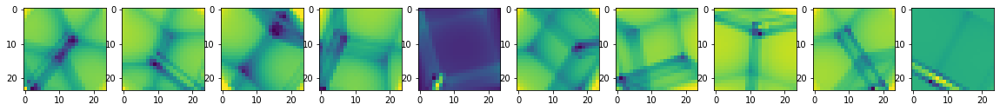

real


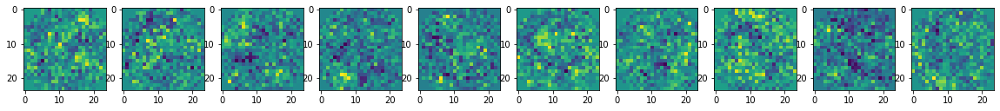

6.044318675994873 sec
0 batch 30 iteration
generated


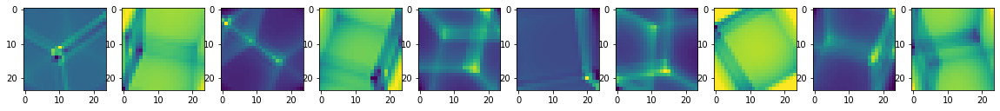

real


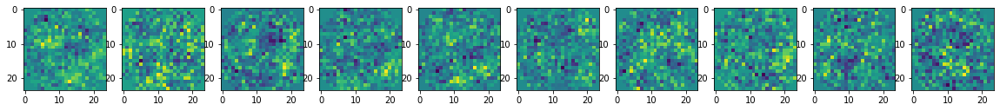

6.274165153503418 sec
0 batch 31 iteration
generated


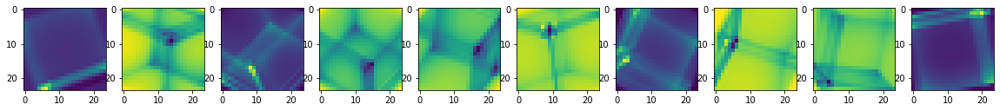

real


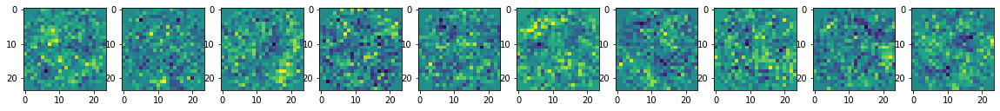

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.004s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.023224
[t-SNE] KL divergence after 250 iterations with early exaggeration: 55.887966
[t-SNE] KL divergence after 850 iterations: 0.356835
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


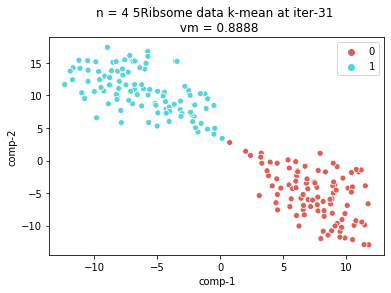

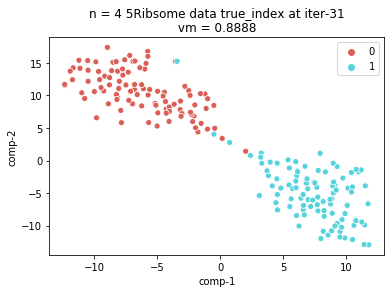

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


6.015753507614136 sec
0 batch 32 iteration
generated


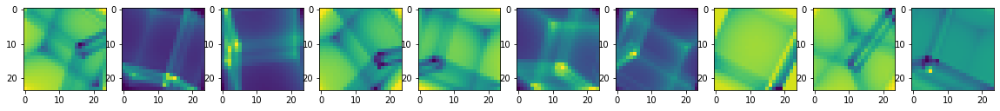

real


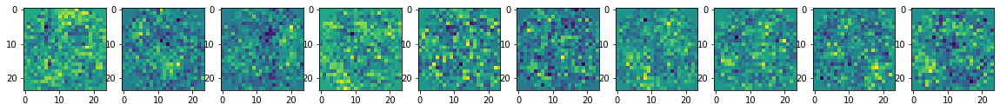

5.864461898803711 sec
0 batch 33 iteration
generated


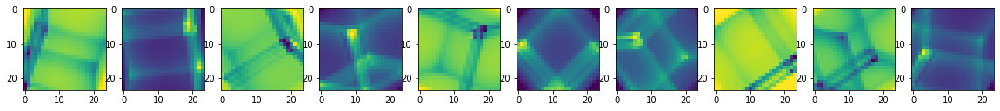

real


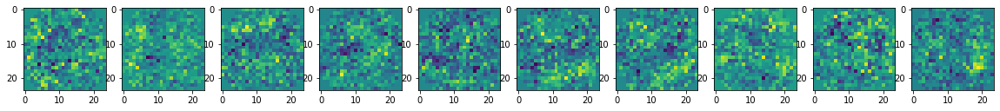

6.201280117034912 sec
0 batch 34 iteration
generated


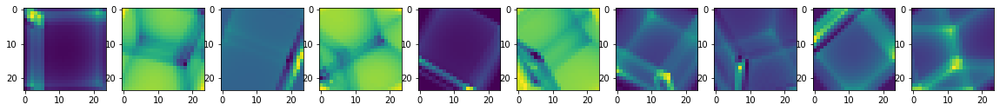

real


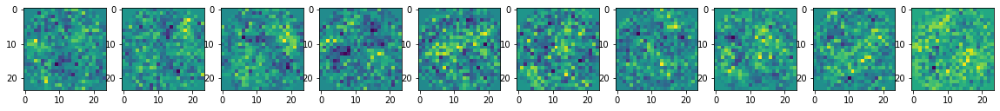

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.004s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.022660
[t-SNE] KL divergence after 250 iterations with early exaggeration: 55.834934
[t-SNE] KL divergence after 1000 iterations: 0.319705
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


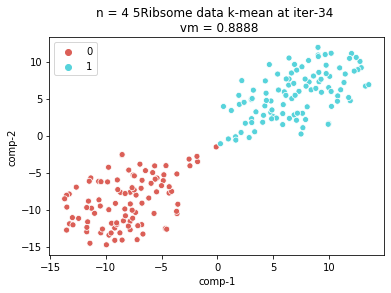

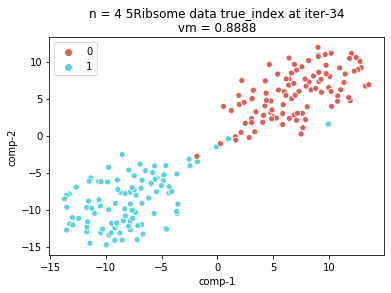

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


6.196313381195068 sec
0 batch 35 iteration
generated


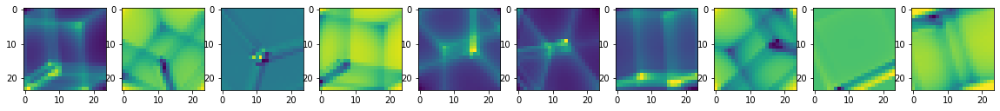

real


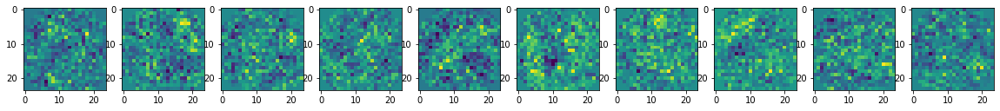

5.712630271911621 sec
0 batch 36 iteration
generated


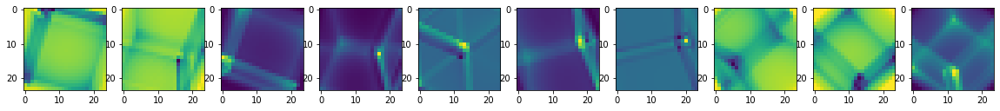

real


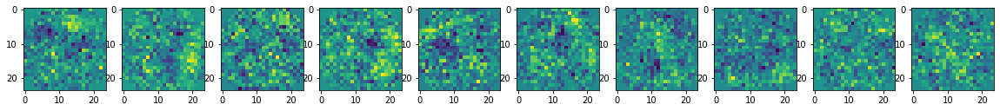

5.835901737213135 sec
0 batch 37 iteration
generated


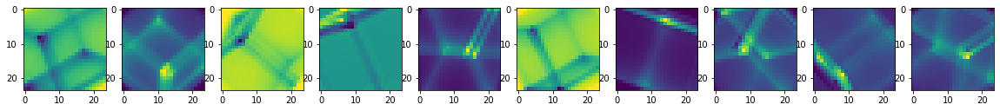

real


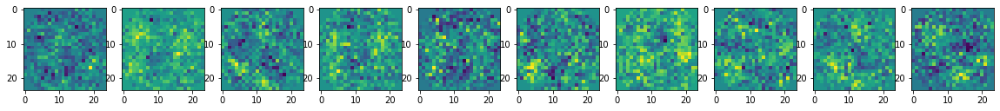

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.004s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.021908
[t-SNE] KL divergence after 250 iterations with early exaggeration: 54.585903
[t-SNE] KL divergence after 1000 iterations: 0.364929
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


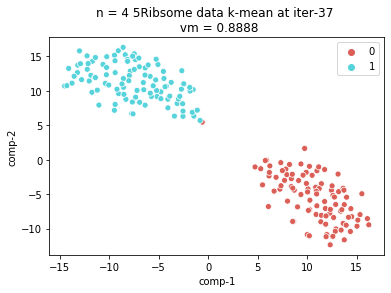

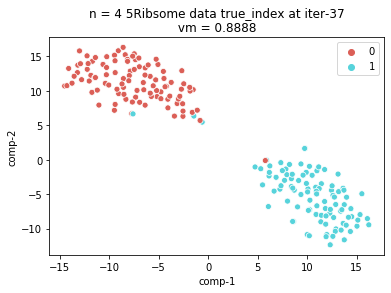

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.911759376525879 sec
0 batch 38 iteration
generated


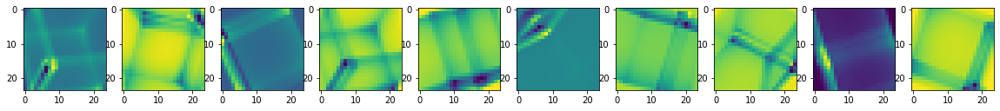

real


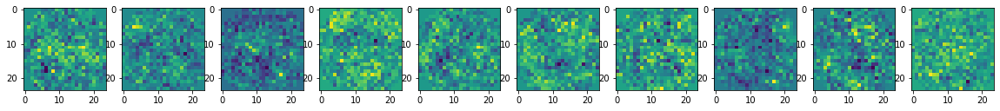

6.054971694946289 sec
0 batch 39 iteration
generated


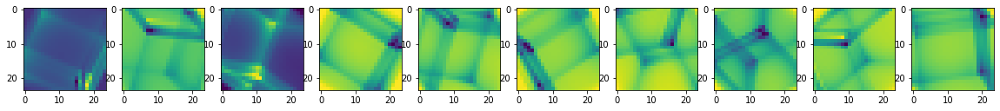

real


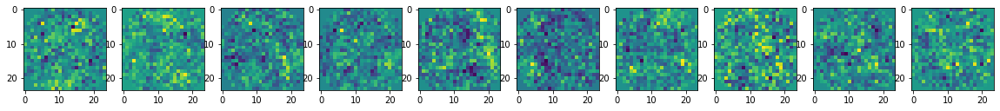

KeyboardInterrupt: 

In [18]:
MP3.fit(0.01, True)


In [ ]:
#snr_list = [10, 5, 1, 0.8, 0.6, 0.4, 0.2, 0.1]
snr = 0.8
data_name = f'70s_2class_0304+{snr}'
with open(f'./data/{data_name}/images.pkl', 'rb') as f:
    new_projection = pickle.load( f)

with open(f'./data/{data_name}/angles.pkl', 'rb') as f:
    angles2 = pickle.load( f)

with open(f'./data/{data_name}/orientation_matrix.pkl', 'rb') as f:
    Orientation_Vectors = pickle.load(f)

with open(f'./data/{data_name}/indexs.pkl', 'rb') as f:
    indexs = pickle.load(f)
print('indexs',indexs[:10])     
with open(f'./data/{data_name}/mean_subtracted_strcut.pkl', 'rb') as f:
    mean_subtracted_strcut = pickle.load(f)
    
new_projection = new_projection * mask
print(new_projection.shape)
new_projection = new_projection[:,5:29,5:29]
plt.imshow(new_projection[0])
plt.show()
print(angles2)
n = 4
b = 200
niter = 20
pca_n = 2
Images = new_projection#[:5000]
print(Images.shape)
exp_name = f'20220320_{data_name}_EM_2SDR_n_{n}'
ProjSize, num_image, n_component , num_iter = 24, Images.shape[0], n, niter
batch_size = b
Vol_geom = astra.create_vol_geom(ProjSize, ProjSize, ProjSize)
#Images = torch.ones(num_image, 48, 48) # fake images for computing purpose

vg = ts.from_astra(Vol_geom)
pg = ts.from_astra(Proj_geom)
op = ts.operator(vg, pg)
MP3 = EM_2SDR(ProjSize, num_image, n_component, op , Images,Orientation_Vectors, exp_name,mean_subtracted_strcut, indexs, batch_size, niter, PCA_n= pca_n)
#MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)
MP3.fit(0.001, True)
MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)

indexs [1 0 0 1 0 1 1 1 0 0]
(10000, 34, 34)


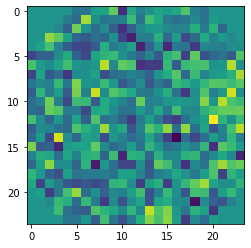

[[5.14449428 1.27176208 4.89739318]
 [0.5159872  0.73028398 1.59682606]
 [1.01101147 1.83496098 3.08531661]
 ...
 [1.66602271 0.48888756 5.53002303]
 [0.78062598 1.15543222 4.43331694]
 [5.25564627 1.11403912 4.99492253]]
(10000, 24, 24)
5.681961536407471 sec
0 batch 1 iteration
generated


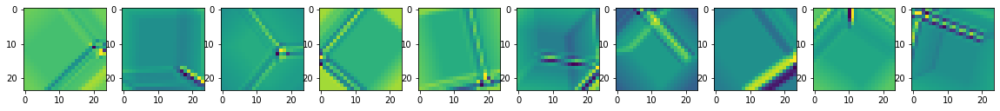

real


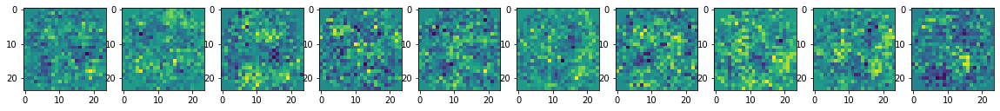

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.006s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.076227
[t-SNE] KL divergence after 250 iterations with early exaggeration: 49.412434
[t-SNE] KL divergence after 1000 iterations: 0.137581
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


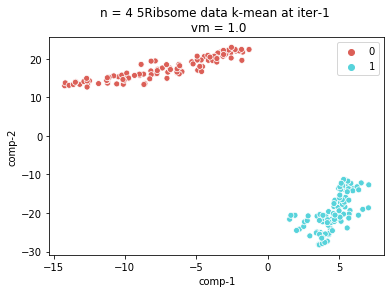

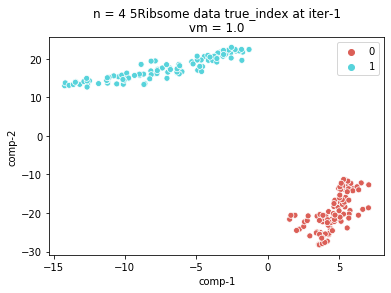

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.888163328170776 sec
0 batch 2 iteration
generated


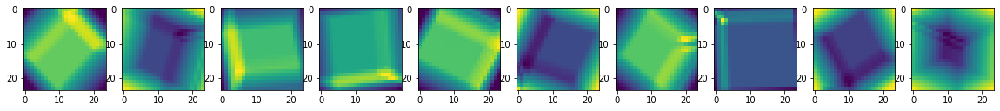

real


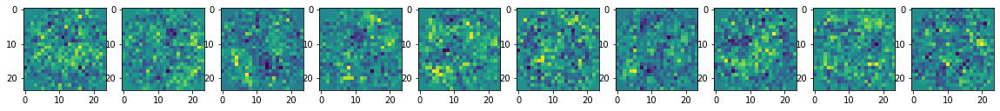

5.654011964797974 sec
0 batch 3 iteration
generated


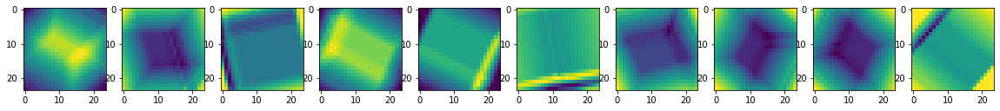

real


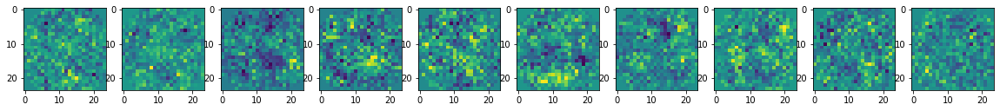

5.570794582366943 sec
0 batch 4 iteration
generated


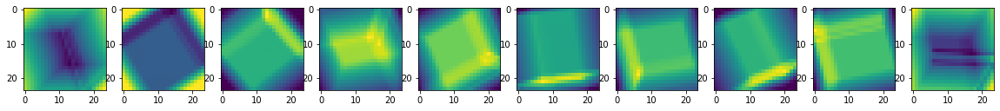

real


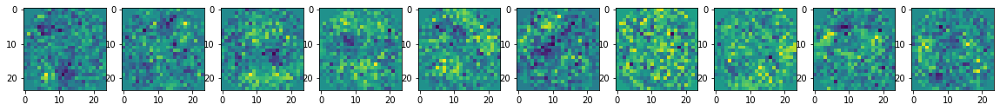

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.004s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.058809
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.093475
[t-SNE] KL divergence after 1000 iterations: 0.150923
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


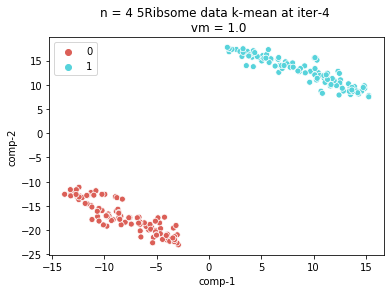

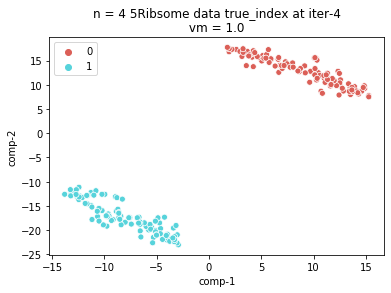

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.696284294128418 sec
0 batch 5 iteration
generated


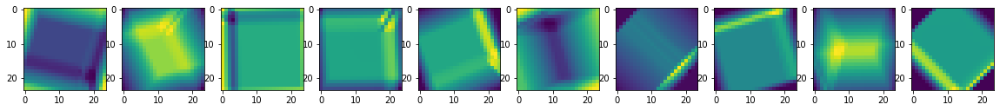

real


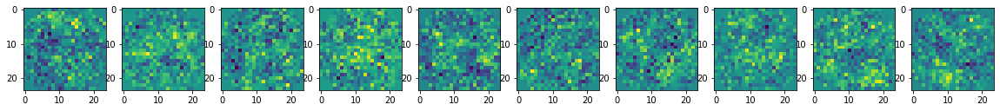

5.851638555526733 sec
0 batch 6 iteration
generated


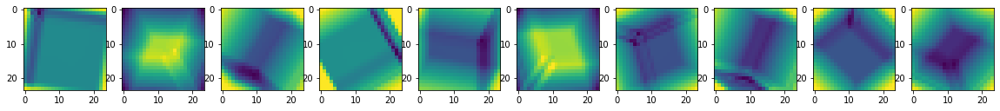

real


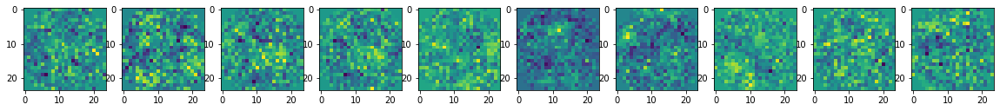

5.892095327377319 sec
0 batch 7 iteration
generated


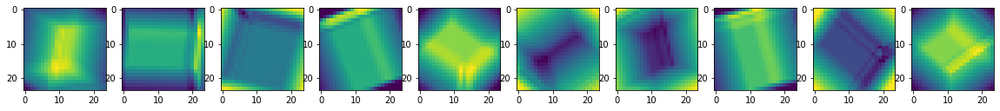

real


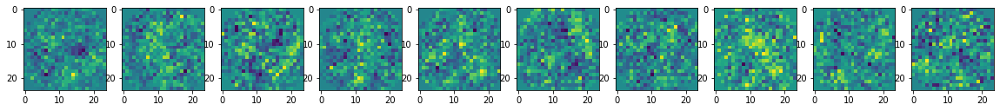

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.003s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.056944
[t-SNE] KL divergence after 250 iterations with early exaggeration: 54.473682
[t-SNE] KL divergence after 1000 iterations: 0.154144
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


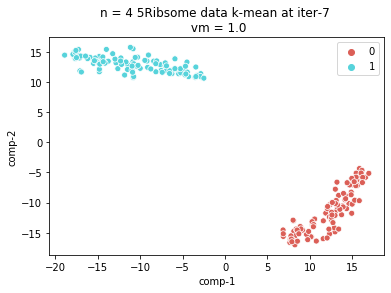

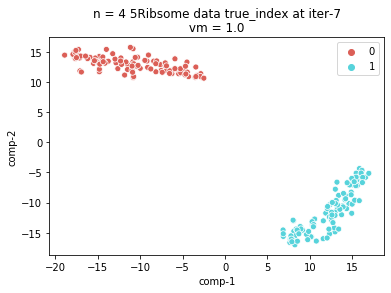

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.7961366176605225 sec
0 batch 8 iteration
generated


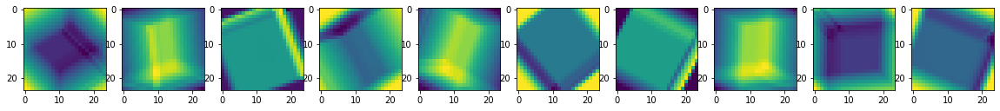

real


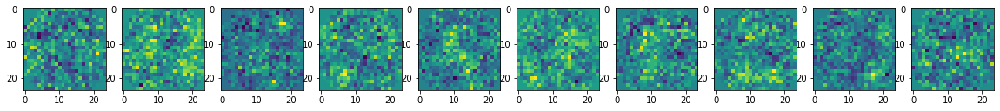

5.785187005996704 sec
0 batch 9 iteration
generated


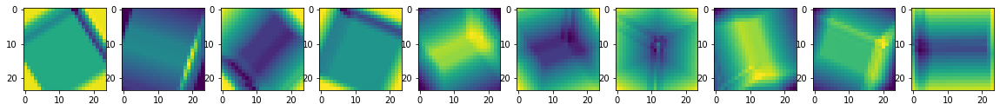

real


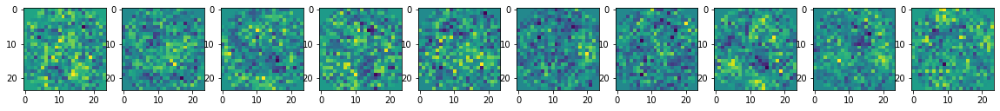

5.950681686401367 sec
0 batch 10 iteration
generated


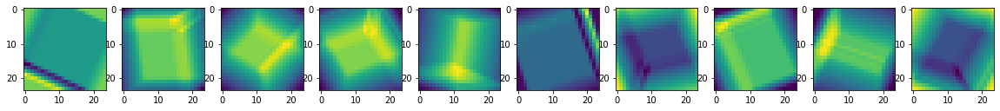

real


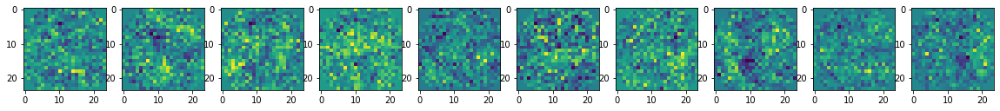

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.004s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.055134
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.547527
[t-SNE] KL divergence after 1000 iterations: 0.177215
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


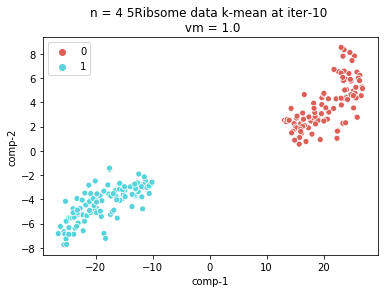

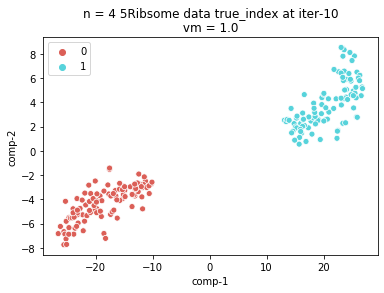

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


6.110753536224365 sec
0 batch 11 iteration
generated


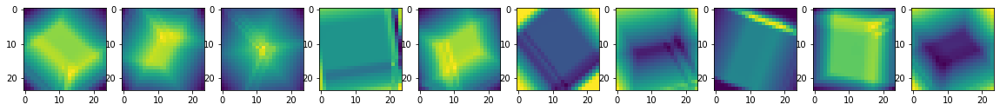

real


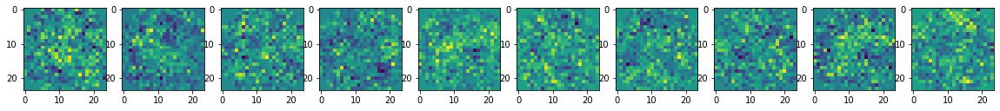

5.911546468734741 sec
0 batch 12 iteration
generated


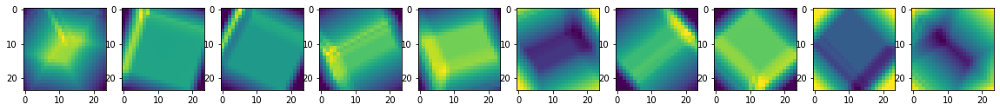

real


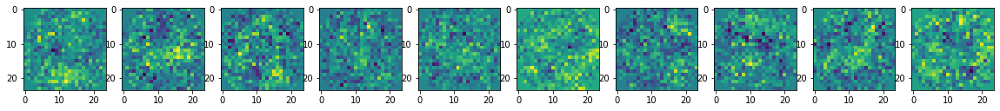

6.016134738922119 sec
0 batch 13 iteration
generated


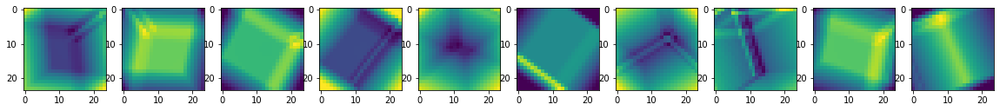

real


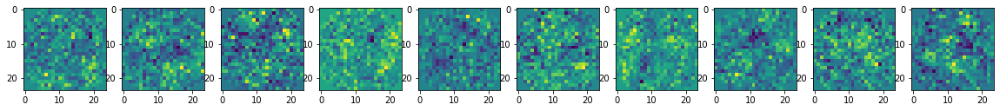

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.004s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.049586
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.810760
[t-SNE] KL divergence after 1000 iterations: 0.201275
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


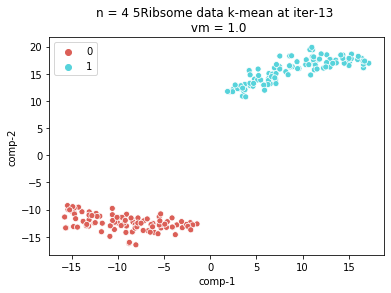

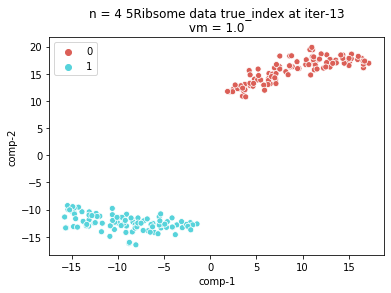

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.7308030128479 sec
0 batch 14 iteration
generated


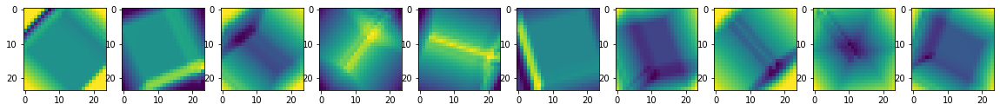

real


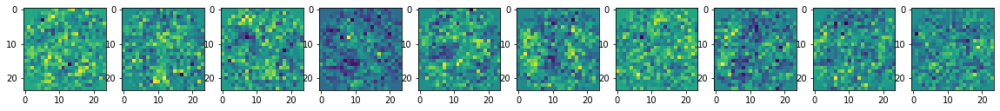

5.785034656524658 sec
0 batch 15 iteration
generated


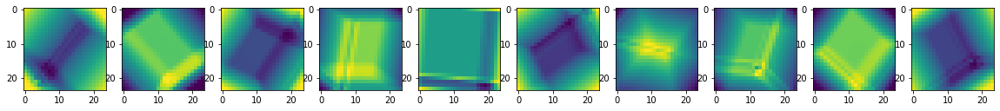

real


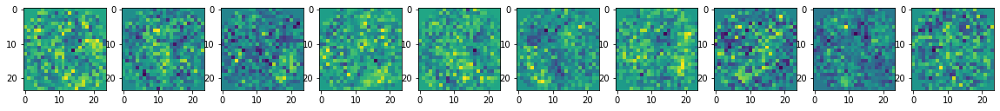

5.910262584686279 sec
0 batch 16 iteration
generated


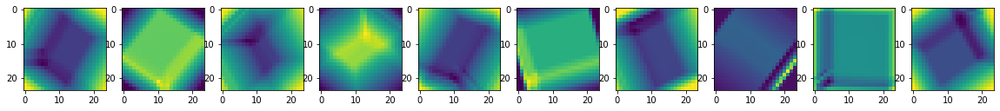

real


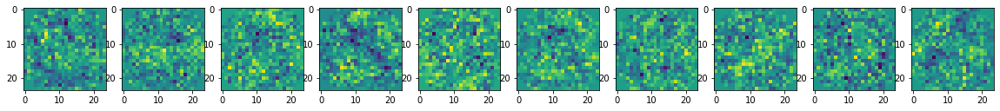

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.004s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.048660
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.782734
[t-SNE] KL divergence after 1000 iterations: 0.196572
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


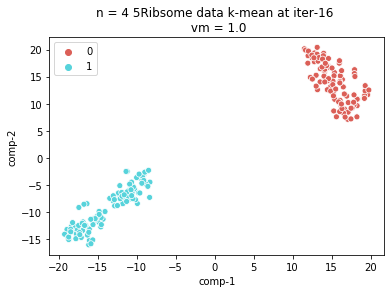

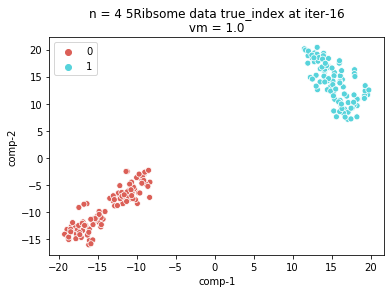

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


6.282224655151367 sec
0 batch 17 iteration
generated


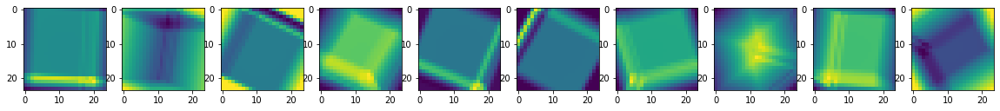

real


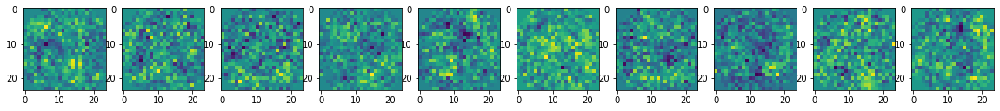

6.365885019302368 sec
0 batch 18 iteration
generated


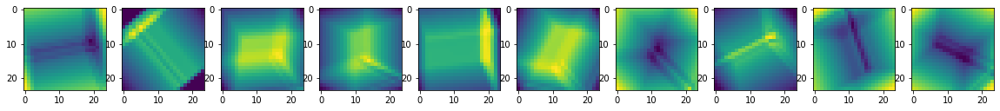

real


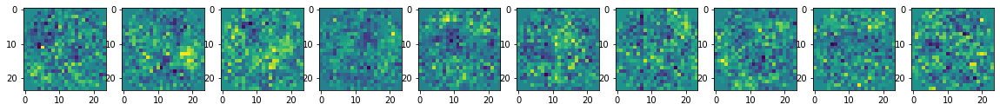

5.663916110992432 sec
0 batch 19 iteration
generated


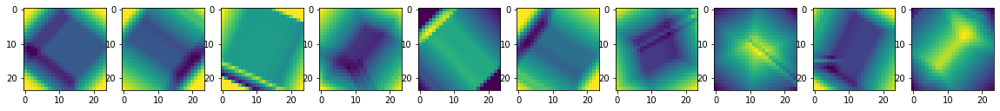

real


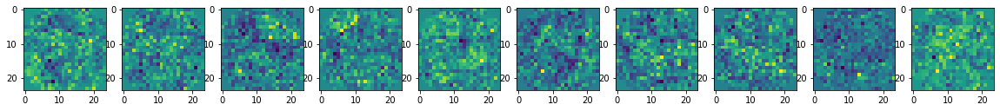

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.045738
[t-SNE] KL divergence after 250 iterations with early exaggeration: 53.388264
[t-SNE] KL divergence after 1000 iterations: 0.196582
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


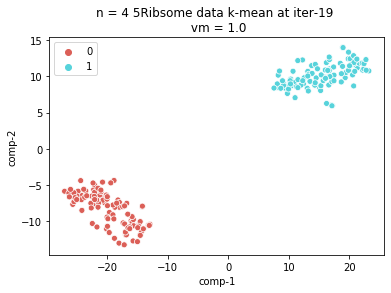

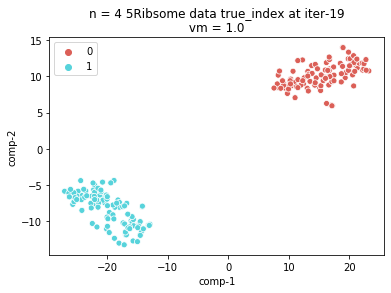

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


6.0595667362213135 sec
0 batch 20 iteration
generated


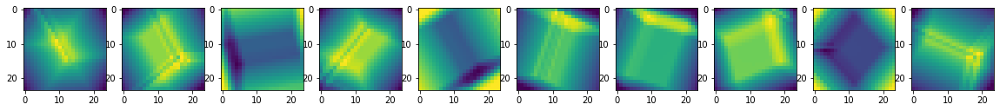

real


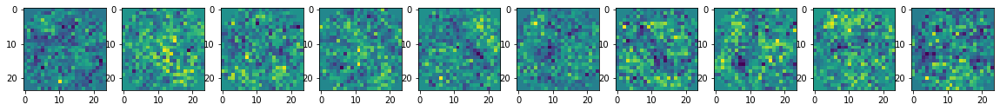

the 0 th iter, ratio = 0.001
output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.006s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.045343
[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.861237
[t-SNE] KL divergence after 1000 iterations: 0.197465
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


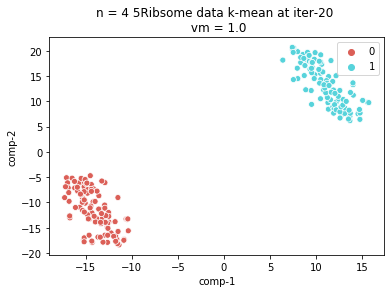

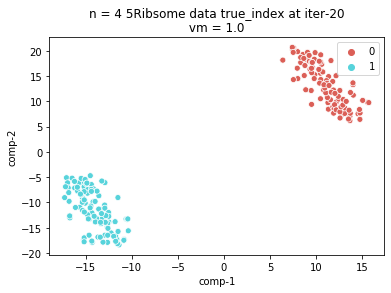

output_collection 0-th batch


/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


output_collection 1-th batch
output_collection 2-th batch
output_collection 3-th batch
output_collection 4-th batch
output_collection 5-th batch
output_collection 6-th batch
output_collection 7-th batch
output_collection 8-th batch
output_collection 9-th batch
output_collection 10-th batch
output_collection 11-th batch
output_collection 12-th batch
output_collection 13-th batch
output_collection 14-th batch
output_collection 15-th batch
output_collection 16-th batch
output_collection 17-th batch
output_collection 18-th batch
output_collection 19-th batch
output_collection 20-th batch
output_collection 21-th batch
output_collection 22-th batch
output_collection 23-th batch
output_collection 24-th batch
output_collection 25-th batch
output_collection 26-th batch
output_collection 27-th batch
output_collection 28-th batch
output_collection 29-th batch
output_collection 30-th batch
output_collection 31-th batch
output_collection 32-th batch
output_collection 33-th batch
output_collection 3

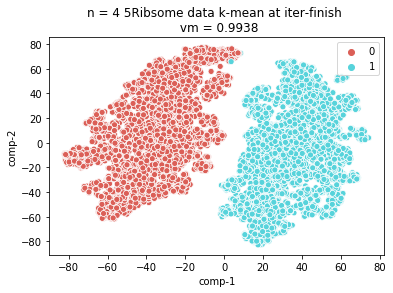

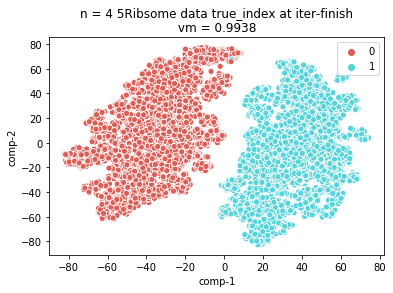

In [7]:
#snr_list = [10, 5, 1, 0.8, 0.6, 0.4, 0.2, 0.1]
snr = 0.8
data_name = f'70s_2class_0304+{snr}'
with open(f'./data/{data_name}/images.pkl', 'rb') as f:
    new_projection = pickle.load( f)

with open(f'./data/{data_name}/angles.pkl', 'rb') as f:
    angles2 = pickle.load( f)

with open(f'./data/{data_name}/orientation_matrix.pkl', 'rb') as f:
    Orientation_Vectors = pickle.load(f)

with open(f'./data/{data_name}/indexs.pkl', 'rb') as f:
    indexs = pickle.load(f)
print('indexs',indexs[:10])     
with open(f'./data/{data_name}/mean_subtracted_strcut.pkl', 'rb') as f:
    mean_subtracted_strcut = pickle.load(f)
    
new_projection = new_projection * mask
print(new_projection.shape)
new_projection = new_projection[:,5:29,5:29]
plt.imshow(new_projection[0])
plt.show()
print(angles2)
n = 8
b = 200
niter = 20
pca_n = 2
Images = new_projection#[:5000]
print(Images.shape)
exp_name = f'20220320_{data_name}_EM_2SDR_n_{n}'
ProjSize, num_image, n_component , num_iter = 24, Images.shape[0], n, niter
batch_size = b
Vol_geom = astra.create_vol_geom(ProjSize, ProjSize, ProjSize)
#Images = torch.ones(num_image, 48, 48) # fake images for computing purpose

vg = ts.from_astra(Vol_geom)
pg = ts.from_astra(Proj_geom)
op = ts.operator(vg, pg)
MP3 = EM_2SDR(ProjSize, num_image, n_component, op , Images,Orientation_Vectors, exp_name,mean_subtracted_strcut, indexs, batch_size, niter, PCA_n= pca_n)
#MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)
MP3.fit(0.01, True)
MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)

indexs [1 0 0 1 0 1 1 1 0 0]
(10000, 34, 34)


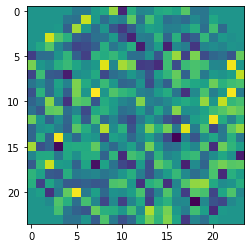

(10000, 24, 24)
output_collection 0-th batch
output_collection 1-th batch
output_collection 2-th batch
output_collection 3-th batch
output_collection 4-th batch
output_collection 5-th batch
output_collection 6-th batch
output_collection 7-th batch
output_collection 8-th batch
output_collection 9-th batch
output_collection 10-th batch
output_collection 11-th batch
output_collection 12-th batch
output_collection 13-th batch
output_collection 14-th batch
output_collection 15-th batch
output_collection 16-th batch
output_collection 17-th batch
output_collection 18-th batch
output_collection 19-th batch
output_collection 20-th batch
output_collection 21-th batch
output_collection 22-th batch
output_collection 23-th batch
output_collection 24-th batch
output_collection 25-th batch
output_collection 26-th batch
output_collection 27-th batch
output_collection 28-th batch
output_collection 29-th batch
output_collection 30-th batch
output_collection 31-th batch
output_collection 32-th batch
outp

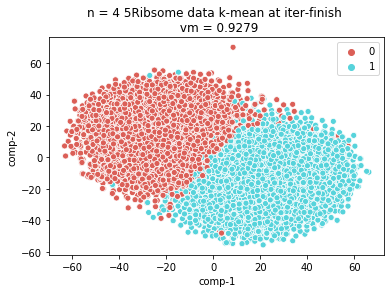

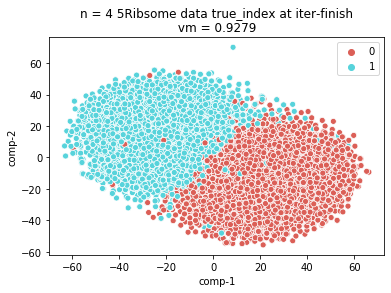

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.783432483673096 sec
0 batch 1 iteration
generated


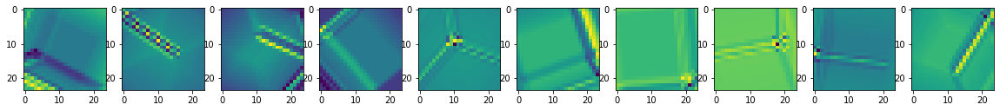

real


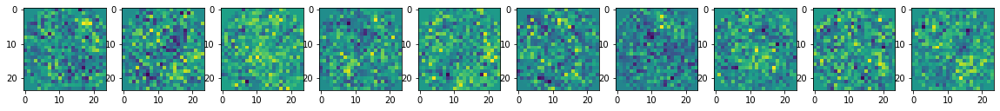

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.004s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.037208
[t-SNE] KL divergence after 250 iterations with early exaggeration: 50.793526
[t-SNE] KL divergence after 950 iterations: 0.165504
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


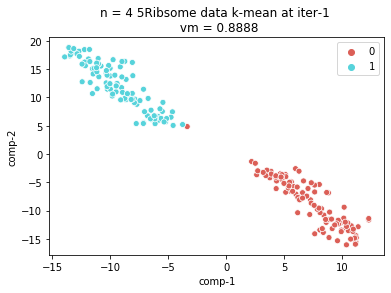

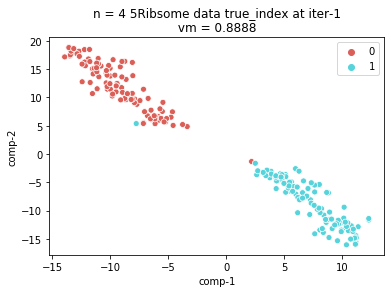

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.285275459289551 sec
0 batch 2 iteration
generated


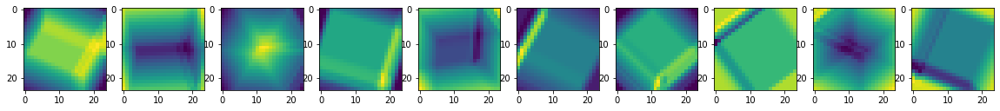

real


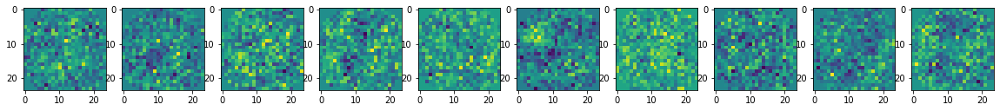

6.013092041015625 sec
0 batch 3 iteration
generated


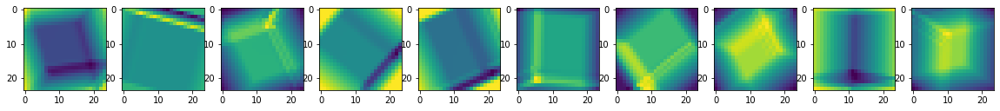

real


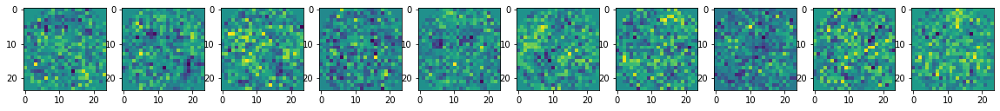

5.693310022354126 sec
0 batch 4 iteration
generated


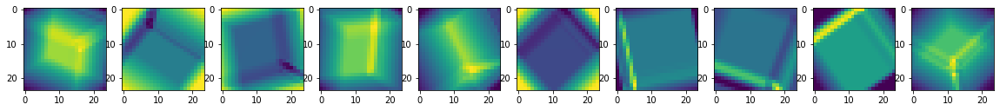

real


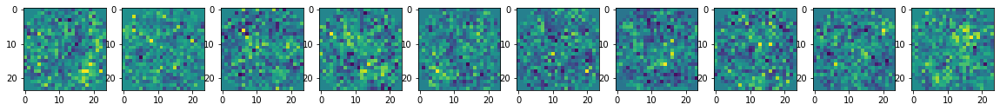

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.008s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.033687
[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.581329
[t-SNE] KL divergence after 1000 iterations: 0.168647
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


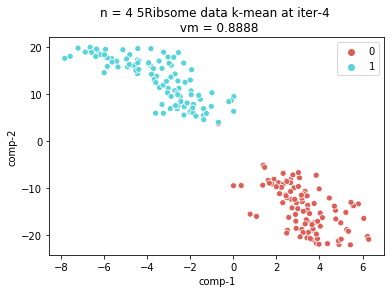

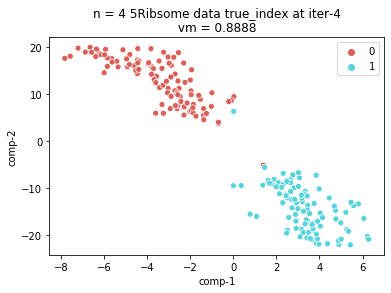

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.530891180038452 sec
0 batch 5 iteration
generated


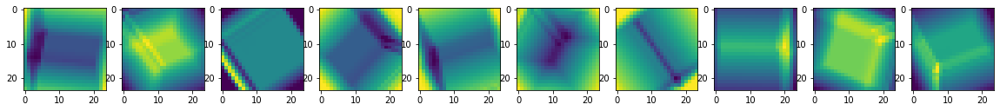

real


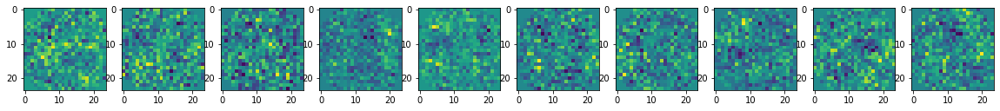

6.068364143371582 sec
0 batch 6 iteration
generated


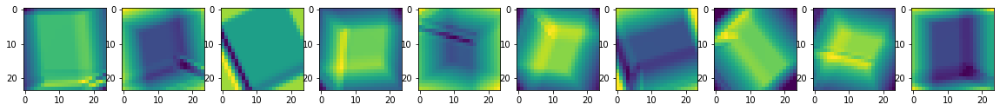

real


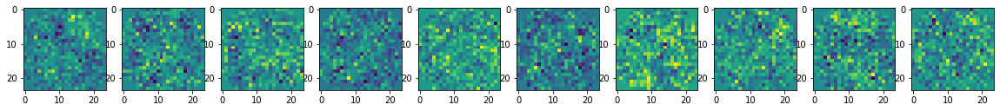

6.3528101444244385 sec
0 batch 7 iteration
generated


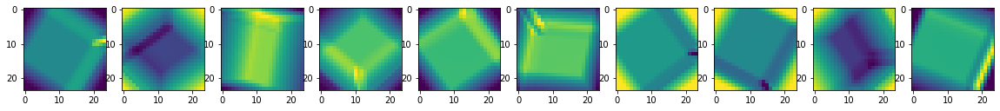

real


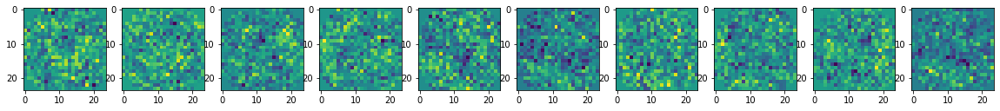

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.007s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.034126
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.587688
[t-SNE] KL divergence after 1000 iterations: 0.175963
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


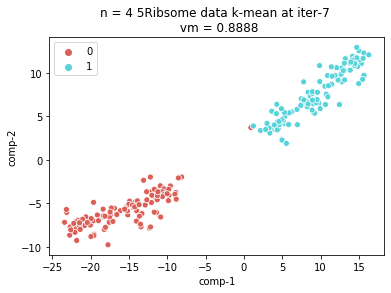

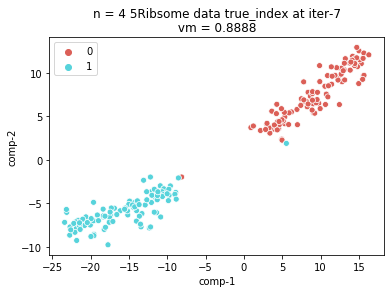

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.736293792724609 sec
0 batch 8 iteration
generated


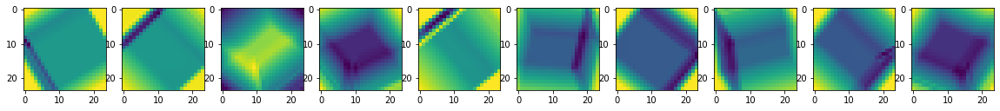

real


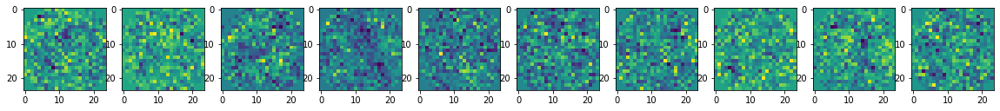

5.585594654083252 sec
0 batch 9 iteration
generated


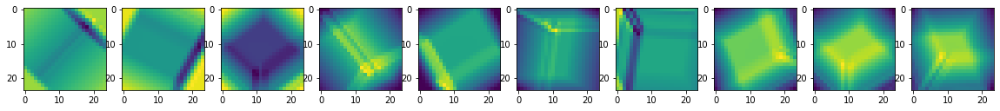

real


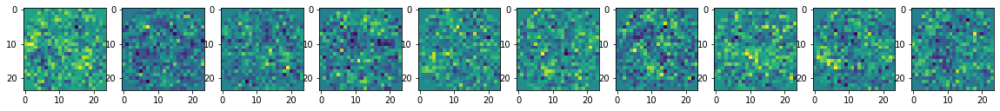

6.024746417999268 sec
0 batch 10 iteration
generated


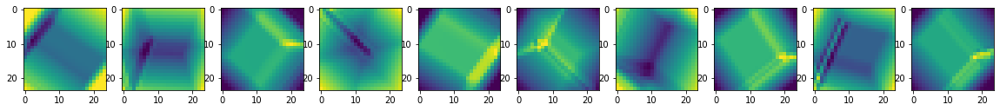

real


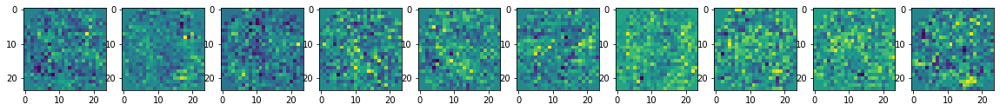

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.004s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.032176
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.511223
[t-SNE] KL divergence after 1000 iterations: 0.202428
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


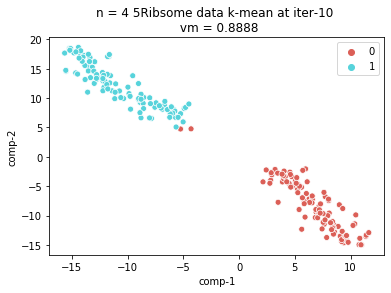

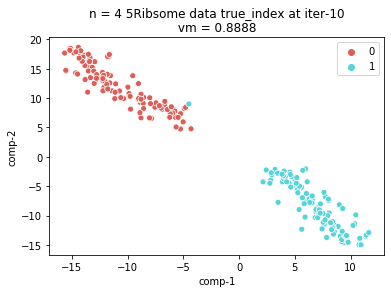

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.350660562515259 sec
0 batch 11 iteration
generated


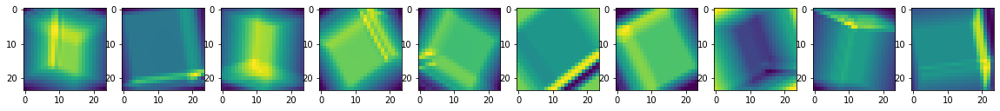

real


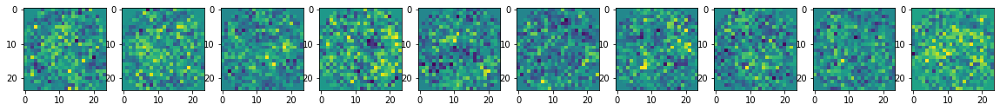

5.708231449127197 sec
0 batch 12 iteration
generated


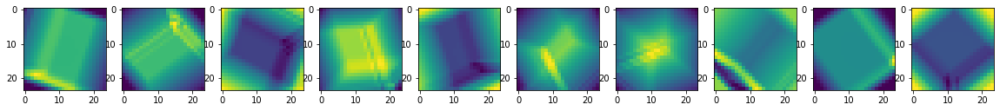

real


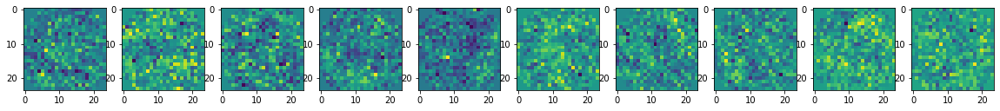

5.859982967376709 sec
0 batch 13 iteration
generated


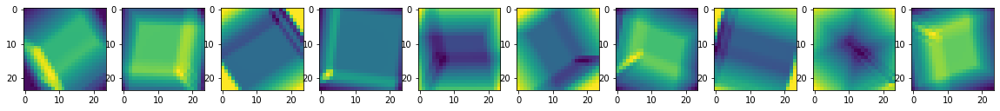

real


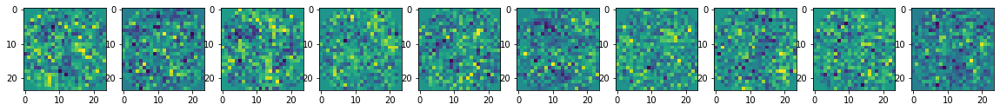

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.008s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.031887
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.261967
[t-SNE] KL divergence after 1000 iterations: 0.193107
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


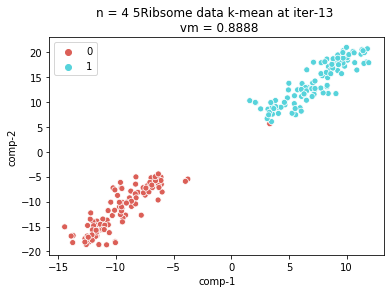

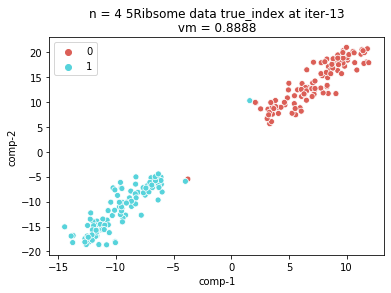

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.4479660987854 sec
0 batch 14 iteration
generated


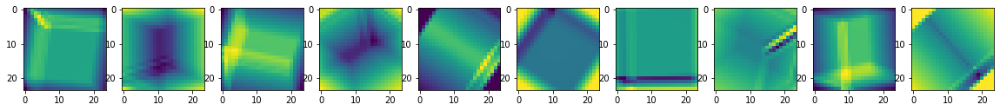

real


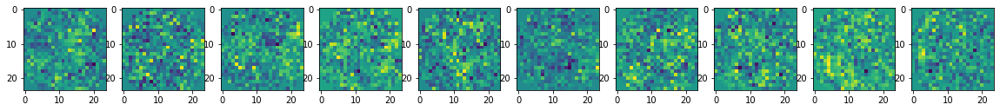

5.964674234390259 sec
0 batch 15 iteration
generated


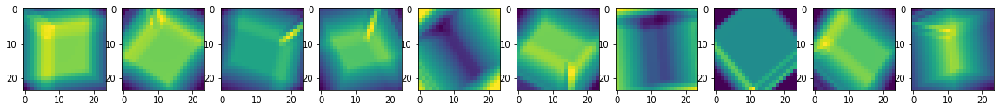

real


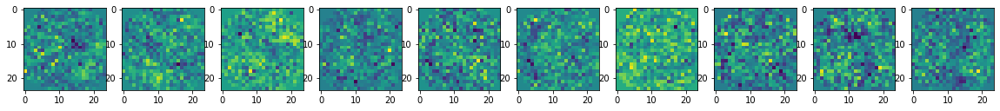

5.455899715423584 sec
0 batch 16 iteration
generated


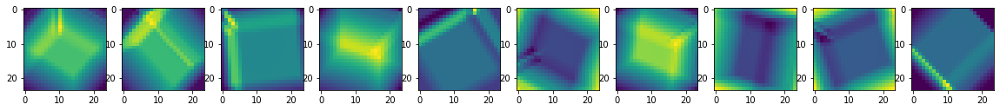

real


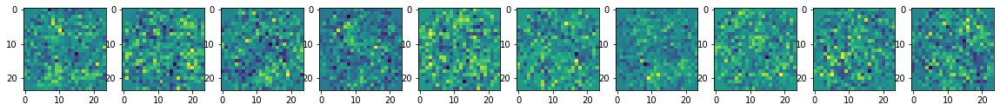

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.003s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.030053
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.574642
[t-SNE] KL divergence after 1000 iterations: 0.197600
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


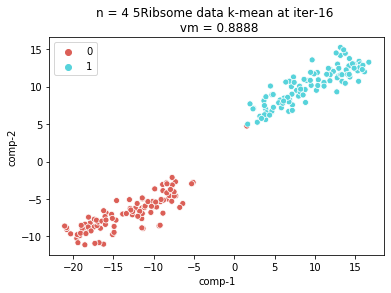

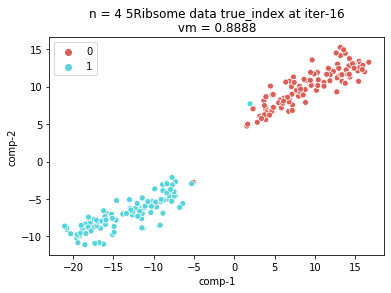

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.705226182937622 sec
0 batch 17 iteration
generated


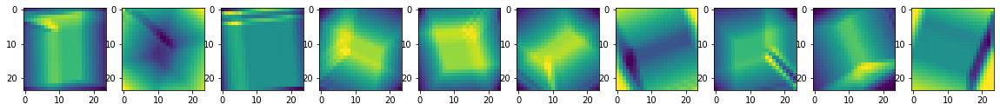

real


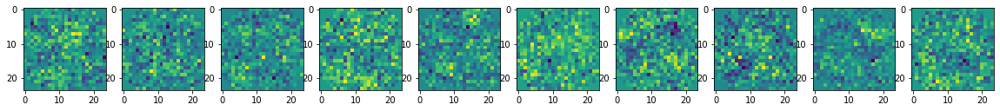

5.6431050300598145 sec
0 batch 18 iteration
generated


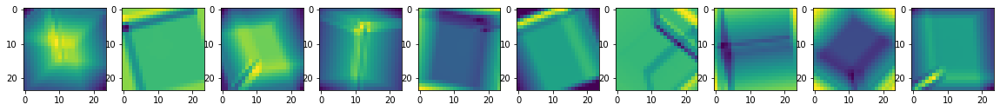

real


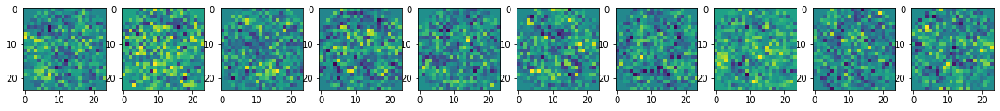

5.708903551101685 sec
0 batch 19 iteration
generated


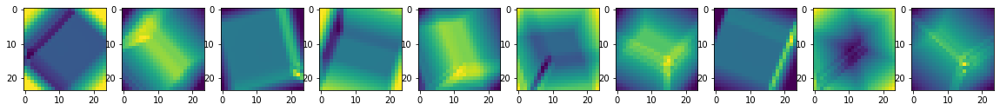

real


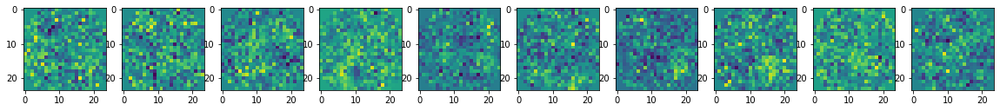

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.003s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.029705
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.115925
[t-SNE] KL divergence after 1000 iterations: 0.196562
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


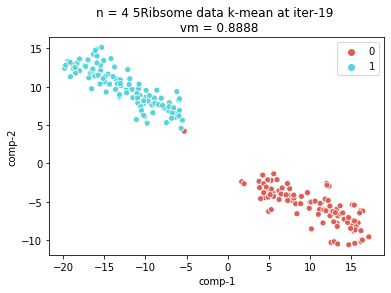

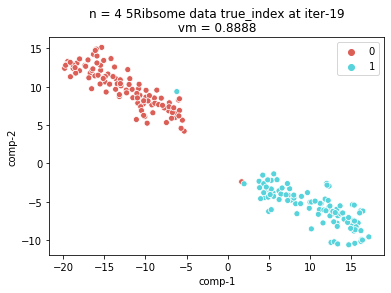

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.646260738372803 sec
0 batch 20 iteration
generated


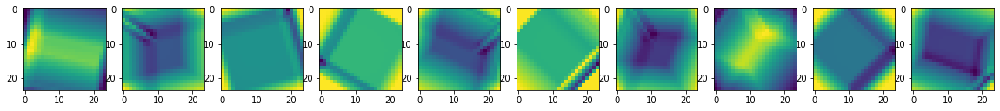

real


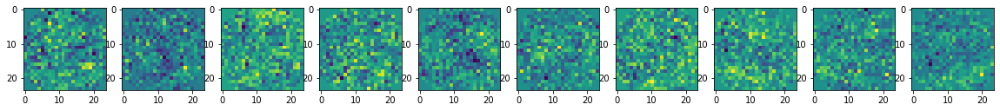

the 0 th iter, ratio = 0.001
output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.004s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.029591
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.074619
[t-SNE] KL divergence after 1000 iterations: 0.209983
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


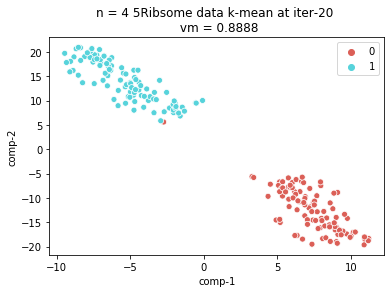

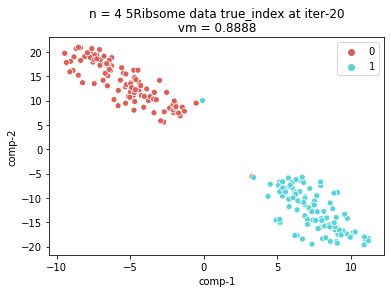

output_collection 0-th batch


/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


output_collection 1-th batch
output_collection 2-th batch
output_collection 3-th batch
output_collection 4-th batch
output_collection 5-th batch
output_collection 6-th batch
output_collection 7-th batch
output_collection 8-th batch
output_collection 9-th batch
output_collection 10-th batch
output_collection 11-th batch
output_collection 12-th batch
output_collection 13-th batch
output_collection 14-th batch
output_collection 15-th batch
output_collection 16-th batch
output_collection 17-th batch
output_collection 18-th batch
output_collection 19-th batch
output_collection 20-th batch
output_collection 21-th batch
output_collection 22-th batch
output_collection 23-th batch
output_collection 24-th batch
output_collection 25-th batch
output_collection 26-th batch
output_collection 27-th batch
output_collection 28-th batch
output_collection 29-th batch
output_collection 30-th batch
output_collection 31-th batch
output_collection 32-th batch
output_collection 33-th batch
output_collection 3

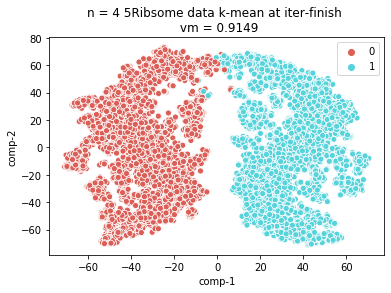

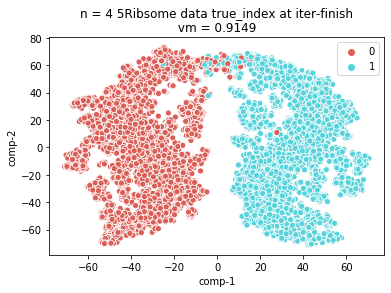

In [10]:
#snr_list = [10, 5, 1, 0.8, 0.6, 0.4, 0.2, 0.1]
snr = 0.4
data_name = f'70s_2class_0304+{snr}'
with open(f'./data/{data_name}/images.pkl', 'rb') as f:
    new_projection = pickle.load( f)

with open(f'./data/{data_name}/angles.pkl', 'rb') as f:
    angles2 = pickle.load( f)

with open(f'./data/{data_name}/orientation_matrix.pkl', 'rb') as f:
    Orientation_Vectors = pickle.load(f)

with open(f'./data/{data_name}/indexs.pkl', 'rb') as f:
    indexs = pickle.load(f)
print('indexs',indexs[:10])     
with open(f'./data/{data_name}/mean_subtracted_strcut.pkl', 'rb') as f:
    mean_subtracted_strcut = pickle.load(f)
    
new_projection = new_projection * mask
print(new_projection.shape)
new_projection = new_projection[:,5:29,5:29]
plt.imshow(new_projection[0])
plt.show()
n = 4
b = 200
niter = 20
pca_n = 2
Images = new_projection#[:5000]
print(Images.shape)
exp_name = f'20220320_{data_name}_EM_2SDR_n_{n}'
ProjSize, num_image, n_component , num_iter = 24, Images.shape[0], n, niter
batch_size = b
Vol_geom = astra.create_vol_geom(ProjSize, ProjSize, ProjSize)
#Images = torch.ones(num_image, 48, 48) # fake images for computing purpose

vg = ts.from_astra(Vol_geom)
pg = ts.from_astra(Proj_geom)
op = ts.operator(vg, pg)
MP3 = EM_2SDR(ProjSize, num_image, n_component, op , Images,Orientation_Vectors, exp_name,mean_subtracted_strcut, indexs, batch_size, niter, PCA_n= pca_n)
MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)
MP3.fit(0.001, True)
MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)

indexs [1 0 0 1 0 1 1 1 0 0]
(10000, 34, 34)


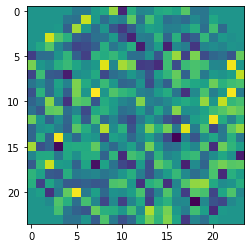

(10000, 24, 24)


/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.946393966674805 sec
0 batch 1 iteration
generated


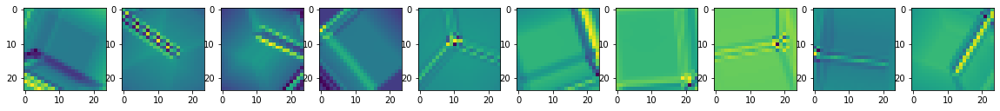

real


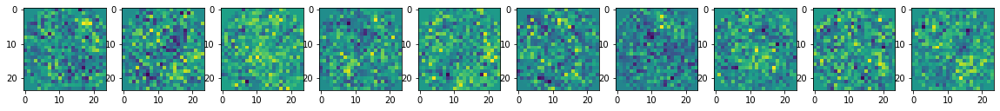

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.004s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.037351
[t-SNE] KL divergence after 250 iterations with early exaggeration: 50.894352
[t-SNE] KL divergence after 900 iterations: 0.163209
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


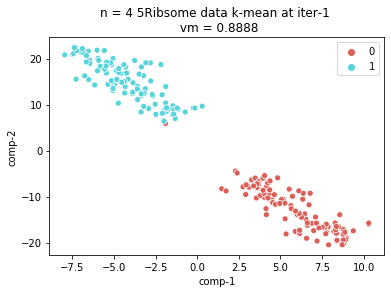

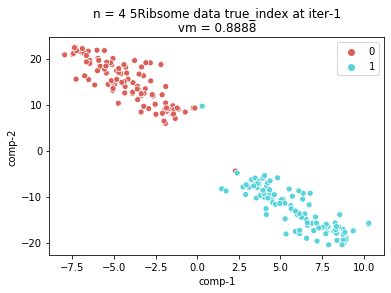

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.309557199478149 sec
0 batch 2 iteration
generated


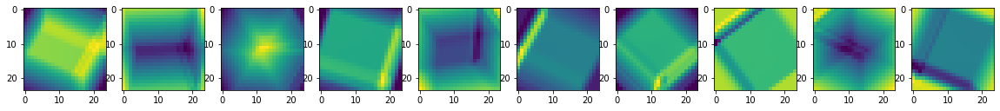

real


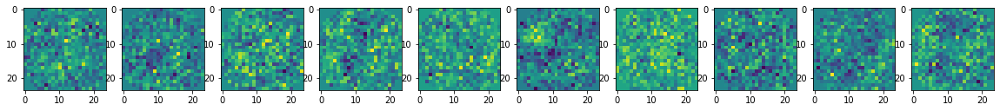

5.377050876617432 sec
0 batch 3 iteration
generated


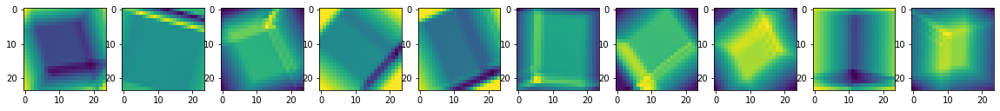

real


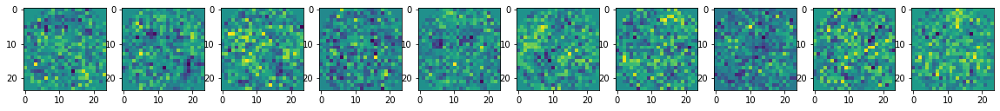

5.667694568634033 sec
0 batch 4 iteration
generated


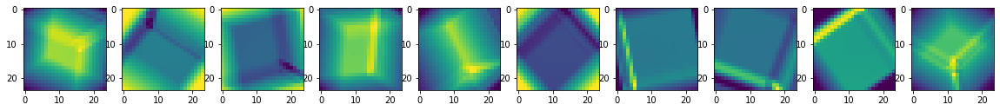

real


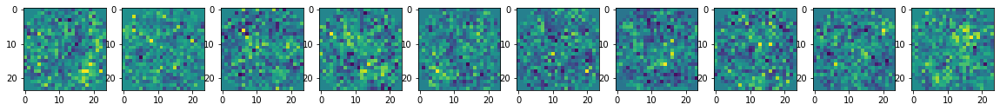

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.004s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.033608
[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.408066
[t-SNE] KL divergence after 1000 iterations: 0.174707
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


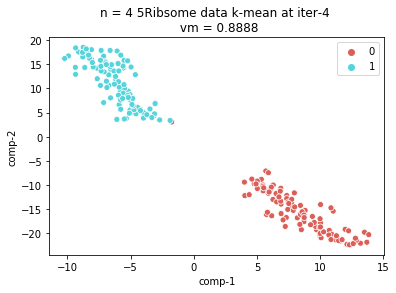

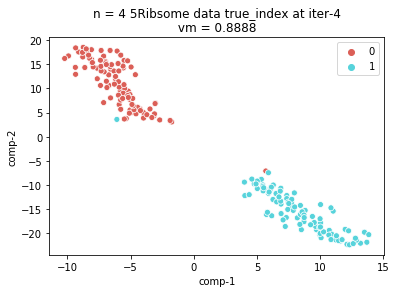

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.528147459030151 sec
0 batch 5 iteration
generated


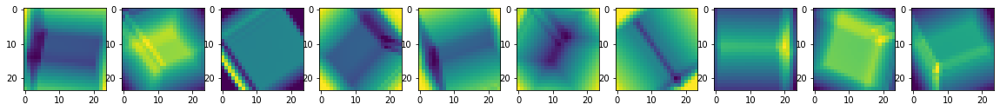

real


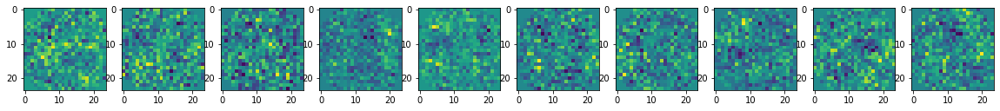

5.9789910316467285 sec
0 batch 6 iteration
generated


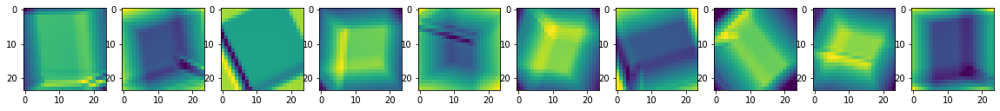

real


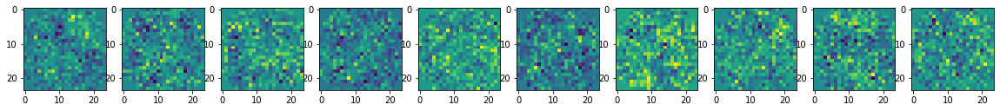

6.152938365936279 sec
0 batch 7 iteration
generated


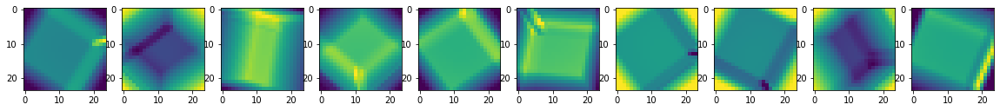

real


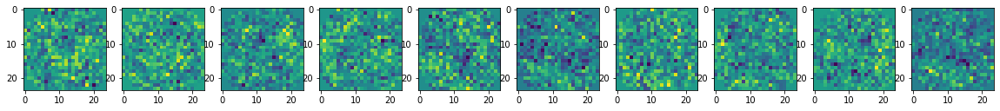

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.004s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.033771
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.485378
[t-SNE] KL divergence after 1000 iterations: 0.164853
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


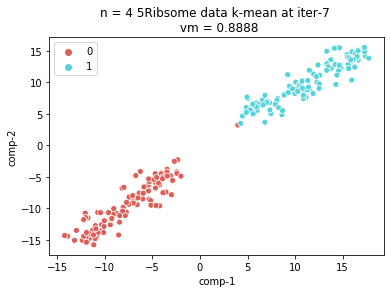

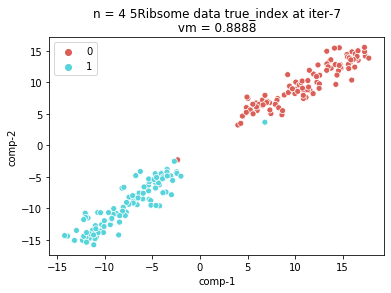

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.801494598388672 sec
0 batch 8 iteration
generated


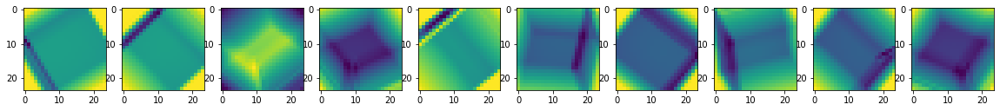

real


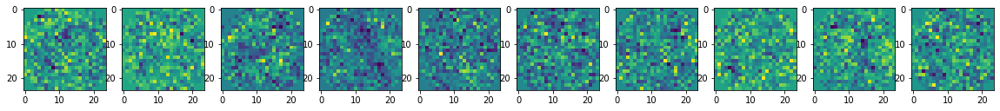

5.98682427406311 sec
0 batch 9 iteration
generated


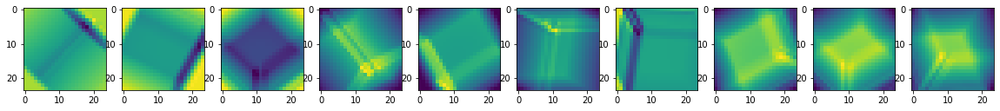

real


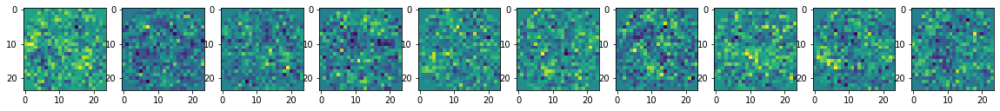

6.183687210083008 sec
0 batch 10 iteration
generated


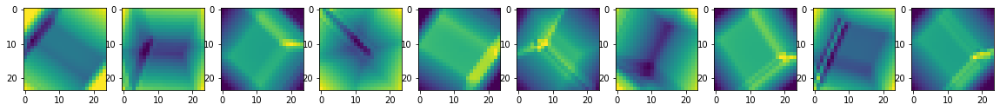

real


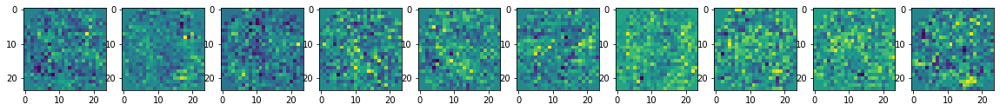

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.007s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.031697
[t-SNE] KL divergence after 250 iterations with early exaggeration: 53.981468
[t-SNE] KL divergence after 1000 iterations: 0.178087
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


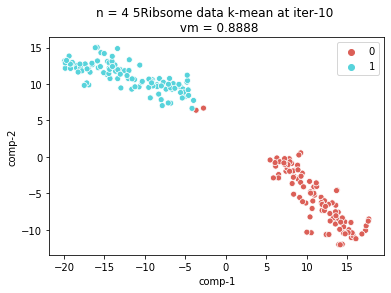

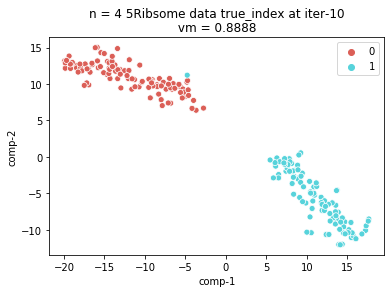

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.979617118835449 sec
0 batch 11 iteration
generated


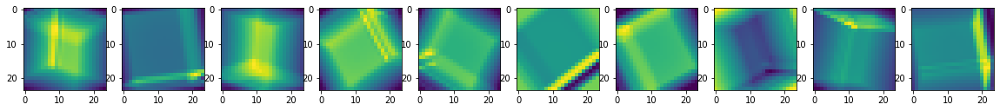

real


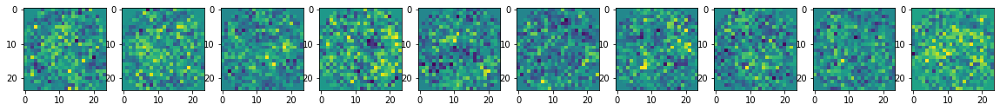

6.229335069656372 sec
0 batch 12 iteration
generated


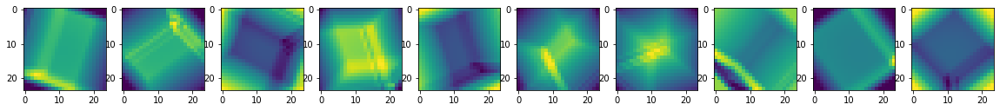

real


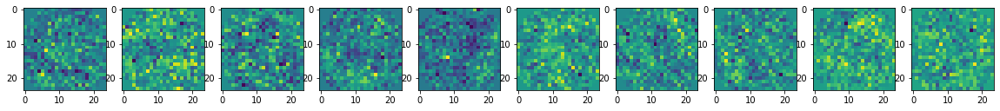

6.027001857757568 sec
0 batch 13 iteration
generated


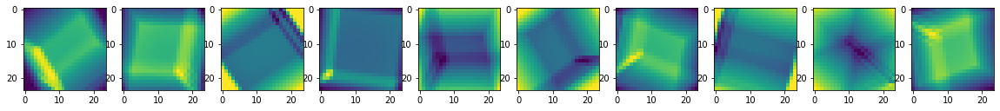

real


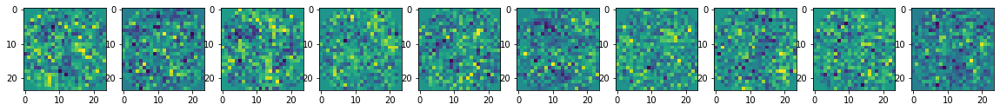

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.031146
[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.272625
[t-SNE] KL divergence after 800 iterations: 0.179439
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


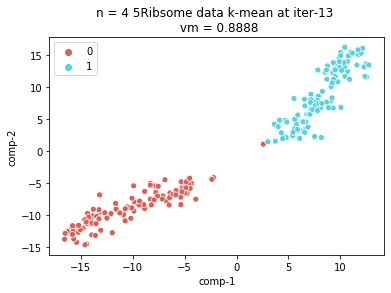

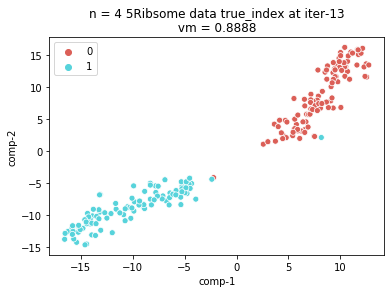

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.638742446899414 sec
0 batch 14 iteration
generated


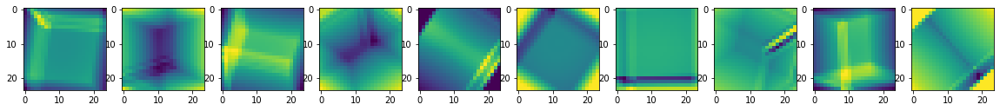

real


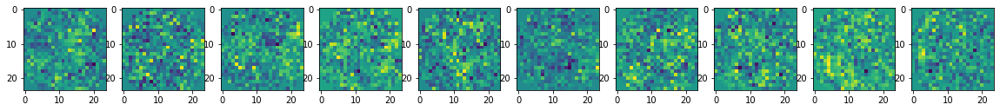

5.691056728363037 sec
0 batch 15 iteration
generated


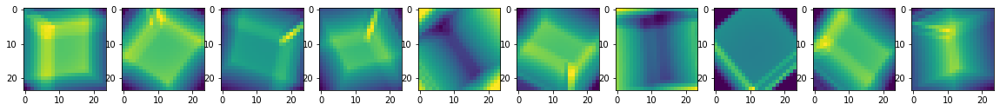

real


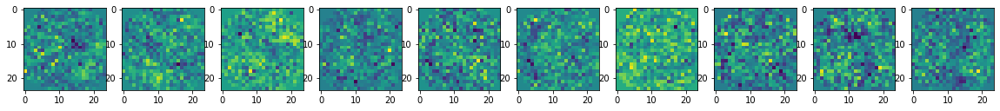

6.011679410934448 sec
0 batch 16 iteration
generated


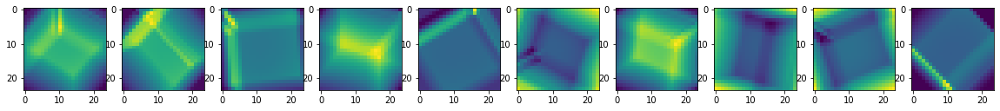

real


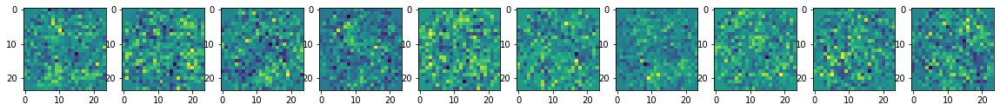

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.029254
[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.129360
[t-SNE] KL divergence after 1000 iterations: 0.194710
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


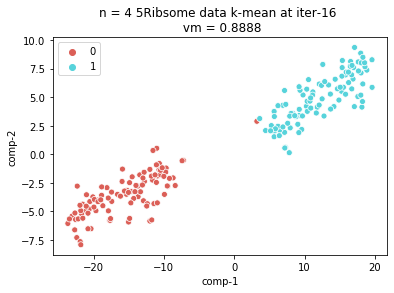

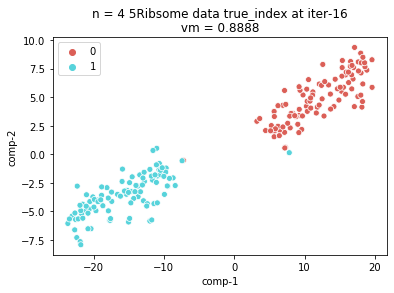

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.562023162841797 sec
0 batch 17 iteration
generated


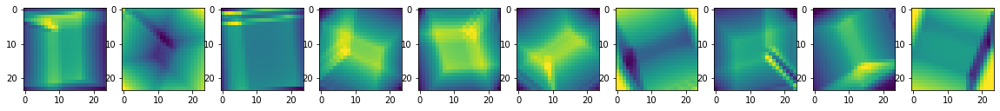

real


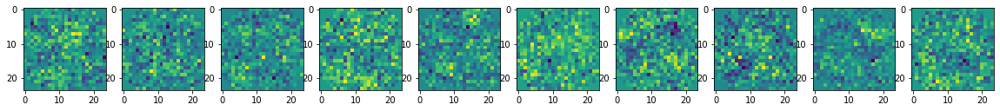

5.726570129394531 sec
0 batch 18 iteration
generated


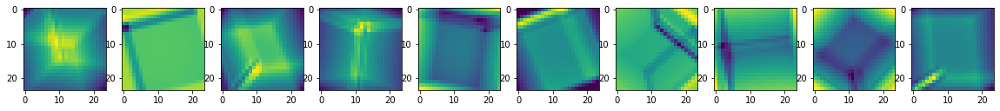

real


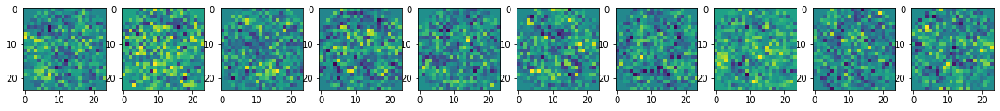

6.271325588226318 sec
0 batch 19 iteration
generated


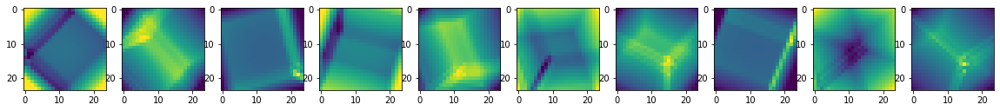

real


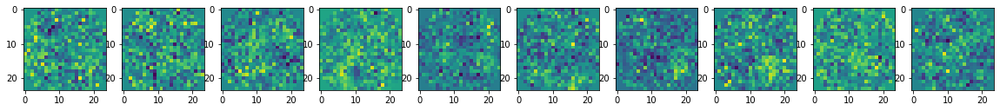

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.028680
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.184517
[t-SNE] KL divergence after 1000 iterations: 0.201164
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


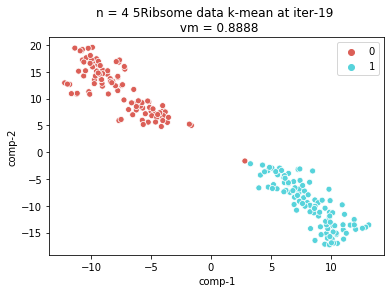

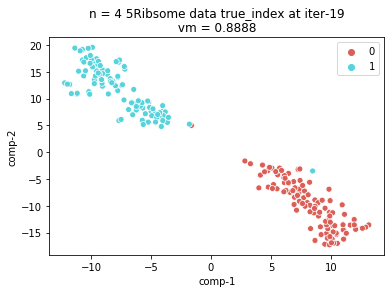

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.6812543869018555 sec
0 batch 20 iteration
generated


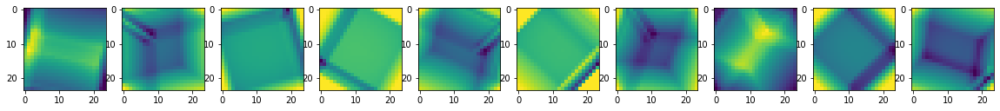

real


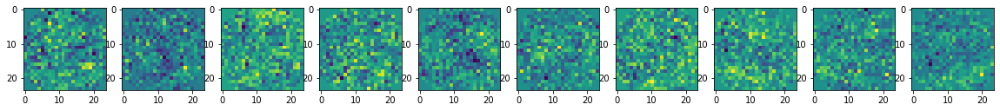

the 0 th iter, ratio = 0.01
output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.004s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.028427
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.959572
[t-SNE] KL divergence after 1000 iterations: 0.207445
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


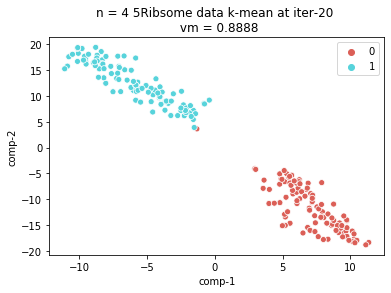

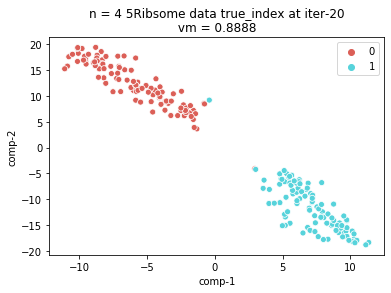

output_collection 0-th batch


/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


output_collection 1-th batch
output_collection 2-th batch
output_collection 3-th batch
output_collection 4-th batch
output_collection 5-th batch
output_collection 6-th batch
output_collection 7-th batch
output_collection 8-th batch
output_collection 9-th batch
output_collection 10-th batch
output_collection 11-th batch
output_collection 12-th batch
output_collection 13-th batch
output_collection 14-th batch
output_collection 15-th batch
output_collection 16-th batch
output_collection 17-th batch
output_collection 18-th batch
output_collection 19-th batch
output_collection 20-th batch
output_collection 21-th batch
output_collection 22-th batch
output_collection 23-th batch
output_collection 24-th batch
output_collection 25-th batch
output_collection 26-th batch
output_collection 27-th batch
output_collection 28-th batch
output_collection 29-th batch
output_collection 30-th batch
output_collection 31-th batch
output_collection 32-th batch
output_collection 33-th batch
output_collection 3

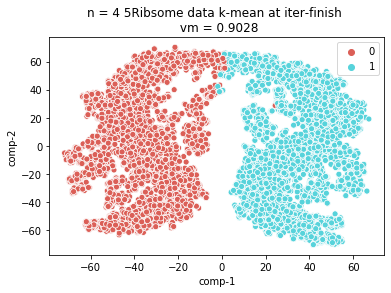

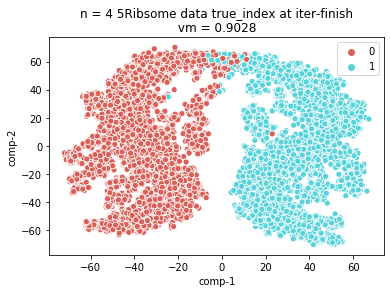

In [11]:
#snr_list = [10, 5, 1, 0.8, 0.6, 0.4, 0.2, 0.1]
snr = 0.4
data_name = f'70s_2class_0304+{snr}'
with open(f'./data/{data_name}/images.pkl', 'rb') as f:
    new_projection = pickle.load( f)

with open(f'./data/{data_name}/angles.pkl', 'rb') as f:
    angles2 = pickle.load( f)

with open(f'./data/{data_name}/orientation_matrix.pkl', 'rb') as f:
    Orientation_Vectors = pickle.load(f)

with open(f'./data/{data_name}/indexs.pkl', 'rb') as f:
    indexs = pickle.load(f)
print('indexs',indexs[:10])     
with open(f'./data/{data_name}/mean_subtracted_strcut.pkl', 'rb') as f:
    mean_subtracted_strcut = pickle.load(f)
    
new_projection = new_projection * mask
print(new_projection.shape)
new_projection = new_projection[:,5:29,5:29]
plt.imshow(new_projection[0])
plt.show()
n = 4
b = 200
niter = 20
pca_n = 2
Images = new_projection#[:5000]
print(Images.shape)
exp_name = f'20220320_{data_name}_EM_2SDR_n_{n}'
ProjSize, num_image, n_component , num_iter = 24, Images.shape[0], n, niter
batch_size = b
Vol_geom = astra.create_vol_geom(ProjSize, ProjSize, ProjSize)
#Images = torch.ones(num_image, 48, 48) # fake images for computing purpose

vg = ts.from_astra(Vol_geom)
pg = ts.from_astra(Proj_geom)
op = ts.operator(vg, pg)
MP3 = EM_2SDR(ProjSize, num_image, n_component, op , Images,Orientation_Vectors, exp_name,mean_subtracted_strcut, indexs, batch_size, niter, PCA_n= pca_n)
#MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)
MP3.fit(0.01, True)
MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)

indexs [1 0 0 1 0 1 1 1 0 0]
(10000, 34, 34)


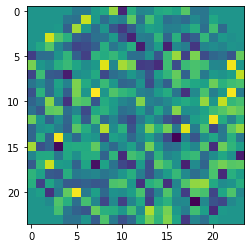

(10000, 24, 24)


/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


142.6048619747162 sec
0 batch 1 iteration
generated


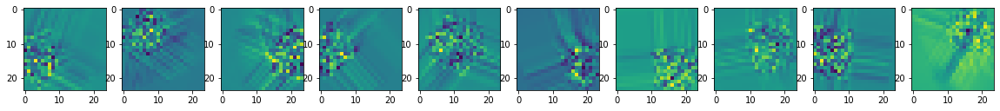

real


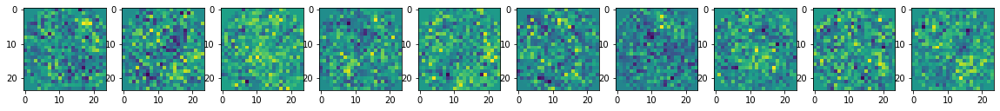

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.010s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.400254
[t-SNE] KL divergence after 250 iterations with early exaggeration: 63.704674
[t-SNE] KL divergence after 1000 iterations: 0.531768
self.All_U_kron_shape torch.Size([13824, 1728])
self.PCs.shape torch.Size([1728, 30])


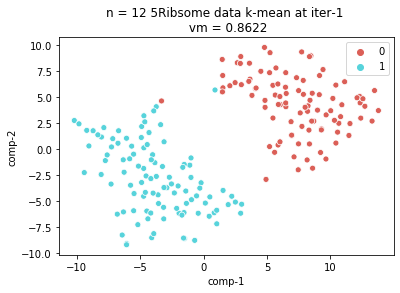

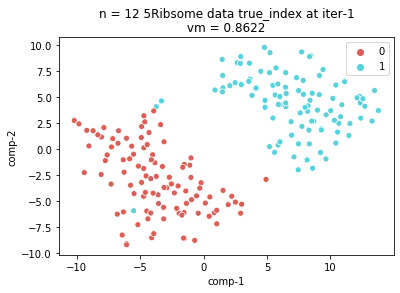

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


143.8544418811798 sec
0 batch 2 iteration
generated


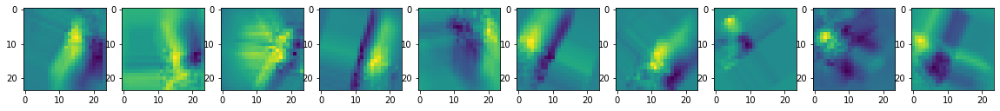

real


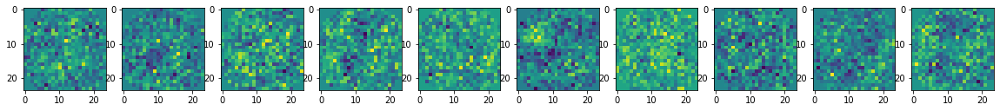

139.89051699638367 sec
0 batch 3 iteration
generated


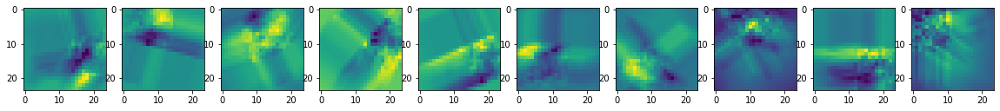

real


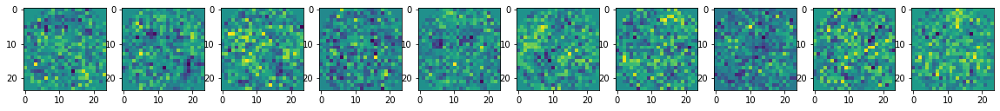

134.59168481826782 sec
0 batch 4 iteration
generated


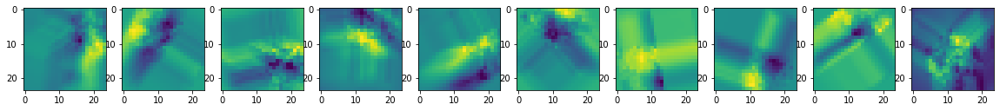

real


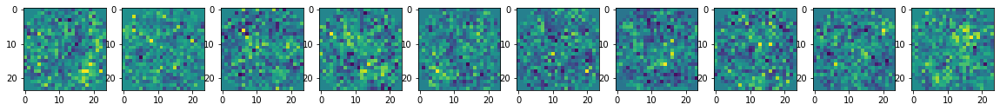

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.150894
[t-SNE] KL divergence after 250 iterations with early exaggeration: 61.957520
[t-SNE] KL divergence after 1000 iterations: 0.566203
self.All_U_kron_shape torch.Size([13824, 1728])
self.PCs.shape torch.Size([1728, 30])


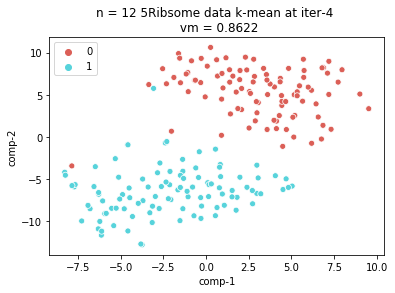

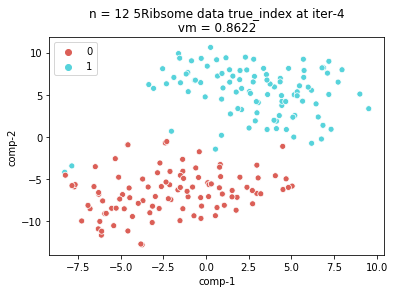

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


141.3515112400055 sec
0 batch 5 iteration
generated


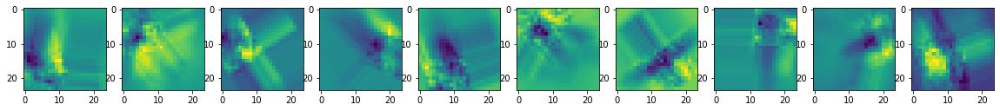

real


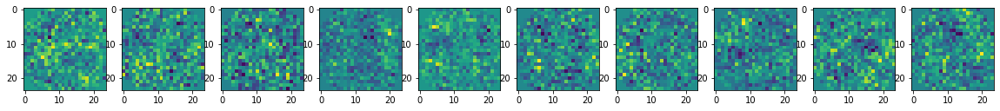

146.39630317687988 sec
0 batch 6 iteration
generated


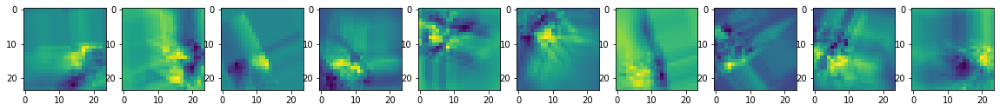

real


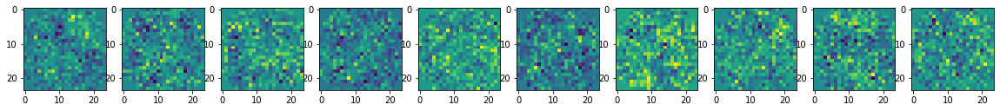

149.87225532531738 sec
0 batch 7 iteration
generated


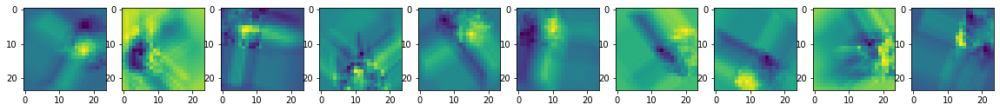

real


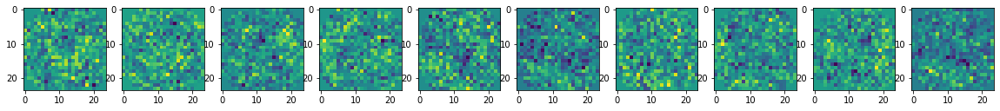

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.007s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.146838
[t-SNE] KL divergence after 250 iterations with early exaggeration: 61.973118
[t-SNE] KL divergence after 900 iterations: 0.555581
self.All_U_kron_shape torch.Size([13824, 1728])
self.PCs.shape torch.Size([1728, 30])


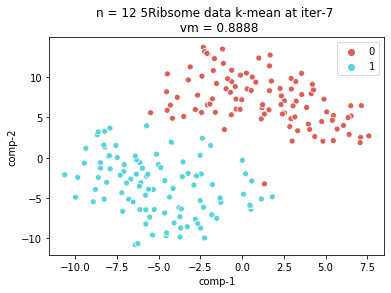

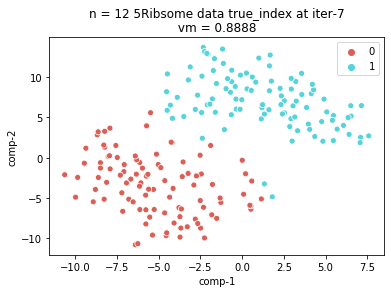

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


146.438086271286 sec
0 batch 8 iteration
generated


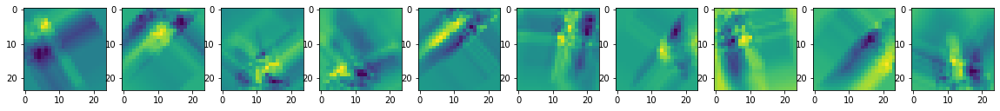

real


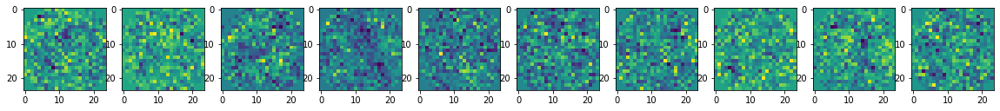

144.79613733291626 sec
0 batch 9 iteration
generated


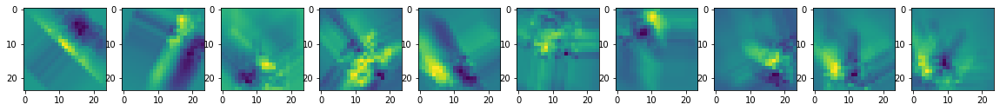

real


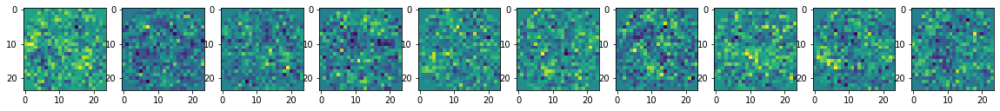

159.81558918952942 sec
0 batch 10 iteration
generated


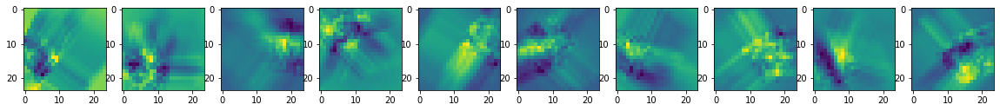

real


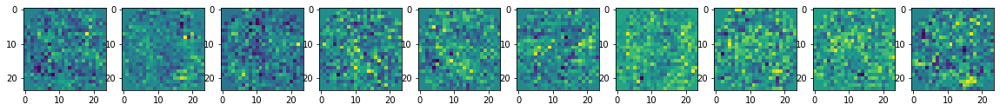

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.009s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.145275
[t-SNE] KL divergence after 250 iterations with early exaggeration: 61.502728
[t-SNE] KL divergence after 1000 iterations: 0.558013
self.All_U_kron_shape torch.Size([13824, 1728])
self.PCs.shape torch.Size([1728, 30])


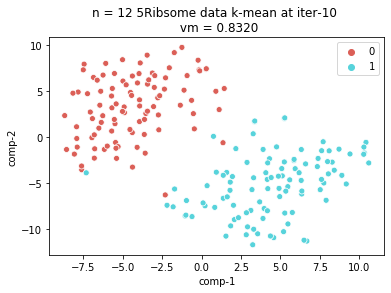

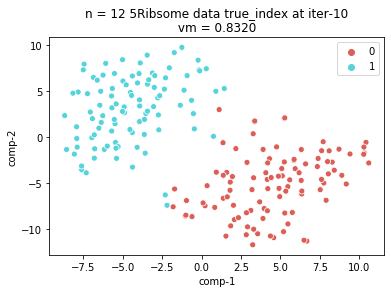

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


139.9758791923523 sec
0 batch 11 iteration
generated


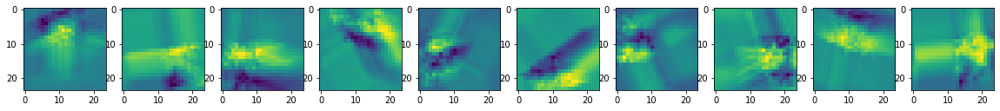

real


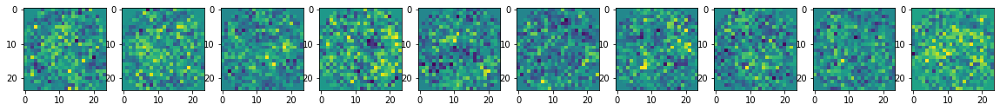

155.06138634681702 sec
0 batch 12 iteration
generated


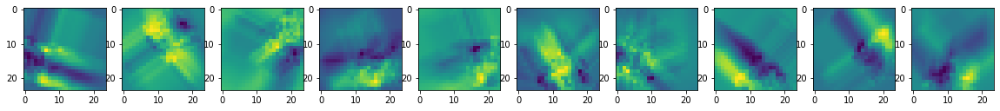

real


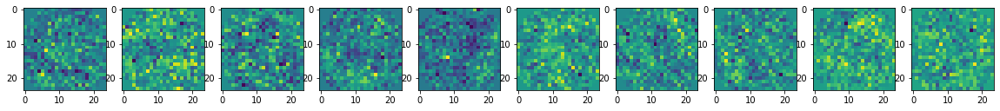

139.16042041778564 sec
0 batch 13 iteration
generated


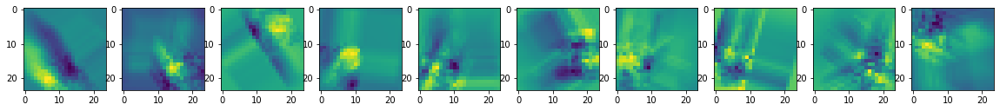

real


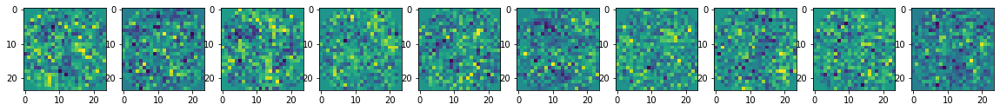

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.009s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.139501
[t-SNE] KL divergence after 250 iterations with early exaggeration: 66.461838
[t-SNE] KL divergence after 1000 iterations: 0.606169
self.All_U_kron_shape torch.Size([13824, 1728])
self.PCs.shape torch.Size([1728, 30])


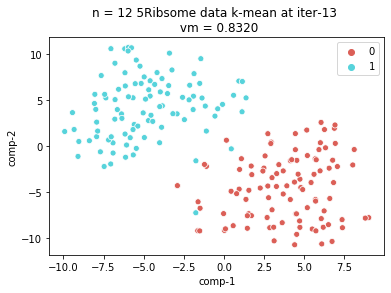

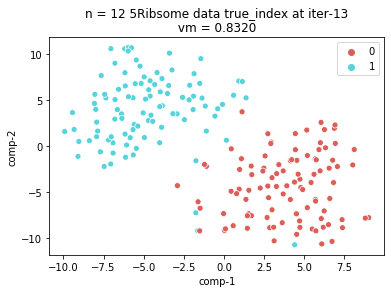

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


140.00558519363403 sec
0 batch 14 iteration
generated


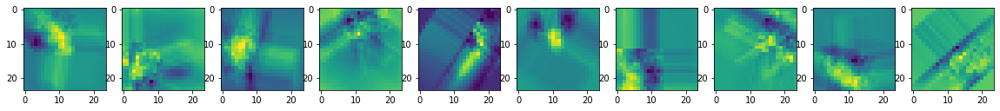

real


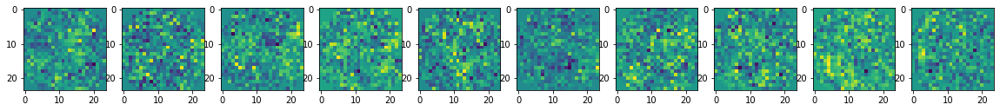

139.20348620414734 sec
0 batch 15 iteration
generated


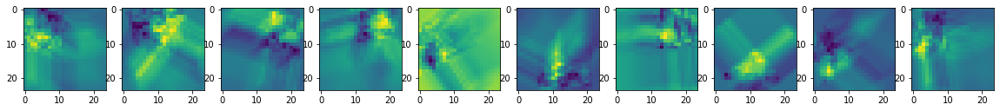

real


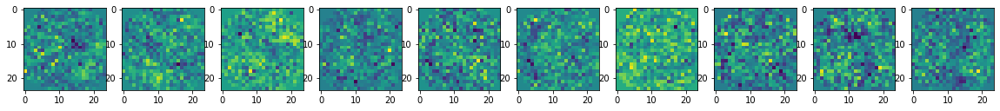

144.47612690925598 sec
0 batch 16 iteration
generated


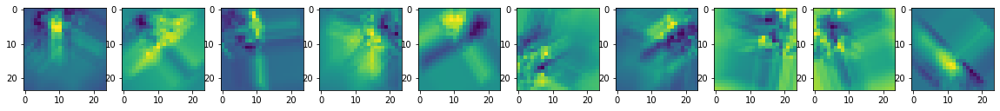

real


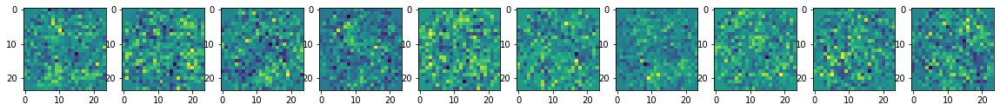

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.009s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.134120
[t-SNE] KL divergence after 250 iterations with early exaggeration: 64.689011
[t-SNE] KL divergence after 1000 iterations: 0.583298
self.All_U_kron_shape torch.Size([13824, 1728])
self.PCs.shape torch.Size([1728, 30])


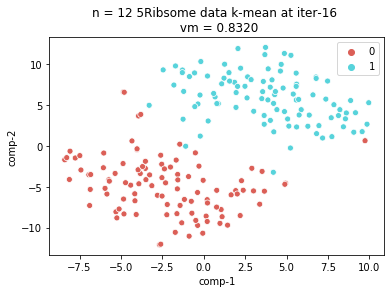

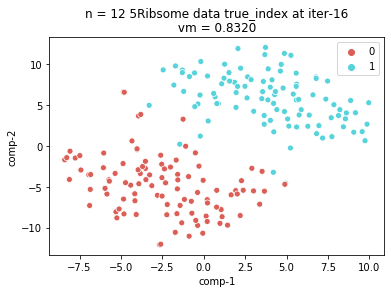

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


147.56879210472107 sec
0 batch 17 iteration
generated


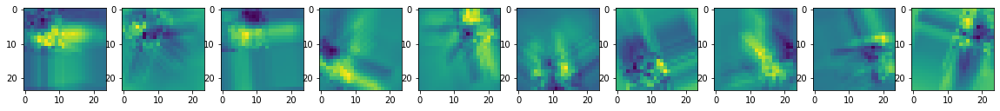

real


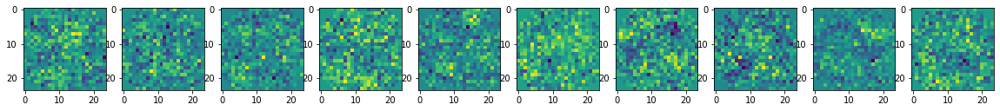

141.18442678451538 sec
0 batch 18 iteration
generated


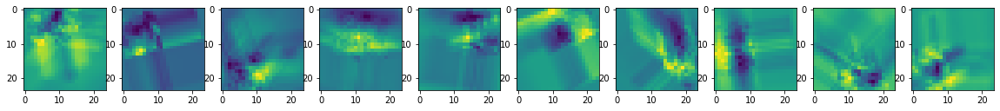

real


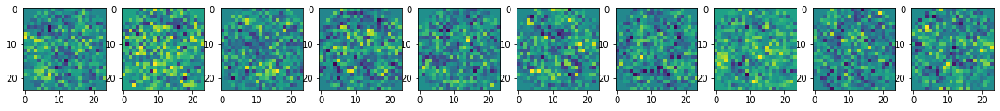

146.0205373764038 sec
0 batch 19 iteration
generated


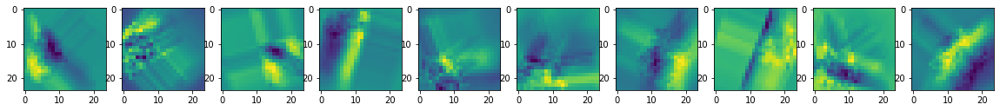

real


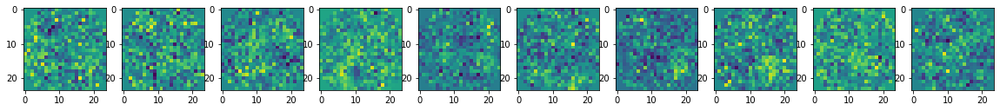

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.013s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.132665
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.561138
[t-SNE] KL divergence after 950 iterations: 0.675815
self.All_U_kron_shape torch.Size([13824, 1728])
self.PCs.shape torch.Size([1728, 30])


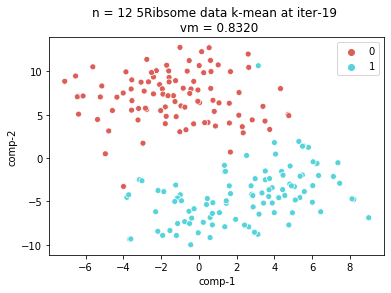

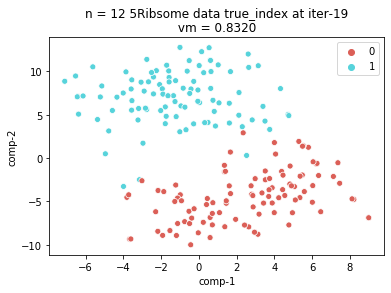

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


142.7485408782959 sec
0 batch 20 iteration
generated


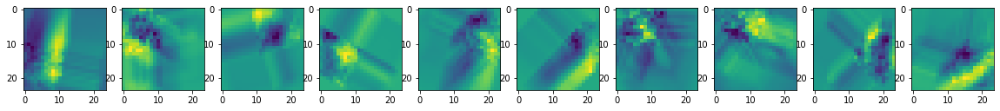

real


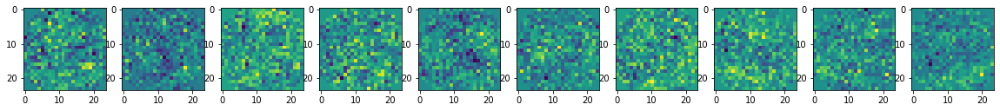

the 0 th iter, ratio = 0.01
output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.131931
[t-SNE] KL divergence after 250 iterations with early exaggeration: 64.388161
[t-SNE] KL divergence after 1000 iterations: 0.601978
self.All_U_kron_shape torch.Size([13824, 1728])
self.PCs.shape torch.Size([1728, 30])


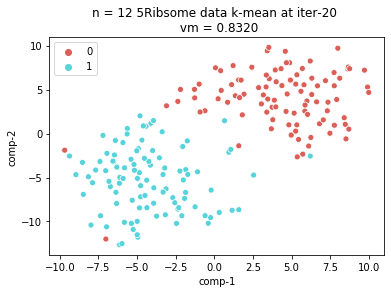

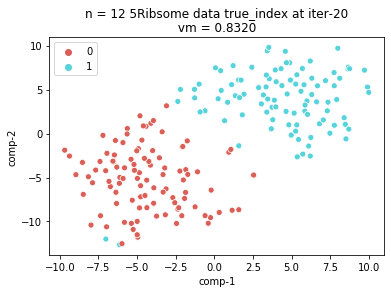

output_collection 0-th batch


/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


output_collection 1-th batch
output_collection 2-th batch
output_collection 3-th batch
output_collection 4-th batch
output_collection 5-th batch
output_collection 6-th batch
output_collection 7-th batch
output_collection 8-th batch
output_collection 9-th batch
output_collection 10-th batch
output_collection 11-th batch
output_collection 12-th batch
output_collection 13-th batch
output_collection 14-th batch
output_collection 15-th batch
output_collection 16-th batch
output_collection 17-th batch
output_collection 18-th batch
output_collection 19-th batch
output_collection 20-th batch
output_collection 21-th batch
output_collection 22-th batch
output_collection 23-th batch
output_collection 24-th batch
output_collection 25-th batch
output_collection 26-th batch
output_collection 27-th batch
output_collection 28-th batch
output_collection 29-th batch
output_collection 30-th batch
output_collection 31-th batch
output_collection 32-th batch
output_collection 33-th batch
output_collection 3

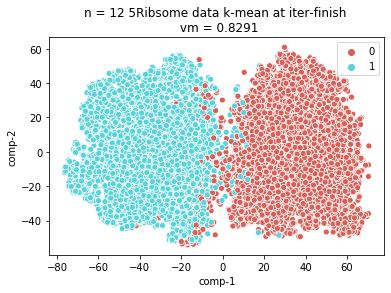

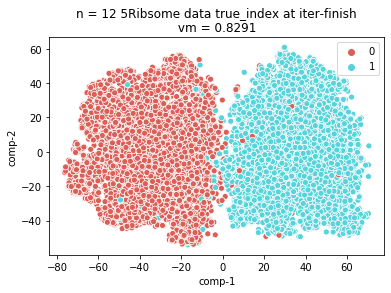

In [15]:
#snr_list = [10, 5, 1, 0.8, 0.6, 0.4, 0.2, 0.1]
snr = 0.4
data_name = f'70s_2class_0304+{snr}'
with open(f'./data/{data_name}/images.pkl', 'rb') as f:
    new_projection = pickle.load( f)

with open(f'./data/{data_name}/angles.pkl', 'rb') as f:
    angles2 = pickle.load( f)

with open(f'./data/{data_name}/orientation_matrix.pkl', 'rb') as f:
    Orientation_Vectors = pickle.load(f)

with open(f'./data/{data_name}/indexs.pkl', 'rb') as f:
    indexs = pickle.load(f)
print('indexs',indexs[:10])     
with open(f'./data/{data_name}/mean_subtracted_strcut.pkl', 'rb') as f:
    mean_subtracted_strcut = pickle.load(f)
    
new_projection = new_projection * mask
print(new_projection.shape)
new_projection = new_projection[:,5:29,5:29]
plt.imshow(new_projection[0])
plt.show()
n = 12
b = 200
niter = 20
pca_n = 2
Images = new_projection#[:5000]
print(Images.shape)
exp_name = f'20220320_{data_name}_EM_2SDR_n_{n}_200_iter'
ProjSize, num_image, n_component , num_iter = 24, Images.shape[0], n, niter
batch_size = b
Vol_geom = astra.create_vol_geom(ProjSize, ProjSize, ProjSize)
#Images = torch.ones(num_image, 48, 48) # fake images for computing purpose

vg = ts.from_astra(Vol_geom)
pg = ts.from_astra(Proj_geom)
op = ts.operator(vg, pg)
MP3 = EM_2SDR(ProjSize, num_image, n_component, op , Images,Orientation_Vectors, exp_name,mean_subtracted_strcut, indexs, batch_size, niter, PCA_n= pca_n)
#MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)
MP3.fit(0.01, True)
MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)

indexs [1 0 0 1 0 1 1 1 0 0]
(10000, 34, 34)


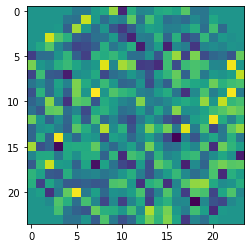

(10000, 24, 24)


/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.341392993927002 sec
0 batch 1 iteration
generated


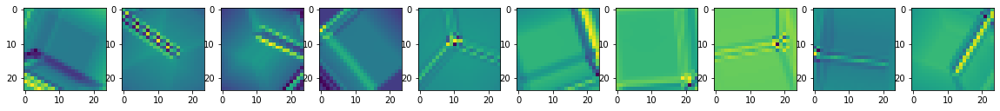

real


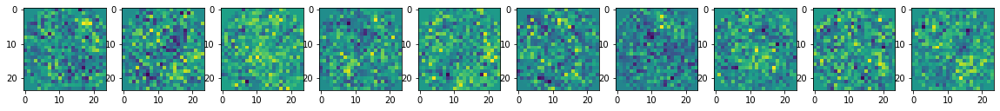

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.037351
[t-SNE] KL divergence after 250 iterations with early exaggeration: 50.894352
[t-SNE] KL divergence after 900 iterations: 0.163209
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


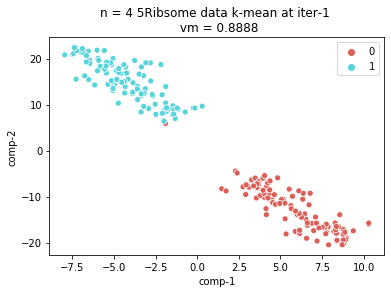

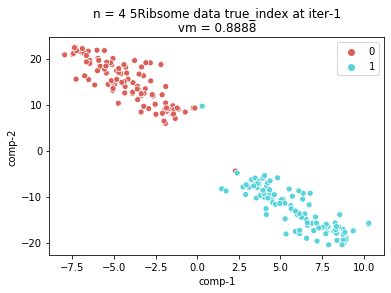

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.296995639801025 sec
0 batch 2 iteration
generated


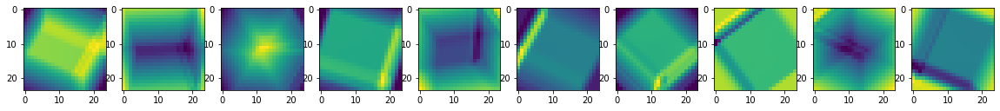

real


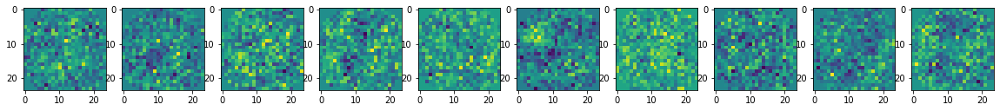

5.9068920612335205 sec
0 batch 3 iteration
generated


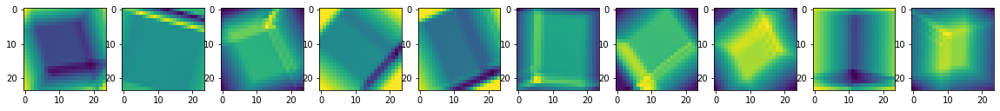

real


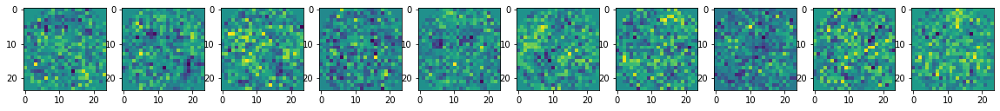

5.443275213241577 sec
0 batch 4 iteration
generated


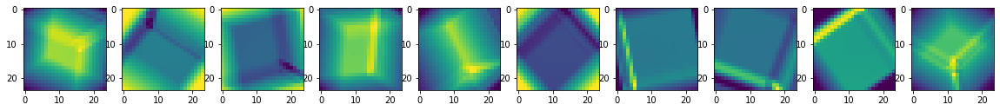

real


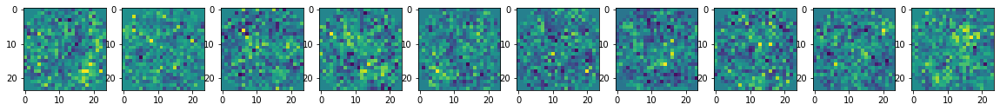

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.004s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.033608
[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.408066
[t-SNE] KL divergence after 1000 iterations: 0.174707
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


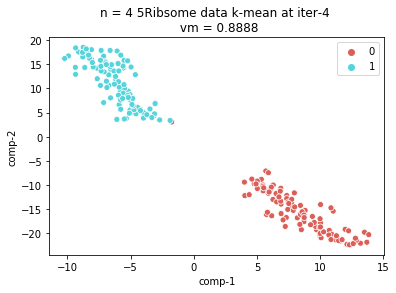

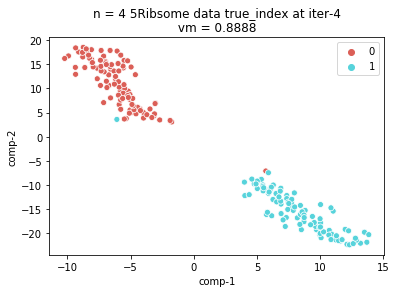

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.782152414321899 sec
0 batch 5 iteration
generated


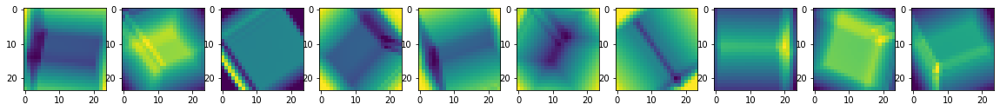

real


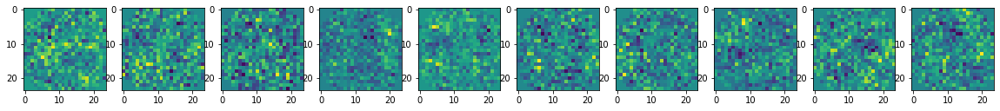

5.841261625289917 sec
0 batch 6 iteration
generated


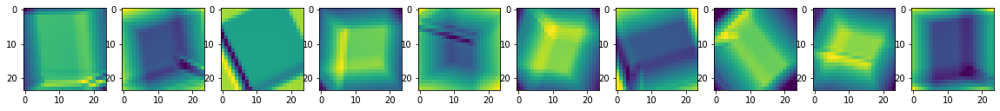

real


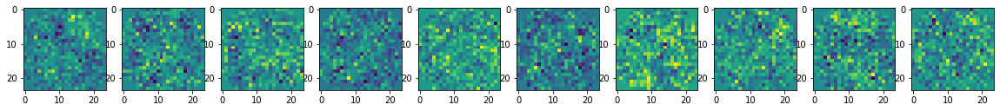

6.143707513809204 sec
0 batch 7 iteration
generated


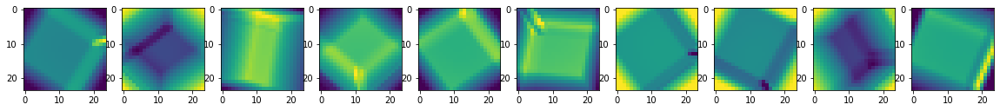

real


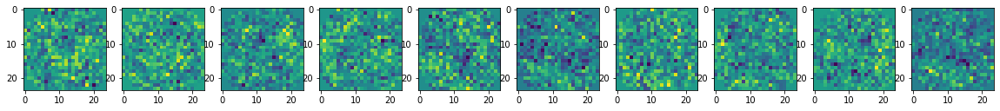

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.033771
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.485378
[t-SNE] KL divergence after 1000 iterations: 0.164853
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


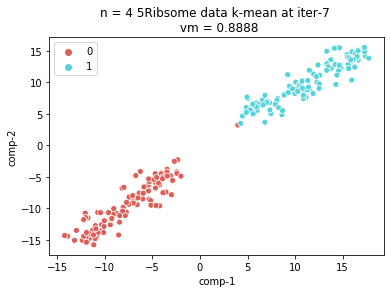

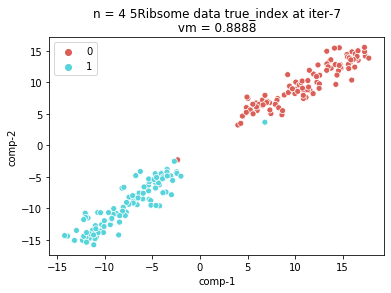

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.859848499298096 sec
0 batch 8 iteration
generated


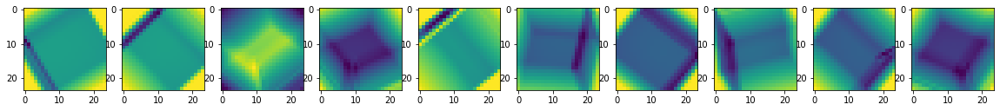

real


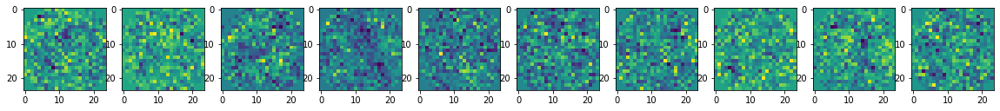

6.398070812225342 sec
0 batch 9 iteration
generated


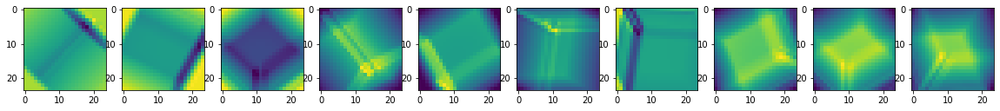

real


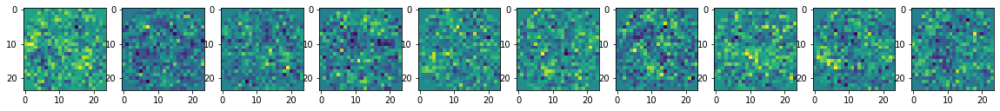

6.057676553726196 sec
0 batch 10 iteration
generated


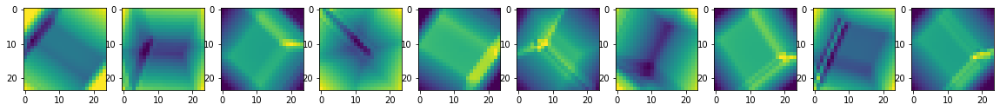

real


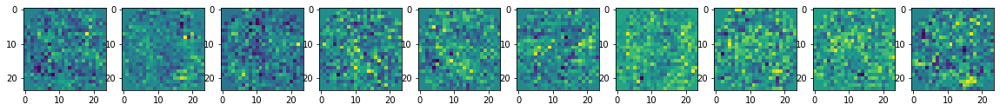

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.031697
[t-SNE] KL divergence after 250 iterations with early exaggeration: 53.981468
[t-SNE] KL divergence after 1000 iterations: 0.178087
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


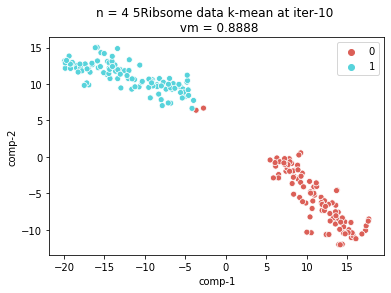

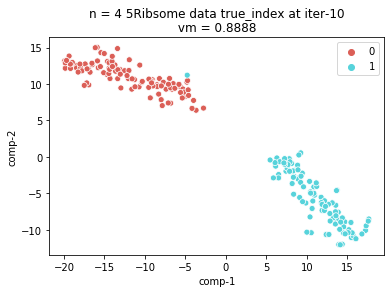

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.841443777084351 sec
0 batch 11 iteration
generated


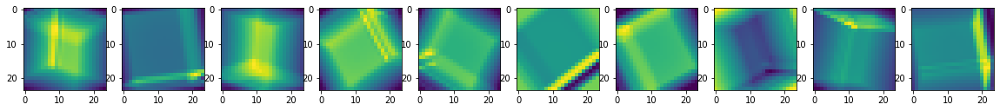

real


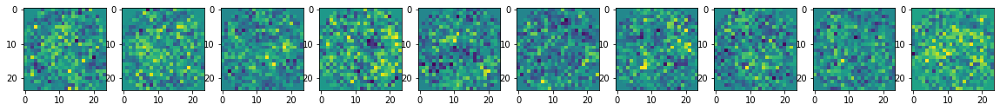

5.915043592453003 sec
0 batch 12 iteration
generated


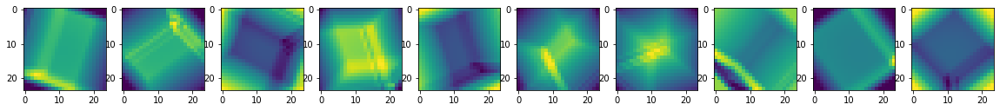

real


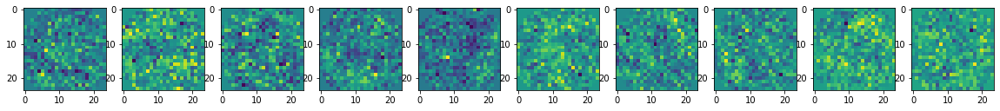

5.720557689666748 sec
0 batch 13 iteration
generated


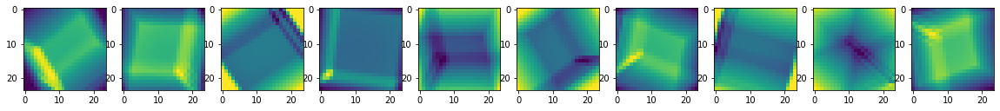

real


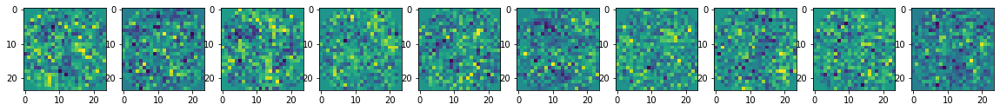

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.006s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.031146
[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.272625
[t-SNE] KL divergence after 800 iterations: 0.179439
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


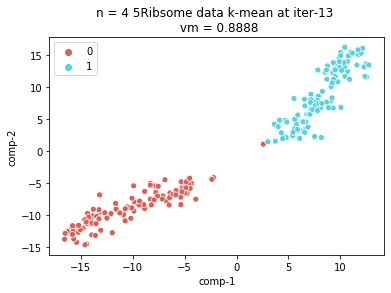

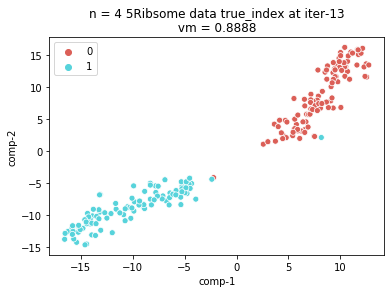

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.361457109451294 sec
0 batch 14 iteration
generated


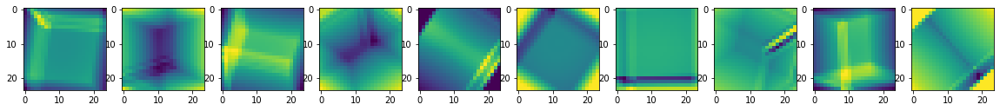

real


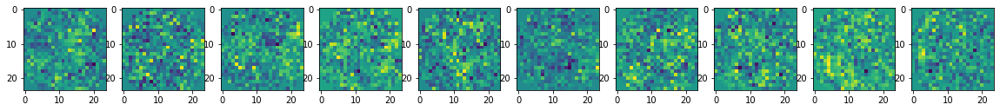

6.154192209243774 sec
0 batch 15 iteration
generated


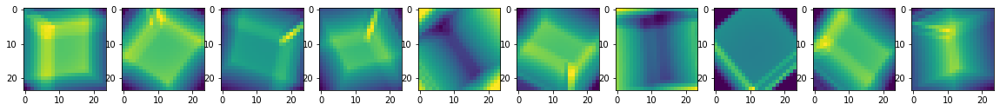

real


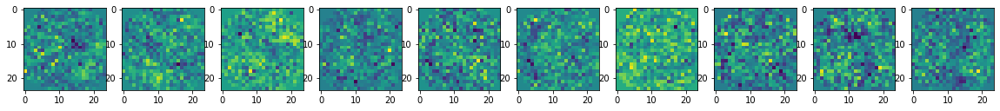

5.544703722000122 sec
0 batch 16 iteration
generated


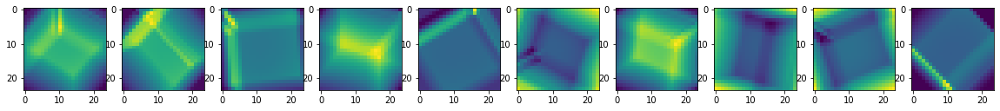

real


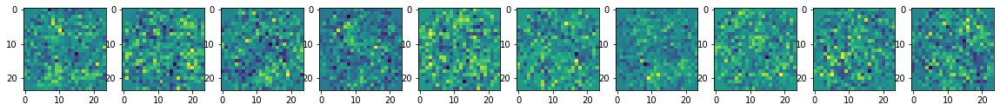

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.029254
[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.129360
[t-SNE] KL divergence after 1000 iterations: 0.194710
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


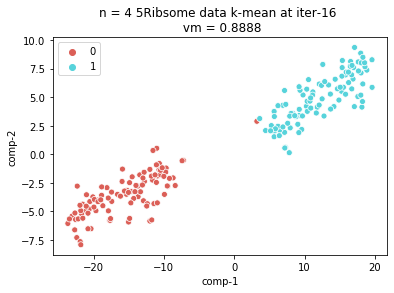

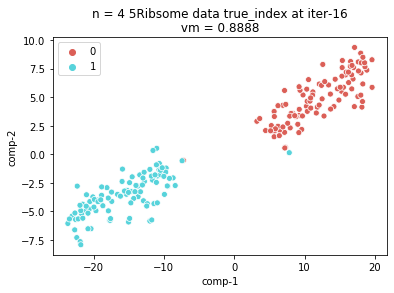

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.724880218505859 sec
0 batch 17 iteration
generated


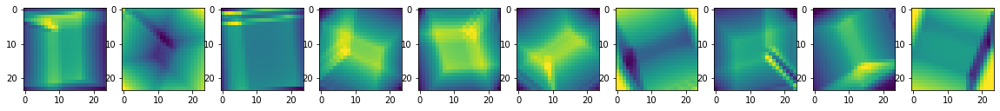

real


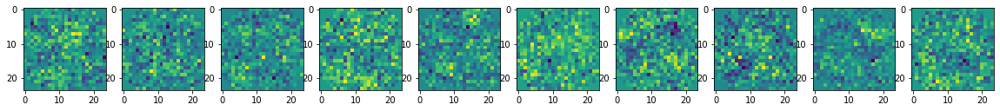

5.406369686126709 sec
0 batch 18 iteration
generated


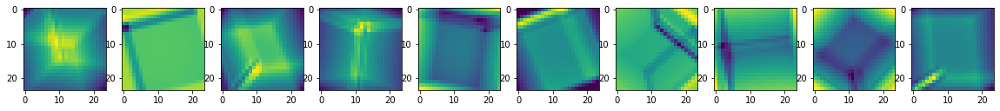

real


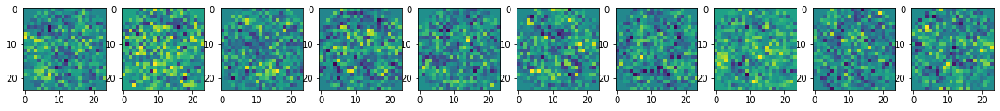

5.925201177597046 sec
0 batch 19 iteration
generated


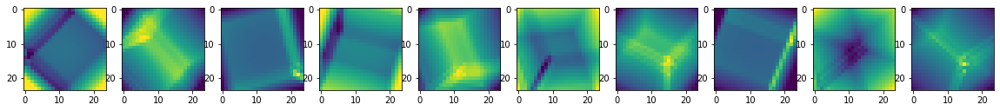

real


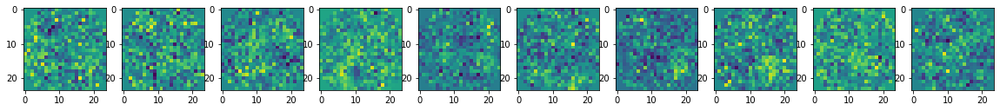

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.028680
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.184517
[t-SNE] KL divergence after 1000 iterations: 0.201164
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


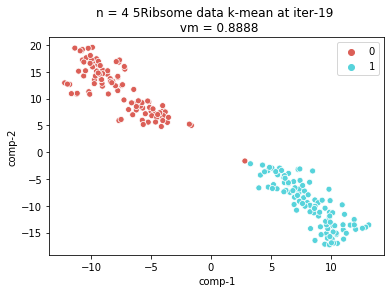

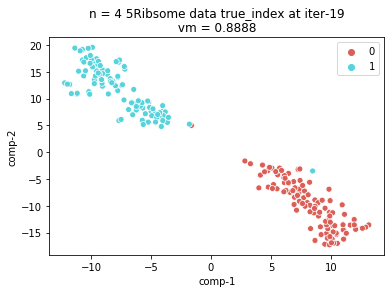

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.943405628204346 sec
0 batch 20 iteration
generated


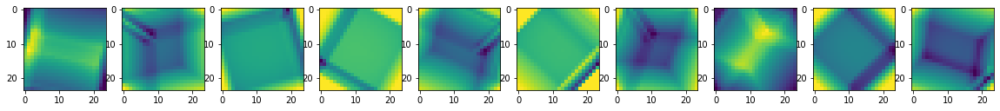

real


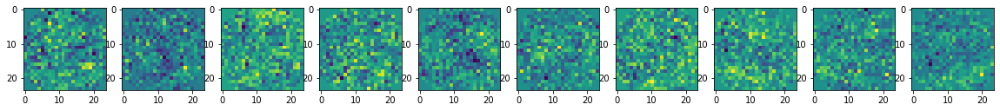

5.986922979354858 sec
0 batch 21 iteration
generated


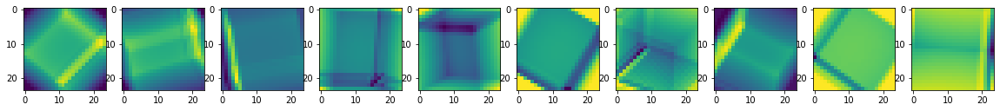

real


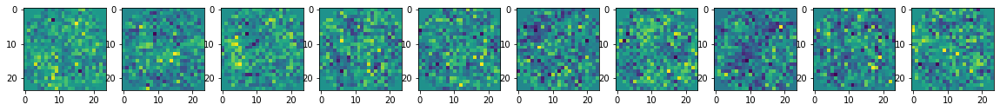

5.793510913848877 sec
0 batch 22 iteration
generated


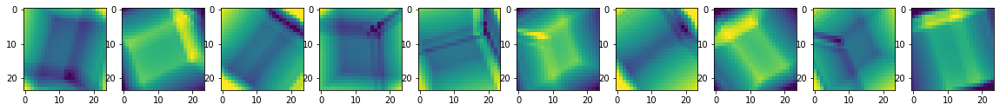

real


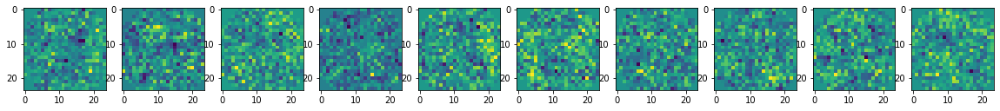

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.004s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.027911
[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.438164
[t-SNE] KL divergence after 800 iterations: 0.208462
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


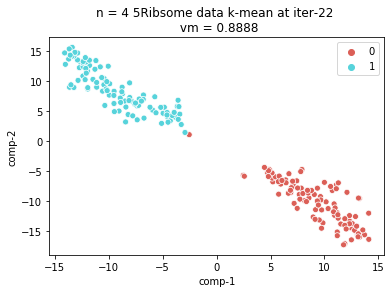

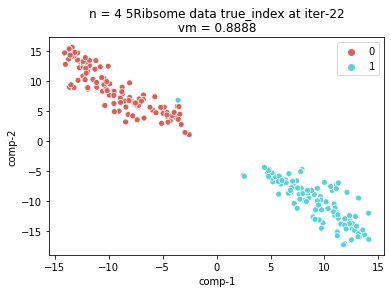

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


6.024091005325317 sec
0 batch 23 iteration
generated


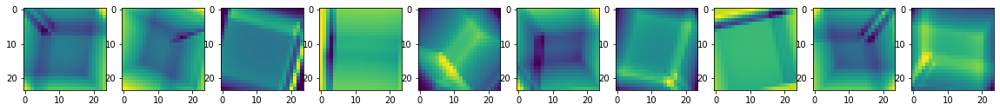

real


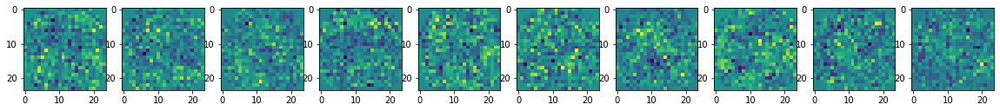

5.682367563247681 sec
0 batch 24 iteration
generated


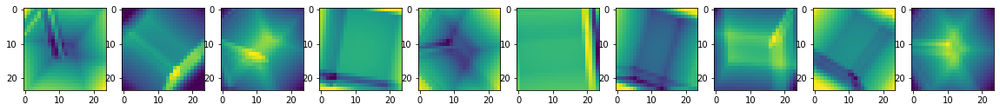

real


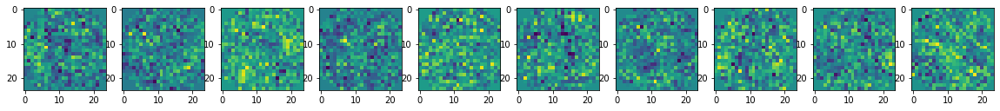

5.265102386474609 sec
0 batch 25 iteration
generated


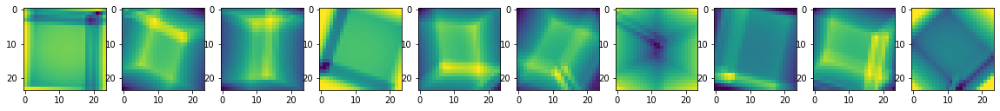

real


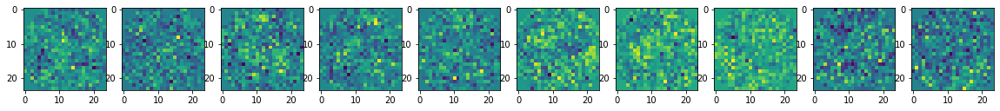

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.004s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.028111
[t-SNE] KL divergence after 250 iterations with early exaggeration: 55.984764
[t-SNE] KL divergence after 1000 iterations: 0.207593
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


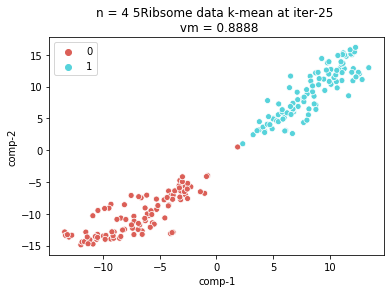

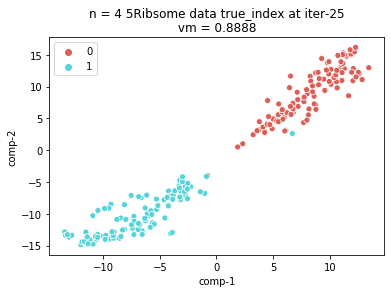

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


6.088077545166016 sec
0 batch 26 iteration
generated


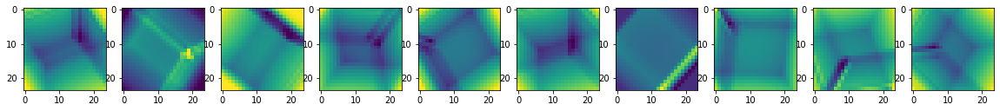

real


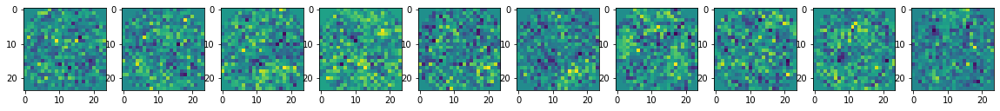

5.853152275085449 sec
0 batch 27 iteration
generated


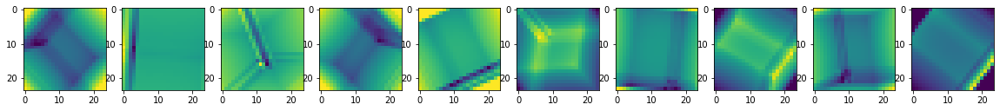

real


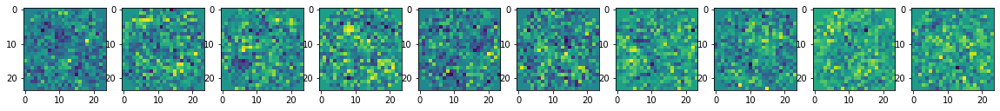

5.854428291320801 sec
0 batch 28 iteration
generated


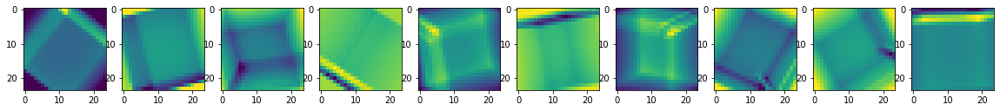

real


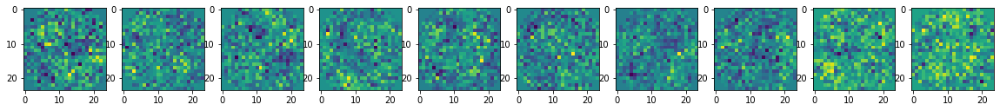

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.026000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.845131
[t-SNE] KL divergence after 1000 iterations: 0.210868
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


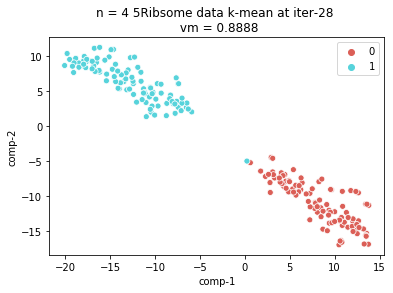

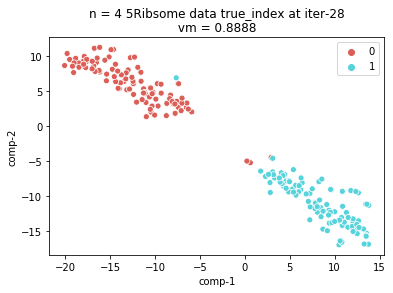

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.593852758407593 sec
0 batch 29 iteration
generated


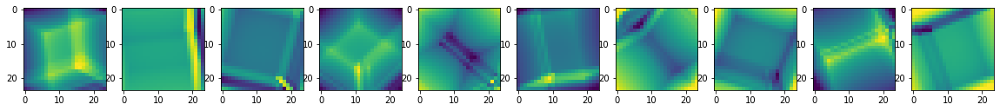

real


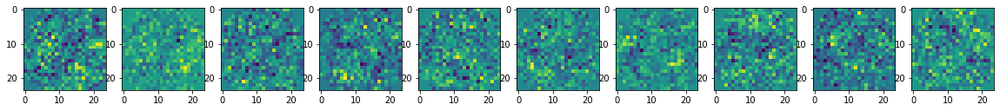

5.8073976039886475 sec
0 batch 30 iteration
generated


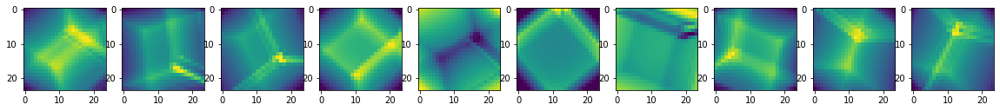

real


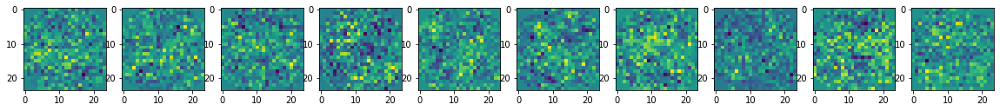

5.204293966293335 sec
0 batch 31 iteration
generated


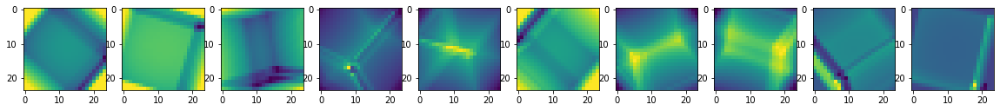

real


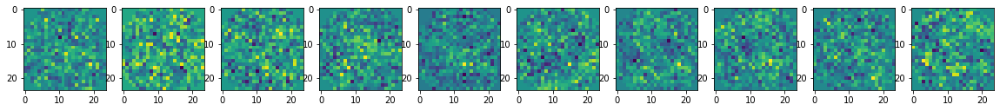

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.003s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.027019
[t-SNE] KL divergence after 250 iterations with early exaggeration: 53.743862
[t-SNE] KL divergence after 1000 iterations: 0.206335
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


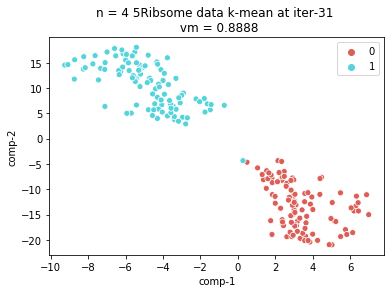

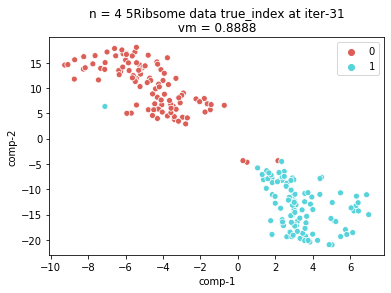

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.800643682479858 sec
0 batch 32 iteration
generated


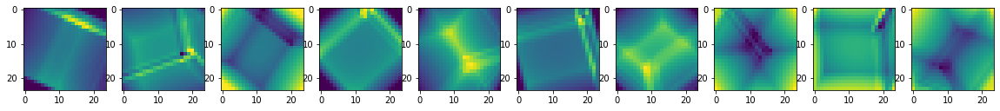

real


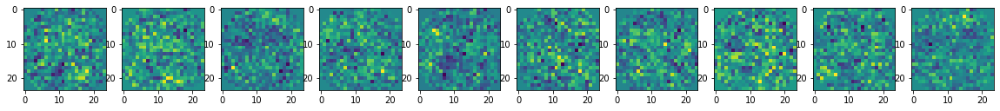

5.785869359970093 sec
0 batch 33 iteration
generated


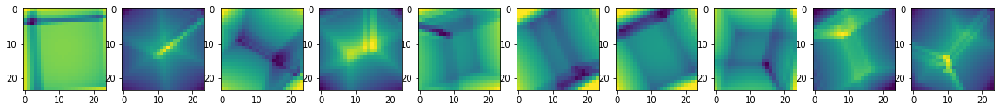

real


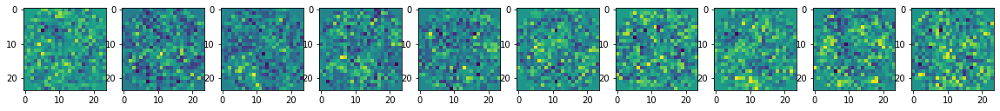

5.792522668838501 sec
0 batch 34 iteration
generated


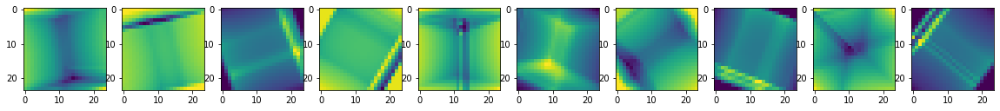

real


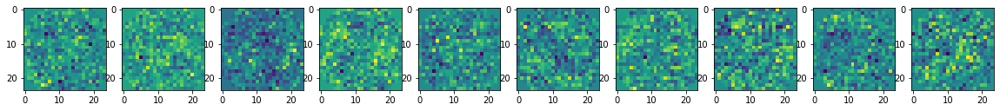

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.004s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.024608
[t-SNE] KL divergence after 250 iterations with early exaggeration: 53.010719
[t-SNE] KL divergence after 750 iterations: 0.230582
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


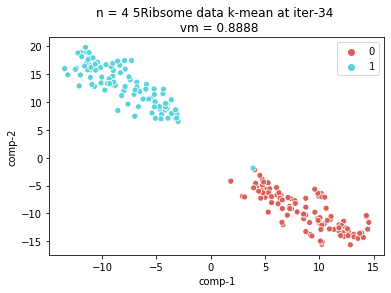

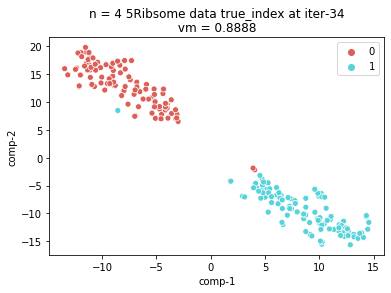

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.59120774269104 sec
0 batch 35 iteration
generated


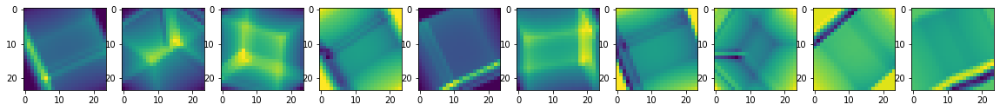

real


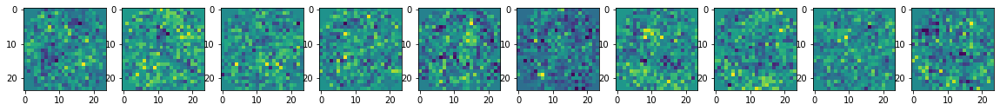

5.478856086730957 sec
0 batch 36 iteration
generated


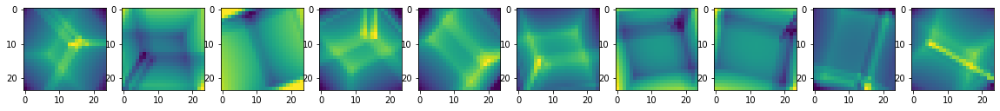

real


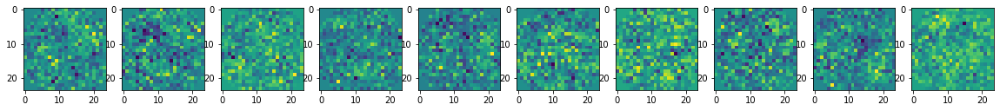

5.629443645477295 sec
0 batch 37 iteration
generated


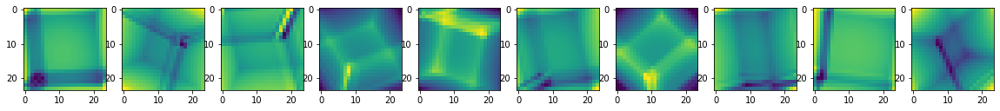

real


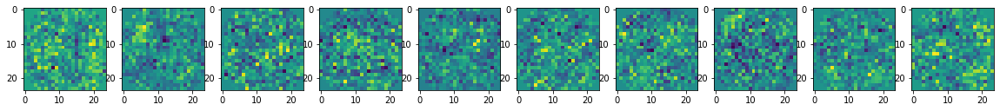

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.004s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.023082
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.994930
[t-SNE] KL divergence after 850 iterations: 0.220072
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


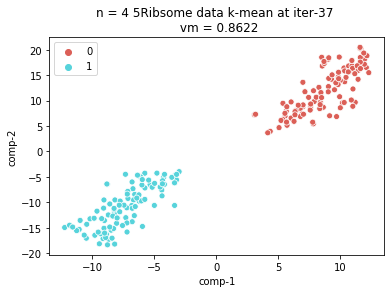

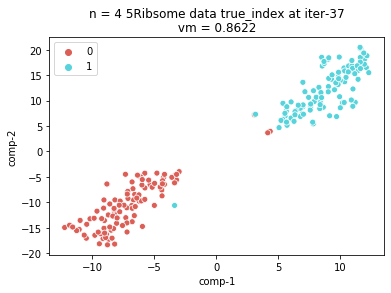

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.730077743530273 sec
0 batch 38 iteration
generated


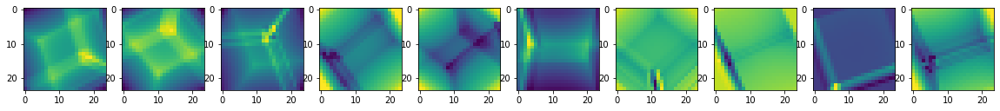

real


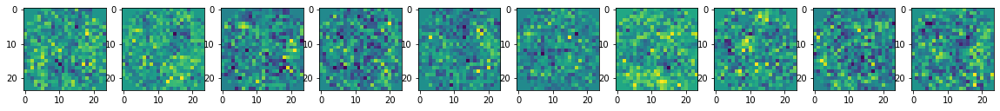

5.628893613815308 sec
0 batch 39 iteration
generated


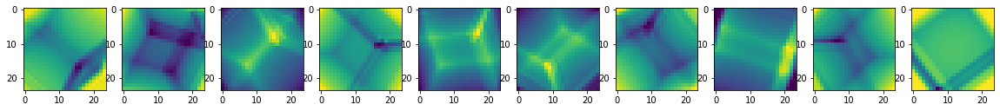

real


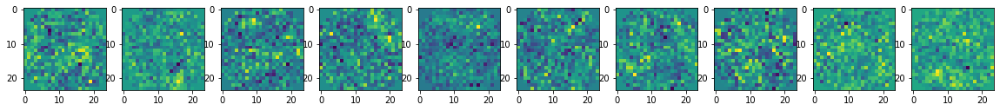

6.296497583389282 sec
0 batch 40 iteration
generated


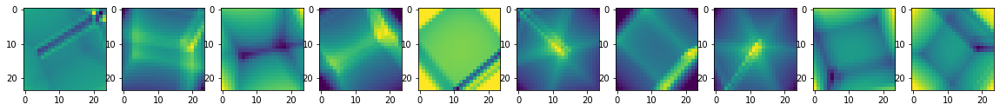

real


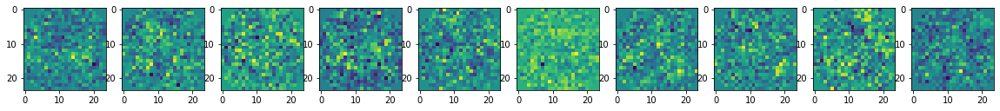

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.023494
[t-SNE] KL divergence after 250 iterations with early exaggeration: 53.665558
[t-SNE] KL divergence after 900 iterations: 0.250403
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


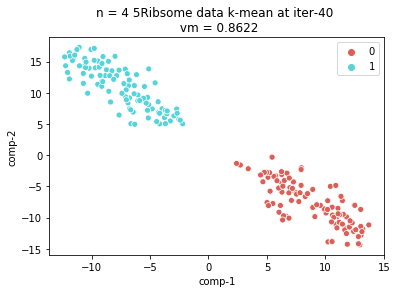

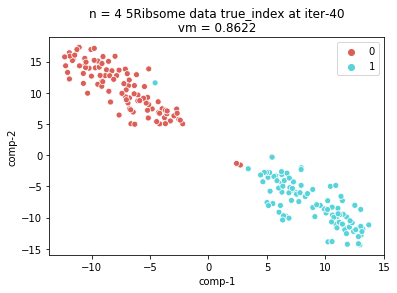

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.403500556945801 sec
0 batch 41 iteration
generated


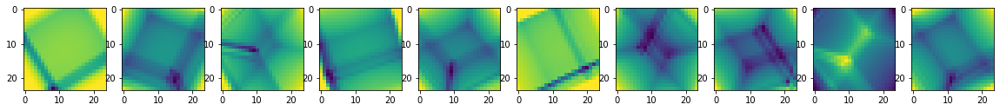

real


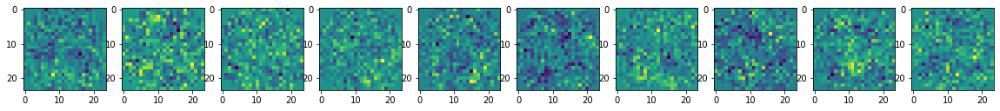

5.372195482254028 sec
0 batch 42 iteration
generated


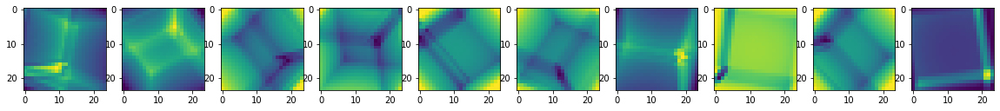

real


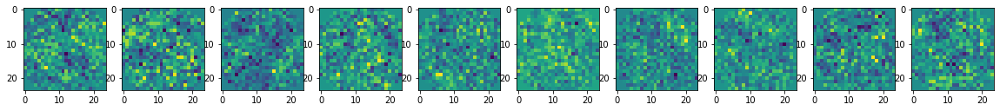

5.417856454849243 sec
0 batch 43 iteration
generated


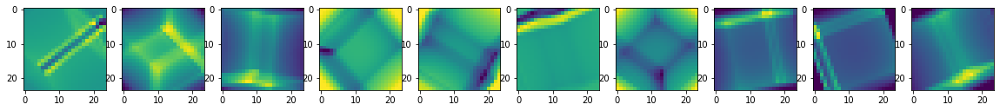

real


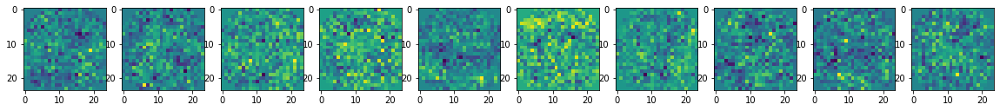

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.006s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.023307
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.761471
[t-SNE] KL divergence after 1000 iterations: 0.218425
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


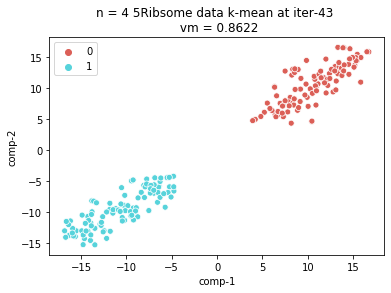

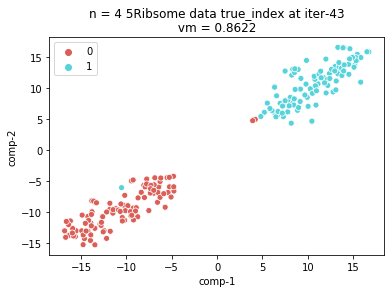

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.291915655136108 sec
0 batch 44 iteration
generated


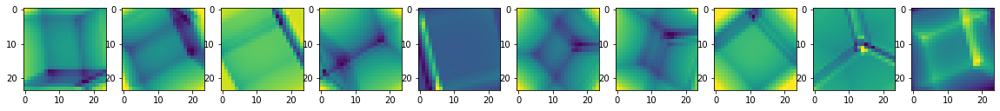

real


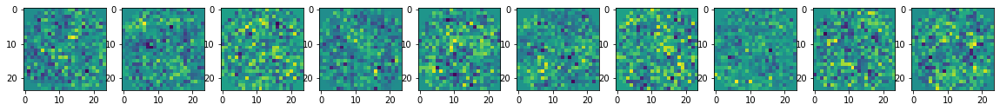

6.145709037780762 sec
0 batch 45 iteration
generated


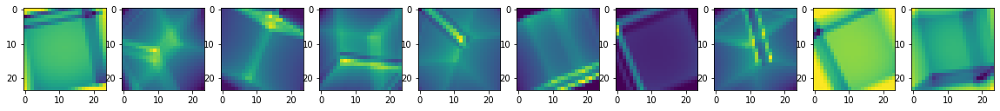

real


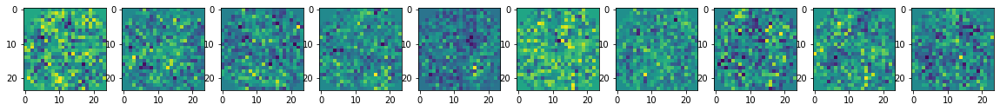

5.687633752822876 sec
0 batch 46 iteration
generated


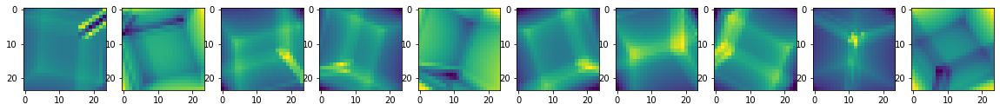

real


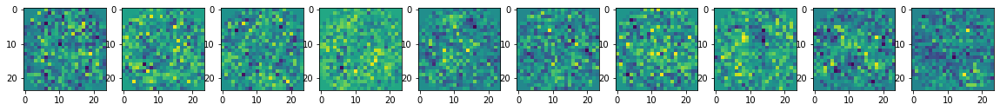

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.022256
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.895058
[t-SNE] KL divergence after 900 iterations: 0.233759
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


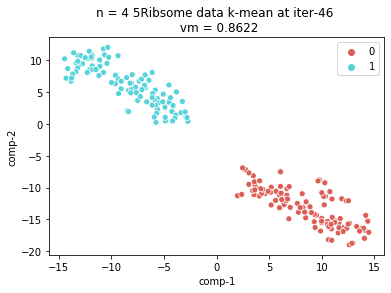

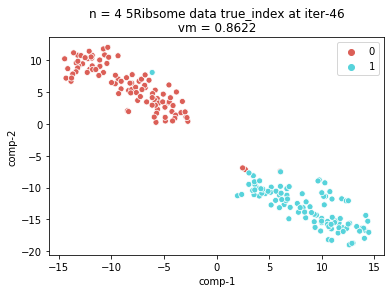

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.53093695640564 sec
0 batch 47 iteration
generated


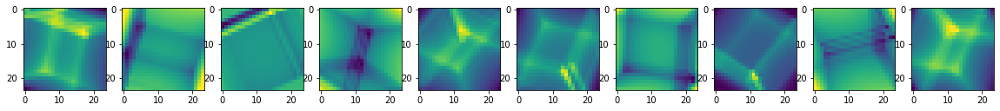

real


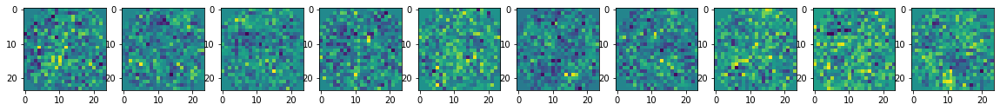

5.393381595611572 sec
0 batch 48 iteration
generated


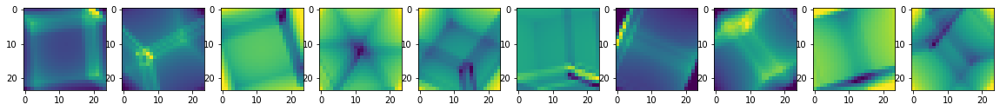

real


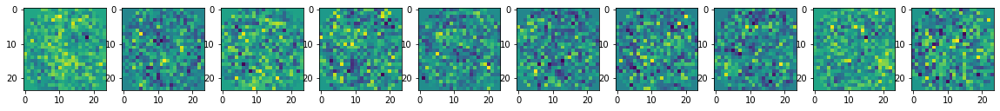

5.962019205093384 sec
0 batch 49 iteration
generated


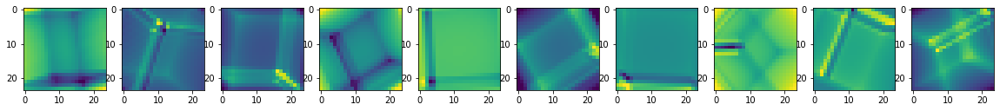

real


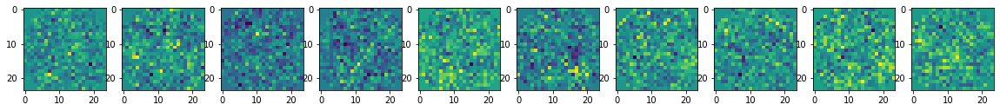

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.021548
[t-SNE] KL divergence after 250 iterations with early exaggeration: 53.964863
[t-SNE] KL divergence after 1000 iterations: 0.255749
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


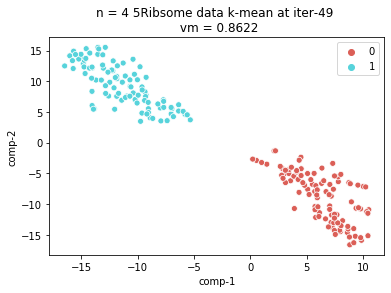

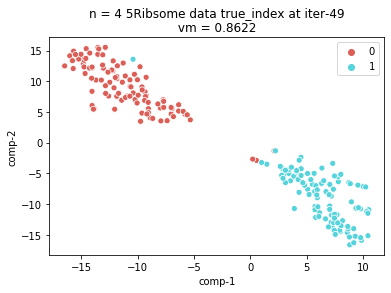

Exception: Unable to initialize Projector3D.

In [12]:
#snr_list = [10, 5, 1, 0.8, 0.6, 0.4, 0.2, 0.1]
snr = 0.4
data_name = f'70s_2class_0304+{snr}'
with open(f'./data/{data_name}/images.pkl', 'rb') as f:
    new_projection = pickle.load( f)

with open(f'./data/{data_name}/angles.pkl', 'rb') as f:
    angles2 = pickle.load( f)

with open(f'./data/{data_name}/orientation_matrix.pkl', 'rb') as f:
    Orientation_Vectors = pickle.load(f)

with open(f'./data/{data_name}/indexs.pkl', 'rb') as f:
    indexs = pickle.load(f)
print('indexs',indexs[:10])     
with open(f'./data/{data_name}/mean_subtracted_strcut.pkl', 'rb') as f:
    mean_subtracted_strcut = pickle.load(f)
    
new_projection = new_projection * mask
print(new_projection.shape)
new_projection = new_projection[:,5:29,5:29]
plt.imshow(new_projection[0])
plt.show()
n = 4
b = 200
niter = 200
pca_n = 2
Images = new_projection#[:5000]
print(Images.shape)
exp_name = f'20220320_{data_name}_EM_2SDR_n_{n}_200_iter'
ProjSize, num_image, n_component , num_iter = 24, Images.shape[0], n, niter
batch_size = b
Vol_geom = astra.create_vol_geom(ProjSize, ProjSize, ProjSize)
#Images = torch.ones(num_image, 48, 48) # fake images for computing purpose

vg = ts.from_astra(Vol_geom)
pg = ts.from_astra(Proj_geom)
op = ts.operator(vg, pg)
MP3 = EM_2SDR(ProjSize, num_image, n_component, op , Images,Orientation_Vectors, exp_name,mean_subtracted_strcut, indexs, batch_size, niter, PCA_n= pca_n)
#MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)
MP3.fit(0.01, True)
MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


6.146633625030518 sec
0 batch 1 iteration
generated


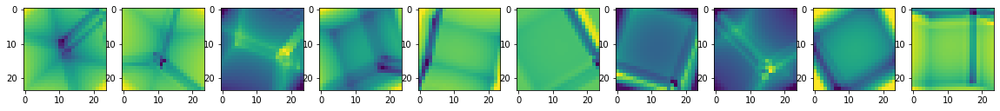

real


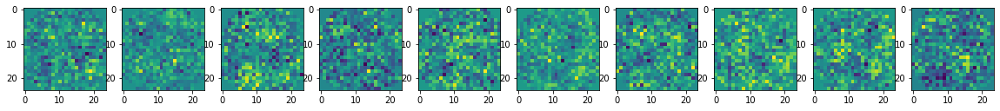

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.006s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.021584
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.889488
[t-SNE] KL divergence after 1000 iterations: 0.231521
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


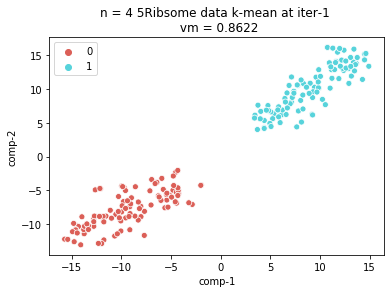

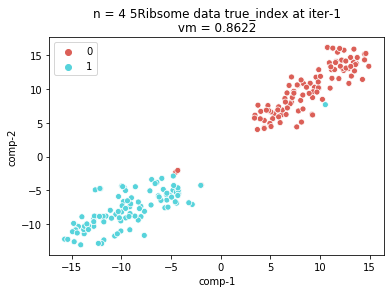

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.653849124908447 sec
0 batch 2 iteration
generated


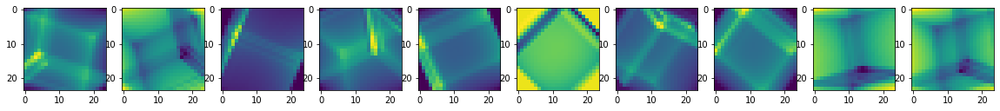

real


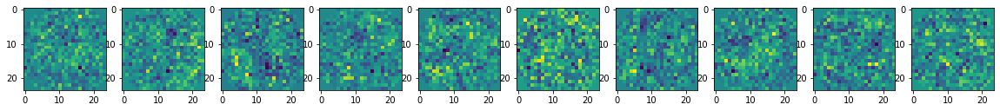

5.525985956192017 sec
0 batch 3 iteration
generated


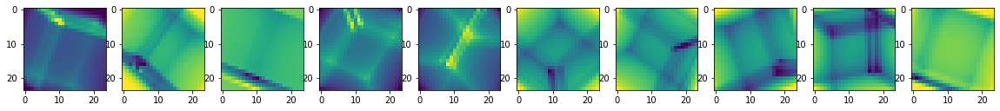

real


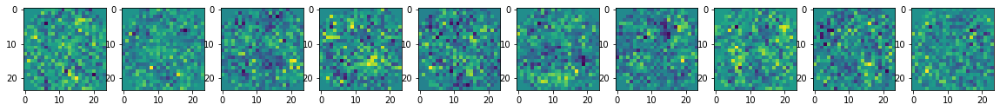

5.575389862060547 sec
0 batch 4 iteration
generated


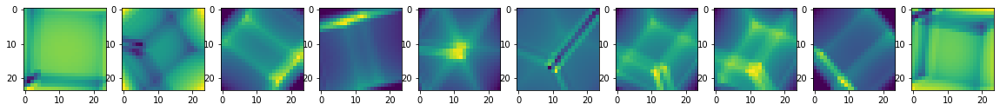

real


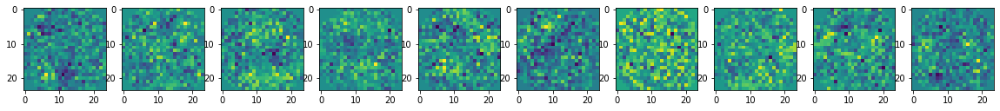

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.006s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.020336
[t-SNE] KL divergence after 250 iterations with early exaggeration: 53.228951
[t-SNE] KL divergence after 950 iterations: 0.252802
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


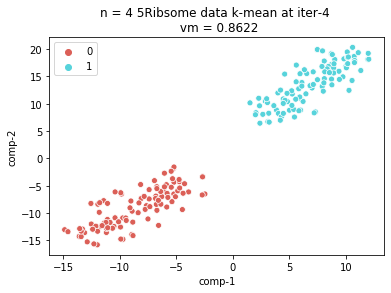

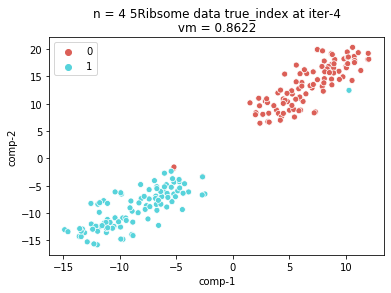

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.35201096534729 sec
0 batch 5 iteration
generated


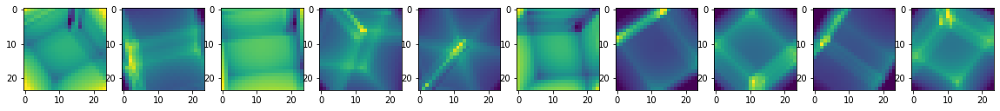

real


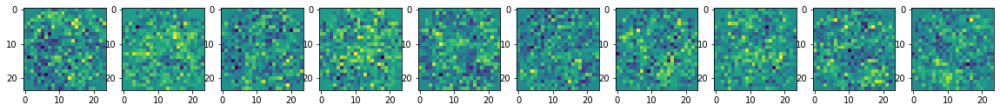

5.463930368423462 sec
0 batch 6 iteration
generated


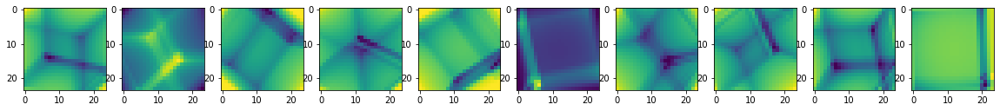

real


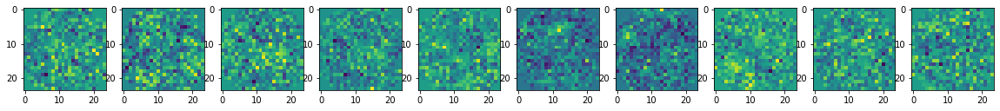

5.431955099105835 sec
0 batch 7 iteration
generated


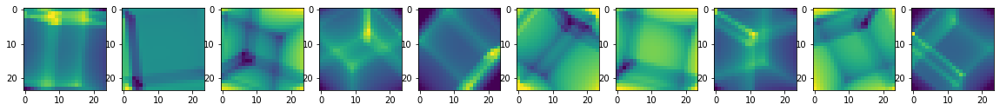

real


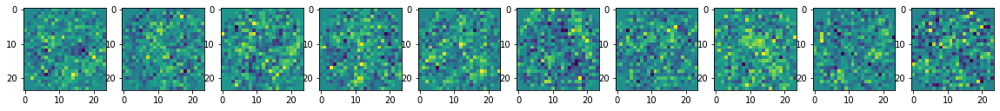

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.020275
[t-SNE] KL divergence after 250 iterations with early exaggeration: 53.099239
[t-SNE] KL divergence after 700 iterations: 0.272282
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


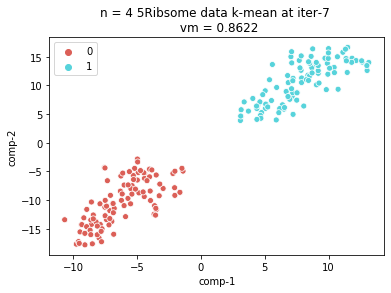

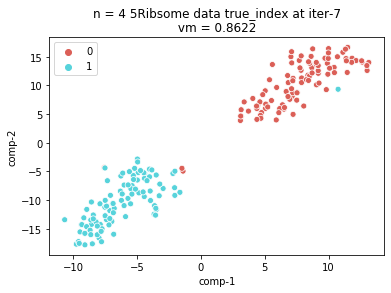

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.697727918624878 sec
0 batch 8 iteration
generated


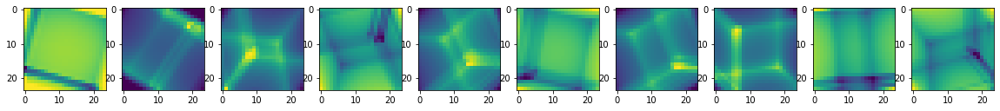

real


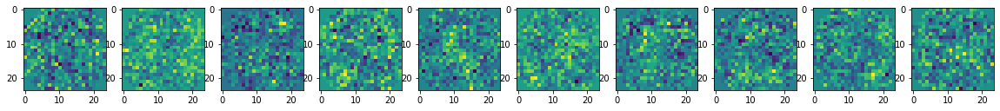

5.796743392944336 sec
0 batch 9 iteration
generated


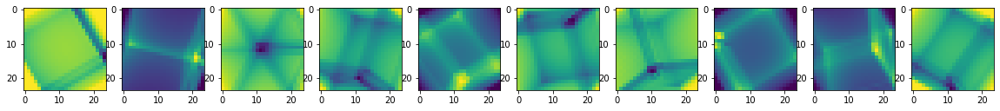

real


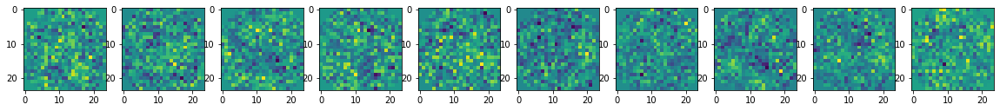

6.19106125831604 sec
0 batch 10 iteration
generated


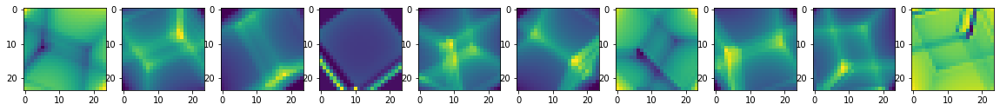

real


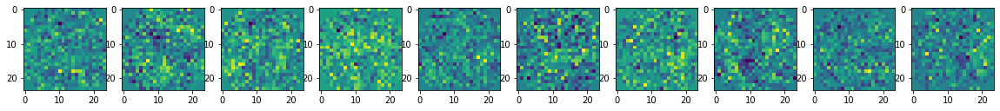

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.019990
[t-SNE] KL divergence after 250 iterations with early exaggeration: 53.728004
[t-SNE] KL divergence after 1000 iterations: 0.255306
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


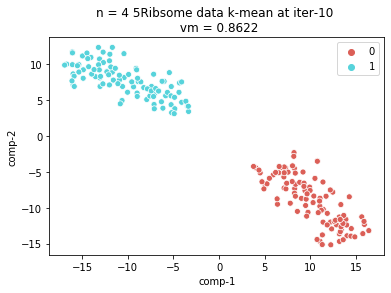

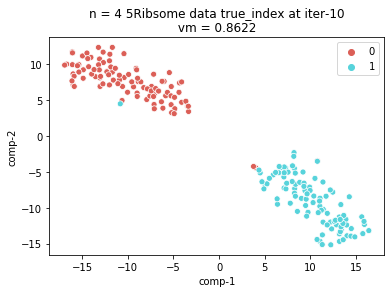

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.9295103549957275 sec
0 batch 11 iteration
generated


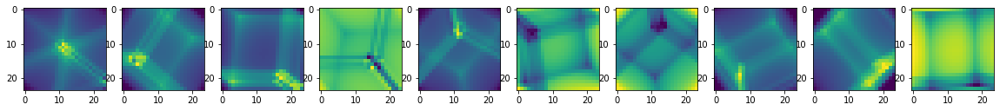

real


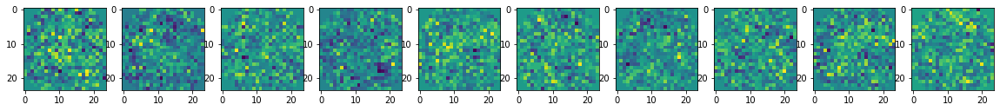

5.6565961837768555 sec
0 batch 12 iteration
generated


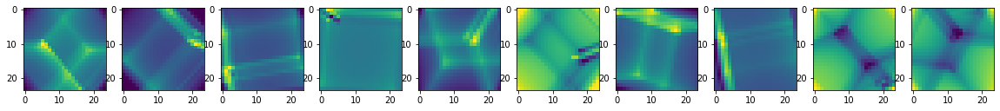

real


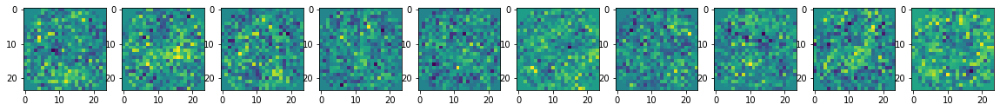

5.584010124206543 sec
0 batch 13 iteration
generated


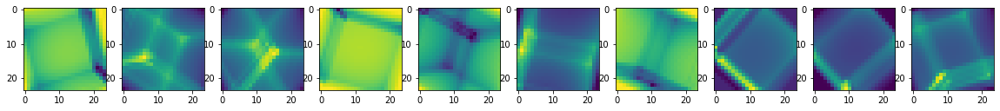

real


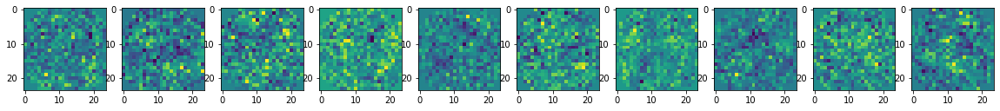

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.004s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.018915
[t-SNE] KL divergence after 250 iterations with early exaggeration: 55.039200
[t-SNE] KL divergence after 900 iterations: 0.275566
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


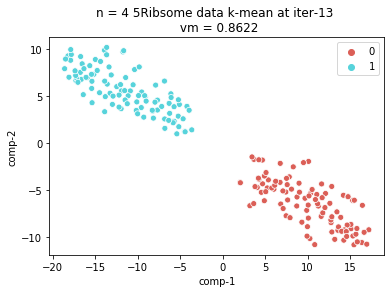

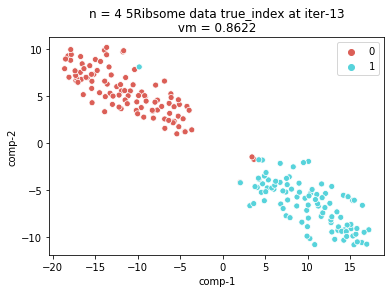

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.545399188995361 sec
0 batch 14 iteration
generated


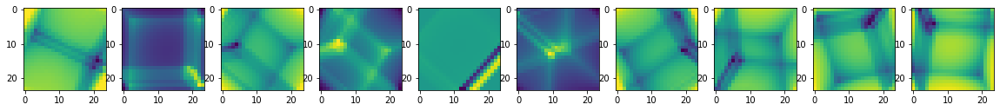

real


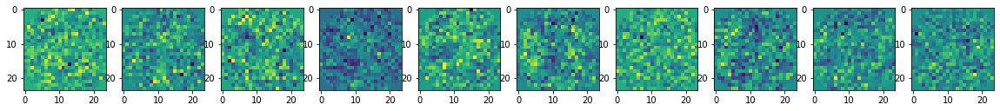

5.449753284454346 sec
0 batch 15 iteration
generated


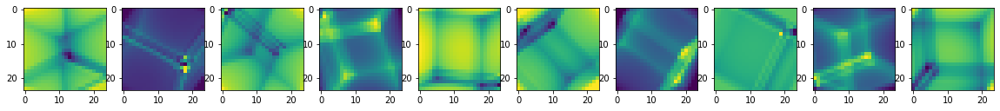

real


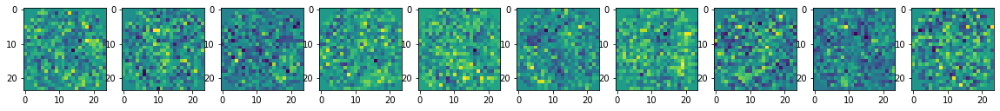

5.4415929317474365 sec
0 batch 16 iteration
generated


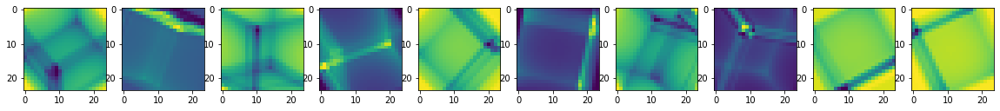

real


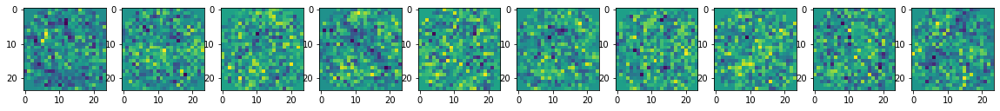

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.004s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.018538
[t-SNE] KL divergence after 250 iterations with early exaggeration: 54.180176
[t-SNE] KL divergence after 750 iterations: 0.265705
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


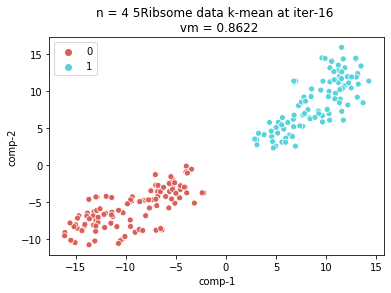

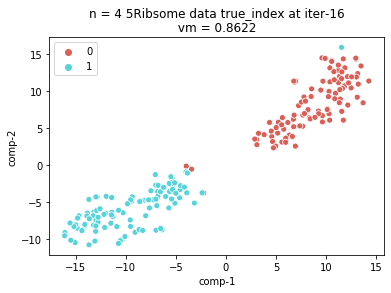

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.141263484954834 sec
0 batch 17 iteration
generated


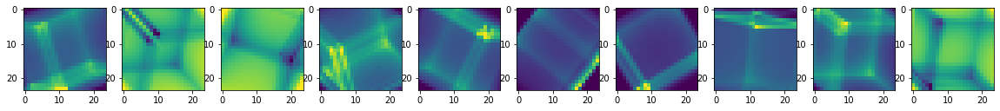

real


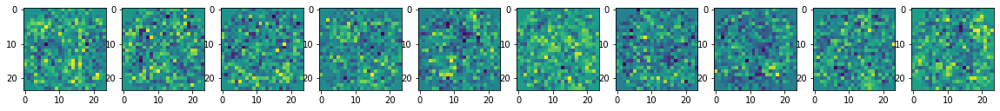

5.173772096633911 sec
0 batch 18 iteration
generated


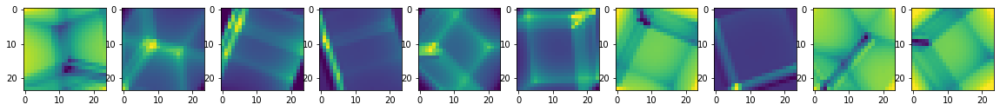

real


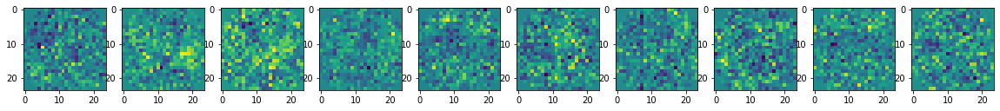

5.74430251121521 sec
0 batch 19 iteration
generated


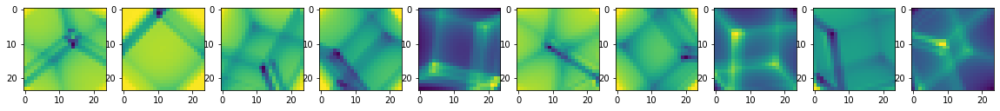

real


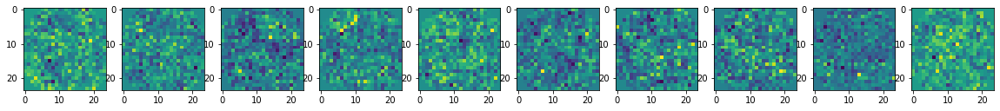

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.017824
[t-SNE] KL divergence after 250 iterations with early exaggeration: 54.563122
[t-SNE] KL divergence after 1000 iterations: 0.275200
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


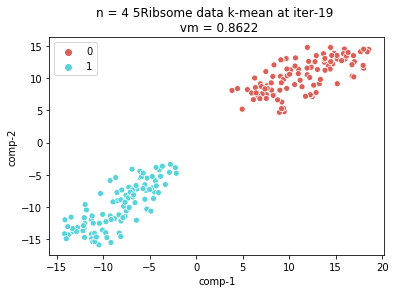

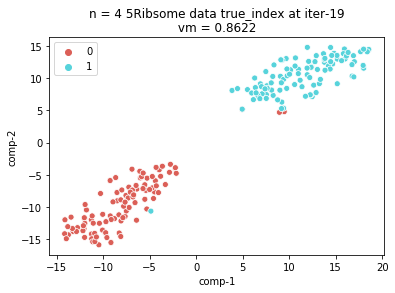

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.139482259750366 sec
0 batch 20 iteration
generated


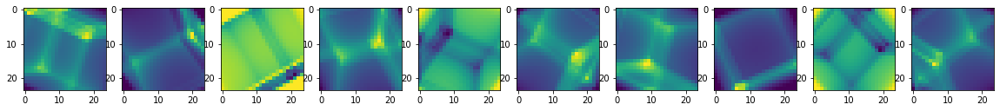

real


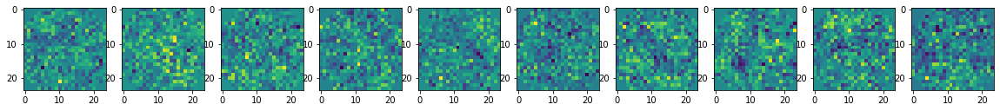

5.103121042251587 sec
0 batch 21 iteration
generated


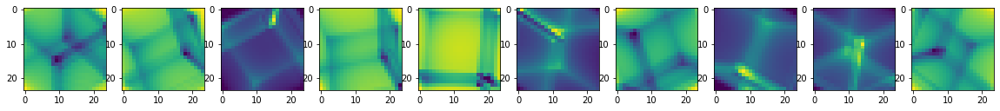

real


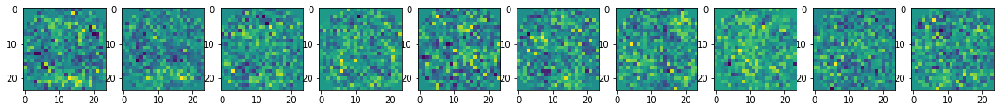

5.917886972427368 sec
0 batch 22 iteration
generated


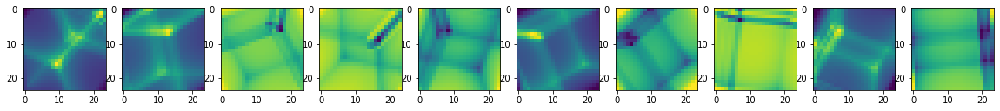

real


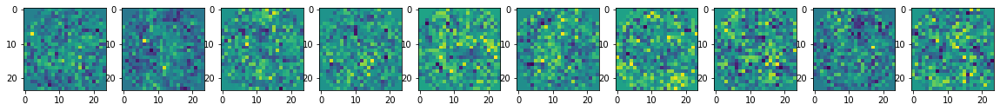

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.003s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.018038
[t-SNE] KL divergence after 250 iterations with early exaggeration: 54.895512
[t-SNE] KL divergence after 850 iterations: 0.280770
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


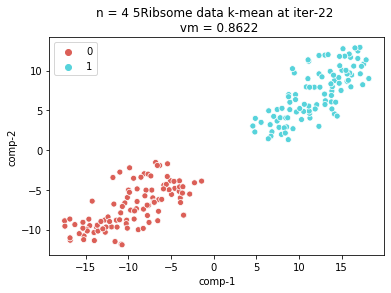

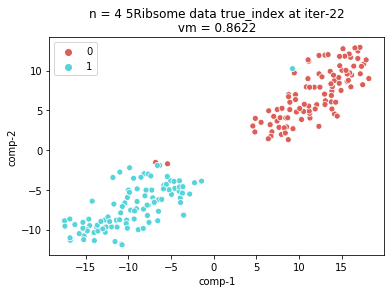

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.293530702590942 sec
0 batch 23 iteration
generated


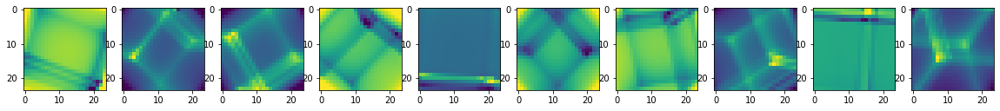

real


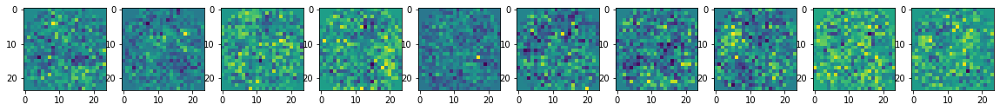

5.69607138633728 sec
0 batch 24 iteration
generated


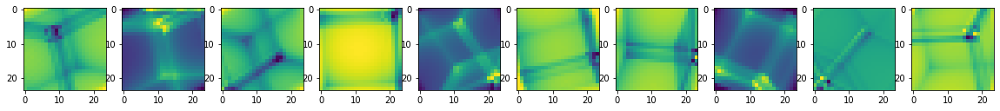

real


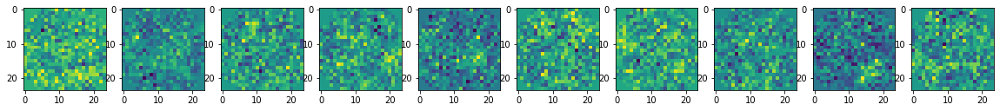

5.435195446014404 sec
0 batch 25 iteration
generated


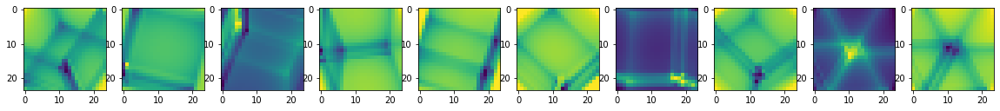

real


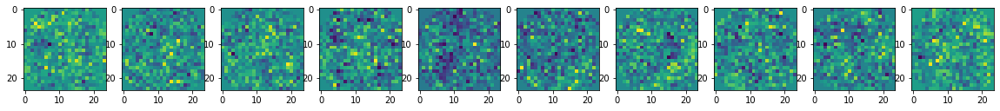

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.004s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.017066
[t-SNE] KL divergence after 250 iterations with early exaggeration: 53.219650
[t-SNE] KL divergence after 1000 iterations: 0.337567
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


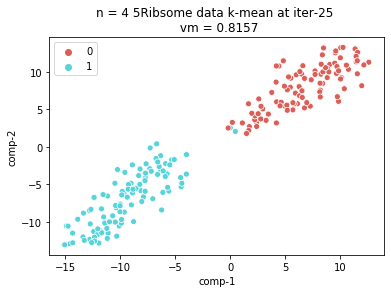

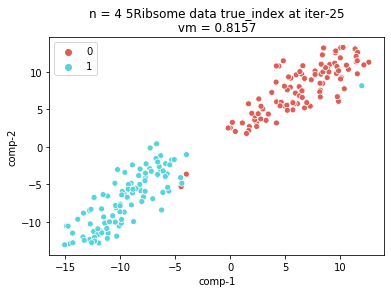

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.710648059844971 sec
0 batch 26 iteration
generated


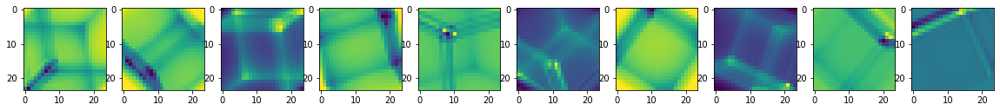

real


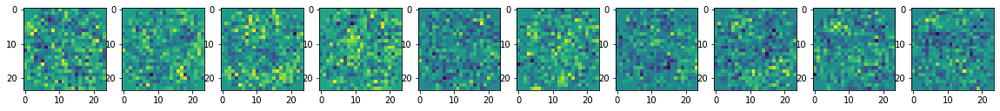

5.464023590087891 sec
0 batch 27 iteration
generated


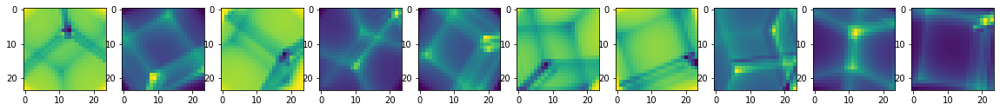

real


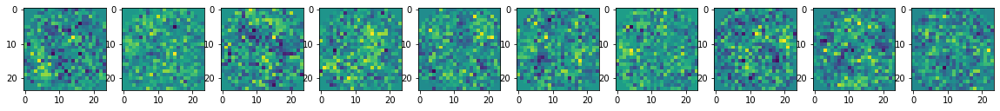

5.591346740722656 sec
0 batch 28 iteration
generated


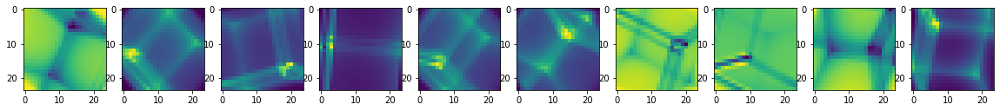

real


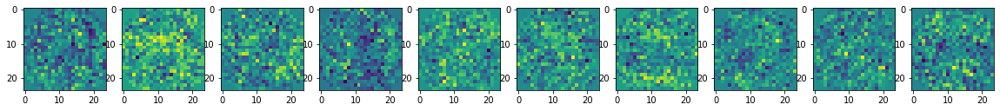

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.016493
[t-SNE] KL divergence after 250 iterations with early exaggeration: 54.683403
[t-SNE] KL divergence after 700 iterations: 0.298735
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


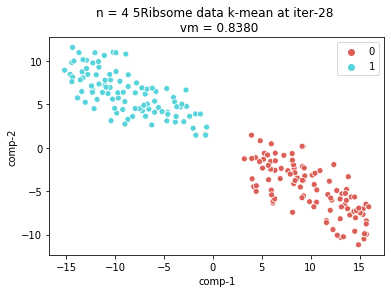

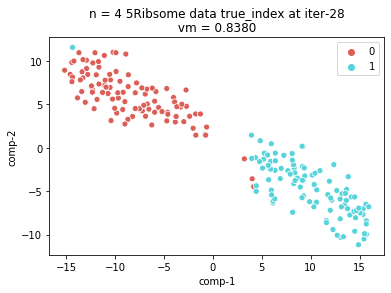

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.858349084854126 sec
0 batch 29 iteration
generated


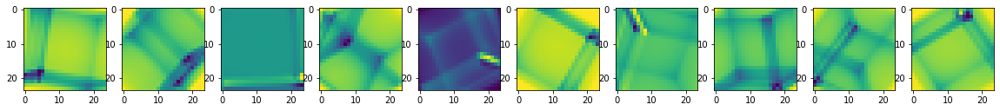

real


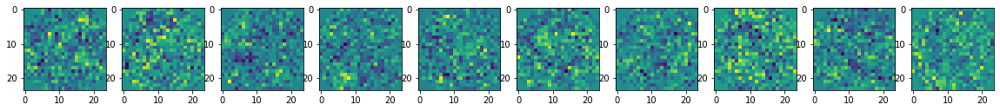

5.397045373916626 sec
0 batch 30 iteration
generated


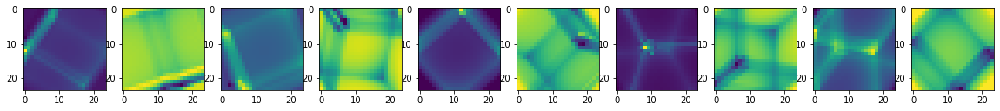

real


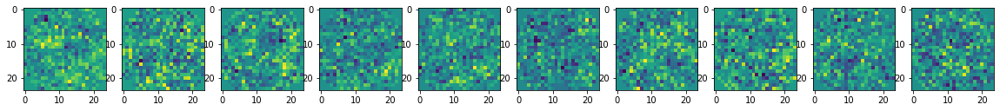

6.166429758071899 sec
0 batch 31 iteration
generated


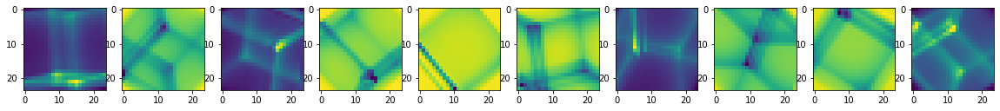

real


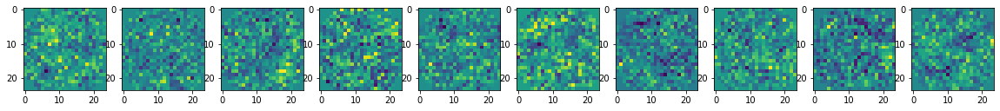

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.016462
[t-SNE] KL divergence after 250 iterations with early exaggeration: 55.905804
[t-SNE] KL divergence after 950 iterations: 0.297453
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


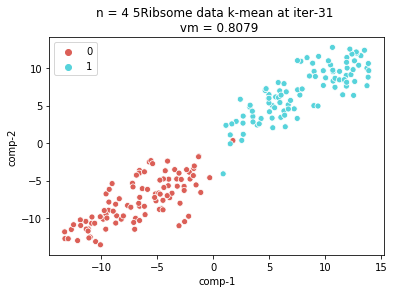

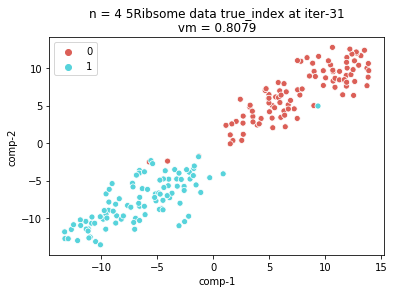

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.713547945022583 sec
0 batch 32 iteration
generated


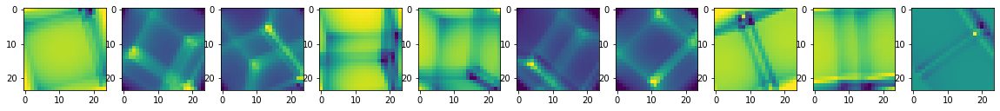

real


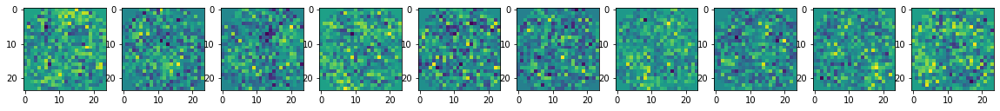

5.76850962638855 sec
0 batch 33 iteration
generated


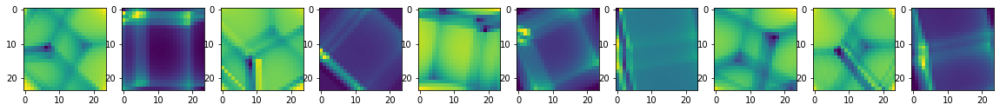

real


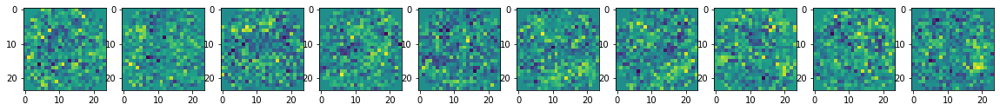

5.815938234329224 sec
0 batch 34 iteration
generated


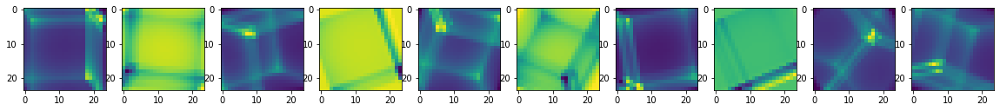

real


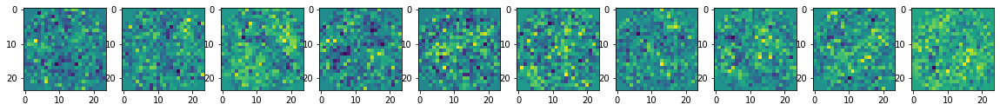

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.006s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.015944
[t-SNE] KL divergence after 250 iterations with early exaggeration: 56.649414
[t-SNE] KL divergence after 750 iterations: 0.295223
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


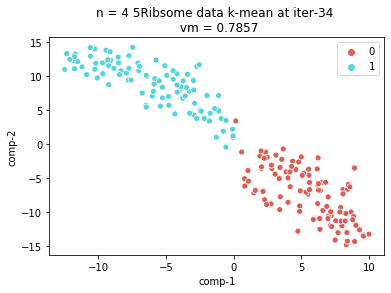

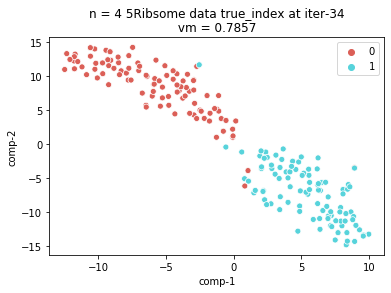

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.588742017745972 sec
0 batch 35 iteration
generated


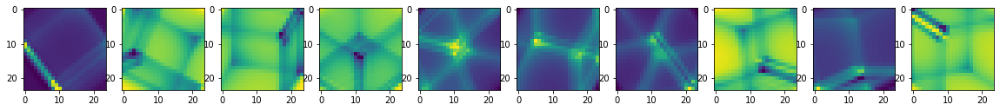

real


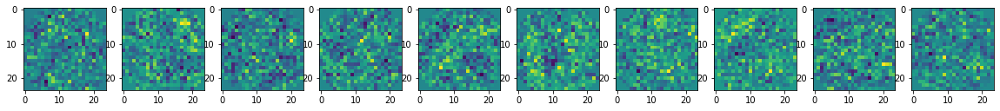

5.9347779750823975 sec
0 batch 36 iteration
generated


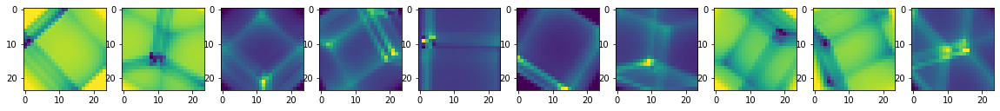

real


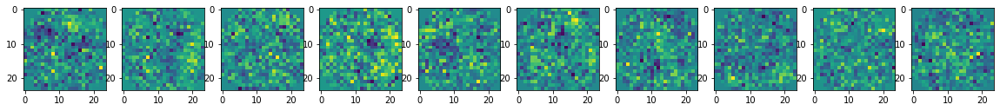

5.788673639297485 sec
0 batch 37 iteration
generated


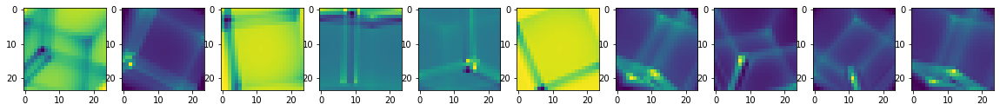

real


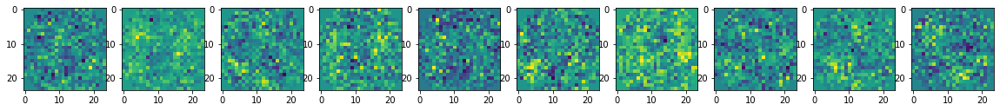

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.015309
[t-SNE] KL divergence after 250 iterations with early exaggeration: 55.617668
[t-SNE] KL divergence after 850 iterations: 0.326626
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


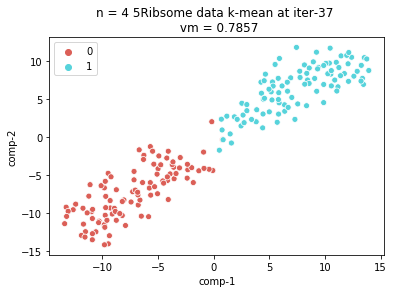

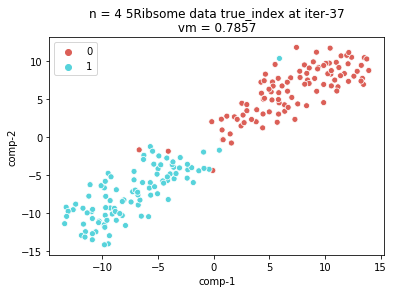

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.574413537979126 sec
0 batch 38 iteration
generated


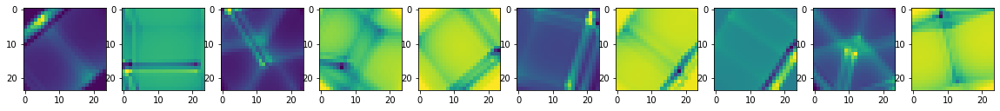

real


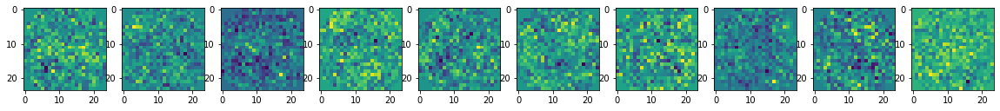

5.258116722106934 sec
0 batch 39 iteration
generated


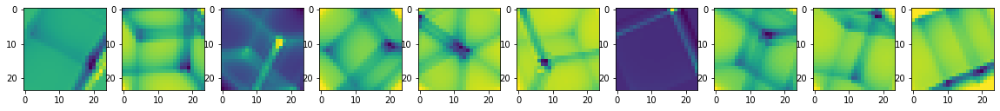

real


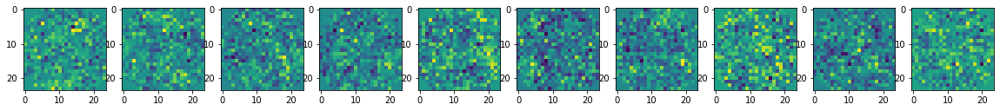

5.368283987045288 sec
0 batch 40 iteration
generated


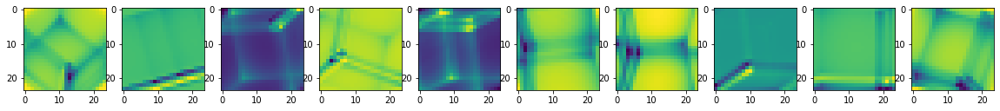

real


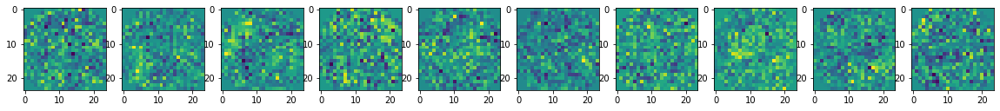

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.014849
[t-SNE] KL divergence after 250 iterations with early exaggeration: 56.458965
[t-SNE] KL divergence after 1000 iterations: 0.301581
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


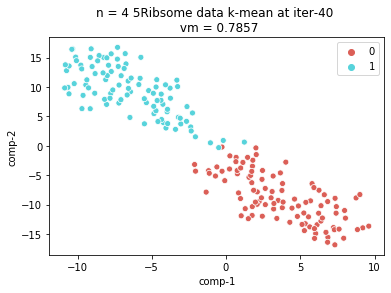

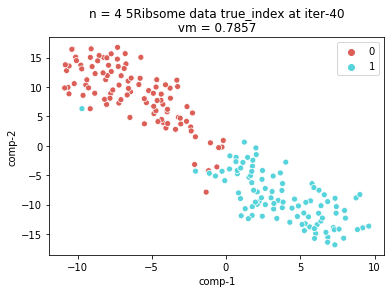

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.405949115753174 sec
0 batch 41 iteration
generated


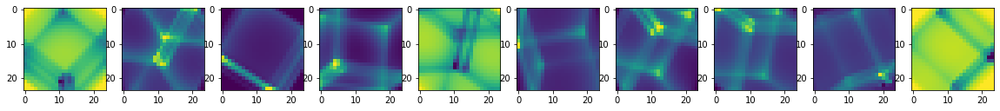

real


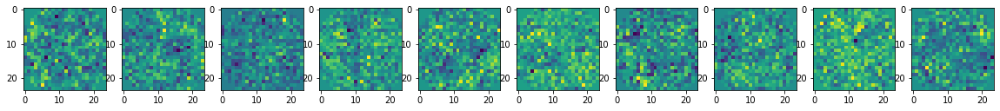

5.322854518890381 sec
0 batch 42 iteration
generated


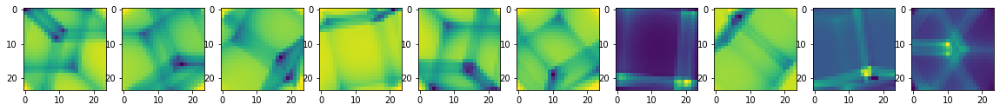

real


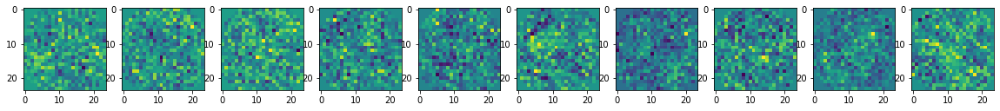

5.9141762256622314 sec
0 batch 43 iteration
generated


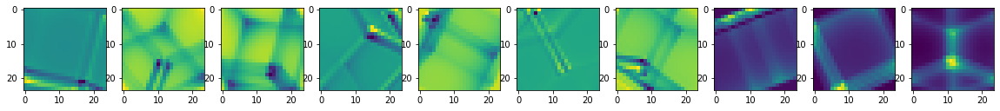

real


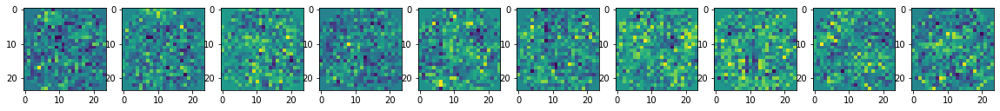

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.008s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.014518
[t-SNE] KL divergence after 250 iterations with early exaggeration: 57.134312
[t-SNE] KL divergence after 750 iterations: 0.316308
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


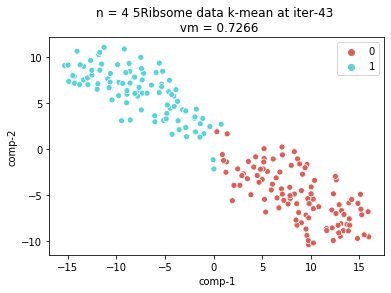

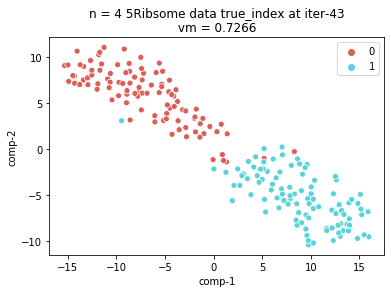

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


6.024854421615601 sec
0 batch 44 iteration
generated


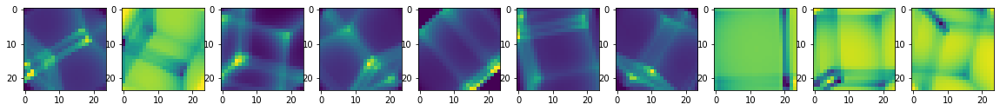

real


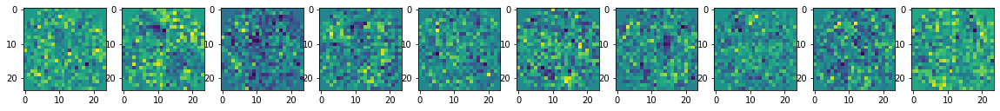

5.432693958282471 sec
0 batch 45 iteration
generated


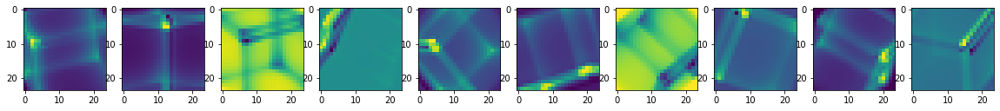

real


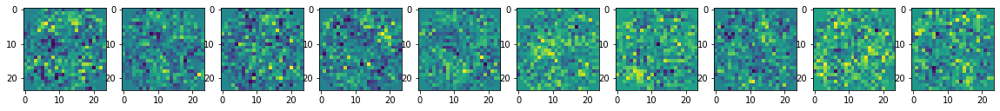

6.1011128425598145 sec
0 batch 46 iteration
generated


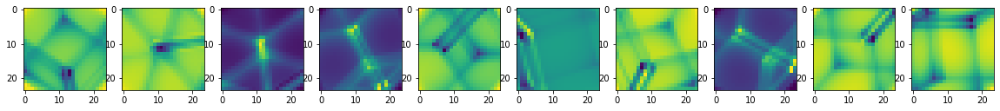

real


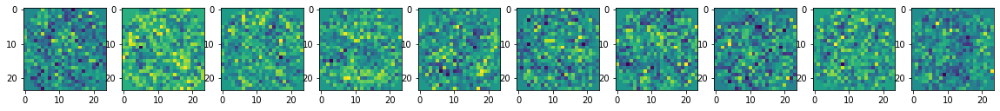

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.014136
[t-SNE] KL divergence after 250 iterations with early exaggeration: 54.828369
[t-SNE] KL divergence after 800 iterations: 0.317469
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


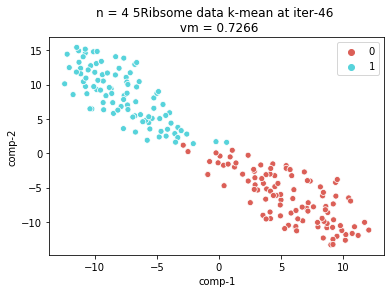

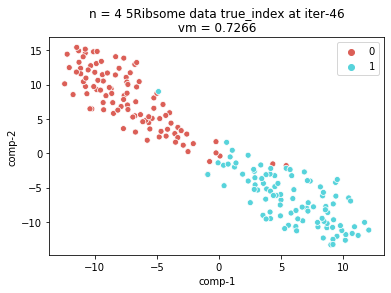

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.436896562576294 sec
0 batch 47 iteration
generated


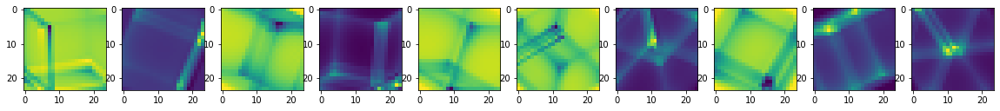

real


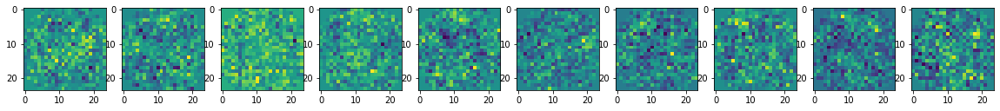

5.619224786758423 sec
0 batch 48 iteration
generated


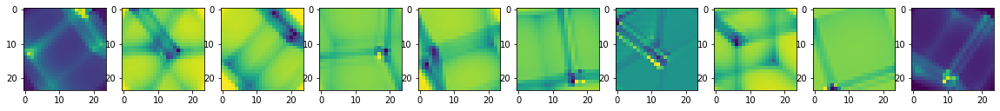

real


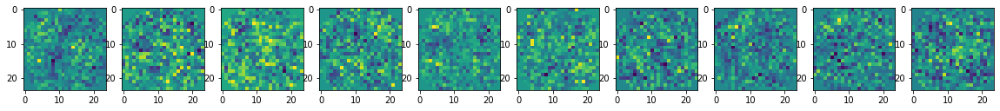

5.736682176589966 sec
0 batch 49 iteration
generated


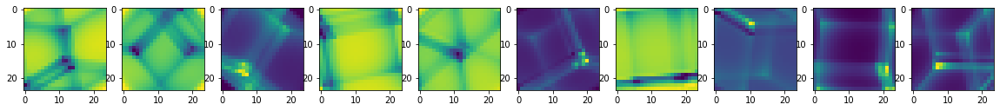

real


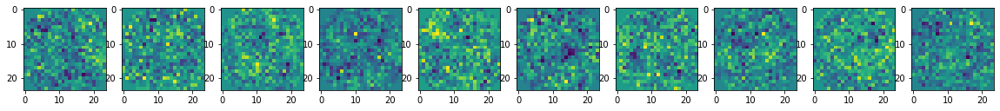

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.007s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.013688
[t-SNE] KL divergence after 250 iterations with early exaggeration: 55.063309
[t-SNE] KL divergence after 700 iterations: 0.339254
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 30])


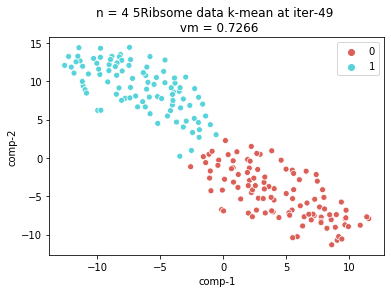

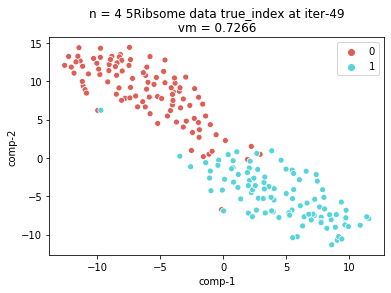

Exception: Unable to initialize Projector3D.

In [13]:
MP3.fit(0.01, True)


output_collection 0-th batch


/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


output_collection 1-th batch
output_collection 2-th batch
output_collection 3-th batch
output_collection 4-th batch
output_collection 5-th batch
output_collection 6-th batch
output_collection 7-th batch
output_collection 8-th batch
output_collection 9-th batch
output_collection 10-th batch
output_collection 11-th batch
output_collection 12-th batch
output_collection 13-th batch
output_collection 14-th batch
output_collection 15-th batch
output_collection 16-th batch
output_collection 17-th batch
output_collection 18-th batch
output_collection 19-th batch
output_collection 20-th batch
output_collection 21-th batch
output_collection 22-th batch
output_collection 23-th batch
output_collection 24-th batch
output_collection 25-th batch
output_collection 26-th batch
output_collection 27-th batch
output_collection 28-th batch
output_collection 29-th batch
output_collection 30-th batch
output_collection 31-th batch
output_collection 32-th batch
output_collection 33-th batch
output_collection 3

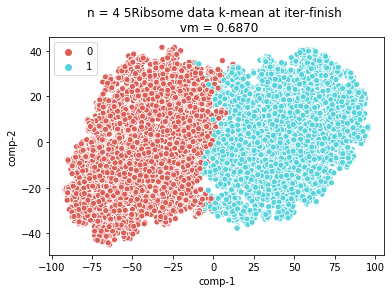

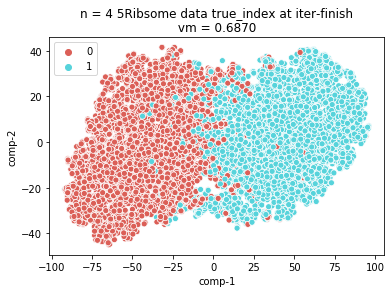

In [14]:
MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)

indexs [1 0 0 1 0 1 1 1 0 0]
(10000, 34, 34)


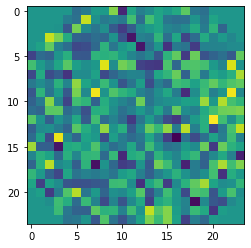

(10000, 24, 24)


/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.763259172439575 sec
0 batch 1 iteration
generated


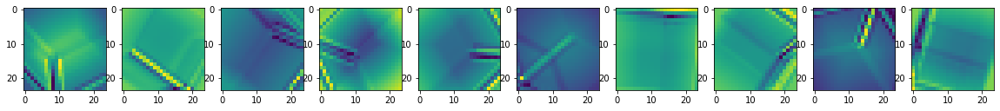

real


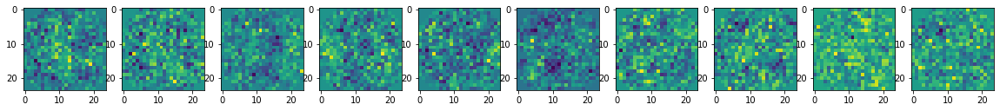

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.004s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.051135
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.034866
[t-SNE] KL divergence after 1000 iterations: 0.120724
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 2])


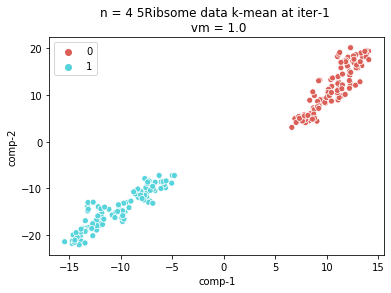

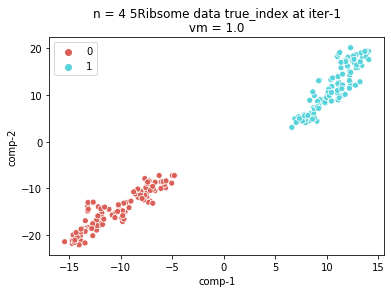

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.92119836807251 sec
0 batch 2 iteration
generated


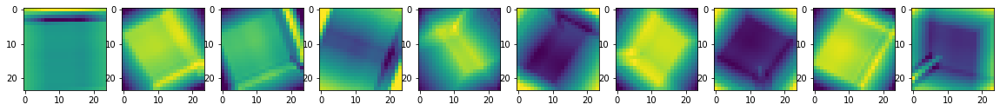

real


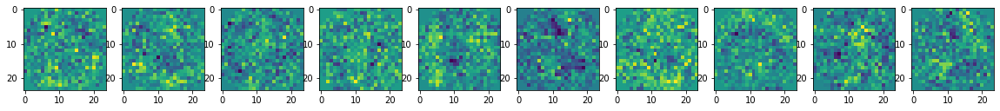

5.722684144973755 sec
0 batch 3 iteration
generated


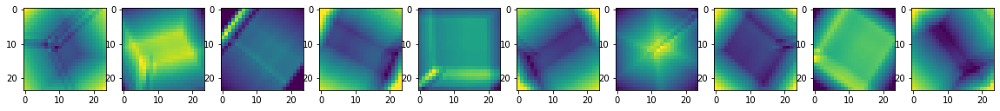

real


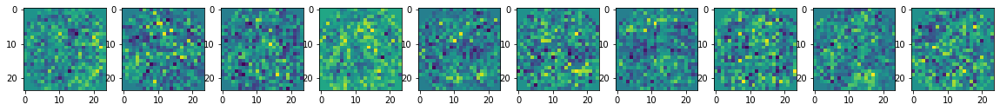

5.753945827484131 sec
0 batch 4 iteration
generated


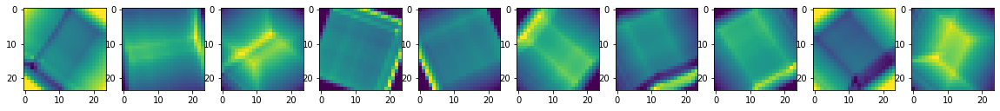

real


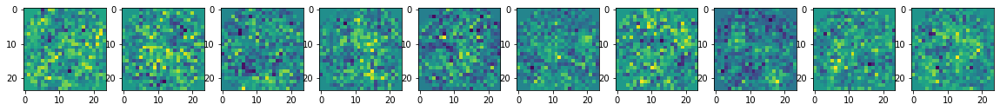

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.038026
[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.520981
[t-SNE] KL divergence after 1000 iterations: 0.132731
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 2])


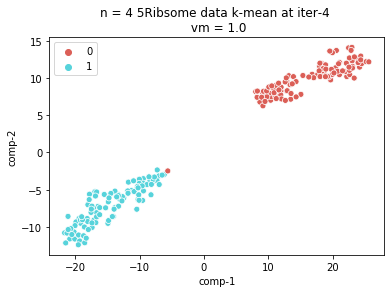

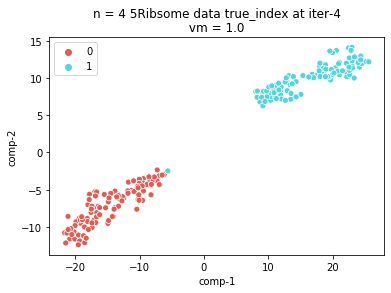

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


6.18925666809082 sec
0 batch 5 iteration
generated


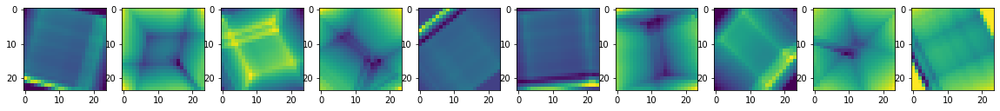

real


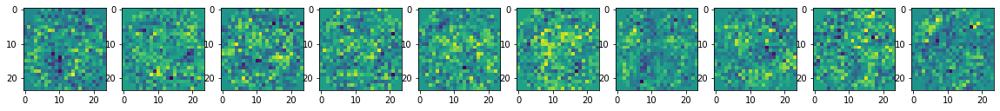

the 0 th iter, ratio = 0.1
output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.003s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.034140
[t-SNE] KL divergence after 250 iterations with early exaggeration: 50.824291
[t-SNE] KL divergence after 1000 iterations: 0.124945
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 2])


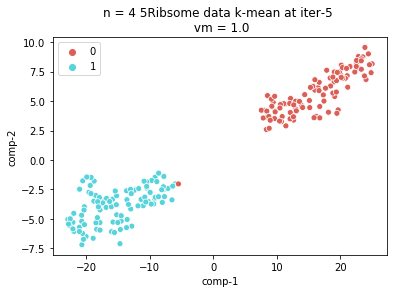

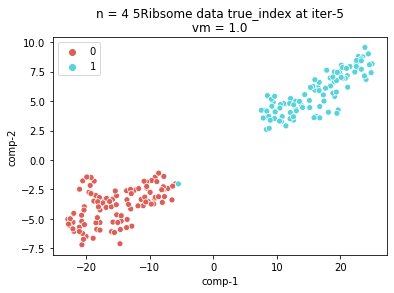

output_collection 0-th batch


/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


output_collection 1-th batch
output_collection 2-th batch
output_collection 3-th batch
output_collection 4-th batch
output_collection 5-th batch
output_collection 6-th batch
output_collection 7-th batch
output_collection 8-th batch
output_collection 9-th batch
output_collection 10-th batch
output_collection 11-th batch
output_collection 12-th batch
output_collection 13-th batch
output_collection 14-th batch
output_collection 15-th batch
output_collection 16-th batch
output_collection 17-th batch
output_collection 18-th batch
output_collection 19-th batch
output_collection 20-th batch
output_collection 21-th batch
output_collection 22-th batch
output_collection 23-th batch
output_collection 24-th batch
output_collection 25-th batch
output_collection 26-th batch
output_collection 27-th batch
output_collection 28-th batch
output_collection 29-th batch
output_collection 30-th batch
output_collection 31-th batch
output_collection 32-th batch
output_collection 33-th batch
output_collection 3

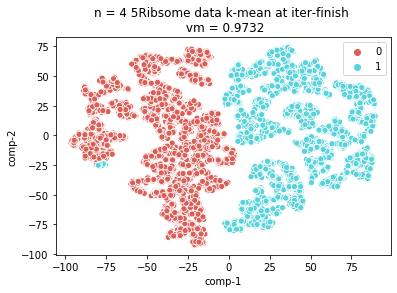

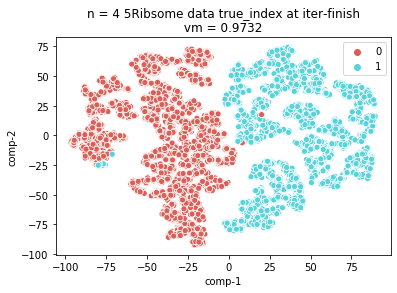

In [7]:
#snr_list = [10, 5, 1, 0.8, 0.6, 0.4, 0.2, 0.1]
snr = 0.6
data_name = f'70s_2class_0304+{snr}'
with open(f'./data/{data_name}/images.pkl', 'rb') as f:
    new_projection = pickle.load( f)

with open(f'./data/{data_name}/angles.pkl', 'rb') as f:
    angles2 = pickle.load( f)

with open(f'./data/{data_name}/orientation_matrix.pkl', 'rb') as f:
    Orientation_Vectors = pickle.load(f)

with open(f'./data/{data_name}/indexs.pkl', 'rb') as f:
    indexs = pickle.load(f)
print('indexs',indexs[:10])     
with open(f'./data/{data_name}/mean_subtracted_strcut.pkl', 'rb') as f:
    mean_subtracted_strcut = pickle.load(f)
    
new_projection = new_projection * mask
print(new_projection.shape)
new_projection = new_projection[:,5:29,5:29]
plt.imshow(new_projection[0])
plt.show()
n = 4
b = 200
niter = 5
pca_n = 2
Images = new_projection#[:5000]
print(Images.shape)
exp_name = f'20220320_{data_name}_EM_2SDR_n_{n}'
ProjSize, num_image, n_component , num_iter = 24, Images.shape[0], n, niter
batch_size = b
Vol_geom = astra.create_vol_geom(ProjSize, ProjSize, ProjSize)
#Images = torch.ones(num_image, 48, 48) # fake images for computing purpose

vg = ts.from_astra(Vol_geom)
pg = ts.from_astra(Proj_geom)
op = ts.operator(vg, pg)
MP3 = EM_2SDR(ProjSize, num_image, n_component, op , Images,Orientation_Vectors, exp_name,mean_subtracted_strcut, indexs, batch_size, niter, PCA_n= pca_n)
MP3.fit(0.1, True)
MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)

indexs [1 0 0 1 0 1 1 1 0 0]
(10000, 34, 34)


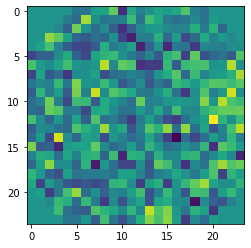

(10000, 24, 24)


/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/models.py:77: UserWarning: torch.qr is deprecated in favor of torch.linalg.qr and will be removed in a future PyTorch release.
The boolean parameter 'some' has been replaced with a string parameter 'mode'.
Q, R = torch.qr(A, some)
should be replaced with
Q, R = torch.linalg.qr(A, 'reduced' if some else 'complete') (Triggered internally at  /opt/conda/conda-bld/pytorch_1634272097173/work/aten/src/ATen/native/BatchLinearAlgebra.cpp:1937.)
  self.U1.data = torch.qr(self.U1.data)[0]
/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


6.063234806060791 sec
0 batch 1 iteration
generated


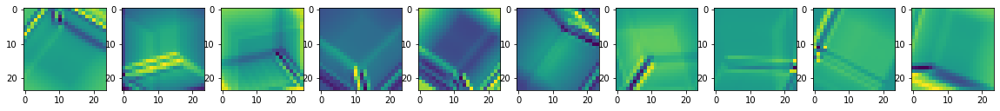

real


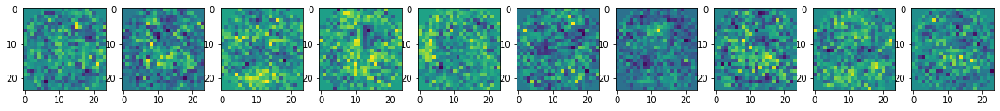

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.075922
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.418980
[t-SNE] KL divergence after 1000 iterations: 0.115405
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 2])


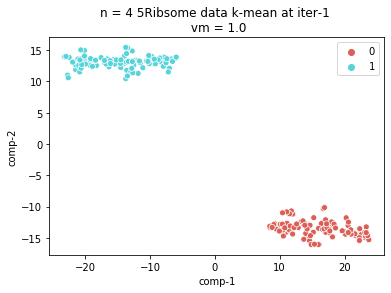

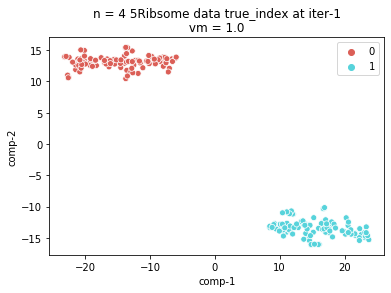

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.9363319873809814 sec
0 batch 2 iteration
generated


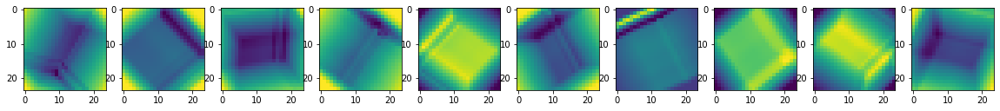

real


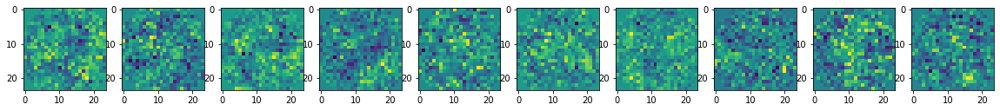

6.3342461585998535 sec
0 batch 3 iteration
generated


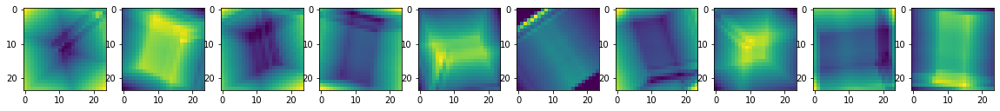

real


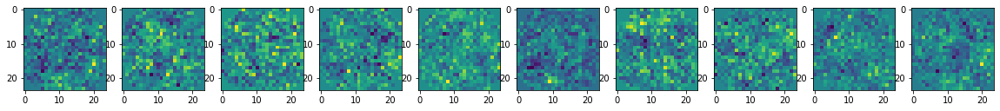

6.002986192703247 sec
0 batch 4 iteration
generated


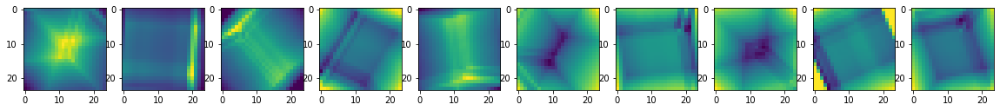

real


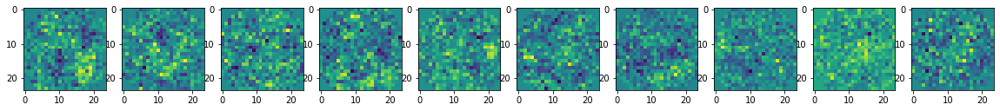

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.004s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.053929
[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.899200
[t-SNE] KL divergence after 1000 iterations: 0.149111
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 2])


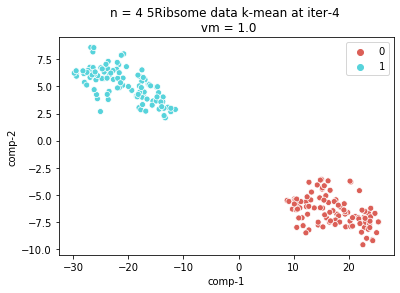

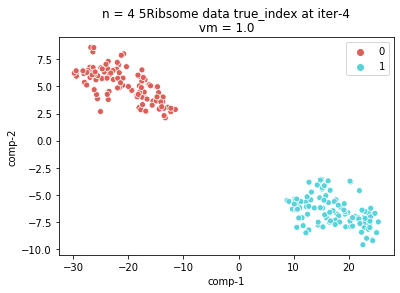

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


5.530581712722778 sec
0 batch 5 iteration
generated


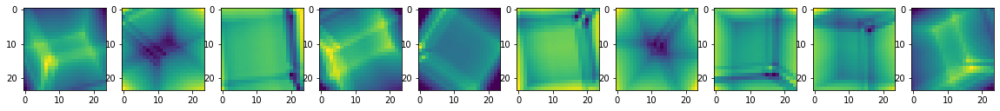

real


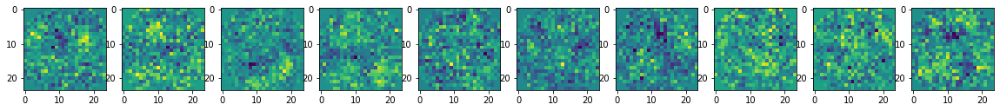

the 0 th iter, ratio = 0.1
output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.004s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.052438
[t-SNE] KL divergence after 250 iterations with early exaggeration: 50.623726
[t-SNE] KL divergence after 1000 iterations: 0.168127
self.All_U_kron_shape torch.Size([13824, 64])
self.PCs.shape torch.Size([64, 2])


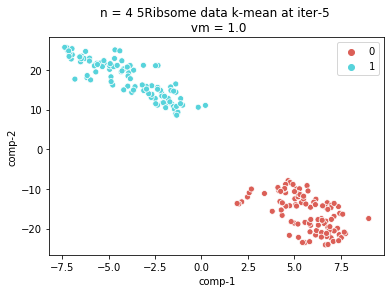

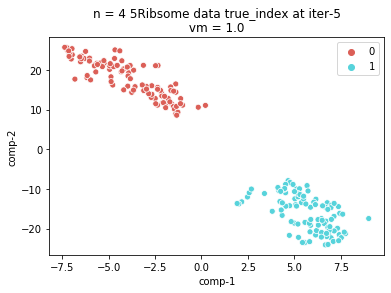

output_collection 0-th batch


/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


output_collection 1-th batch
output_collection 2-th batch
output_collection 3-th batch
output_collection 4-th batch
output_collection 5-th batch
output_collection 6-th batch
output_collection 7-th batch
output_collection 8-th batch
output_collection 9-th batch
output_collection 10-th batch
output_collection 11-th batch
output_collection 12-th batch
output_collection 13-th batch
output_collection 14-th batch
output_collection 15-th batch
output_collection 16-th batch
output_collection 17-th batch
output_collection 18-th batch
output_collection 19-th batch
output_collection 20-th batch
output_collection 21-th batch
output_collection 22-th batch
output_collection 23-th batch
output_collection 24-th batch
output_collection 25-th batch
output_collection 26-th batch
output_collection 27-th batch
output_collection 28-th batch
output_collection 29-th batch
output_collection 30-th batch
output_collection 31-th batch
output_collection 32-th batch
output_collection 33-th batch
output_collection 3

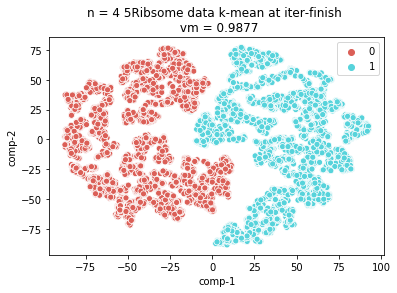

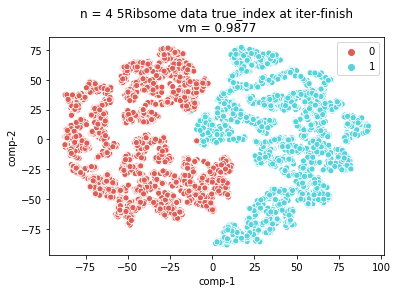

In [6]:
#snr_list = [10, 5, 1, 0.8, 0.6, 0.4, 0.2, 0.1]
snr = 0.8
data_name = f'70s_2class_0304+{snr}'
with open(f'./data/{data_name}/images.pkl', 'rb') as f:
    new_projection = pickle.load( f)

with open(f'./data/{data_name}/angles.pkl', 'rb') as f:
    angles2 = pickle.load( f)

with open(f'./data/{data_name}/orientation_matrix.pkl', 'rb') as f:
    Orientation_Vectors = pickle.load(f)

with open(f'./data/{data_name}/indexs.pkl', 'rb') as f:
    indexs = pickle.load(f)
print('indexs',indexs[:10])     
with open(f'./data/{data_name}/mean_subtracted_strcut.pkl', 'rb') as f:
    mean_subtracted_strcut = pickle.load(f)
    
new_projection = new_projection * mask
print(new_projection.shape)
new_projection = new_projection[:,5:29,5:29]
plt.imshow(new_projection[0])
plt.show()
n = 4
b = 200
niter = 5
pca_n = 2
Images = new_projection#[:5000]
print(Images.shape)
exp_name = f'20220320_{data_name}_EM_2SDR_n_{n}'
ProjSize, num_image, n_component , num_iter = 24, Images.shape[0], n, niter
batch_size = b
Vol_geom = astra.create_vol_geom(ProjSize, ProjSize, ProjSize)
#Images = torch.ones(num_image, 48, 48) # fake images for computing purpose

vg = ts.from_astra(Vol_geom)
pg = ts.from_astra(Proj_geom)
op = ts.operator(vg, pg)
MP3 = EM_2SDR(ProjSize, num_image, n_component, op , Images,Orientation_Vectors, exp_name,mean_subtracted_strcut, indexs, batch_size, niter, PCA_n= pca_n)
MP3.fit(0.1, True)
MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)

output_collection 0-th batch


/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


output_collection 1-th batch
output_collection 2-th batch
output_collection 3-th batch
output_collection 4-th batch
output_collection 5-th batch
output_collection 6-th batch
output_collection 7-th batch
output_collection 8-th batch
output_collection 9-th batch
output_collection 10-th batch
output_collection 11-th batch
output_collection 12-th batch
output_collection 13-th batch
output_collection 14-th batch
output_collection 15-th batch
output_collection 16-th batch
output_collection 17-th batch
output_collection 18-th batch
output_collection 19-th batch
output_collection 20-th batch
output_collection 21-th batch
output_collection 22-th batch
output_collection 23-th batch
output_collection 24-th batch
output_collection 25-th batch
output_collection 26-th batch
output_collection 27-th batch
output_collection 28-th batch
output_collection 29-th batch
output_collection 30-th batch
output_collection 31-th batch
output_collection 32-th batch
output_collection 33-th batch
output_collection 3

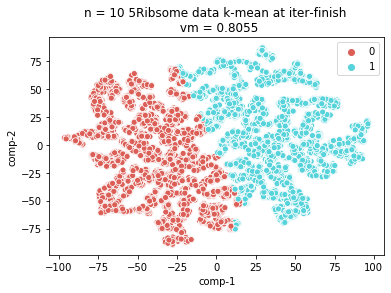

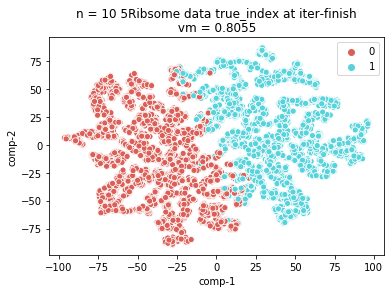

In [15]:
MP3.Draw_Kmean_tsne('finish',num_batch = 50, pca_n = 2)

In [11]:
MP3.PCA_n

2

indexs [1 0 0 1 0 1 1 1 0 0]
(10000, 34, 34)


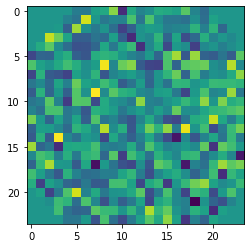

(10000, 24, 24)


/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


1111.0289838314056 sec
0 batch 1 iteration
generated


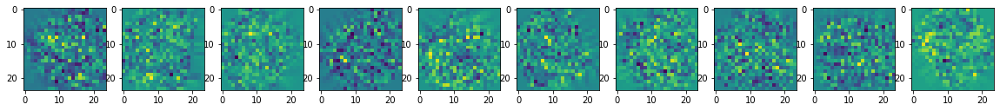

real


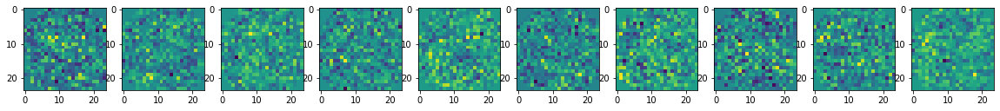

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.042s...
[t-SNE] Computed neighbors for 200 samples in 0.014s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 2.694559
[t-SNE] KL divergence after 250 iterations with early exaggeration: 58.855431
[t-SNE] KL divergence after 850 iterations: 0.549787
self.All_U_kron_shape torch.Size([13824, 8000])
self.PCs.shape torch.Size([8000, 5])
self.ori_var_each 0.0
self.projected_var_each 0.0


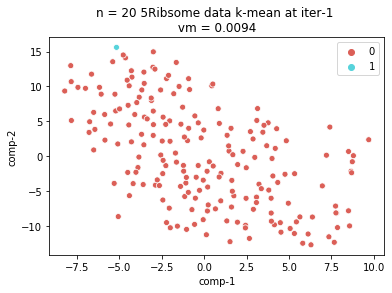

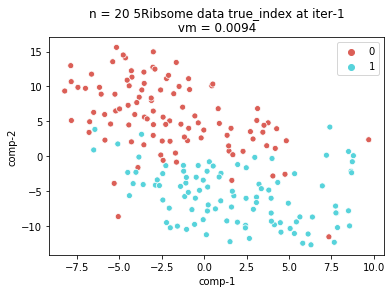

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


1042.9936780929565 sec
0 batch 2 iteration
generated


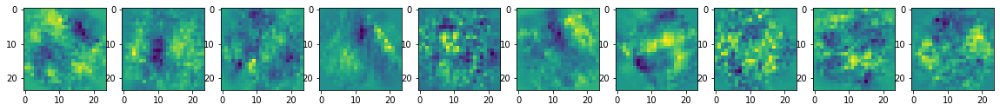

real


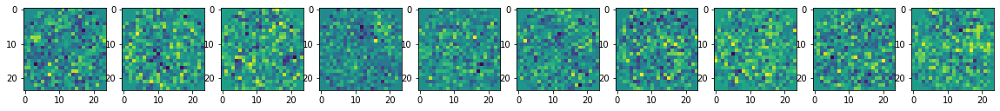

1039.7570304870605 sec
0 batch 3 iteration
generated


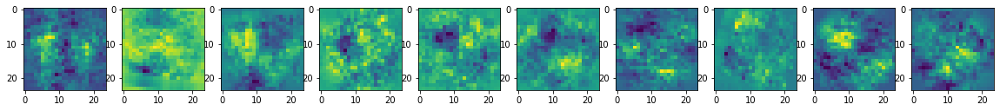

real


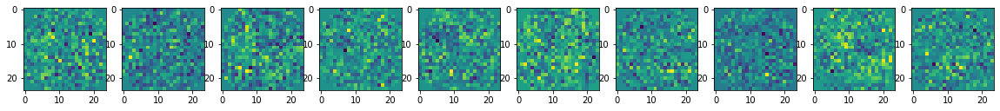

1089.7246580123901 sec
0 batch 4 iteration
generated


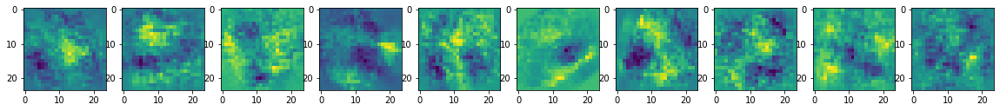

real


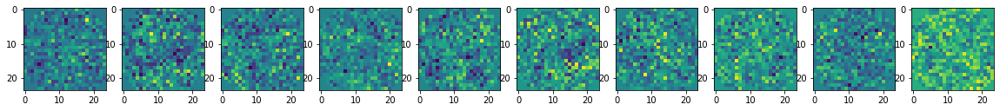

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.045865
[t-SNE] KL divergence after 250 iterations with early exaggeration: 61.379692
[t-SNE] KL divergence after 1000 iterations: 0.599570
self.All_U_kron_shape torch.Size([13824, 8000])
self.PCs.shape torch.Size([8000, 5])
self.ori_var_each 0.0
self.projected_var_each 0.0


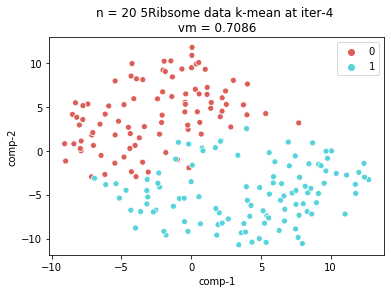

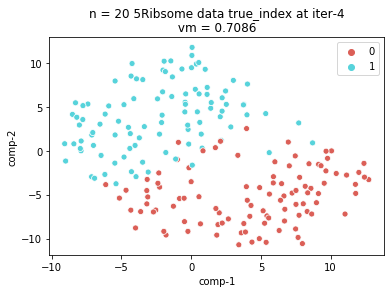

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


1051.5606093406677 sec
0 batch 5 iteration
generated


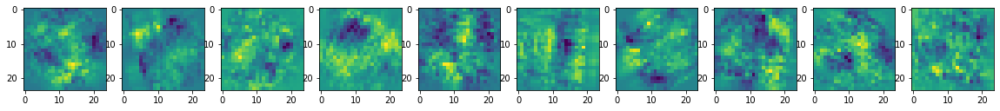

real


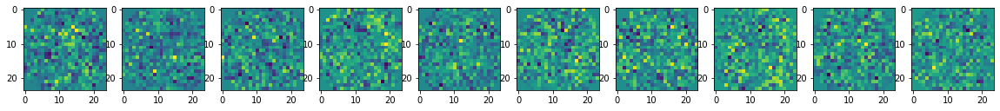

1131.4867758750916 sec
0 batch 6 iteration
generated


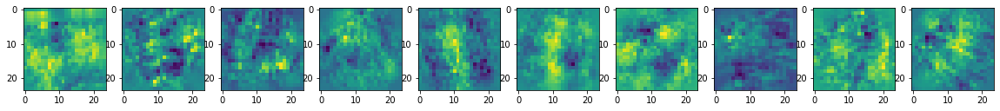

real


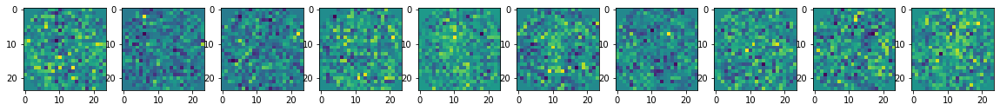

1053.5004587173462 sec
0 batch 7 iteration
generated


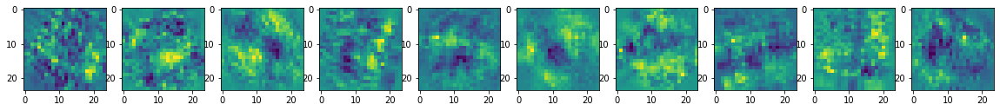

real


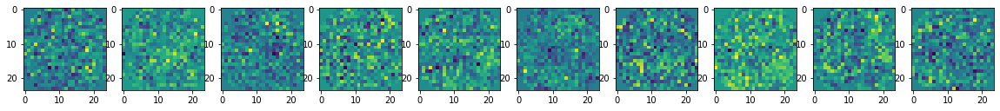

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.008s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.039041
[t-SNE] KL divergence after 250 iterations with early exaggeration: 61.962170
[t-SNE] KL divergence after 1000 iterations: 0.571179
self.All_U_kron_shape torch.Size([13824, 8000])
self.PCs.shape torch.Size([8000, 5])
self.ori_var_each 0.0
self.projected_var_each 0.0


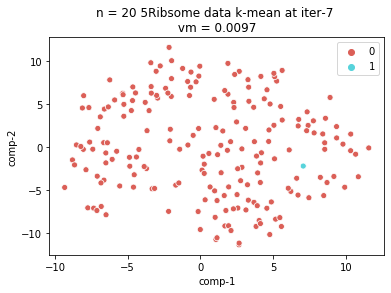

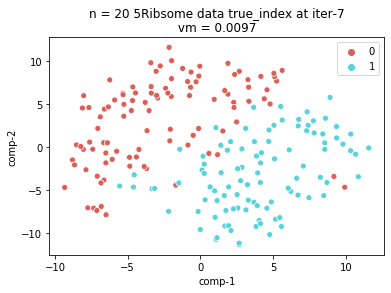

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


1059.636813879013 sec
0 batch 8 iteration
generated


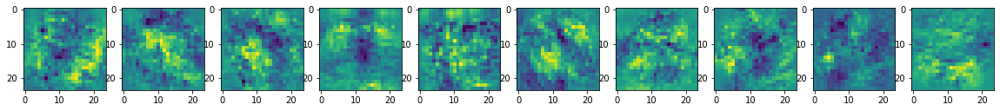

real


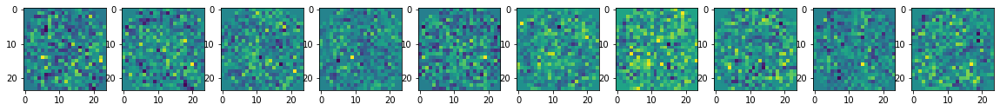

1065.900072813034 sec
0 batch 9 iteration
generated


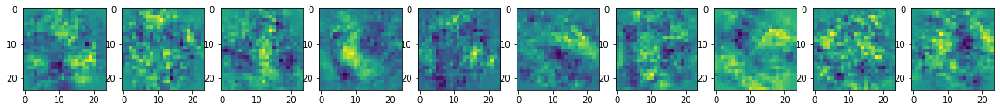

real


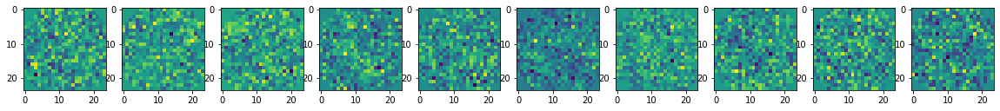

1046.4068267345428 sec
0 batch 10 iteration
generated


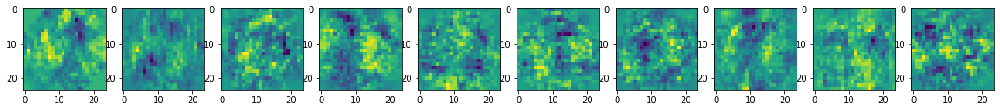

real


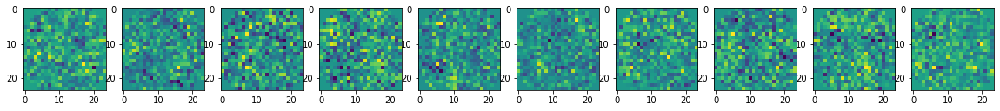

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.000s...
[t-SNE] Computed neighbors for 200 samples in 0.007s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.032346
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.806160
[t-SNE] KL divergence after 1000 iterations: 0.724526
self.All_U_kron_shape torch.Size([13824, 8000])
self.PCs.shape torch.Size([8000, 5])
self.ori_var_each 0.0
self.projected_var_each 0.0


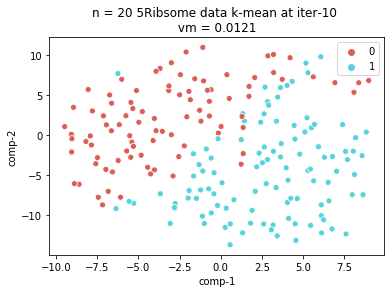

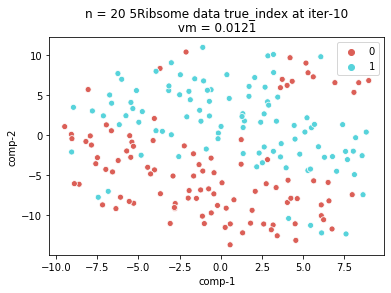

the 0 th iter, ratio = 0.1
output_collection 0-th batch


/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.001s...
[t-SNE] Computed neighbors for 200 samples in 0.010s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.032346
[t-SNE] KL divergence after 250 iterations with early exaggeration: 60.601265
[t-SNE] KL divergence after 1000 iterations: 0.740587
self.All_U_kron_shape torch.Size([13824, 8000])
self.PCs.shape torch.Size([8000, 5])
self.ori_var_each 0.0
self.projected_var_each 0.0


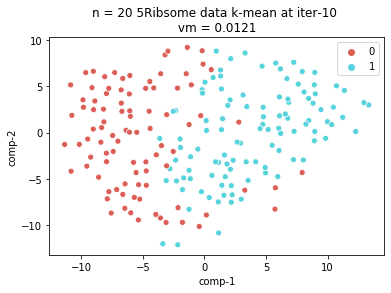

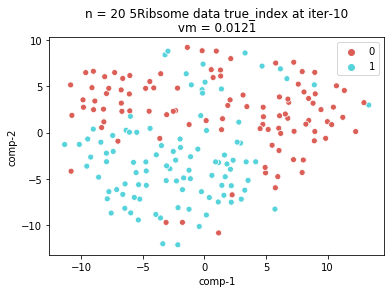

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


1029.9575290679932 sec
1 batch 1 iteration
generated


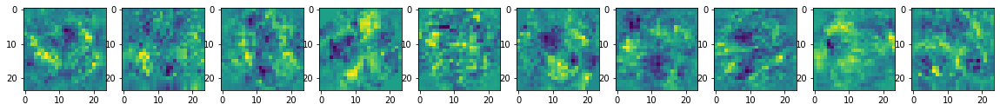

real


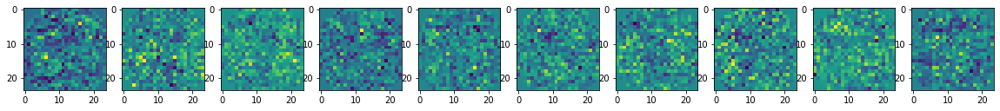

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 200 samples in 0.002s...
[t-SNE] Computed neighbors for 200 samples in 0.017s...
[t-SNE] Computed conditional probabilities for sample 200 / 200
[t-SNE] Mean sigma: 0.031281
[t-SNE] KL divergence after 250 iterations with early exaggeration: 61.834423
[t-SNE] KL divergence after 1000 iterations: 0.860654
self.All_U_kron_shape torch.Size([13824, 8000])
self.PCs.shape torch.Size([8000, 5])
self.ori_var_each 0.0
self.projected_var_each 0.0


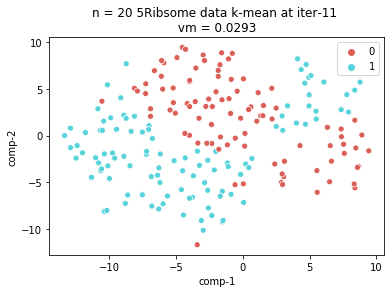

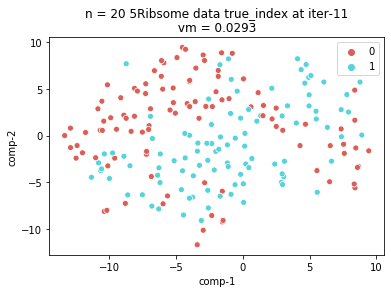

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


1005.4879429340363 sec
1 batch 2 iteration
generated


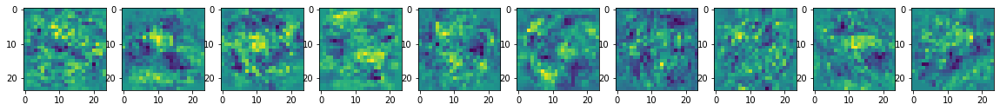

real


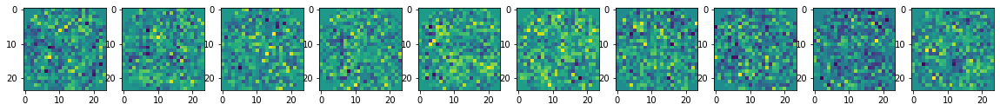

1008.4699468612671 sec
1 batch 3 iteration
generated


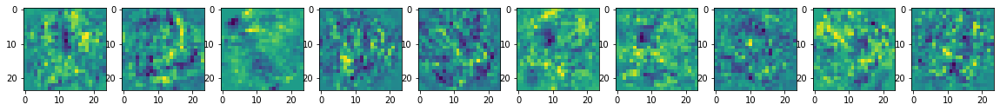

real


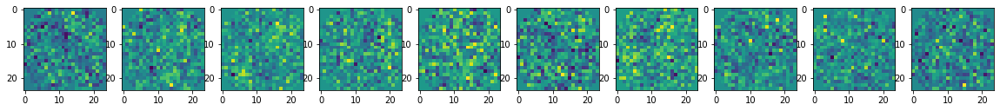

KeyboardInterrupt: 

In [12]:
#snr_list = [10, 5, 1, 0.8, 0.6, 0.4, 0.2, 0.1]
snr = 0.2
data_name = f'70s_2class_0304+{snr}'
with open(f'./data/{data_name}/images.pkl', 'rb') as f:
    new_projection = pickle.load( f)

with open(f'./data/{data_name}/angles.pkl', 'rb') as f:
    angles2 = pickle.load( f)

with open(f'./data/{data_name}/orientation_matrix.pkl', 'rb') as f:
    Orientation_Vectors = pickle.load(f)

with open(f'./data/{data_name}/indexs.pkl', 'rb') as f:
    indexs = pickle.load(f)
print('indexs',indexs[:10])     
with open(f'./data/{data_name}/mean_subtracted_strcut.pkl', 'rb') as f:
    mean_subtracted_strcut = pickle.load(f)
    
new_projection = new_projection * mask
print(new_projection.shape)
new_projection = new_projection[:,5:29,5:29]
plt.imshow(new_projection[0])
plt.show()
n = 20
b = 200
niter = 10
pca_n = 5
Images = new_projection#[:5000]
print(Images.shape)
exp_name = f'20220318_{data_name}_EM_2SDR_n_{n}'
ProjSize, num_image, n_component , num_iter = 24, Images.shape[0], n, niter
batch_size = b
Vol_geom = astra.create_vol_geom(24, 24, 24)
#Images = torch.ones(num_image, 48, 48) # fake images for computing purpose

vg = ts.from_astra(Vol_geom)
pg = ts.from_astra(Proj_geom)
op = ts.operator(vg, pg)
MP3 = EM_2SDR(ProjSize, num_image, n_component, op , Images,Orientation_Vectors, exp_name,mean_subtracted_strcut, indexs, batch_size, niter, PCA_n= pca_n)
MP3.fit(0.1, True)

In [ ]:
MP3.fit(0.1, True)

indexs [1 0 0 1 0 1 1 1 0 0]
(10000, 34, 34)


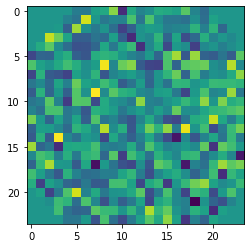

(10000, 24, 24)


/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/models.py:77: UserWarning: torch.qr is deprecated in favor of torch.linalg.qr and will be removed in a future PyTorch release.
The boolean parameter 'some' has been replaced with a string parameter 'mode'.
Q, R = torch.qr(A, some)
should be replaced with
Q, R = torch.linalg.qr(A, 'reduced' if some else 'complete') (Triggered internally at  /opt/conda/conda-bld/pytorch_1634272097173/work/aten/src/ATen/native/BatchLinearAlgebra.cpp:1937.)
  self.U1.data = torch.qr(self.U1.data)[0]
/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


1.913093090057373 sec
0 batch 1 iteration
generated


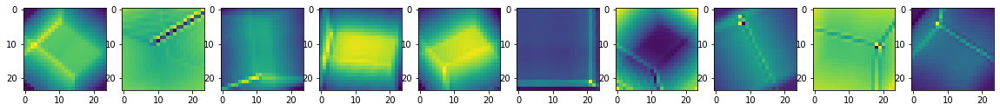

real


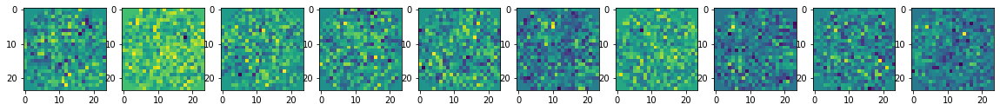

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 300 samples in 0.001s...
[t-SNE] Computed neighbors for 300 samples in 0.006s...
[t-SNE] Computed conditional probabilities for sample 300 / 300
[t-SNE] Mean sigma: 0.009988
[t-SNE] KL divergence after 250 iterations with early exaggeration: 49.851501
[t-SNE] KL divergence after 1000 iterations: 0.155680
self.All_U_kron_shape torch.Size([13824, 8])
self.PCs.shape torch.Size([8, 5])
self.ori_var_each 0.0
self.projected_var_each 0.0


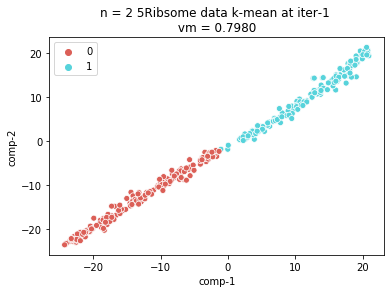

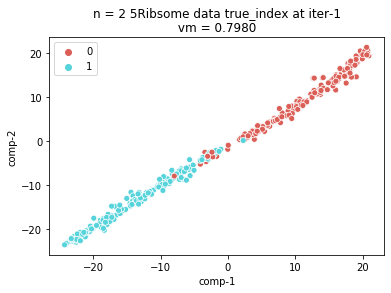

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


1.7088074684143066 sec
0 batch 2 iteration
generated


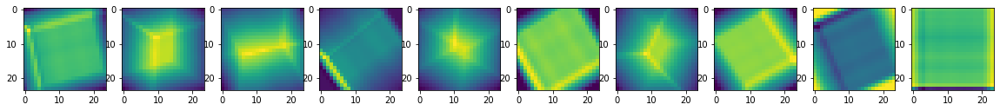

real


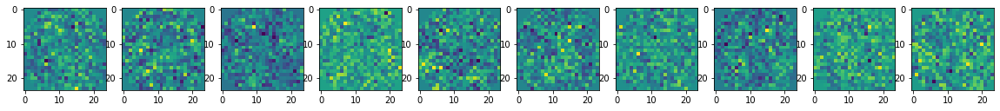

1.680882453918457 sec
0 batch 3 iteration
generated


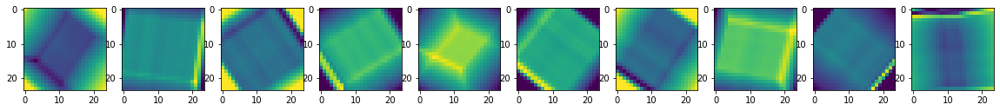

real


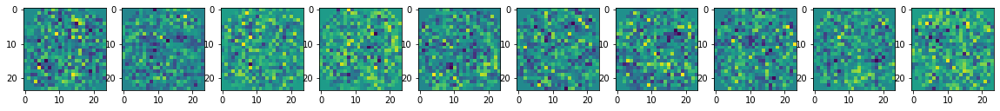

1.8391354084014893 sec
0 batch 4 iteration
generated


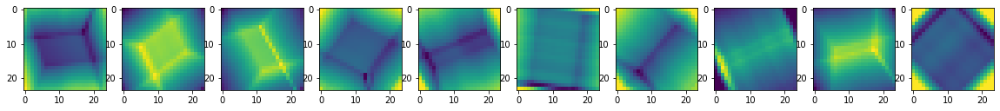

real


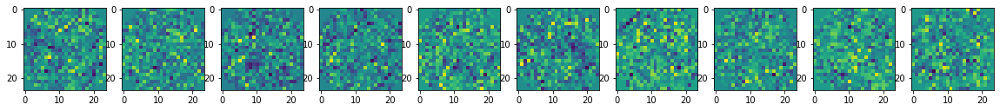

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 300 samples in 0.000s...
[t-SNE] Computed neighbors for 300 samples in 0.004s...
[t-SNE] Computed conditional probabilities for sample 300 / 300
[t-SNE] Mean sigma: 0.008321
[t-SNE] KL divergence after 250 iterations with early exaggeration: 50.961864
[t-SNE] KL divergence after 1000 iterations: 0.156697
self.All_U_kron_shape torch.Size([13824, 8])
self.PCs.shape torch.Size([8, 5])
self.ori_var_each 0.0
self.projected_var_each 0.0


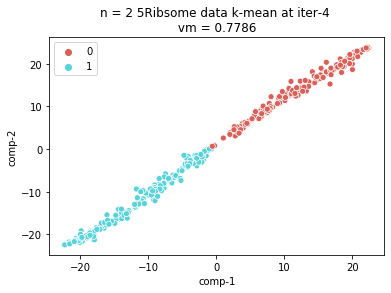

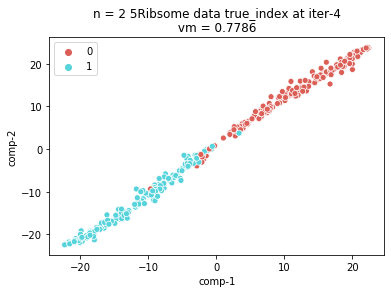

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


1.513195276260376 sec
0 batch 5 iteration
generated


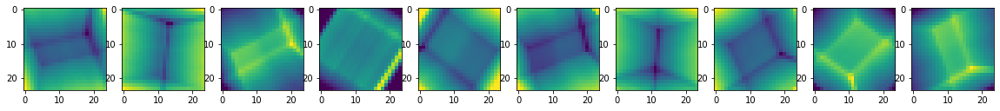

real


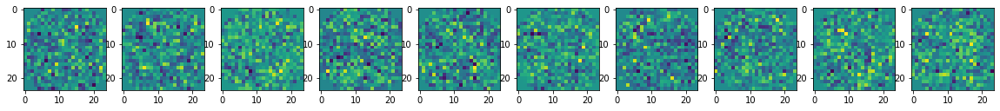

1.715219259262085 sec
0 batch 6 iteration
generated


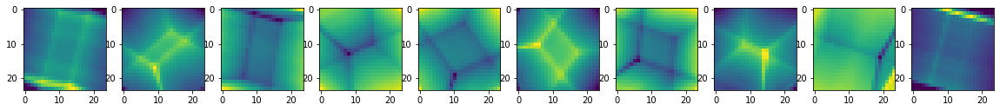

real


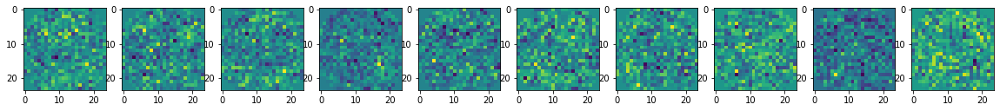

1.7339389324188232 sec
0 batch 7 iteration
generated


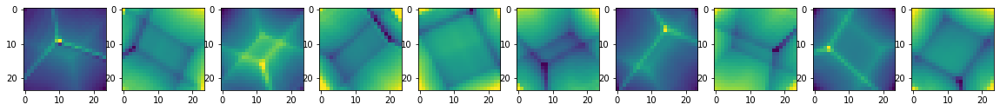

real


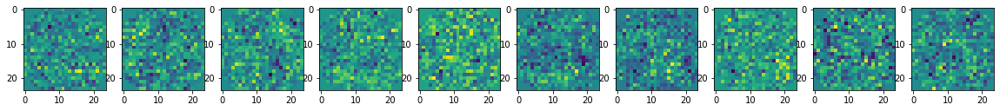

output_collection 0-th batch
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 300 samples in 0.000s...
[t-SNE] Computed neighbors for 300 samples in 0.006s...
[t-SNE] Computed conditional probabilities for sample 300 / 300
[t-SNE] Mean sigma: 0.006805
[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.802353
[t-SNE] KL divergence after 1000 iterations: 0.162152
self.All_U_kron_shape torch.Size([13824, 8])
self.PCs.shape torch.Size([8, 5])
self.ori_var_each 0.0
self.projected_var_each 0.0


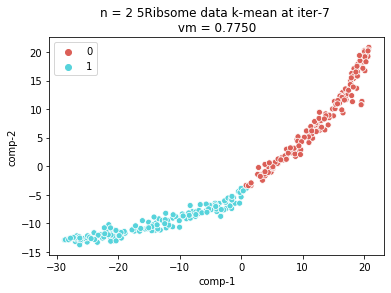

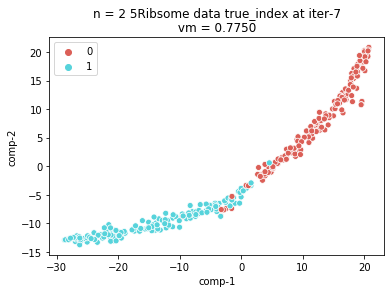

/home/users/lewis841214/Desktop/1project/CryoEMCode/GPU_CryoEM/tomosipo_structureed/tomosipo/links/torch.py:64: UserWarning: The parameter initial_value should be contiguous. It has been automatically made contiguous. Use `ts.link(x.contiguous())' to inhibit this warning. 
  f"The parameter initial_value should be contiguous. "


KeyboardInterrupt: 

In [20]:
#snr_list = [10, 5, 1, 0.8, 0.6, 0.4, 0.2, 0.1]
snr = 0.2
data_name = f'70s_2class_0304+{snr}'
with open(f'./data/{data_name}/images.pkl', 'rb') as f:
    new_projection = pickle.load( f)

with open(f'./data/{data_name}/angles.pkl', 'rb') as f:
    angles2 = pickle.load( f)

with open(f'./data/{data_name}/orientation_matrix.pkl', 'rb') as f:
    Orientation_Vectors = pickle.load(f)

with open(f'./data/{data_name}/indexs.pkl', 'rb') as f:
    indexs = pickle.load(f)
print('indexs',indexs[:10])     
with open(f'./data/{data_name}/mean_subtracted_strcut.pkl', 'rb') as f:
    mean_subtracted_strcut = pickle.load(f)
    
new_projection = new_projection * mask
print(new_projection.shape)
new_projection = new_projection[:,5:29,5:29]
plt.imshow(new_projection[0])
plt.show()
n = 20
b = 300
niter = 10
pca_n = 5
Images = new_projection#[:5000]
print(Images.shape)
exp_name = f'20220318_{data_name}_EM_2SDR_n_{n}'
ProjSize, num_image, n_component , num_iter = 24, Images.shape[0], n, niter
batch_size = b
Vol_geom = astra.create_vol_geom(24, 24, 24)
#Images = torch.ones(num_image, 48, 48) # fake images for computing purpose

vg = ts.from_astra(Vol_geom)
pg = ts.from_astra(Proj_geom)
op = ts.operator(vg, pg)
MP3 = EM_2SDR(ProjSize, num_image, n_component, op , Images,Orientation_Vectors, exp_name,mean_subtracted_strcut, indexs, batch_size, niter, PCA_n= pca_n)
MP3.fit(0.1, True)

In [ ]:
#snr_list = [10, 5, 1, 0.8, 0.6, 0.4, 0.2, 0.1]
snr = 5
data_name = f'70s_2class_0304+{snr}'
with open(f'./data/{data_name}/images.pkl', 'rb') as f:
    new_projection = pickle.load( f)

with open(f'./data/{data_name}/angles.pkl', 'rb') as f:
    angles2 = pickle.load( f)

with open(f'./data/{data_name}/orientation_matrix.pkl', 'rb') as f:
    Orientation_Vectors = pickle.load(f)

with open(f'./data/{data_name}/indexs.pkl', 'rb') as f:
    indexs = pickle.load(f)
print('indexs',indexs[:10])     
with open(f'./data/{data_name}/mean_subtracted_strcut.pkl', 'rb') as f:
    mean_subtracted_strcut = pickle.load(f)
n = 5
b = 400
niter = 10
pca_n = 2
Images = new_projection[:5000]
print(Images.shape)
exp_name = f'20220303_{data_name}_EM_2SDR_n_{n}'
ProjSize, num_image, n_component , num_iter = 34, Images.shape[0], n, niter
batch_size = b
Vol_geom = astra.create_vol_geom(34, 34, 34)
#Images = torch.ones(num_image, 48, 48) # fake images for computing purpose

vg = ts.from_astra(Vol_geom)
pg = ts.from_astra(Proj_geom)
op = ts.operator(vg, pg)
MP3 = EM_2SDR(ProjSize, num_image, n_component, op , Images,Orientation_Vectors, exp_name,mean_subtracted_strcut, indexs, batch_size, niter, PCA_n= pca_n)
MP3.fit(0.1, True)

In [ ]:
#snr_list = [10, 5, 1, 0.8, 0.6, 0.4, 0.2, 0.1]
snr = 0.4
data_name = f'70s_2class_0304+{snr}'
with open(f'./data/{data_name}/images.pkl', 'rb') as f:
    new_projection = pickle.load( f)

with open(f'./data/{data_name}/angles.pkl', 'rb') as f:
    angles2 = pickle.load( f)

with open(f'./data/{data_name}/orientation_matrix.pkl', 'rb') as f:
    Orientation_Vectors = pickle.load(f)

with open(f'./data/{data_name}/indexs.pkl', 'rb') as f:
    indexs = pickle.load(f)
print('indexs',indexs[:10])     
with open(f'./data/{data_name}/mean_subtracted_strcut.pkl', 'rb') as f:
    mean_subtracted_strcut = pickle.load(f)
n = 10
b = 400
niter = 10
pca_n = 2
Images = new_projection[:5000]
print(Images.shape)
exp_name = f'20220303_{data_name}_EM_2SDR_n_{n}'
ProjSize, num_image, n_component , num_iter = 34, Images.shape[0], n, niter
batch_size = b
Vol_geom = astra.create_vol_geom(34, 34, 34)
#Images = torch.ones(num_image, 48, 48) # fake images for computing purpose

vg = ts.from_astra(Vol_geom)
pg = ts.from_astra(Proj_geom)
op = ts.operator(vg, pg)
MP3 = EM_2SDR(ProjSize, num_image, n_component, op , Images,Orientation_Vectors, exp_name,mean_subtracted_strcut, indexs, batch_size, niter, PCA_n= pca_n)
MP3.fit(0.1, True)

In [ ]:
#snr_list = [10, 5, 1, 0.8, 0.6, 0.4, 0.2, 0.1]
snr = 0.2
data_name = f'70s_2class_0304+{snr}'
with open(f'./data/{data_name}/images.pkl', 'rb') as f:
    new_projection = pickle.load( f)

with open(f'./data/{data_name}/angles.pkl', 'rb') as f:
    angles2 = pickle.load( f)

with open(f'./data/{data_name}/orientation_matrix.pkl', 'rb') as f:
    Orientation_Vectors = pickle.load(f)

with open(f'./data/{data_name}/indexs.pkl', 'rb') as f:
    indexs = pickle.load(f)
print('indexs',indexs[:10])     
with open(f'./data/{data_name}/mean_subtracted_strcut.pkl', 'rb') as f:
    mean_subtracted_strcut = pickle.load(f)
n = 15
b = 400
niter = 10
pca_n = 2
Images = new_projection[:5000]
print(Images.shape)
exp_name = f'20220303_{data_name}_EM_2SDR_n_{n}'
ProjSize, num_image, n_component , num_iter = 34, Images.shape[0], n, niter
batch_size = b
Vol_geom = astra.create_vol_geom(34, 34, 34)
#Images = torch.ones(num_image, 48, 48) # fake images for computing purpose

vg = ts.from_astra(Vol_geom)
pg = ts.from_astra(Proj_geom)
op = ts.operator(vg, pg)
MP3 = EM_2SDR(ProjSize, num_image, n_component, op , Images,Orientation_Vectors, exp_name,mean_subtracted_strcut, indexs, batch_size, niter, PCA_n= pca_n)
MP3.fit(0.1, True)

In [ ]:
#snr_list = [10, 5, 1, 0.8, 0.6, 0.4, 0.2, 0.1]
snr = 0.1
data_name = f'70s_2class_0304+{snr}'
with open(f'./data/{data_name}/images.pkl', 'rb') as f:
    new_projection = pickle.load( f)

with open(f'./data/{data_name}/angles.pkl', 'rb') as f:
    angles2 = pickle.load( f)

with open(f'./data/{data_name}/orientation_matrix.pkl', 'rb') as f:
    Orientation_Vectors = pickle.load(f)

with open(f'./data/{data_name}/indexs.pkl', 'rb') as f:
    indexs = pickle.load(f)
print('indexs',indexs[:10])     
with open(f'./data/{data_name}/mean_subtracted_strcut.pkl', 'rb') as f:
    mean_subtracted_strcut = pickle.load(f)
n = 10
b = 400
niter = 10
pca_n = 2
Images = new_projection[:5000]
print(Images.shape)
exp_name = f'20220303_{data_name}_EM_2SDR_n_{n}'
ProjSize, num_image, n_component , num_iter = 34, Images.shape[0], n, niter
batch_size = b
Vol_geom = astra.create_vol_geom(34, 34, 34)
#Images = torch.ones(num_image, 48, 48) # fake images for computing purpose

vg = ts.from_astra(Vol_geom)
pg = ts.from_astra(Proj_geom)
op = ts.operator(vg, pg)
MP3 = EM_2SDR(ProjSize, num_image, n_component, op , Images,Orientation_Vectors, exp_name,mean_subtracted_strcut, indexs, batch_size, niter, PCA_n= pca_n)
MP3.fit(0.1, True)

In [ ]:
snr_list = [10, 5, 1, 0.8, 0.6, 0.4, 0.2, 0.1]
for snr in snr_list:
#snr = 0.1
    data_name = f'70s_2class_0304+{snr}'
    with open(f'./data/{data_name}/images.pkl', 'rb') as f:
        new_projection = pickle.load( f)

    with open(f'./data/{data_name}/angles.pkl', 'rb') as f:
        angles2 = pickle.load( f)

    with open(f'./data/{data_name}/orientation_matrix.pkl', 'rb') as f:
        Orientation_Vectors = pickle.load(f)

    with open(f'./data/{data_name}/indexs.pkl', 'rb') as f:
        indexs = pickle.load(f)
    print('indexs',indexs[:10])     
    with open(f'./data/{data_name}/mean_subtracted_strcut.pkl', 'rb') as f:
        mean_subtracted_strcut = pickle.load(f)
    n = 8
    b = 400
    niter = 10
    pca_n = 2
    Images = new_projection[:5000]
    print(Images.shape)
    exp_name = f'20220308_{data_name}_EM_2SDR_n_{n}'
    ProjSize, num_image, n_component , num_iter = 34, Images.shape[0], n, niter
    batch_size = b
    Vol_geom = astra.create_vol_geom(34, 34, 34)
    #Images = torch.ones(num_image, 48, 48) # fake images for computing purpose

    vg = ts.from_astra(Vol_geom)
    pg = ts.from_astra(Proj_geom)
    op = ts.operator(vg, pg)
    MP3 = EM_2SDR(ProjSize, num_image, n_component, op , Images,Orientation_Vectors, exp_name,mean_subtracted_strcut, indexs, batch_size, niter, PCA_n= pca_n)
    MP3.fit(0.1, True)